# 1. INTRODUCTION

**Background**: 

Cancer's complexity is greatly influenced by the microenvironment of the cells, notably the availability of oxygen. Understanding how different oxygen levels affect the gene expression profiles of cells is a pivotal step for advancing cancer treatment. Hypoxia, characterized by low oxygen concentration, induces gene expression changes that can escalate tumor aggressiveness and hinder the effectiveness of current therapies. Cells in such stressed environments may activate genes that enable survival under adverse conditions, often leading to a state of treatment resistance.


**Overall objectives**

Our primary research question is the following : **is it possible to accurately predict whether a cell was exposed to a normal oxygen concentration** ("Normoxia", around 21% O2 level) **or to hypoxic conditions** ("Hypoxia", around 1% O2 level) **based on its gene expression?** The data we use is collected from two cell lines (**MCF7** and **HCC1806**) using two single-cell sequencing techniques (**Smart-Seq** and **Drop-Seq**). We explore in detail each dataset, later generalising across the Drop-Seq method and across all data, with overall positive results.


**Specific objectives**:

Firstly, we turn our attention to unfiltered data, to understand its basic content and structure. We proceed with doing **Exploratory Data Analysis** for the SmartSeq MCF and HCC unfiltered data. We looked at the variance threshold, different correlations, sparsity, skewness and kurtosis. We try to remove outliers and then filter and normalize the data. In the end of the EDA process, we test a non parametric estimation, providing flexibility in handling various data types. 

Then, we continue with the **Unsupervised Learning** part, where we apply the UMAP, PCA, Hierarchical and K means algorithms for SmartSeq MCF and HCC as well as for DropSeq MCF and HCC.

In the **Supervised Learning** section, we proceed with one experiment at the time. For the SmartSeq MCF and HCC, we first perform Feature Selection: through counting the most expressed genes as well as computing the Hypoxia-feature correlation and mutual information. We then continue with the model development by doing the Logistic Regression, Decision Trees, XGBoost, Linear Support Vector Machine and Random Forest models and storing the evaluation results for easier comparison. 

For the DropSeq MCF and HCC datasets, we select features in the same manner as for the SmartSeq data. For the model development section, given the large size of the data compared to the SmartSeq one, we choose to train a Linear Support Vector Machine and a Neural Network, achieving high accuracy in both. 

To explore the integration and generalization of different datasets (**Other Models**), we analyze the DropSeq method, integrating the data from MCF and HCC, training both a Random Forest and a Neural Network model. We also examine the effect (and disadvantages) of data sampling both across the DropSeq data and across the general, fully integrated, dataset. This part goes beyond the scope of the project and was researched more out of curiosity, but we decided to include it as it highlights our effort of understanding the data and alligning with the overall objective.

**Table of Contents**
1. [Introduction](#1-introduction)
2. [Materials and Methods](#2-materials-and-methods)
3. [Data Preprocessing](#3-data-preprocessing)
    - [3.1. Libraries](#31-libraries)
    - [3.2. Uploading datasets as DataFrames](#32-uploading-datasets-as-dataframes)
    - [3.3. Dummy Variables](#33-dummy-variables)
    - [3.4. Common Genes](#34-common-genes)
4. [Exploratory Data Analysis](#4-exploratory-data-analysis)
    - [4.1. MCF SmartS Dataset](#41-mcf-smarts-dataset)
        - [Unfiltered Data Reading File](#unfiltered-data-reading-file)
        - [Variance Threshold](#variance-threshold)
        - [Correlation Between Cells](#correlation-between-cells)
        - [Sparsity](#sparsity)
        - [Covariates-Correlation](#covariates-correlation)
        - [Skewness and Kurtosis](#skewness-and-kurtosis)
        - [Removing Outliers](#removing-outliers)
        - [Filtering](#filtering)
        - [Normalization](#normalization)
        - [Final Result](#final-result)
        - [Non-Parametric](#non-parametric)
    - [4.2. HCC SmartS Dataset](#42-hcc-smarts-dataset)
        - [Unfiltered Data Reading File](#unfiltered-data-reading-file)
        - [Variance Threshold](#variance-threshold)
        - [Correlation Between Cells](#correlation-between-cells)
        - [Sparsity](#sparsity)
        - [Covariates-Correlation](#covariates-correlation)
        - [Skewness and Kurtosis](#skewness-and-kurtosis)
        - [Removing Outliers](#removing-outliers)
        - [Filtering](#filtering)
        - [Normalization](#normalization)
        - [Final Result](#final-result)
        - [Non-Parametric](#non-parametric)
5. [Unsupervised Learning](#5-unsupervised-learning)
    - [5.1. MCF SmartS](#51-mcf-smarts)
    - [5.2 HCC SmartS](#52-hcc-smarts)
    - [5.3 MCF DropS](#53-mcf-drops)
    - [5.4 HCC DropS](#54-hcc-drops)
6. [Supervised Learning](#6-supervised-learning)
    - [6.1 MCF SmartS](#61-mcf-smarts)
        - [6.1.1. Feature Selection](#611-feature-selection)
            - [Gene Count: Most Expressed Genes](#gene-count-most-expressed-genes)
            - [SIG: Hypoxia-Feature Correlation-Based Feature Selection](#sig-hypoxia-feature-correlation-based-feature-selection)
            - [M_INFO: Mutual Information-Based Feature Selection](#m_info-mutual-information-based-feature-selection)
        - [6.1.2. Model Development](#612-model-development)
            - [Logistic Regression](#logistic-regression)
            - [Decision Trees](#decision-trees)
            - [XGBoost](#xgboost)
            - [Linear Support Vector Machine](#linear-support-vector-machine)
            - [Random Forest](#random-forest)
        - [6.1.3. Storing Model Evaluation Results](#613-storing-model-evaluation-results)
    - [6.2 HCC SmartS](#62-hcc-smarts)
        - [6.2.1. Feature Selection](#621-feature-selection)
            - [Gene Count: Most Expressed Genes](#gene-count-most-expressed-genes)
            - [SIG: Hypoxia-Feature Correlation-Based Feature Selection](#sig-hypoxia-feature-correlation-based-feature-selection)
            - [M_INFO: Mutual Information-Based Feature Selection](#m_info-mutual-information-based-feature-selection)
        - [6.2.2. Model Development](#622-model-development)
            - [Logistic Regression](#logistic-regression)
            - [Decision Trees](#decision-trees)
            - [XGBoost](#xgboost)
            - [Linear Support Vector Machine](#linear-support-vector-machine)
            - [Random Forest](#random-forest)
        - [6.2.3. Storing Model Evaluation Results](#623-storing-model-evaluation-results)    
    - [6.3 MCF DropS](#63-mcf-drops)
        - [6.3.1. Feature Selection](#631-feature-selection)
            - [Gene Count: Most Expressed Genes](#gene-count-most-expressed-genes)
            - [SIG: Hypoxia-Feature Correlation-Based Feature Selection](#sig-hypoxia-feature-correlation-based-feature-selection)
            - [M_INFO: Mutual Information-Based Feature Selection](#m_info-mutual-information-based-feature-selection)
        - [6.3.2. Model Development](#632-model-development)
            - [Linear Support Vector Machine](#linear-support-vector-machine)
            - [Neural Network](#neural-network)
    - [6.4 HCC DropS](#64-hcc-drops)
        - [6.4.1. Model Development](#641-model-development)
            - [Linear Support Vector Machine](#linear-support-vector-machine)
            - [Neural Network](#neural-network)
    - [6.5 Other Models](#65-other-models)
        - [6.5.1. General DropS Model](#651-general-drops-model)
            - [Data Integration - Full DropS Dataset](#data-integration-full-drops-dataset)
            - [Random Forest on Full Data](#random-forest-on-full-data)
            - [Neural Network on Full Dataset](#neural-network-on-full-dataset)
            - [Data Integration - Sampled Filtered Data](#data-integration-sampled-filtered-data)
        - [6.5.2. General Model on Full Data - EXTRA](#652-general-model-on-full-data-extra)
        - [6.5.3. General Model on Sampled Data - EXTRA](#653-general-model-on-sampled-data-extra)
    - [6.6 Test Set Results](#66-test-set-results)
        - [6.6.1. MCF DropS Models (6.3)](#661-mcf-drops-models-63)
        - [6.6.2. HCC DropS Models (6.4)](#662-hcc-drops-models-64)
        - [6.6.3. General DropS Models (6.5.1)](#663-general-drops-models-651)
        - [6.6.4. Final Results](#664-final-results)

# 2. MATERIALS AND METHODS

We have access to single-cell RNA sequencing (scRNA-seq) data from breast cancer cells. These cells were originally sourced from tumors in female patients and subsequently cultured in two distinct environments: MCF7 and HCC1806. The MCF7 cell line was treated with estrogen, while the HCC1806 line received different growth factors. We assume that these cell lines accurately represent the original tumor cells.

Each cell line's dataset includes individual cells and features corresponding to sequenced genes. We will be working with two different sequencing techniques: SmartSeq and DropSeq.

**SmartSeq (MCF7 and HCC1806)**:
* Metadata containing sample information.
* Unfiltered data representing the raw sequencing output.
* Filtered and normalized data, which has been preprocessed and is ready for analysis.

**DropSeq (MCF7 and HCC1806)**:
* Only filtered and normalized data available.

# 3. DATA PREPROCESSING

## 3.1. Libraries

In [1]:
import sys
import sklearn
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt #visualisation
import seaborn as sns   #visualisation
%matplotlib inline
import os  
import warnings
sns.set(color_codes=True)

In [2]:
# libraries needed for model development part
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score, KFold
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.decomposition import PCA
from sklearn.tree import DecisionTreeClassifier, plot_tree
import xgboost as xgb
from sklearn.feature_selection import mutual_info_classif
from sklearn.svm import SVC, LinearSVC
from sklearn.ensemble import RandomForestClassifier
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, BatchNormalization
from tensorflow.keras.optimizers import Adam, SGD
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.regularizers import l1, l2
from sklearn.metrics import roc_curve, roc_auc_score, classification_report, confusion_matrix
from sklearn.preprocessing import StandardScaler
import scipy.stats as stats
from sklearn.feature_selection import RFECV
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint
from bayes_opt import BayesianOptimization

## 3.2. Uploading datasets as DataFrames

In [7]:
# MCF SmartS
## METADATA
df_MCF_SmartS_meta = pd.read_csv("/Users/emmamora/Documents/programming/ai lab/SmartSeq/MCF7_SmartS_MetaData.tsv", delimiter="\t", index_col=0)
## UNFILTERED DATA
df_MCF_SmartS_unfiltered_init = pd.read_csv("/Users/emmamora/Documents/programming/ai lab/SmartSeq/MCF7_SmartS_Unfiltered_Data.txt", delimiter="\ ", engine='python', index_col=0)
df_MCF_SmartS_unfiltered = df_MCF_SmartS_unfiltered_init.T
## FILTERED DATA
df_MCF_SmartS_filtered_init = pd.read_csv("/Users/emmamora/Documents/programming/ai lab/SmartSeq/MCF7_SmartS_Filtered_Data.txt", delimiter="\ ", engine='python', index_col=0)
df_MCF_SmartS_filtered = df_MCF_SmartS_filtered_init.T
## FILTERED NORMALISED TRAIN DATA
df_MCF_SmartS_filtered_normalised_init = pd.read_csv("/Users/emmamora/Documents/programming/ai lab/SmartSeq/MCF7_SmartS_Filtered_Normalised_3000_Data_train.txt", delimiter="\ ", engine='python', index_col=0)
df_MCF_SmartS_filtered_normalised = df_MCF_SmartS_filtered_normalised_init.T

# HCC SmartS
## METADATA
df_HCC_SmartS_meta = pd.read_csv("/Users/emmamora/Documents/programming/ai lab/SmartSeq/HCC1806_SmartS_MetaData.tsv", delimiter="\t", index_col=0)
## UNFILTERED DATA
df_HCC_SmartS_unfiltered_init = pd.read_csv("/Users/emmamora/Documents/programming/ai lab/SmartSeq/HCC1806_SmartS_Unfiltered_Data.txt", delimiter="\ ", engine='python', index_col=0)
df_HCC_SmartS_unfiltered = df_HCC_SmartS_unfiltered_init.T
## FILTERED DATA
df_HCC_SmartS_filtered_init = pd.read_csv("/Users/emmamora/Documents/programming/ai lab/SmartSeq/HCC1806_SmartS_Filtered_Data.txt", delimiter="\ ", engine='python', index_col=0)
df_HCC_SmartS_filtered = df_HCC_SmartS_filtered_init.T
## FILTERED NORMALISED TRAIN DATA
df_HCC_SmartS_filtered_normalised_init = pd.read_csv("/Users/emmamora/Documents/programming/ai lab/SmartSeq/HCC1806_SmartS_Filtered_Normalised_3000_Data_train.txt", delimiter="\ ", engine='python', index_col=0)
df_HCC_SmartS_filtered_normalised = df_HCC_SmartS_filtered_normalised_init.T

# MCF DropS
## FILTERED NORMALISED TRAIN DATA
df_MCF_DropS_init = pd.read_csv("/Users/emmamora/Documents/programming/ai lab/DropSeq/MCF7_Filtered_Normalised_3000_Data_train.txt", delimiter="\ ", engine='python', index_col=0)
df_MCF_DropS = df_MCF_DropS_init.T
# HCC DropS
## FILTERED NORMALISED TRAIN DATA
df_HCC_DropS_init = pd.read_csv("/Users/emmamora/Documents/programming/ai lab/DropSeq/HCC1806_Filtered_Normalised_3000_Data_train.txt", delimiter="\ ", engine='python', index_col=0)
df_HCC_DropS = df_HCC_DropS_init.T

# Test Data
# MCF SmartS Test Data (TD)
df_MCF_SmartS_TD_init = pd.read_csv("/Users/emmamora/Documents/programming/ai lab/SmartSeq/MCF7_SmartS_Filtered_Normalised_3000_Data_test_anonim.txt", delimiter="\ ", engine='python', index_col=0)
df_MCF_SmartS_TD = df_MCF_SmartS_TD_init.T
# HCC SmartSS Test Data (TD)
df_HCC_SmartS_TD_init = pd.read_csv("/Users/emmamora/Documents/programming/ai lab/SmartSeq/HCC1806_SmartS_Filtered_Normalised_3000_Data_test_anonim.txt", delimiter="\ ", engine='python', index_col=0)
df_HCC_SmartS_TD = df_HCC_SmartS_TD_init.T
# MCF DropS Test Data (TD)
df_MCF_DropS_TD_init = pd.read_csv("/Users/emmamora/Documents/programming/ai lab/DropSeq/MCF7_Filtered_Normalised_3000_Data_test_anonim.txt", delimiter="\ ", engine='python', index_col=0)
df_MCF_DropS_TD = df_MCF_DropS_TD_init.T
df_MCF_DropS_TD
# HCC DropS Test Data (TD)
df_HCC_DropS_TD_init = pd.read_csv("/Users/emmamora/Documents/programming/ai lab/DropSeq/HCC1806_Filtered_Normalised_3000_Data_test_anonim.txt", delimiter="\ ", engine='python', index_col=0)
df_HCC_DropS_TD = df_HCC_DropS_TD_init.T


## 3.3. Dummy Variables
Adding a column "Hypoxia" to each of the datasets that will be used for the supervised learning phase, indicating whether the cell is in Hypoxia or Normoxia.

### SmartSeq

In [8]:
# MCF7
if "Hypoxia" not in df_MCF_SmartS_filtered_normalised.columns:
    df_MCF_SmartS_filtered_normalised.loc[:, "Hypoxia"] = [1 if "Hypo" in idx else 0 for idx in df_MCF_SmartS_filtered_normalised.index]
    cols = ['Hypoxia'] + [col for col in df_MCF_SmartS_filtered_normalised.columns if col != 'Hypoxia']
    df_MCF_SmartS_filtered_normalised = df_MCF_SmartS_filtered_normalised[cols]


df_MCF_SmartS_filtered_normalised.head(10)

,Hypoxia,"""CYP1B1""","""CYP1B1-AS1""","""CYP1A1""","""NDRG1""","""DDIT4""","""PFKFB3""","""HK2""","""AREG""","""MYBL2""",...,"""CD27-AS1""","""DNAI7""","""MAFG""","""LZTR1""","""BCO2""","""GRIK5""","""SLC25A27""","""DENND5A""","""CDK5R1""","""FAM13A-AS1"""
"""output.STAR.2_B3_Norm_S57_Aligned.sortedByCoord.out.bam""",0,343,140,0,0,386,75,0,0,476,...,63,0,17,59,0,0,0,51,0,0
"""output.STAR.2_B4_Norm_S58_Aligned.sortedByCoord.out.bam""",0,131,59,0,1,289,42,0,856,1586,...,0,0,1,25,0,0,0,34,0,0
"""output.STAR.2_B5_Norm_S59_Aligned.sortedByCoord.out.bam""",0,452,203,0,0,0,0,0,0,775,...,15,0,23,0,0,0,0,0,0,0
"""output.STAR.2_B6_Norm_S60_Aligned.sortedByCoord.out.bam""",0,27,7,0,0,288,214,15,242,1191,...,1,0,3,10,0,0,0,4,0,0
"""output.STAR.2_B7_Hypo_S79_Aligned.sortedByCoord.out.bam""",1,5817,2669,0,654,2484,1603,748,436,0,...,0,0,63,0,0,0,0,60,0,0
"""output.STAR.2_B9_Hypo_S81_Aligned.sortedByCoord.out.bam""",1,3841,1565,79,1263,2596,2795,3970,373,554,...,0,0,102,42,0,0,0,107,0,0
"""output.STAR.2_C10_Hypo_S130_Aligned.sortedByCoord.out.bam""",1,9263,3866,238,2634,1323,2624,1265,646,0,...,0,0,92,0,0,0,0,74,0,0
"""output.STAR.2_C11_Hypo_S131_Aligned.sortedByCoord.out.bam""",1,21543,9113,443,540,2044,3449,2034,0,0,...,4,0,120,56,0,0,0,127,0,13
"""output.STAR.2_C1_Norm_S103_Aligned.sortedByCoord.out.bam""",0,1013,459,0,0,36,75,15,6,1120,...,0,0,80,0,0,0,0,0,0,0
"""output.STAR.2_C2_Norm_S104_Aligned.sortedByCoord.out.bam""",0,53,22,0,13,204,155,6,492,920,...,1,0,75,196,0,0,0,66,8,0


In [9]:
# HCC1806
if "Hypoxia" not in df_HCC_SmartS_filtered_normalised.columns:
    df_HCC_SmartS_filtered_normalised.loc[:, "Hypoxia"] = [1 if "Hypo" in idx else 0 for idx in df_HCC_SmartS_filtered_normalised.index]
    cols = ['Hypoxia'] + [col for col in df_HCC_SmartS_filtered_normalised.columns if col != 'Hypoxia']
    df_HCC_SmartS_filtered_normalised = df_HCC_SmartS_filtered_normalised[cols]


df_HCC_SmartS_filtered_normalised.head(10)

,Hypoxia,"""DDIT4""","""ANGPTL4""","""CALML5""","""KRT14""","""CCNB1""","""IGFBP3""","""AKR1C2""","""KRT6A""","""NDRG1""",...,"""MST1R""","""ZYG11A""","""NRG1""","""RBMS3""","""VCPIP1""","""LINC02693""","""OR8B9P""","""NEAT1""","""ZDHHC23""","""ODAD2"""
"""output.STAR.PCRPlate1G12_Normoxia_S32_Aligned.sortedByCoord.out.bam""",0,0,48,0,321,298,82,6250,634,0,...,78,10,136,0,0,29,0,29,0,0
"""output.STAR.PCRPlate1G1_Hypoxia_S102_Aligned.sortedByCoord.out.bam""",1,8739,2101,55,96,1824,1938,62,0,522,...,279,0,264,0,134,68,0,213,0,0
"""output.STAR.PCRPlate1G2_Hypoxia_S2_Aligned.sortedByCoord.out.bam""",1,13098,14032,0,0,1616,247,430,907,348,...,311,0,38,0,0,0,0,92,0,0
"""output.STAR.PCRPlate1G3_Hypoxia_S7_Aligned.sortedByCoord.out.bam""",1,2880,356,0,6211,3,3430,79,1953,592,...,125,0,16,0,4,1,0,1,0,0
"""output.STAR.PCRPlate1G4_Hypoxia_S107_Aligned.sortedByCoord.out.bam""",1,7777,5661,4383,0,145,4618,246,85,206,...,268,1,25,0,0,0,0,128,0,0
"""output.STAR.PCRPlate1G7_Normoxia_S118_Aligned.sortedByCoord.out.bam""",0,208,0,1902,0,378,451,7155,2932,41,...,169,0,339,0,0,1,0,56,0,0
"""output.STAR.PCRPlate1G8_Normoxia_S19_Aligned.sortedByCoord.out.bam""",0,750,0,0,5050,66,44,7533,793,42,...,0,0,0,0,0,0,0,415,0,0
"""output.STAR.PCRPlate1G9_Normoxia_S121_Aligned.sortedByCoord.out.bam""",0,127,0,0,462,58,297,2216,26,15,...,107,0,193,0,23,195,0,42,18,0
"""output.STAR.PCRPlate1H1_Hypoxia_S103_Aligned.sortedByCoord.out.bam""",1,10313,850,0,2127,605,0,381,1985,138,...,49,20,239,0,10,79,0,157,35,0
"""output.STAR.PCRPlate1H2_Hypoxia_S3_Aligned.sortedByCoord.out.bam""",1,13523,10110,0,0,1444,266,0,125,452,...,162,0,0,82,0,0,0,53,0,0


### DropSeq

In [10]:
# MCF7
if "Hypoxia" not in df_MCF_DropS.columns:
    df_MCF_DropS.loc[:, "Hypoxia"] = [1 if "Hypoxia" in idx else 0 for idx in df_MCF_DropS.index]
    cols = ['Hypoxia'] + [col for col in df_MCF_DropS.columns if col != 'Hypoxia']
    df_MCF_DropS = df_MCF_DropS[cols]


df_MCF_DropS.head(10)

,Hypoxia,"""MALAT1""","""MT-RNR2""","""NEAT1""","""H1-5""","""TFF1""","""MT-RNR1""","""H4C3""","""GDF15""","""KRT81""",...,"""MROH1""","""SKIDA1""","""MICALL1""","""RARG""","""MYO1F""","""BRWD1-AS2""","""RPS19BP1""","""AUNIP""","""TNK2""","""SUDS3"""
"""AAAAACCTATCG_Normoxia""",0,1,0,0,0,4,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACAACCCTA_Normoxia""",0,3,0,0,0,1,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACACTCTCA_Normoxia""",0,3,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACCAGGCAC_Normoxia""",0,6,2,0,0,1,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACCTAGCTC_Normoxia""",0,4,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACCTCCGGG_Normoxia""",0,5,0,2,2,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACTCGTTGC_Normoxia""",0,1,2,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAAGAGCTCTC_Normoxia""",0,13,1,1,0,2,1,3,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAAGCTAGGCG_Normoxia""",0,3,7,2,0,0,0,4,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAATCGCATTT_Normoxia""",0,3,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [11]:
# HCC
if "Hypoxia" not in df_HCC_DropS.columns:
    df_HCC_DropS.loc[:, "Hypoxia"] = [1 if "Hypoxia" in idx else 0 for idx in df_HCC_DropS.index]
    cols = ['Hypoxia'] + [col for col in df_HCC_DropS.columns if col != 'Hypoxia']
    df_HCC_DropS = df_HCC_DropS[cols]


df_HCC_DropS.head(10)

,Hypoxia,"""H1-5""","""MALAT1""","""MT-RNR2""","""ARVCF""","""BCYRN1""","""ATXN7L2""","""IGFBP3""","""H1-3""","""CTIF""",...,"""BATF3""","""CDKN3""","""DLD""","""PMPCA""","""ZNF165""","""SCCPDH""","""NTAN1""","""CLIP2""","""DUSP23""","""ZNF682"""
"""AAAAAACCCGGC_Normoxia""",0,2,3,0,0,0,0,0,2,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACCGGATGC_Normoxia""",0,2,3,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACGAGCTAG_Normoxia""",0,5,2,0,0,1,0,1,3,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACTTCCCCG_Normoxia""",0,1,3,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAAGCCTACCC_Normoxia""",0,0,12,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAACACAAATCT_Normoxia""",0,0,3,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAACCAAGCCCA_Normoxia""",0,0,1,0,0,1,0,0,0,0,...,0,0,1,0,0,0,0,0,0,0
"""AAACCATGCACT_Normoxia""",0,0,2,0,0,2,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAACCTCCGGCT_Normoxia""",0,1,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
"""AAACGCCGGTCC_Normoxia""",0,0,0,1,0,3,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


## 3.4. Common Genes
We save the genes that are present in more than one dataset.


### SmartS

In [12]:
#SmartS
genes_MCF_SmartS = list(df_MCF_SmartS_filtered_normalised.columns)[1:] #excluding Hypoxia column
print(f"Total genes MCF SmartS: {len(genes_MCF_SmartS)}")
genes_HCC_SmartS = list(df_HCC_SmartS_filtered_normalised.columns)[1:] # excluding Hypoxia column
print(f"Total genes HCC SmartS: {len(genes_HCC_SmartS)}")


Total genes MCF SmartS: 3000
Total genes HCC SmartS: 3000


In [13]:
# genes in common SmartS
genes_SmartS_common = [gene for gene in genes_MCF_SmartS if gene in genes_HCC_SmartS]
print(f"Genes in common SmartS: {len(genes_SmartS_common)}\n")
genes_MCF_SmartS_only = [gene for gene in genes_MCF_SmartS if gene not in genes_HCC_SmartS]
print(f"Number genes found only in MCF SmartS: {len(genes_MCF_SmartS_only)}")
#print(f"Genes found in MCF SmartS only: {genes_MCF_SmartS_only}")
genes_HCC_SmartS_only = [gene for gene in genes_HCC_SmartS if gene not in genes_MCF_SmartS]
print(f"Number genes found only in HCC SmartS: {len(genes_HCC_SmartS_only)}")
#print(f"Genes found in HCC SmartS only: {genes_HCC_SmartS_only}")


Genes in common SmartS: 1208

Number genes found only in MCF SmartS: 1792
Number genes found only in HCC SmartS: 1792


### DropS

In [14]:
# DropS
genes_MCF_DropS = list(df_MCF_DropS.columns)[1:]
print(f"Total genes MCF DropS: {len(genes_MCF_DropS)}")
genes_HCC_DropS = list(df_HCC_DropS.columns)[1:]
print(f"Total genes HCC DropS: {len(genes_HCC_DropS)}")


Total genes MCF DropS: 3000
Total genes HCC DropS: 3000


In [15]:
# genes in common DropS
genes_DropS_common = [gene for gene in genes_MCF_DropS if gene in genes_HCC_DropS]
print(f"Genes in common DropS : {len(genes_DropS_common)}\n")

genes_MCF_DropS_only = [gene for gene in genes_MCF_DropS if gene not in genes_HCC_DropS]
print(f"Number genes found only in MCF DropS: {len(genes_MCF_DropS_only)}")
genes_HCC_DropS_only = [gene for gene in genes_HCC_DropS if gene not in genes_MCF_DropS]
print(f"Number genes found only in HCC DropS: {len(genes_HCC_DropS_only)}")


Genes in common DropS : 834

Number genes found only in MCF DropS: 2166
Number genes found only in HCC DropS: 2166


In [16]:
# genes in common everywhere
genes_common = [gene for gene in genes_SmartS_common if gene in genes_DropS_common]
print(f"Genes in common in both cell lines and both machines: {len(genes_common)}")

Genes in common in both cell lines and both machines: 70


In [17]:
# genes in common for MCF cell line
genes_MCF = [gene for gene in genes_MCF_SmartS if gene in genes_MCF_DropS]
print(f"Genes that are common for MCF cell line : {len(genes_MCF)}\n")

# genes in common for HCC cell line
genes_HCC = [gene for gene in genes_HCC_SmartS if gene in genes_HCC_DropS]
print(f"Genes that are common for HCC cell line : {len(genes_HCC)}")

Genes that are common for MCF cell line : 496

Genes that are common for HCC cell line : 516


In [18]:
# SmartS
print(f"Genes common for SmartS : {len(genes_SmartS_common)}\n")
# DropS
print(f"Genes common for DropS : {len(genes_DropS_common)}")

Genes common for SmartS : 1208

Genes common for DropS : 834


# 4. EXPLORATORY DATA ANALYSIS

## 4.1. MCF SmartS Dataset

### Unfiltered Data Reading File

In [15]:
# transpose back table - needed for merging different parts of the code
df_MCF_SmartS_unfiltered = df_MCF_SmartS_unfiltered.T

In [16]:
df_MCF_SmartS_unfiltered 

,"""output.STAR.1_A10_Hypo_S28_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A11_Hypo_S29_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A12_Hypo_S30_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A1_Norm_S1_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A2_Norm_S2_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A3_Norm_S3_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A4_Norm_S4_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A5_Norm_S5_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A6_Norm_S6_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A7_Hypo_S25_Aligned.sortedByCoord.out.bam""",...,"""output.STAR.4_H14_Hypo_S383_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H1_Norm_S355_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H2_Norm_S356_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H3_Norm_S357_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H4_Norm_S358_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H5_Norm_S359_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H6_Norm_S360_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H7_Hypo_S379_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H8_Hypo_S380_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H9_Hypo_S381_Aligned.sortedByCoord.out.bam"""
"""WASH7P""",0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,1,0,1
"""MIR6859-1""",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""WASH9P""",1,0,0,0,0,1,10,1,0,0,...,1,1,0,0,0,0,1,1,4,5
"""OR4F29""",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0
"""MTND1P23""",0,0,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"""MT-TE""",4,0,0,0,3,3,0,0,14,1,...,0,4,12,4,0,1,6,0,7,4
"""MT-CYB""",270,1,76,66,727,2717,9326,3253,7949,30,...,239,3795,12761,2263,1368,570,3477,349,2184,1149
"""MT-TT""",0,0,0,0,0,1,1,1,4,0,...,0,7,4,2,0,0,3,0,2,2
"""MT-TP""",5,0,0,1,0,1,1,4,2,0,...,0,14,56,11,2,0,7,2,28,11


In [17]:
# dimensions 
print("Dataframe dimensions:", np.shape(df_MCF_SmartS_unfiltered))
print("First column: ", df_MCF_SmartS_unfiltered.iloc[ : , 0])

Dataframe dimensions: (22934, 383)
First column:  "WASH7P"         0
"MIR6859-1"      0
"WASH9P"         1
"OR4F29"         0
"MTND1P23"       0
              ... 
"MT-TE"          4
"MT-CYB"       270
"MT-TT"          0
"MT-TP"          5
"MAFIP"          8
Name: "output.STAR.1_A10_Hypo_S28_Aligned.sortedByCoord.out.bam", Length: 22934, dtype: int64


We want to check if the data is the same across the dataset, and for that we do the following:
* check if the data is int64
* check for unique values (this would indicate any inconsistances or errors in the data)
* check for missing values 
* compute basic statistical measures

In [ ]:
#1
assert [df_MCF_SmartS_unfiltered.T.dtypes[i] == 'int64' for i in range(len(df_MCF_SmartS_unfiltered.dtypes))]
# we choose to clear the results of this part out as it occupies too much space in the final html file

In [19]:
#2 
unique_value_counts = df_MCF_SmartS_unfiltered.apply(lambda x: x.nunique())
print(unique_value_counts)

"output.STAR.1_A10_Hypo_S28_Aligned.sortedByCoord.out.bam"    621
"output.STAR.1_A11_Hypo_S29_Aligned.sortedByCoord.out.bam"     10
"output.STAR.1_A12_Hypo_S30_Aligned.sortedByCoord.out.bam"    983
"output.STAR.1_A1_Norm_S1_Aligned.sortedByCoord.out.bam"       80
"output.STAR.1_A2_Norm_S2_Aligned.sortedByCoord.out.bam"      357
                                                             ... 
"output.STAR.4_H5_Norm_S359_Aligned.sortedByCoord.out.bam"    384
"output.STAR.4_H6_Norm_S360_Aligned.sortedByCoord.out.bam"    743
"output.STAR.4_H7_Hypo_S379_Aligned.sortedByCoord.out.bam"    789
"output.STAR.4_H8_Hypo_S380_Aligned.sortedByCoord.out.bam"    810
"output.STAR.4_H9_Hypo_S381_Aligned.sortedByCoord.out.bam"    745
Length: 383, dtype: int64


In [20]:
#3
missing_value_counts = df_MCF_SmartS_unfiltered.isnull().sum()
print(missing_value_counts)

"output.STAR.1_A10_Hypo_S28_Aligned.sortedByCoord.out.bam"    0
"output.STAR.1_A11_Hypo_S29_Aligned.sortedByCoord.out.bam"    0
"output.STAR.1_A12_Hypo_S30_Aligned.sortedByCoord.out.bam"    0
"output.STAR.1_A1_Norm_S1_Aligned.sortedByCoord.out.bam"      0
"output.STAR.1_A2_Norm_S2_Aligned.sortedByCoord.out.bam"      0
                                                             ..
"output.STAR.4_H5_Norm_S359_Aligned.sortedByCoord.out.bam"    0
"output.STAR.4_H6_Norm_S360_Aligned.sortedByCoord.out.bam"    0
"output.STAR.4_H7_Hypo_S379_Aligned.sortedByCoord.out.bam"    0
"output.STAR.4_H8_Hypo_S380_Aligned.sortedByCoord.out.bam"    0
"output.STAR.4_H9_Hypo_S381_Aligned.sortedByCoord.out.bam"    0
Length: 383, dtype: int64


This means that there are no missing values in our dataset since we would have gotten a Nan

In [21]:
#4
feature_stats = df_MCF_SmartS_unfiltered.describe()
print(feature_stats)

       "output.STAR.1_A10_Hypo_S28_Aligned.sortedByCoord.out.bam"  \
count                                       22934.000000            
mean                                           40.817651            
std                                           465.709940            
min                                             0.000000            
25%                                             0.000000            
50%                                             0.000000            
75%                                            17.000000            
max                                         46744.000000            

       "output.STAR.1_A11_Hypo_S29_Aligned.sortedByCoord.out.bam"  \
count                                       22934.000000            
mean                                            0.012253            
std                                             0.207726            
min                                             0.000000            
25%                              

#### NA AND 0s

In [ ]:
#unfilter_T = df_MCF_SmartS_unfiltered.transpose()3
#genes_with_max_zero = unfilter_T.columns[(unfilter_T.max() == 0)]
#df_MCF_SmartS_unfiltered = unfilter_T.drop(columns=genes_with_max_zero)
#print(np.shape(df_MCF_SmartS_unfiltered)) #there is no completely 0 

In [ ]:
#print(df_MCF_SmartS_unfiltered.isnull().sum()) #luckily we have none

#### DUPLICATE

In [22]:
dup_rows_df = df_MCF_SmartS_unfiltered[df_MCF_SmartS_unfiltered.duplicated(keep=False)]
print("number of duplicate rows: ", dup_rows_df.shape)
print(dup_rows_df)

number of duplicate rows:  (56, 383)
                   "output.STAR.1_A10_Hypo_S28_Aligned.sortedByCoord.out.bam"  \
"SHISAL2A"                                                         0            
"IL12RB2"                                                          0            
"S1PR1"                                                            0            
"CD84"                                                             0            
"GNLY"                                                             0            
"FAR2P3"                                                           0            
"KLF2P3"                                                           0            
"PABPC1P2"                                                         0            
"UGT1A8"                                                           0            
"UGT1A9"                                                           0            
"SLC22A14"                                                         0    

In [23]:
dup_rows_corr = dup_rows_df.T.corr()
print(dup_rows_corr)

                   "SHISAL2A"  "IL12RB2"   "S1PR1"    "CD84"    "GNLY"  \
"SHISAL2A"           1.000000   0.630630  0.654887  0.312826  0.497375   
"IL12RB2"            0.630630   1.000000  0.829681  0.799056  0.630630   
"S1PR1"              0.654887   0.829681  1.000000  0.412553  0.654887   
"CD84"               0.312826   0.799056  0.412553  1.000000  0.312826   
"GNLY"               0.497375   0.630630  0.654887  0.312826  1.000000   
"FAR2P3"            -0.008333  -0.007903 -0.007656 -0.007903 -0.008333   
"KLF2P3"            -0.008333  -0.007903 -0.007656 -0.007903 -0.008333   
"PABPC1P2"           0.497375   0.948434  0.654887  0.948434  0.497375   
"UGT1A8"            -0.009322  -0.008841 -0.008565 -0.008841 -0.009322   
"UGT1A9"            -0.009322  -0.008841 -0.008565 -0.008841 -0.009322   
"SLC22A14"           0.497375   0.948434  0.654887  0.948434  0.497375   
"COQ10BP2"           1.000000   0.630630  0.654887  0.312826  0.497375   
"PANDAR"            -0.020348  -0.0192

We can see that we have some very high correlation between genes, so there may be duplicates

We create a dict where the keys store a gene and values store a list of genes which are identical with ours

In [24]:
duplicates ={}

for column in dup_rows_corr.columns:
    for row in dup_rows_corr.index:
        if (dup_rows_corr.loc[row, column] == 1 and row != column):
            if row not in duplicates:
                duplicates[row] = []
                duplicates[row].append(column)
print(duplicates)


{'"COQ10BP2"': ['"SHISAL2A"'], '"GALNT17"': ['"IL12RB2"'], '"PON1"': ['"IL12RB2"'], '"MUC6"': ['"S1PR1"'], '"WDR95P"': ['"CD84"'], '"KCNS2"': ['"GNLY"'], '"BCL6B"': ['"GNLY"'], '"KLF2P3"': ['"FAR2P3"'], '"FAR2P3"': ['"KLF2P3"'], '"SLC22A14"': ['"PABPC1P2"'], '"UGT1A9"': ['"UGT1A8"'], '"UGT1A8"': ['"UGT1A9"'], '"PABPC1P2"': ['"SLC22A14"'], '"SHISAL2A"': ['"COQ10BP2"'], '"LAP3P2"': ['"PANDAR"'], '"PANDAR"': ['"LAP3P2"'], '"RNA5SP450"': ['"RPL22P16"'], '"IL12RB2"': ['"GALNT17"'], '"RNU6-539P"': ['"HTR5A"'], '"MIR664B"': ['"SNORA36A"'], '"SNORA36A"': ['"MIR664B"'], '"SEZ6L"': ['"CSMD1"'], '"GNLY"': ['"KCNS2"'], '"MIR548D1"': ['"MIR548AA1"'], '"MIR548AA1"': ['"MIR548D1"'], '"CACYBPP1"': ['"MTCO2P11"'], '"OTOP3"': ['"CLCN3P1"'], '"STRA6LP"': ['"SUGT1P4-STRA6LP"'], '"SUGT1P4-STRA6LP"': ['"STRA6LP"'], '"S1PR1"': ['"MUC6"'], '"PSG1"': ['"VSTM4"'], '"LINC00595"': ['"LINC00856"'], '"LINC00856"': ['"LINC00595"'], '"MTCO2P11"': ['"CACYBPP1"'], '"KNOP1P1"': ['"LINC00477"'], '"LINC00477"': ['"KNOP1P1

In [25]:
df_MCF_SmartS_unfiltered = df_MCF_SmartS_unfiltered.copy().drop_duplicates()
print(np.shape(df_MCF_SmartS_unfiltered))

(22905, 383)


### Variance Threshold

In [26]:
from sklearn.feature_selection import VarianceThreshold

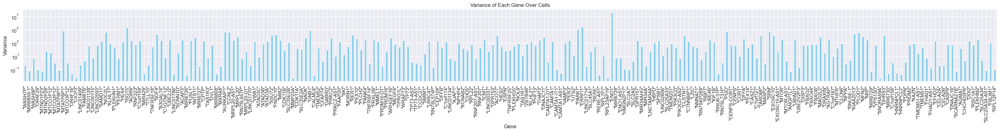

In [27]:
gene_variances = df_MCF_SmartS_unfiltered.var(axis=1)

# calculate the number of genes that correspond to the first 10%
num_genes = int(len(gene_variances) * 0.01)

# select the first 10% of genes
top_10_percent_variances = gene_variances.nlargest(num_genes)
top_10_percent_variances = gene_variances[:num_genes]
# now plot the variances

plt.figure(figsize=(40, 3)) 
plt.yscale('log') # for a better scaling
top_10_percent_variances.plot(kind='bar', color='skyblue')
plt.title('Variance of Each Gene Over Cells')
plt.xlabel('Gene')
plt.ylabel('Variance')
plt.grid(True)
plt.show()

### Correlation Between Cells

In [28]:
#to check if there are any genes with all zero
genes_with_all_zeros = df_MCF_SmartS_unfiltered.columns[(df_MCF_SmartS_unfiltered.sum() == 0)]

print(np.shape(df_MCF_SmartS_unfiltered)) 
df_MCF_SmartS_unfiltered = df_MCF_SmartS_unfiltered.copy().drop(columns=genes_with_all_zeros)
print(np.shape(df_MCF_SmartS_unfiltered)) 



(22905, 383)
(22905, 383)


In [29]:
#checking correlation between cells
corr = df_MCF_SmartS_unfiltered.corr()
print(corr.values.min())


-0.002035647651036618


Minimum Correlation between Cells:
* The minimum correlation coefficient between cells is approximately -0.0020.
* This value indicates the weakest correlation observed between any pair of cells in the dataset.
* A correlation coefficient very close to zero suggests that there is little to no linear relationship between the gene expression profiles of the corresponding cells.
* In this case, the minimum correlation coefficient indicates that there are pairs of cells that exhibit very weak or negligible similarity in their gene expression patterns.

In [30]:
off_diagonal = corr.values[np.tril_indices_from(corr.values, k=-1)]
average_correlation = np.mean(off_diagonal)
print(average_correlation)

0.6720341269515576


In [31]:

midpoint = (corr.values.max() - corr.values.min()) /2 + corr.values.min()
print(midpoint)

0.49898217617448165


Now we want to see why some cells are completely correlated from the others:


Text(0, 0.5, 'Frequency')

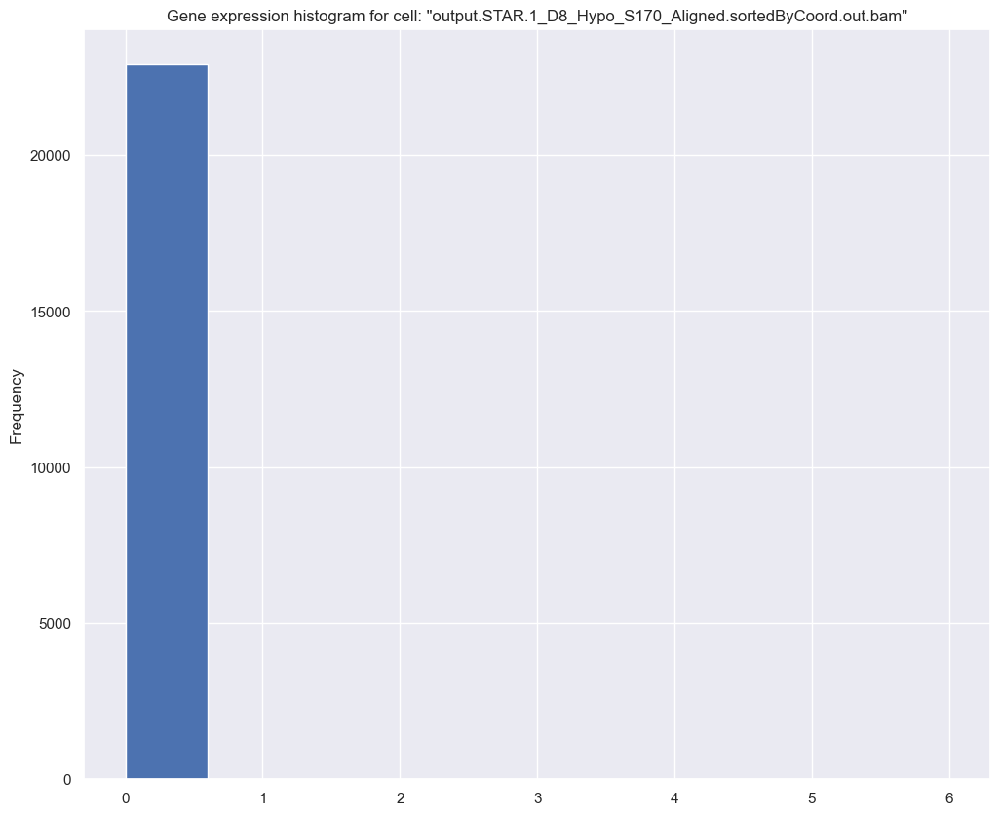

In [32]:
plt.figure(figsize=(12,10))
mini  = np.argmin(list(corr[corr.columns.values[1]]))
plt.hist(df_MCF_SmartS_unfiltered.iloc[:,mini])
plt.title(f"Gene expression histogram for cell: {df_MCF_SmartS_unfiltered.columns.values[mini]}")
plt.ylabel("Frequency")

These cells have zero count for every gene. These cells are abnormal and therefore will need to be removed.

TO SEE HOW MANY UNCORRELATED PAIRS WE HAVE

In [33]:
# Define the threshold for 'extremely uncorrelated' (example: between -0.1 and 0.1)
threshold = 0.01

# Create a mask for the correlation matrix where true values are those that meet the criterion
# for being 'extremely uncorrelated', excluding the diagonal.
mask = np.abs(corr.values) < threshold
np.fill_diagonal(mask, False)

# Extract the row and column indices where the mask is True
uncorrelated_pairs_indices = np.where(mask)

# Retrieve the actual gene names and correlation values for these pairs
uncorrelated_pairs = [(corr.index[i], corr.columns[j], corr.iloc[i, j]) 
                      for i, j in zip(*uncorrelated_pairs_indices)]

# Sort the pairs by the absolute value of their correlation to find the most uncorrelated
print(len(uncorrelated_pairs))


1624


### Sparsity

In [34]:
total_elements = df_MCF_SmartS_unfiltered.size
non_zero_elements = df_MCF_SmartS_unfiltered.astype(bool).sum().sum()  # Counts the number of non-zero elements
sparsity = (total_elements - non_zero_elements) / total_elements
print(f'Sparsity: {sparsity:.2%}')

Sparsity: 60.17%


This means that, on average, 60.17% of the data is either 0 or missing values but we have seen that there are no missing values in our dataset. So this means that 60.17% of our dataset is sparse.

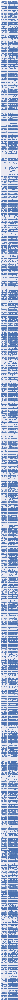

In [35]:
plt.figure(figsize=(25, 600))
plt.spy(df_MCF_SmartS_unfiltered.iloc[:, :], markersize=1)

Here we can see that we have a overall low number of genes expressed and this may be due to problems of measure, health of the single cell, lab mistakes, ecc...

Horizontal white lines in the plot represent groups of genes that are consistently expressed or unexpressed across multiple cells, suggesting coordinated regulation or functional relevance of these gene sets.

### Covariates-Correlation

We now want to analyse the structure among the covariates. Notice that here due to computational power issues we display the correlation just of the first 10% of the genes.

Average correlation between cells:  0.3475550350017191
Minimum correlation between cells:  -0.3048899299965619 



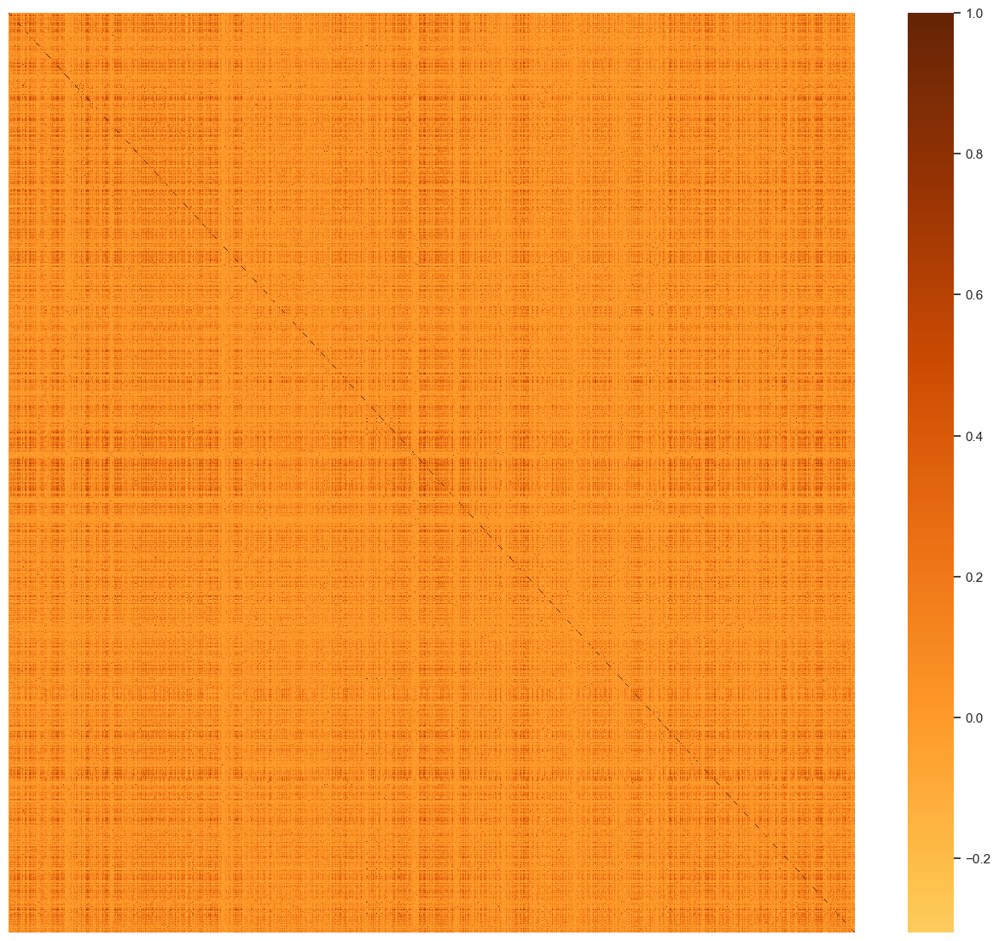

In [36]:
plt.figure(figsize=(16,14))
#df_small = df.iloc[:, :50]
#c= df_small.corr()

#we transpose it because we now look at the correlation between the genes
corr = df_MCF_SmartS_unfiltered.iloc[:3000,:].T.corr()
midpoint = (corr.values.max() - corr.values.min()) /2 + corr.values.min()
#sns.heatmap(c,cmap='coolwarm',annot=True, center=midpoint )
sns.heatmap(corr,cmap="YlOrBr", center=0, yticklabels=False , xticklabels=False)

print("Average correlation between cells: ", midpoint)
print("Minimum correlation between cells: ", corr.values.min(), "\n")

### Skewness and Kurtosis

Skewness:
* measures the degree of asymmetry of the distribution
* a positive skewness value indicates that the distribution is skewed to the right, meaning that the tail of the distribution extends more towards higher values.
* conversely, a negative skewness value indicates that the distribution is skewed to the left, with the tail extending more towards lower values.
* the magnitude of skewness indicates the extent of asymmetry. Larger magnitude values indicate more pronounced skewness

Kurtosis:
* measures the "tailedness" or peakedness of the distribution.
* a positive kurtosis value indicates that the distribution has heavier tails and is more peaked than a normal distribution (leptokurtic).
* a negative kurtosis value indicates that the distribution has lighter tails and is less peaked than a normal distribution (platykurtic).
* higher magnitude values of kurtosis indicate greater "tailedness" or peakedness of the distribution.

In [37]:
from scipy.stats import kurtosis, skew
import random

# Generate random cell indices
random_cells = [random.randrange(df_MCF_SmartS_unfiltered.shape[1]) for _ in range(4)]

# Calculate kurtosis and skewness for each randomly selected cell
for cell_idx in random_cells:
    gene_expression = df_MCF_SmartS_unfiltered.iloc[:, cell_idx]
    cell_skewness = skew(gene_expression)
    cell_kurtosis = kurtosis(gene_expression)
    
    print(f"Cell {cell_idx}:\nSkewness: {cell_skewness:.2f}\nKurtosis: {cell_kurtosis:.2f}\n")


Cell 25:
Skewness: 52.62
Kurtosis: 3504.80

Cell 177:
Skewness: 53.05
Kurtosis: 3202.49

Cell 2:
Skewness: 48.14
Kurtosis: 2901.80

Cell 357:
Skewness: 41.56
Kurtosis: 2113.56



Overall, we can see that these random cells have a gene distribution highly skewed to the right and a very heavy tail with a pronounced peak. These distributions deviate significantly from normality.

In [38]:
df_MCF_SmartS_meta

,Cell Line,Lane,Pos,Condition,Hours,Cell name,PreprocessingTag,ProcessingComments
Filename,,,,,,,,
output.STAR.1_A10_Hypo_S28_Aligned.sortedByCoord.out.bam,MCF7,output.STAR.1,A10,Hypo,72,S28,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.1_A11_Hypo_S29_Aligned.sortedByCoord.out.bam,MCF7,output.STAR.1,A11,Hypo,72,S29,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.1_A12_Hypo_S30_Aligned.sortedByCoord.out.bam,MCF7,output.STAR.1,A12,Hypo,72,S30,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.1_A1_Norm_S1_Aligned.sortedByCoord.out.bam,MCF7,output.STAR.1,A1,Norm,72,S1,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.1_A2_Norm_S2_Aligned.sortedByCoord.out.bam,MCF7,output.STAR.1,A2,Norm,72,S2,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
...,...,...,...,...,...,...,...,...
output.STAR.4_H5_Norm_S359_Aligned.sortedByCoord.out.bam,MCF7,output.STAR.4,H5,Norm,72,S359,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.4_H6_Norm_S360_Aligned.sortedByCoord.out.bam,MCF7,output.STAR.4,H6,Norm,72,S360,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.4_H7_Hypo_S379_Aligned.sortedByCoord.out.bam,MCF7,output.STAR.4,H7,Hypo,72,S379,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"


Text(0, 0.5, 'Frequency')

<Figure size 2000x1700 with 0 Axes>

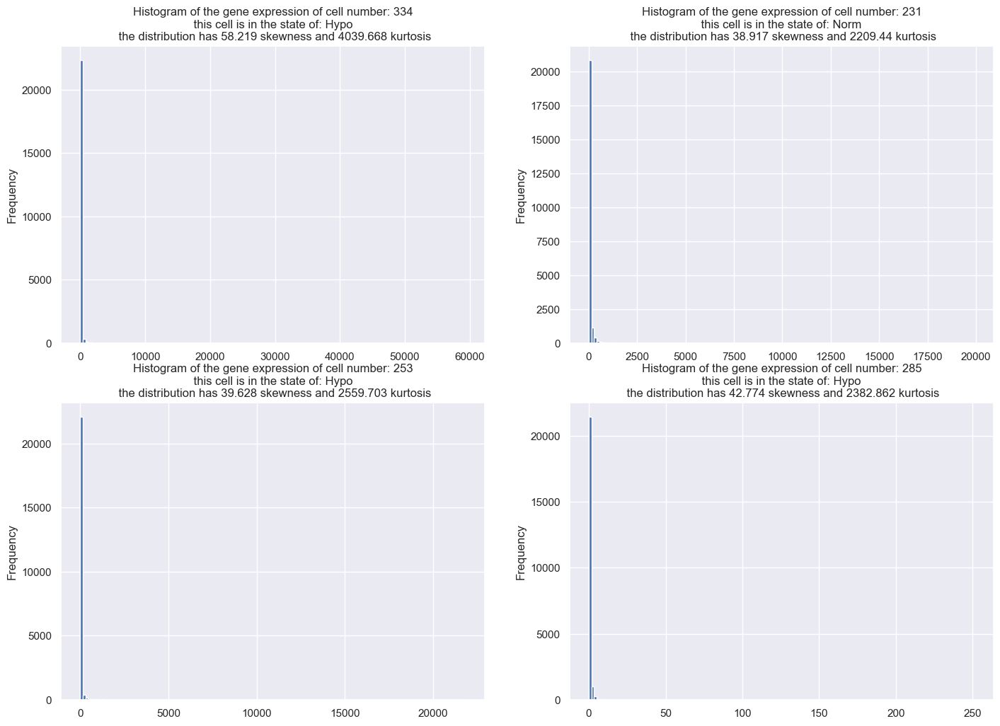

In [39]:
from scipy.stats import kurtosis, skew
import random

plt.figure(figsize=(20, 17))

first_cell = random.randrange(df_MCF_SmartS_unfiltered.shape[1])
second_cell = random.randrange(df_MCF_SmartS_unfiltered.shape[1])
third_cell = random.randrange(df_MCF_SmartS_unfiltered.shape[1])
fourth_cell = random.randrange(df_MCF_SmartS_unfiltered.shape[1])


plt.figure(figsize=(17, 12))

plt.subplot(2, 2, 1)
plt.hist(df_MCF_SmartS_unfiltered.iloc[:,first_cell], bins=150)
plt.title(f"Histogram of the gene expression of cell number: {first_cell}\n this cell is in the state of: {df_MCF_SmartS_meta.iloc[first_cell, 3]} \n the distribution has {round(skew(df_MCF_SmartS_unfiltered.iloc[:,first_cell]), 3)} skewness and {round(kurtosis(df_MCF_SmartS_unfiltered.iloc[:,first_cell]), 3)} kurtosis")
plt.ylabel("Frequency")

plt.subplot(2, 2, 2)
plt.hist(df_MCF_SmartS_unfiltered.iloc[:,second_cell], bins=150)
plt.title(f"Histogram of the gene expression of cell number: {second_cell}\n this cell is in the state of: {df_MCF_SmartS_meta.iloc[second_cell, 3]} \n the distribution has {round(skew(df_MCF_SmartS_unfiltered.iloc[:,second_cell]), 3)} skewness and {round(kurtosis(df_MCF_SmartS_unfiltered.iloc[:,second_cell]), 3)} kurtosis")
plt.ylabel("Frequency")

plt.subplot(2, 2, 3)
plt.hist(df_MCF_SmartS_unfiltered.iloc[:,third_cell], bins=150)
plt.title(f"Histogram of the gene expression of cell number: {third_cell}\n this cell is in the state of: {df_MCF_SmartS_meta.iloc[third_cell, 3]} \n the distribution has {round(skew(df_MCF_SmartS_unfiltered.iloc[:,third_cell]), 3)} skewness and {round(kurtosis(df_MCF_SmartS_unfiltered.iloc[:,third_cell]), 3)} kurtosis")
plt.ylabel("Frequency")

plt.subplot(2, 2, 4)
plt.hist(df_MCF_SmartS_unfiltered.iloc[:,fourth_cell], bins=150)
plt.title(f"Histogram of the gene expression of cell number: {fourth_cell}\n this cell is in the state of: {df_MCF_SmartS_meta.iloc[fourth_cell, 3]} \n the distribution has {round(skew(df_MCF_SmartS_unfiltered.iloc[:,fourth_cell]), 3)} skewness and {round(kurtosis(df_MCF_SmartS_unfiltered.iloc[:,fourth_cell]), 3)} kurtosis")
plt.ylabel("Frequency")


The result is as expected by choosing at random four cells in our sample. The histogram is showing how for these cells the big majority of genes have zero reads, but those who are not can count up to almost 45000 reads (seen from the table above). Moreover, from the values of kurtosis and skewness we see that the distributions are highly non normal

As the the kurtosis for normal distribution is 0 and the skewness is 0. 
But some accepted normal values for kurtosis can be between -2 and +2 and for skewness between -0.5 and +0.5. So we can see that we are talking about a very different, non normal distribution.

We learn an important thing about this dataset, the interesting datapoints are the outliers! This means that we cannot procede with the elimination of the outliers as you would normally do, because it would leave us with no information at all



### Removing Outliers

If we try to remove the outliers by computing the inter quantile range and use this to define outliers and filter them as below:

In [40]:
Q1 = df_MCF_SmartS_unfiltered.quantile(0.25)
Q3 = df_MCF_SmartS_unfiltered.quantile(0.75)
IQR = Q3 - Q1
print(IQR)

"output.STAR.1_A10_Hypo_S28_Aligned.sortedByCoord.out.bam"    17.0
"output.STAR.1_A11_Hypo_S29_Aligned.sortedByCoord.out.bam"     0.0
"output.STAR.1_A12_Hypo_S30_Aligned.sortedByCoord.out.bam"     5.0
"output.STAR.1_A1_Norm_S1_Aligned.sortedByCoord.out.bam"       0.0
"output.STAR.1_A2_Norm_S2_Aligned.sortedByCoord.out.bam"       7.0
                                                              ... 
"output.STAR.4_H5_Norm_S359_Aligned.sortedByCoord.out.bam"     9.0
"output.STAR.4_H6_Norm_S360_Aligned.sortedByCoord.out.bam"    27.0
"output.STAR.4_H7_Hypo_S379_Aligned.sortedByCoord.out.bam"    30.0
"output.STAR.4_H8_Hypo_S380_Aligned.sortedByCoord.out.bam"    38.0
"output.STAR.4_H9_Hypo_S381_Aligned.sortedByCoord.out.bam"    33.0
Length: 383, dtype: float64


Let's try to eliminate those using inter quantile range:

In [41]:
#create a new dataset
unfilt_n = df_MCF_SmartS_unfiltered[~((df_MCF_SmartS_unfiltered < (Q1 - 1.5 * IQR)) |(df_MCF_SmartS_unfiltered> (Q3 + 1.5 * IQR))).any(axis=1)]
unfilt_n.shape
unfilt_n.head(3)

,"""output.STAR.1_A10_Hypo_S28_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A11_Hypo_S29_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A12_Hypo_S30_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A1_Norm_S1_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A2_Norm_S2_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A3_Norm_S3_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A4_Norm_S4_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A5_Norm_S5_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A6_Norm_S6_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A7_Hypo_S25_Aligned.sortedByCoord.out.bam""",...,"""output.STAR.4_H14_Hypo_S383_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H1_Norm_S355_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H2_Norm_S356_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H3_Norm_S357_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H4_Norm_S358_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H5_Norm_S359_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H6_Norm_S360_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H7_Hypo_S379_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H8_Hypo_S380_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H9_Hypo_S381_Aligned.sortedByCoord.out.bam"""
"""MIR6859-1""",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""CICP3""",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""FAM87B""",0,0,0,0,0,0,0,0,2,0,...,0,1,0,0,0,0,0,0,0,0


Look at violin plots with the outliers removed:

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

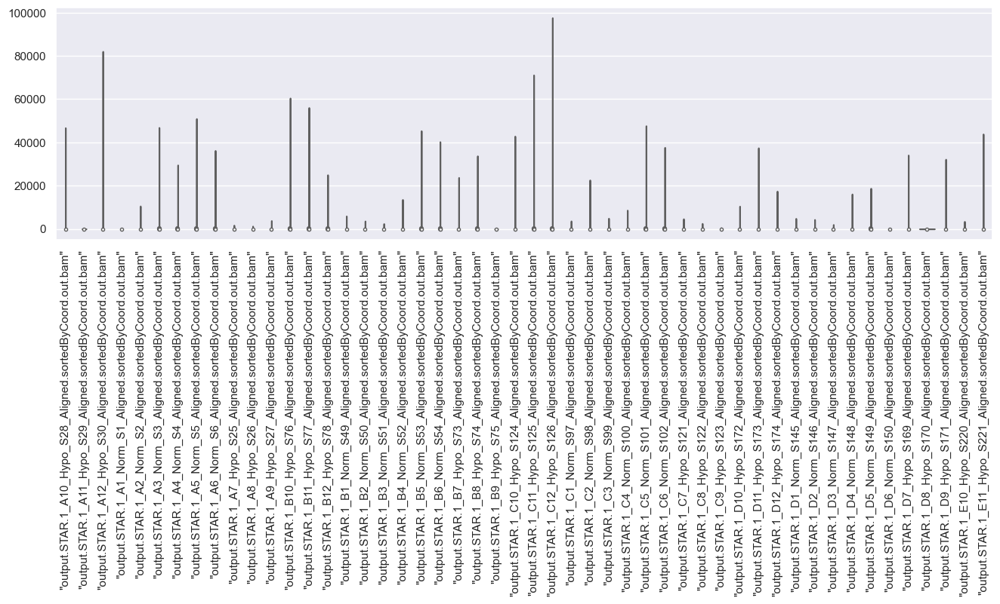

In [42]:
unfilt_n_small = df_MCF_SmartS_unfiltered.iloc[:, :50]
np.shape(unfilt_n_small)
plt.figure(figsize=(16,4))
plot=sns.violinplot(data=unfilt_n_small,palette="Set3",cut=0)
plt.setp(plot.get_xticklabels(), rotation=90)

This is not good as we have just 0 now. So simply removing the outliers now doesn't work here as we would loose a lot of information.

Text(0, 0.5, 'Frequency (possibly scaled)')

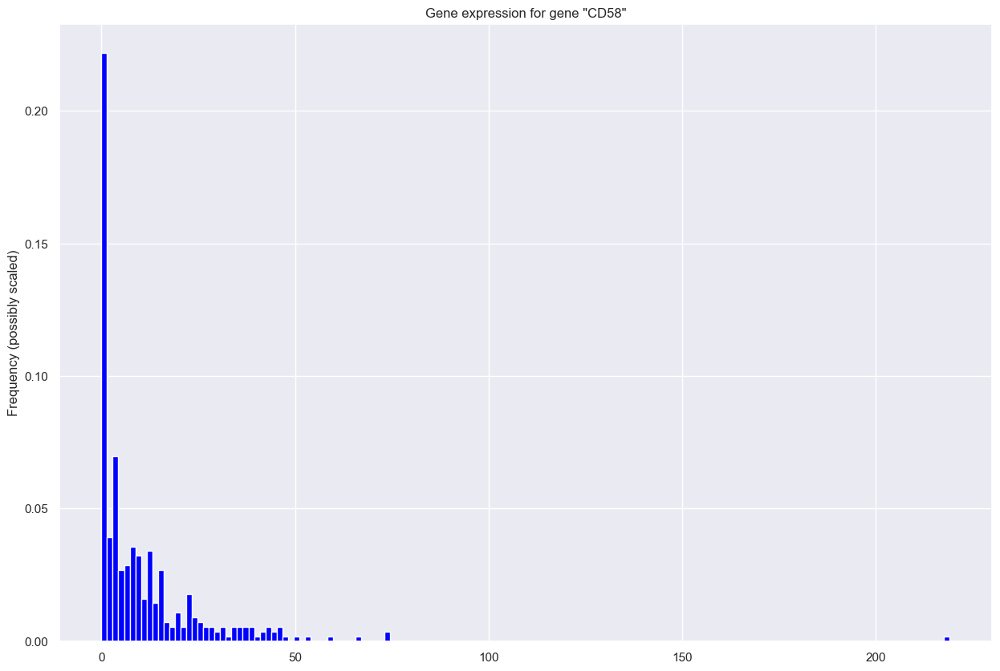

In [43]:
rdn_gene = random.randrange(df_MCF_SmartS_unfiltered.shape[0])

plt.figure(figsize=(15, 10))
df_MCF_SmartS_unfiltered.iloc[rdn_gene, :].plot.hist(grid=True,
                                      density = True, 
                                      bins=150,
                                      color='blue')

plt.title(f"Gene expression for gene {df_MCF_SmartS_unfiltered.index[rdn_gene]}")
plt.ylabel("Frequency (possibly scaled)")

Here are some conclusions from this plotting, as other genes will display a similar distribution:
* A low number of counts associated with a higher number of genes
* A long right tail due to the lack of upper limits for expression
* A large range

Next, let us further investigate the relation between mean and variance of the gene expression among cells:

Text(0, 0.5, 'Variance')

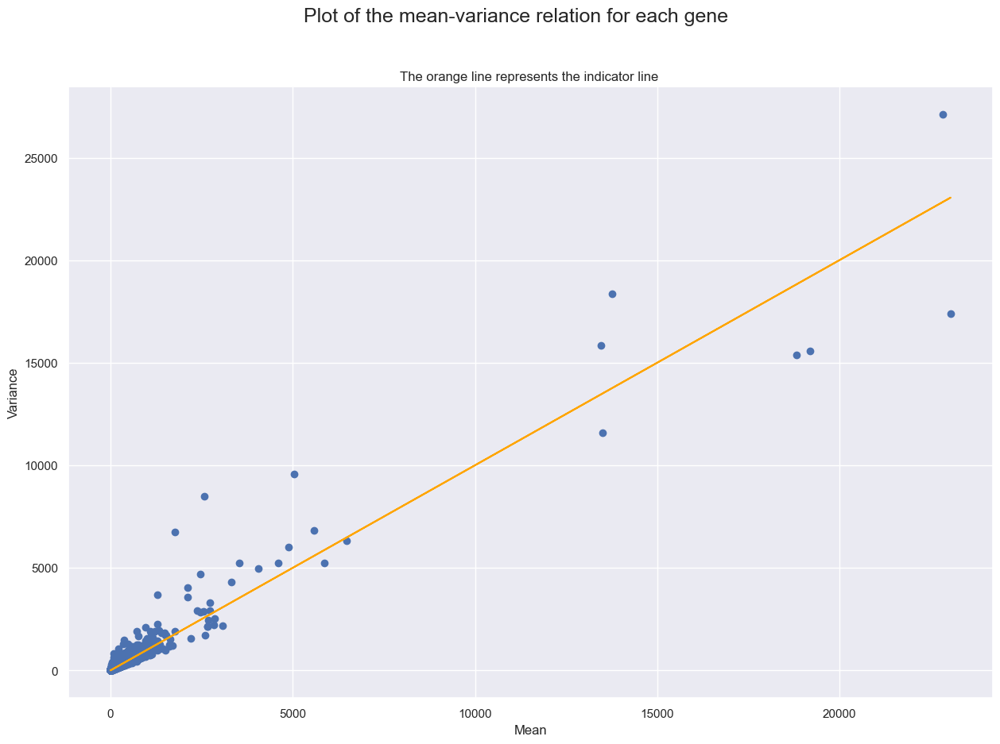

In [44]:
mean_vector = df_MCF_SmartS_unfiltered.T.describe().iloc[1,:]
var_vector = df_MCF_SmartS_unfiltered.T.describe().iloc[2,:]

plt.figure(figsize=(15, 10))
plt.scatter(mean_vector, var_vector)
plt.plot(mean_vector, mean_vector, color = "orange")
plt.title("The orange line represents the indicator line ", fontsize = 12)
plt.suptitle("Plot of the mean-variance relation for each gene", fontsize = 18)
plt.xlabel("Mean")
plt.ylabel("Variance")

### Filtering

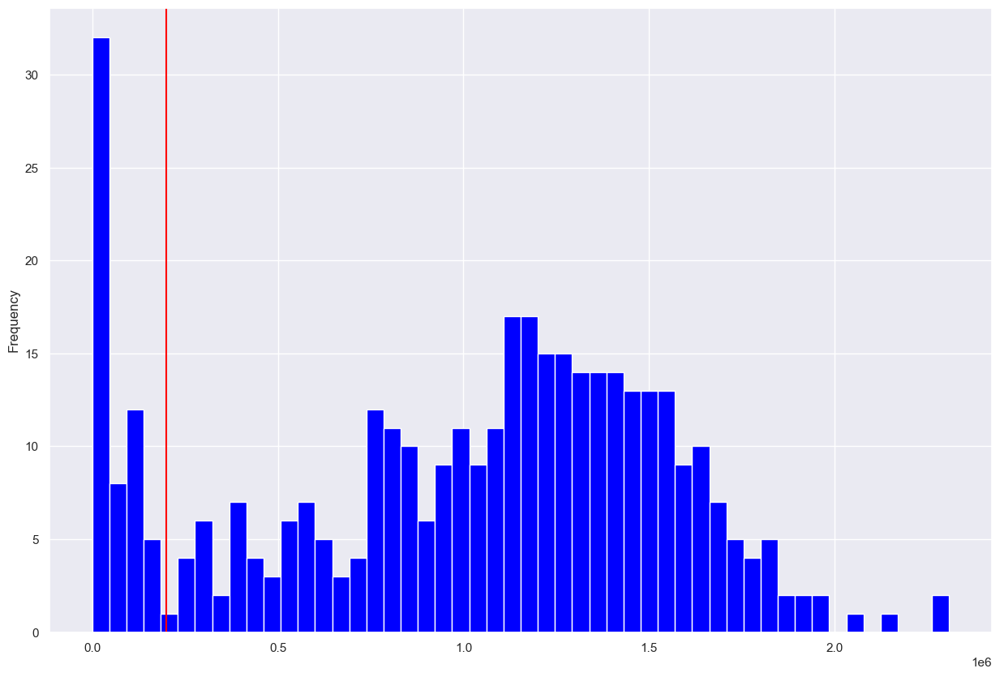

In [45]:
#creating a new data frame with all of the sums of genes 
sum_genes = df_MCF_SmartS_unfiltered.sum(axis = 0)

plt.figure(figsize = (15,10))
sum_genes.plot.hist(grid = True, bins = 50, color= "blue")
plt.axvline(x = .20e6, color = 'red')

WE ARE REMOVING THE GENES THAT LEFT ON THE LEFT SIDE OF THE THRESHOLD, because we have to follow a normal distribution in the count of genes since all of these rooted back to the same cell-line. , because their gene expression may be corrupted by human mistakes in extracting the data or by the health status of the cell itself

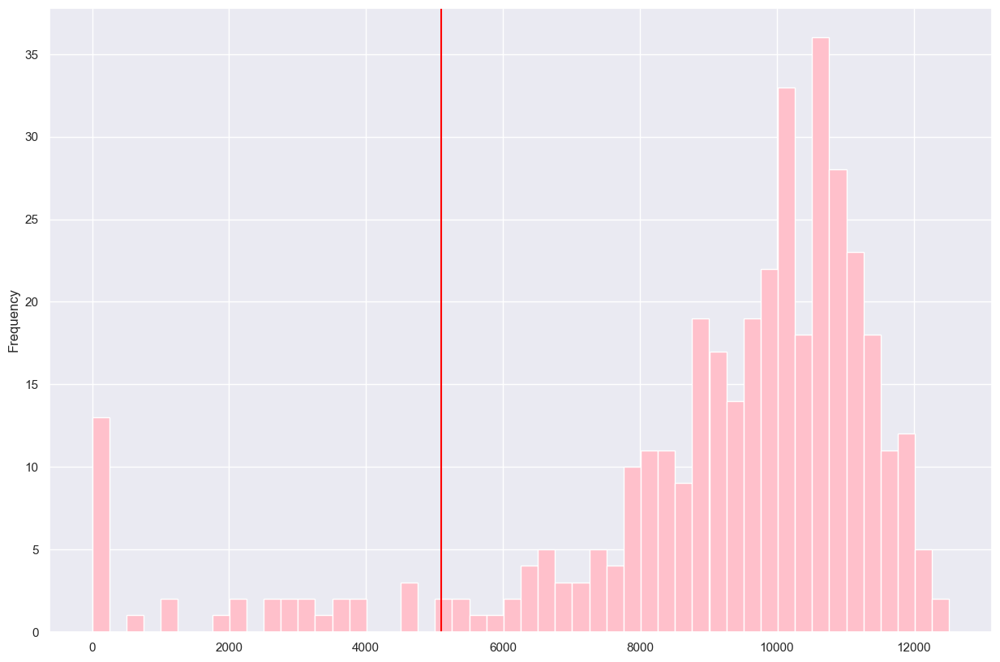

In [46]:
count_type_genes = df_MCF_SmartS_unfiltered.copy()
count_type_genes[count_type_genes != 0] = 1 #turning non-zero values into 1 and sum them up
sum_number = count_type_genes.sum(axis = 0)

plt.figure(figsize = (15,10))
sum_number.plot.hist(grid = True, bins = 50, color= "pink")
plt.axvline(x = 5100, color = 'red') #THRESHOLD

REMOVAL OF EXCLUDED CELLS FROM NORMAL DISTRIBUTION

In [47]:
filtered  = df_MCF_SmartS_unfiltered.loc[:, (sum_genes >= .20e6) & (count_type_genes.sum(axis = 0) >= 5100)]
#(sum_genes >= .10e6) &
perc_cell_lost = (df_MCF_SmartS_unfiltered.shape[1] - filtered.shape[1]) / df_MCF_SmartS_unfiltered.shape[1] * 100

print(np.shape(filtered), perc_cell_lost) # WE MOVED FROM 383 TO 322

(22905, 322) 15.926892950391643


THE RULE OF THUMB

We now want to study the percentage of mitochondrial RNA and cut those cells at a rate that is too high (above 4%/5% is the rule of thumb that we adopt here, but in general this trashold is study-specific and there's active discussion inside the community about how to decide it). The idea behind this filtering is that when a cell is lysed during the process of Rna extraction or the cell membrane is disrupted, the cytoplasmatic transcript is released while mitochondrial RNA is more protected because of a double membrane around mitochondria. Therefore the high percentage of mtRNA would indicate poor quality of the cell condition

['"INMT-MINDY4"', '"MT-TF"', '"MT-RNR1"', '"MT-TV"', '"MT-RNR2"', '"MT-TL1"', '"MT-ND1"', '"MT-TI"', '"MT-TQ"', '"MT-TM"', '"MT-ND2"', '"MT-TW"', '"MT-TA"', '"MT-TC"', '"MT-TY"', '"MT-CO1"', '"MT-TS1"', '"MT-TD"', '"MT-CO2"', '"MT-TK"', '"MT-ATP8"', '"MT-ATP6"', '"MT-CO3"', '"MT-TG"', '"MT-ND3"', '"MT-TR"', '"MT-ND4L"', '"MT-ND4"', '"MT-TH"', '"MT-TS2"', '"MT-TL2"', '"MT-ND5"', '"MT-ND6"', '"MT-TE"', '"MT-CYB"', '"MT-TT"', '"MT-TP"']
['"INMT-MINDY4"', '"MT-TF"', '"MT-RNR1"', '"MT-TV"', '"MT-RNR2"', '"MT-TL1"', '"MT-ND1"', '"MT-TI"', '"MT-TQ"', '"MT-TM"', '"MT-ND2"', '"MT-TW"', '"MT-TA"', '"MT-TC"', '"MT-TY"', '"MT-CO1"', '"MT-TS1"', '"MT-TD"', '"MT-CO2"', '"MT-TK"', '"MT-ATP8"', '"MT-ATP6"', '"MT-CO3"', '"MT-TG"', '"MT-ND3"', '"MT-TR"', '"MT-ND4L"', '"MT-ND4"', '"MT-TH"', '"MT-TS2"', '"MT-TL2"', '"MT-ND5"', '"MT-ND6"', '"MT-TE"', '"MT-CYB"', '"MT-TT"', '"MT-TP"']
"output.STAR.1_A10_Hypo_S28_Aligned.sortedByCoord.out.bam"    0.007274
"output.STAR.1_A12_Hypo_S30_Aligned.sortedByCoord.out

<Axes: ylabel='Frequency'>

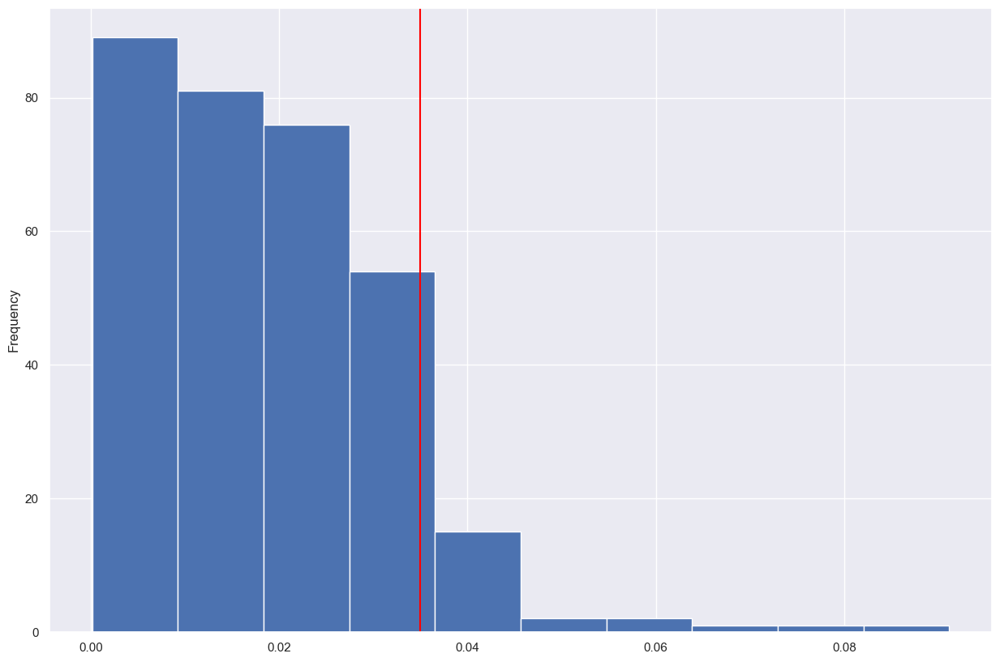

In [48]:
mt_gene_names = filtered.index[filtered.index.str.contains("MT-")].tolist()

print(mt_gene_names)
#mt_gene_names.remove(mt_gene_names[0]) #cause it had the first "INMT-MINDY4", that is not initialized with MT, so er remopved it manually
print(mt_gene_names)

sum_mt_genes = filtered.loc[mt_gene_names].sum(axis = 0)
total = filtered.sum(axis = 0)

mito_ratio = sum_mt_genes / total
print(mito_ratio)
plt.figure(figsize=(15, 10))
plt.axvline(x=0.035, color = "red") #Where do we want to do the cut in our filtering
mito_ratio.plot.hist()

In [49]:
filtered_cells = filtered.loc[:, (mito_ratio <= 0.035)]
cell_lost = (filtered.shape[1] - filtered_cells.shape[1]) / filtered.shape[1] * 100

print(np.shape(filtered_cells), cell_lost) # WE MOVED FROM 322 TO 294

(22905, 294) 8.695652173913043


### Normalization

Library Size Normalization is a crucial preprocessing step in the analysis of RNA-sequencing (RNA-seq) or other sequencing data where the number of reads or counts per sample can vary considerably. This variation can be due to differences in sequencing depth or efficiency across different samples, rather than reflecting genuine biological differences in gene expression levels. Without proper normalization, comparing expression levels across samples can be misleading. The right way has to be chosen.

/var/folders/sc/040g6l752pg38ngvcz_ths0c0000gn/T/ipykernel_12426/2513447728.py:12: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(filtered_cells.iloc[gene_number, :], fit=stats.gamma,


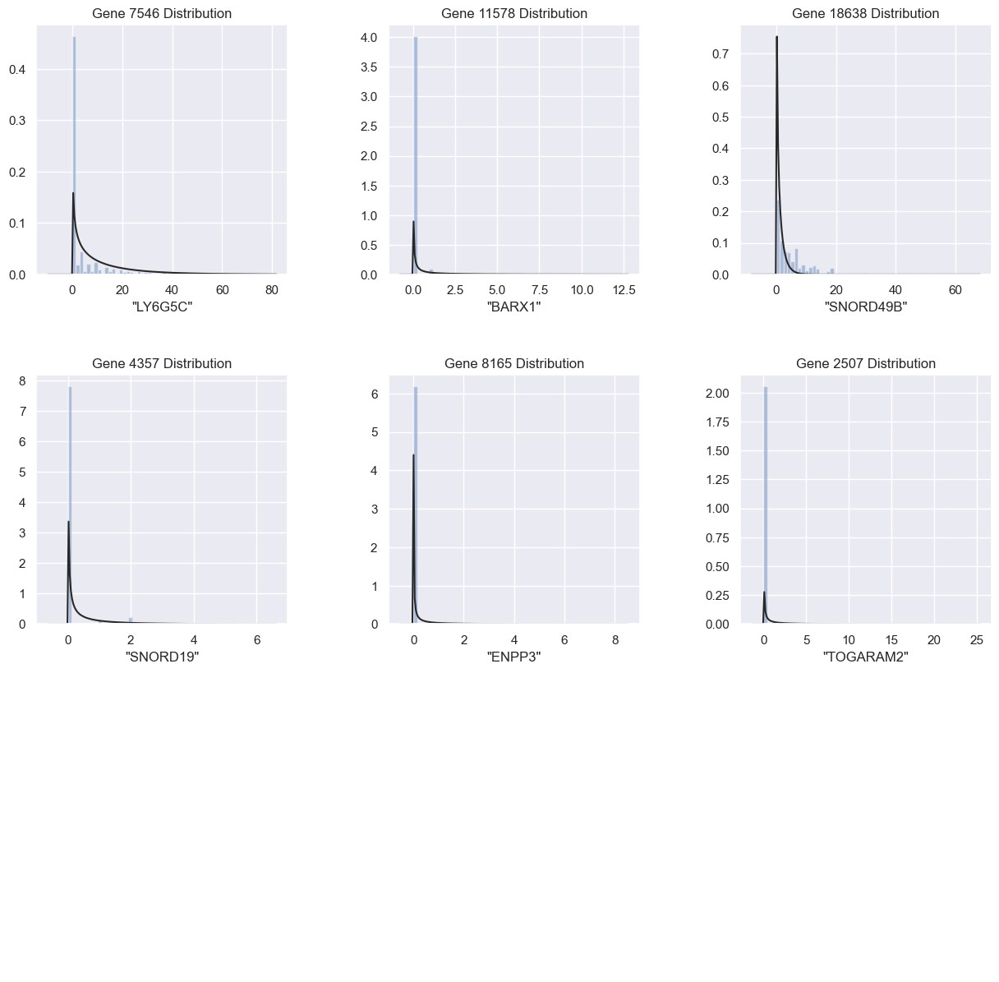

In [50]:
import scipy.stats as stats
import random

gene_numbers = random.sample(range(filtered_cells.shape[0]), 6)

fig, axes = plt.subplots(3, 3, figsize=(15, 15))  # Adjust the figure size as needed
fig.subplots_adjust(hspace=0.4, wspace=0.4)  

axes_flat = axes.flatten()

for i, gene_number in enumerate(gene_numbers):
    sns.distplot(filtered_cells.iloc[gene_number, :], fit=stats.gamma,
                 kde=False, bins=50, ax=axes_flat[i])
    axes_flat[i].set_title(f'Gene {gene_number} Distribution')

# If you don't want to plot on the remaining subplots, you can turn them off
for j in range(i+1, 9):
    axes_flat[j].axis('off')

plt.show()


gene that is not highly expressed in the majority of these cells, with most cells showing low to no expression. However, there are cells with higher expression levels, though they are much fewer in number. so gamma distribution is a very nice fit to this distribution. because of sparsity.
we need to make sure the same distribution is sustained when normalized.

#### CPM

first apply CPM, so that sum of all genes in each cell is the same.This normalization makes it possible to compare gene expression levels across different samples by accounting for differences in sequencing depth (total read count).

In [51]:
normalized = filtered_cells.copy()

#for cell_number in range(normalized.shape[1]):
    #normalized.iloc[:, cell_number] = normalized.iloc[:, cell_number]/(sum(normalized.iloc[:, cell_number]))/10e6
for i in range(normalized.shape[1]):
  normalized.iloc[:,i] = normalized.iloc[:,i]/(sum(normalized.iloc[:,i])/10e6)

In [52]:
normalized.head(10)

,"""output.STAR.1_A10_Hypo_S28_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A12_Hypo_S30_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A2_Norm_S2_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A3_Norm_S3_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A4_Norm_S4_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A5_Norm_S5_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A6_Norm_S6_Aligned.sortedByCoord.out.bam""","""output.STAR.1_B10_Hypo_S76_Aligned.sortedByCoord.out.bam""","""output.STAR.1_B11_Hypo_S77_Aligned.sortedByCoord.out.bam""","""output.STAR.1_B12_Hypo_S78_Aligned.sortedByCoord.out.bam""",...,"""output.STAR.4_H10_Hypo_S382_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H14_Hypo_S383_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H1_Norm_S355_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H3_Norm_S357_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H4_Norm_S358_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H5_Norm_S359_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H6_Norm_S360_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H7_Hypo_S379_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H8_Hypo_S380_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H9_Hypo_S381_Aligned.sortedByCoord.out.bam"""
"""WASH7P""",0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,9.646550,0.000000,0.000000,13.320421,0.000000,0.000000,0.000000,7.084762,0.000000,6.937536
"""MIR6859-1""",0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
"""WASH9P""",10.682482,0.000000,0.000000,7.756736,57.831649,6.946784,0.000000,21.861125,24.750055,10.628190,...,19.293101,25.113450,10.361964,0.000000,0.000000,0.000000,8.854784,7.084762,25.540387,34.687679
"""OR4F29""",0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.385097,0.000000
"""MTND1P23""",0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
"""MTND2P28""",21.364965,5.044358,0.000000,7.756736,17.349495,41.680705,103.514512,65.583375,18.562542,0.000000,...,0.000000,0.000000,41.447857,26.640843,19.826282,0.000000,17.709568,49.593335,185.167804,34.687679
"""MTCO1P12""",21.364965,5.044358,0.000000,23.270209,57.831649,34.733921,32.348285,4.372225,30.937569,21.256380,...,0.000000,25.113450,72.533749,53.281686,0.000000,25.003188,44.273921,0.000000,25.540387,20.812607
"""MTCO2P12""",0.000000,5.044358,0.000000,0.000000,5.783165,13.893568,6.469657,0.000000,0.000000,0.000000,...,0.000000,0.000000,10.361964,13.320421,0.000000,0.000000,44.273921,0.000000,0.000000,0.000000
"""MTATP8P1""",0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.469657,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
"""MTATP6P1""",309.791991,60.532291,2040.436653,1574.617477,3996.166918,1431.037537,4955.757251,1447.206476,284.625637,286.961124,...,241.163760,1255.672501,3046.417455,2850.570181,2597.242957,1225.156207,3276.270152,233.797149,1455.802042,492.565043


to make it close to a normal distribution, we need to apply log transformation. but first check if the distribution has been disturbed, which gamma in prior

/var/folders/sc/040g6l752pg38ngvcz_ths0c0000gn/T/ipykernel_12426/3853355528.py:9: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(normalized.iloc[gene_numbers_norm, :], fit=stats.gamma,


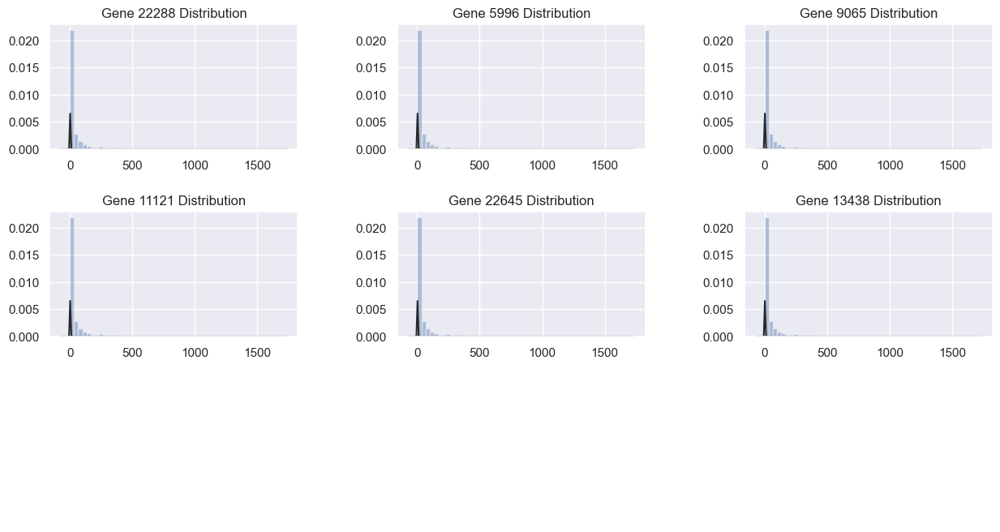

In [53]:
gene_numbers_norm = random.sample(range(normalized.shape[0]), 6)

fig, axes = plt.subplots(3, 3, figsize=(15, 8))  # Adjust the figure size as needed
fig.subplots_adjust(hspace=0.5, wspace=0.4)  

axes_flat = axes.flatten()

for i, gene_number in enumerate(gene_numbers_norm):
    sns.distplot(normalized.iloc[gene_numbers_norm, :], fit=stats.gamma,
                 kde=False, bins=50, ax=axes_flat[i])
    axes_flat[i].set_title(f'Gene {gene_number} Distribution')

# If you don't want to plot on the remaining subplots, you can turn them off
for j in range(i+1, 9):
    axes_flat[j].axis('off')

plt.show()

it is not normalized yet, as it can be seen from the graph

/var/folders/sc/040g6l752pg38ngvcz_ths0c0000gn/T/ipykernel_12426/2906230858.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(normalized.iloc[gene_norm_rand, :], fit=stats.norm,


<Axes: xlabel='"CELA2B"'>

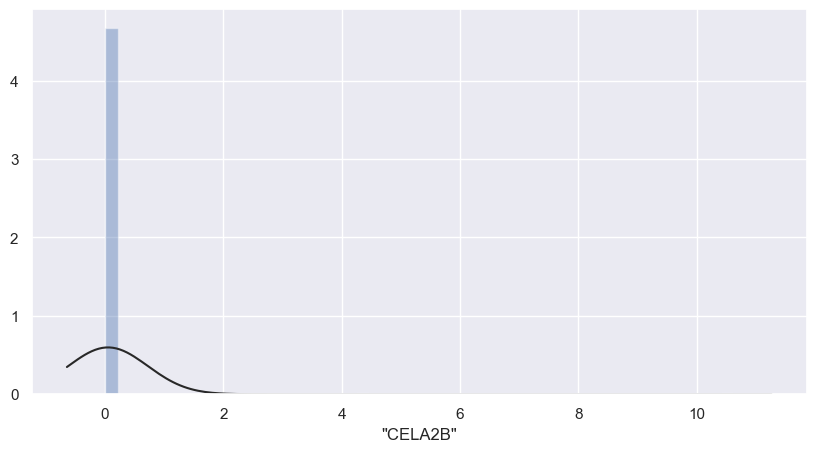

In [54]:
gene_norm_rand = random.randrange(normalized.shape[0])

plt.figure(figsize=(10,5))
sns.distplot(normalized.iloc[gene_norm_rand, :], fit=stats.norm, 
                                          kde=False, 
                                          bins = 50)

/var/folders/sc/040g6l752pg38ngvcz_ths0c0000gn/T/ipykernel_12426/3403879344.py:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(normalized.iloc[gene_norm_rand_log, :], fit=stats.norm,


<Axes: xlabel='"SRRM3"'>

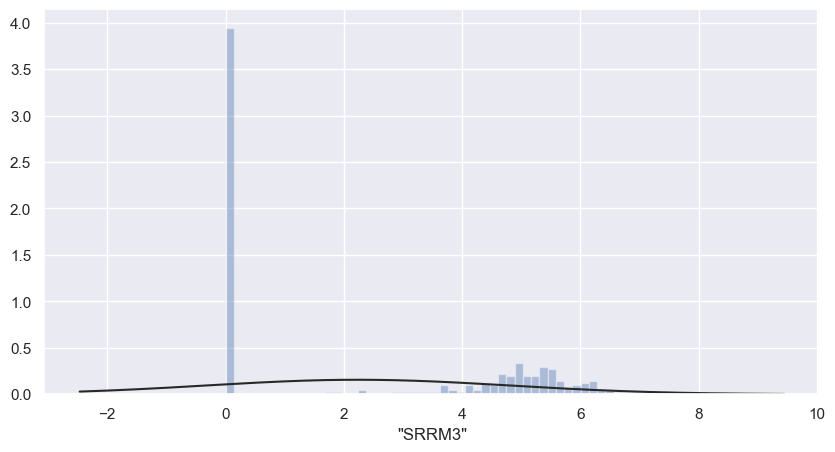

In [55]:
normalized = np.log(normalized.copy() + 1)

gene_norm_rand_log = random.randrange(normalized.shape[0])

plt.figure(figsize=(10,5))
sns.distplot(normalized.iloc[gene_norm_rand_log, :], fit=stats.norm, 
                                          kde=False, 
                                          bins = 50)

#### T-TEST 

creating two datasets with hypo and norm, and clearing out the names

In [56]:
normalized

,"""output.STAR.1_A10_Hypo_S28_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A12_Hypo_S30_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A2_Norm_S2_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A3_Norm_S3_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A4_Norm_S4_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A5_Norm_S5_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A6_Norm_S6_Aligned.sortedByCoord.out.bam""","""output.STAR.1_B10_Hypo_S76_Aligned.sortedByCoord.out.bam""","""output.STAR.1_B11_Hypo_S77_Aligned.sortedByCoord.out.bam""","""output.STAR.1_B12_Hypo_S78_Aligned.sortedByCoord.out.bam""",...,"""output.STAR.4_H10_Hypo_S382_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H14_Hypo_S383_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H1_Norm_S355_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H3_Norm_S357_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H4_Norm_S358_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H5_Norm_S359_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H6_Norm_S360_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H7_Hypo_S379_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H8_Hypo_S380_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H9_Hypo_S381_Aligned.sortedByCoord.out.bam"""
"""WASH7P""",0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,2.365236,0.000000,0.000000,2.661687,0.000000,0.000000,0.000000,2.089981,0.000000,2.071603
"""MIR6859-1""",0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
"""WASH9P""",2.458090,0.000000,0.000000,2.169823,4.074680,2.072767,0.000000,3.129438,3.248437,2.453432,...,3.010281,3.262451,2.430271,0.000000,0.000000,0.000000,2.287957,2.089981,3.278668,3.574806
"""OR4F29""",0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.999464,0.000000
"""MTND1P23""",0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"""MT-TE""",3.778033,0.000000,4.511071,3.189250,0.000000,0.000000,4.517160,3.697592,2.973617,0.000000,...,2.365236,0.000000,3.748276,3.994187,0.000000,3.258219,3.991365,0.000000,3.822004,3.358643
"""MT-CYB""",7.967374,5.951609,9.990384,9.955893,10.895531,10.025656,10.847944,9.431479,8.168453,7.734585,...,7.208983,8.700034,10.579607,10.313778,10.208150,9.564710,10.334916,7.813423,9.542952,8.983719
"""MT-TT""",0.000000,0.000000,0.000000,2.169823,1.914444,2.072767,3.291331,2.276698,3.248437,0.000000,...,0.000000,0.000000,4.297744,3.319294,0.000000,0.000000,3.316523,0.000000,2.622506,2.699687
"""MT-TP""",3.996592,0.000000,0.000000,2.169823,1.914444,3.359929,2.634713,3.129438,3.791269,3.102629,...,2.365236,0.000000,4.984069,4.993995,3.705062,0.000000,4.142873,2.719288,5.191749,4.347861


In [57]:
t_test = normalized.T.copy()
hypo = t_test[t_test.index.str.contains("Hypo")]
hypo.index = hypo.index.str.replace("output.STAR.", "", regex=True)
hypo.index = hypo.index.str.replace("_Aligned.sortedByCoord.out.bam", "", regex=True)

normo = t_test[t_test.index.str.contains("Norm")]
normo.index = normo.index.str.replace("output.STAR.", "", regex=True)
normo.index = normo.index.str.replace("_Aligned.sortedByCoord.out.bam", "", regex=True)

hypo = hypo.transpose()
normo = normo.transpose()

In [58]:
print(np.shape(normo), np.shape(hypo))

(22905, 137) (22905, 157)


In [59]:
from scipy.stats import ttest_ind

p_values = {}

for gene in range(normalized.shape[0]):
    hypoxia_values = hypo.iloc[gene, :]
    normoxia_values = normo.iloc[gene, :]
    t_stat, p_val = ttest_ind(hypoxia_values, normoxia_values, equal_var=False) #WELCH'S TEST SINCE VARIATIONS ARE DIFFERENT
    p_values[normalized.index[gene]] = p_val    

APPLYING FDR AND q_VALUES

By filtering for low q-values, you are essentially saying, "I want to consider only those genes for which the evidence is strong enough that even after accounting for the multiple comparisons I've made, there's still a low chance that my findings are false positives."
The traditional 0.05 threshold is somewhat arbitrary and does not necessarily apply when dealing with q-values and multiple comparisons. The threshold you choose for significance when using q-values can be adjusted based on the context of the study and the acceptable level of FDR.

In [61]:

def q_value(p_val_dict):
    # Sort p-values in ascending order
    sorted_p_vals = sorted(p_val_dict.items(), key=lambda x: x[1])
    m = len(sorted_p_vals)  # Total number of p-values
    q_vals = {}
    min_qval = 1
    for i, (gene, p_val) in enumerate(sorted_p_vals[::-1]):
        current_qval = min(min_qval, p_val * m / (m - i)) #For each p-value, the code calculates a corresponding q-value.
        #This q-value is the adjusted p-value that accounts for the multiple comparisons. 
        #The calculation multiplies the p-value by the total number of tests and 
        #then divides by the rank of the p-value (its position in the sorted list).
        q_vals[gene] = current_qval
        min_qval = current_qval
    # Return the q-values in the original order
    return {gene: q_vals[gene] for gene in p_val_dict}


CREATING A CPM LIST OUT OF NORMALIZED DATAFRAME

By looking at if more than 2 values exceeds the threshold among all the cell values for the cell, it removes from the dictionary

<Axes: ylabel='Frequency'>

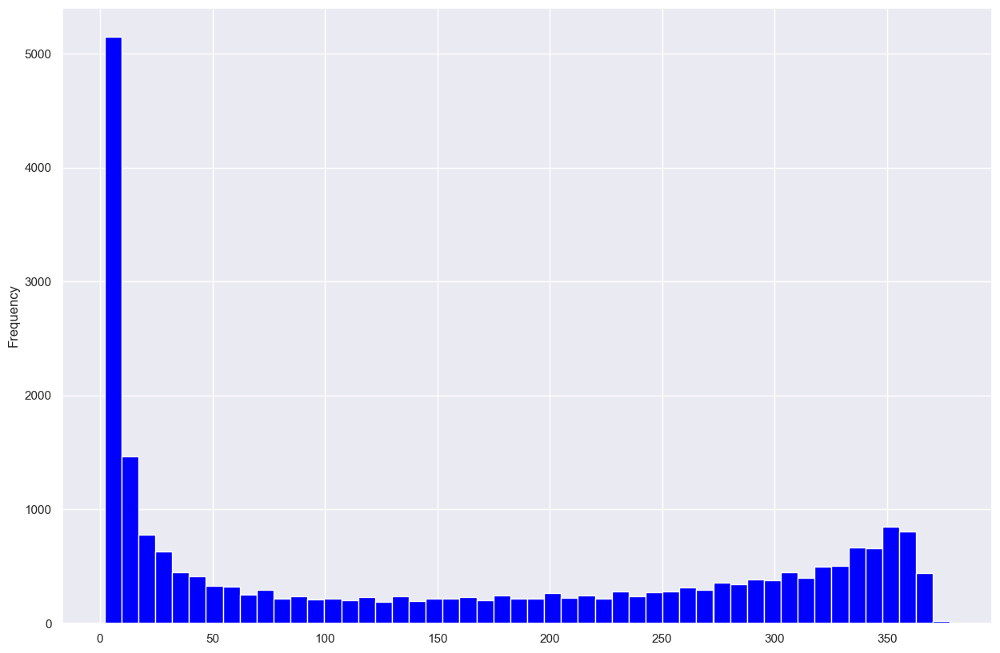

In [62]:
gene_expression = normalized.copy()
gene_expression[gene_expression != 0] = 1 #turning non-zero values into 1 and sum them up
sum_number = count_type_genes.sum(axis = 1)

plt.figure(figsize = (15,10))
sum_number.plot.hist(grid = True, bins = 50, color= "blue")


We can put the CPM threshold more to the left, somewhere around 8, compared to HCC.

In [63]:
cpm_threshold = 8 #for example
to_filter_list = []
for i in range(normalized.shape[0]):
    mask = [element for element in normalized.iloc[i,:] if element >= cpm_threshold]
    if len(mask) <= 2:
      to_filter_list.append(i)
print(f"the initial lenght of cpm values, before filtering out : {len(p_values)}")

indices_to_filter = set(to_filter_list)
cpm_p_values_dict = {
    gene: p for i, (gene, p) in enumerate(p_values.items()) if i not in indices_to_filter
}
cpm_p_values_list = [p for i, p in enumerate(p_values.values()) if i not in indices_to_filter]
print(f"the final length of cpm values after applying threshold of {cpm_threshold}: {len(cpm_p_values_list)}")

the initial lenght of cpm values, before filtering out : 22905
the final length of cpm values after applying threshold of 8: 2678


Q_VALUE THRESHOLD

In [64]:
q_value_threshold = 0.05
q_values = q_value(cpm_p_values_dict)

significant_genes = {gene: cpm_p_values_dict[gene] for gene in cpm_p_values_dict if q_values[gene] <= q_value_threshold}

#significant_genes = {
    #gene: p_values[gene] for gene in p_values 
    #if q_values[gene] <= significance_threshold and gene not in indices_to_filter
#}
# Print the significant genes
#print("Significant genes and their q-values:")
#for gene, qval in significant_genes.items():

#   print(gene, qval)

print(len(significant_genes))

2223


In [65]:
p_values = dict(sorted(p_values.items(), key=lambda item: p_values[item[0]]))
def top_genes(significant_genes, n):
    # Get the top n genes from the significant_genes dictionary
    # Since significant_genes is already filtered, no need to check q-values again
    top_n_genes = list(significant_genes.items())[:n]
    
    # Print the gene names and their p-values (or q-values if you pass those)
    for gene, val in top_n_genes:
        print(gene, val)

# Assuming `significant_genes` is your dictionary of genes to p-values
# with only significant genes based on q-value threshold
top_genes(p_values, 50)

"ENO1" 1.012111318294886e-76
"C4orf3" 1.0159481190740054e-76
"ELOVL2" 7.697179028368844e-64
"PRELID1" 3.4523930049906775e-63
"PARK7" 7.652253226588161e-63
"ATP5F1B" 1.6937365140945265e-60
"AURKAIP1" 4.604802806298738e-58
"ELOVL6" 4.4791351874751035e-56
"PDAP1" 7.87694910875035e-55
"HMGN2" 3.560209047273503e-54
"MTATP6P1" 1.6434400108589553e-51
"SLC2A1" 6.019519161228756e-50
"MXD3" 2.65158516443138e-49
"CTPS1" 1.1510199982668935e-48
"SLC29A1" 2.2590531657578175e-48
"FKBP5" 2.8298297965955475e-48
"RIMKLA" 5.885030679191938e-48
"DSP" 2.1206759644811604e-46
"CCT5" 4.809765727262292e-46
"VEGFA" 1.522710797528544e-43
"SOX4" 4.300491403488863e-43
"PSME2P1" 6.426480992232801e-43
"MYCBP" 1.6821767418603338e-42
"RSBN1" 3.879469507883501e-42
"ADAMTS19-AS1" 7.412588493747047e-42
"SPRY1" 3.043987743554896e-40
"YBX1" 1.2719555448205951e-39
"MCUB" 6.766811453112413e-39
"C6orf141" 6.769860112957623e-38
"ELOVL5" 1.345454625316552e-37
"TLE1" 2.2741024195878215e-37
"MMACHC" 9.427875656319772e-37
"MIR3917

In [66]:
print(np.shape(normalized), len(significant_genes))

(22905, 294) 2223


#### FILTERING OUT THE NORMALIZED DATA WITH SIGNIFICANT GENES

In [67]:
significant_gene_list = list(significant_genes.keys())
final_df = normalized.copy()
final_df = final_df[final_df.index.isin(significant_genes)]

### Final Result

In [68]:
print(f"we moved from {np.shape(df_MCF_SmartS_unfiltered)} to {np.shape(final_df)}")

we moved from (22905, 383) to (2223, 294)


### Non-Parametric

If we re moving from a parametric test like the t-test, which assumes normality, to a nonparametric approach for differential expression analysis, it's a way to address potential issues with the normality assumption. Nonparametric tests can be particularly useful when the data doesn't seem to follow a normal distribution or when you have outliers that could heavily skew the results of parametric tests.

NON-PARAMETRIC TEST

In [69]:
cpm_threshold2 = 8#for example
to_filter_list2 = []
for i in range(normalized.shape[0]):
    mask = [element for element in normalized.iloc[i,:] if element >= cpm_threshold2]
    if len(mask) <= 2:
      to_filter_list2.append(i)
print(f"the initial lenght of cpm values, before filtering out : {len(p_values)}")

indices_to_filter2 = list(to_filter_list2)

cpm_p_values_dict2 = {
    gene: p for i, (gene, p) in enumerate(p_values.items()) if i not in indices_to_filter2
}
cpm_p_values_list2 = [p for i, p in enumerate(p_values.values()) if i not in indices_to_filter2]
print(f"the final length of cpm values after applying threshold of {cpm_threshold2}: {len(cpm_p_values_list2)}")

the initial lenght of cpm values, before filtering out : 22905
the final length of cpm values after applying threshold of 8: 2678


In [70]:
normalized

,"""output.STAR.1_A10_Hypo_S28_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A12_Hypo_S30_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A2_Norm_S2_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A3_Norm_S3_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A4_Norm_S4_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A5_Norm_S5_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A6_Norm_S6_Aligned.sortedByCoord.out.bam""","""output.STAR.1_B10_Hypo_S76_Aligned.sortedByCoord.out.bam""","""output.STAR.1_B11_Hypo_S77_Aligned.sortedByCoord.out.bam""","""output.STAR.1_B12_Hypo_S78_Aligned.sortedByCoord.out.bam""",...,"""output.STAR.4_H10_Hypo_S382_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H14_Hypo_S383_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H1_Norm_S355_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H3_Norm_S357_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H4_Norm_S358_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H5_Norm_S359_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H6_Norm_S360_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H7_Hypo_S379_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H8_Hypo_S380_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H9_Hypo_S381_Aligned.sortedByCoord.out.bam"""
"""WASH7P""",0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,2.365236,0.000000,0.000000,2.661687,0.000000,0.000000,0.000000,2.089981,0.000000,2.071603
"""MIR6859-1""",0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
"""WASH9P""",2.458090,0.000000,0.000000,2.169823,4.074680,2.072767,0.000000,3.129438,3.248437,2.453432,...,3.010281,3.262451,2.430271,0.000000,0.000000,0.000000,2.287957,2.089981,3.278668,3.574806
"""OR4F29""",0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.999464,0.000000
"""MTND1P23""",0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"""MT-TE""",3.778033,0.000000,4.511071,3.189250,0.000000,0.000000,4.517160,3.697592,2.973617,0.000000,...,2.365236,0.000000,3.748276,3.994187,0.000000,3.258219,3.991365,0.000000,3.822004,3.358643
"""MT-CYB""",7.967374,5.951609,9.990384,9.955893,10.895531,10.025656,10.847944,9.431479,8.168453,7.734585,...,7.208983,8.700034,10.579607,10.313778,10.208150,9.564710,10.334916,7.813423,9.542952,8.983719
"""MT-TT""",0.000000,0.000000,0.000000,2.169823,1.914444,2.072767,3.291331,2.276698,3.248437,0.000000,...,0.000000,0.000000,4.297744,3.319294,0.000000,0.000000,3.316523,0.000000,2.622506,2.699687
"""MT-TP""",3.996592,0.000000,0.000000,2.169823,1.914444,3.359929,2.634713,3.129438,3.791269,3.102629,...,2.365236,0.000000,4.984069,4.993995,3.705062,0.000000,4.142873,2.719288,5.191749,4.347861


In [71]:
# Convert list of indices to the actual index labels
indices_to_drop = normalized.index[indices_to_filter2].tolist()
print(len(indices_to_drop))
# Drop the rows corresponding to these indices
np_filtered = normalized.drop(index=indices_to_drop)



20227


In [72]:
print(np.shape(np_filtered))

(2678, 294)


In [73]:
u_test = np_filtered.T.copy()
hypo2 = u_test[u_test.index.str.contains("Hypo")]
hypo2.index = hypo2.index.str.replace("output.STAR.", "", regex=True)
hypo2.index = hypo2.index.str.replace("_Aligned.sortedByCoord.out.bam", "", regex=True)

normo2 = u_test[t_test.index.str.contains("Norm")]
normo2.index = normo2.index.str.replace("output.STAR.", "", regex=True)
normo2.index = normo2.index.str.replace("_Aligned.sortedByCoord.out.bam", "", regex=True)

hypo2 = hypo2.transpose()
normo2 = normo2.transpose()

In [74]:
p_val_row_np = {}
for i in range(len(cpm_p_values_list2)):  
  p_val_row_np[i] = stats.mannwhitneyu(x=hypo2.iloc[i,:], y=normo2.iloc[i,:], alternative = 'two-sided').pvalue

print(len(p_val_row_np))


2678


In [75]:
q_value_threshold2 =  0.001
q_values2 = q_value(cpm_p_values_dict2)

significant_genes2 = {gene: cpm_p_values_dict2[gene] for gene in cpm_p_values_dict2 if q_values2[gene] <= q_value_threshold2}

In [76]:
print(len(significant_genes2))

2057


In [77]:
significant_gene_list2 = list(significant_genes2.keys())
final_df2 = normalized.copy()
final_df2 = final_df2[final_df2.index.isin(significant_genes2)]

In [78]:
final_df2

,"""output.STAR.1_A10_Hypo_S28_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A12_Hypo_S30_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A2_Norm_S2_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A3_Norm_S3_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A4_Norm_S4_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A5_Norm_S5_Aligned.sortedByCoord.out.bam""","""output.STAR.1_A6_Norm_S6_Aligned.sortedByCoord.out.bam""","""output.STAR.1_B10_Hypo_S76_Aligned.sortedByCoord.out.bam""","""output.STAR.1_B11_Hypo_S77_Aligned.sortedByCoord.out.bam""","""output.STAR.1_B12_Hypo_S78_Aligned.sortedByCoord.out.bam""",...,"""output.STAR.4_H10_Hypo_S382_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H14_Hypo_S383_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H1_Norm_S355_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H3_Norm_S357_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H4_Norm_S358_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H5_Norm_S359_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H6_Norm_S360_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H7_Hypo_S379_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H8_Hypo_S380_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H9_Hypo_S381_Aligned.sortedByCoord.out.bam"""
"""WASH9P""",2.458090,0.000000,0.000000,2.169823,4.074680,2.072767,0.000000,3.129438,3.248437,2.453432,...,3.010281,3.262451,2.430271,0.000000,0.000000,0.000000,2.287957,2.089981,3.278668,3.574806
"""MTCO1P12""",3.107496,1.799125,0.000000,3.189250,4.074680,3.576100,3.507006,1.681242,3.463783,3.102629,...,0.000000,3.262451,4.297744,3.994187,0.000000,3.258219,3.812731,0.000000,3.278668,3.082488
"""OR4F16""",0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.972345,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
"""NOC2L""",8.387426,7.680189,8.398849,8.785682,7.961876,8.128889,8.254263,7.653691,7.683780,8.047410,...,7.700775,8.044006,7.940617,7.777103,7.430253,7.964283,8.294890,6.956112,7.945631,7.494331
"""TTLL10""",0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"""MT-TA""",3.107496,0.000000,3.434194,2.804177,2.531021,2.700929,3.684318,3.697592,3.463783,0.000000,...,3.399184,0.000000,4.297744,4.794830,3.036216,3.931951,2.929035,2.089981,1.999464,3.903240
"""MT-CO3""",7.197668,6.097857,9.218622,9.112576,9.910937,9.212165,10.115431,8.762305,7.578787,6.818951,...,7.360986,8.292558,10.107561,10.144720,9.619077,9.220517,9.850039,7.216177,8.628369,8.141796
"""MT-ND4""",9.818739,7.278443,9.400431,9.165060,9.816177,9.235467,10.153431,9.985487,9.964061,9.815387,...,9.322003,10.169456,10.247299,10.312009,9.421636,9.782915,10.427159,7.927015,10.796187,10.740393
"""MT-ND5""",8.593349,1.799125,8.869612,8.844412,8.908920,8.470823,9.740780,8.700192,8.654661,8.602018,...,8.180384,9.052466,9.588136,9.821363,9.100802,9.051003,9.566259,6.087355,9.421393,9.128485


## 4.2. HCC SmartS Dataset

### Unfiltered Data Reading File

In [7]:
# transpose back dataset - needed for merging different parts of the code
df_HCC_SmartS_unfiltered = df_HCC_SmartS_unfiltered.T
df_HCC_SmartS_unfiltered


,"""output.STAR.PCRPlate1A10_Normoxia_S123_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A1_Hypoxia_S97_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A4_Hypoxia_S8_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A5_Hypoxia_S108_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A6_Hypoxia_S11_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A7_Normoxia_S113_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A8_Normoxia_S119_Aligned.sortedByCoord.out.bam""",...,"""output.STAR.PCRPlate4G12_Normoxia_S243_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4G1_Hypoxia_S193_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4G2_Hypoxia_S198_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4G6_Hypoxia_S232_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4G7_Normoxia_S204_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4H10_Normoxia_S210_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4H11_Normoxia_S214_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4H2_Hypoxia_S199_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4H7_Normoxia_S205_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4H9_Normoxia_S236_Aligned.sortedByCoord.out.bam"""
"""WASH7P""",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""CICP27""",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""DDX11L17""",0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""WASH9P""",0,0,0,0,0,0,0,0,1,0,...,0,0,0,0,0,1,0,1,0,0
"""OR4F29""",2,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"""MT-TE""",22,43,0,0,0,3,47,4,2,8,...,24,15,15,4,4,26,1,4,4,20
"""MT-CYB""",4208,6491,25,4819,310,695,2885,1552,366,1829,...,1119,1429,808,999,916,3719,984,2256,981,2039
"""MT-TT""",26,62,0,11,4,0,41,9,2,8,...,48,31,3,8,5,42,1,15,6,34
"""MT-TP""",66,71,1,3,9,14,91,22,3,30,...,119,52,11,22,15,48,18,36,8,79


In [8]:

print("Dataframe dimensions:", np.shape(df_HCC_SmartS_unfiltered))
print("First column: ", df_HCC_SmartS_unfiltered.iloc[ : , 0])

Dataframe dimensions: (23396, 243)
First column:  "WASH7P"         0
"CICP27"         0
"DDX11L17"       0
"WASH9P"         0
"OR4F29"         2
              ... 
"MT-TE"         22
"MT-CYB"      4208
"MT-TT"         26
"MT-TP"         66
"MAFIP"          0
Name: "output.STAR.PCRPlate1A10_Normoxia_S123_Aligned.sortedByCoord.out.bam", Length: 23396, dtype: int64


We want to check if the data is the same across the dataset, and for that we do the following:
* check if the data is int64
* check for unique values (this would indicate any inconsistances or errors in the data)
* check for missing values 
* compute basic statistical measures

In [ ]:
#1
assert [df_HCC_SmartS_unfiltered.dtypes[i] == 'int64' for i in range(len(df_HCC_SmartS_unfiltered.dtypes))]
# we choose to clear the results of this part out as it occupies too much space in the final html file

In [9]:
#2 
unique_value_counts = df_HCC_SmartS_unfiltered.apply(lambda x: x.nunique())
print(unique_value_counts)

"output.STAR.PCRPlate1A10_Normoxia_S123_Aligned.sortedByCoord.out.bam"    1174
"output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam"     1768
"output.STAR.PCRPlate1A1_Hypoxia_S97_Aligned.sortedByCoord.out.bam"        294
"output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.sortedByCoord.out.bam"      1505
"output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam"         618
                                                                          ... 
"output.STAR.PCRPlate4H10_Normoxia_S210_Aligned.sortedByCoord.out.bam"    1171
"output.STAR.PCRPlate4H11_Normoxia_S214_Aligned.sortedByCoord.out.bam"     605
"output.STAR.PCRPlate4H2_Hypoxia_S199_Aligned.sortedByCoord.out.bam"      1189
"output.STAR.PCRPlate4H7_Normoxia_S205_Aligned.sortedByCoord.out.bam"      640
"output.STAR.PCRPlate4H9_Normoxia_S236_Aligned.sortedByCoord.out.bam"     1020
Length: 243, dtype: int64


In [10]:
#3
missing_value_counts = df_HCC_SmartS_unfiltered.isnull().sum()
print(missing_value_counts)

"output.STAR.PCRPlate1A10_Normoxia_S123_Aligned.sortedByCoord.out.bam"    0
"output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam"     0
"output.STAR.PCRPlate1A1_Hypoxia_S97_Aligned.sortedByCoord.out.bam"       0
"output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.sortedByCoord.out.bam"      0
"output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam"        0
                                                                         ..
"output.STAR.PCRPlate4H10_Normoxia_S210_Aligned.sortedByCoord.out.bam"    0
"output.STAR.PCRPlate4H11_Normoxia_S214_Aligned.sortedByCoord.out.bam"    0
"output.STAR.PCRPlate4H2_Hypoxia_S199_Aligned.sortedByCoord.out.bam"      0
"output.STAR.PCRPlate4H7_Normoxia_S205_Aligned.sortedByCoord.out.bam"     0
"output.STAR.PCRPlate4H9_Normoxia_S236_Aligned.sortedByCoord.out.bam"     0
Length: 243, dtype: int64


This means that there are no missing values in our dataset since we would have gotten a Nan

In [11]:
#4
feature_stats = df_HCC_SmartS_unfiltered.describe()
print(feature_stats)

       "output.STAR.PCRPlate1A10_Normoxia_S123_Aligned.sortedByCoord.out.bam"  \
count                                       23396.000000                        
mean                                           99.565695                        
std                                           529.532443                        
min                                             0.000000                        
25%                                             0.000000                        
50%                                             0.000000                        
75%                                            51.000000                        
max                                         35477.000000                        

       "output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam"  \
count                                       23396.000000                       
mean                                          207.678278                       
std                           

#### NA AND 0s

In [ ]:
# unfilter_T = df_HCC_SmartS_unfiltered.transpose()3
# genes_with_max_zero = unfilter_T.columns[(unfilter_T.max() == 0)]
# df_HCC_SmartS_unfiltered = unfilter_T.drop(columns=genes_with_max_zero)
# print(np.shape(df_HCC_SmartS_unfiltered)) #there is no completely 0 



In [93]:
#print(df_HCC_SmartS_unfiltered.isnull().sum()) #luckily we have none

#### Duplicate

In [12]:
dup_rows_df = df_HCC_SmartS_unfiltered[df_HCC_SmartS_unfiltered.duplicated(keep=False)]
print("number of duplicate rows: ", dup_rows_df.shape)
print(dup_rows_df)

number of duplicate rows:  (89, 243)
             "output.STAR.PCRPlate1A10_Normoxia_S123_Aligned.sortedByCoord.out.bam"  \
"MMP23A"                                                     0                        
"LINC01647"                                                  0                        
"LINC01361"                                                  0                        
"ITGA10"                                                     0                        
"RORC"                                                       0                        
...                                                        ...                        
"ENPP7"                                                      0                        
"DTNA"                                                       0                        
"ALPK2"                                                      0                        
"OR7G2"                                                      0                        
"PLVAP

In [13]:
dup_rows_corr = dup_rows_df.T.corr()
print(dup_rows_corr)

             "MMP23A"  "LINC01647"  "LINC01361"  "ITGA10"    "RORC"   "GPA33"  \
"MMP23A"     1.000000    -0.008299    -0.008299 -0.008299 -0.008299 -0.008299   
"LINC01647" -0.008299     1.000000     0.495851  0.495851 -0.008299  0.495851   
"LINC01361" -0.008299     0.495851     1.000000  1.000000  0.495851  1.000000   
"ITGA10"    -0.008299     0.495851     1.000000  1.000000  0.495851  1.000000   
"RORC"      -0.008299    -0.008299     0.495851  0.495851  1.000000  0.495851   
...               ...          ...          ...       ...       ...       ...   
"ENPP7"     -0.008299     0.495851     0.495851  0.495851 -0.008299  0.495851   
"DTNA"      -0.008299     0.495851     1.000000  1.000000  0.495851  1.000000   
"ALPK2"     -0.006540     0.788121     0.081755  0.081755 -0.006540  0.081755   
"OR7G2"     -0.008299     0.495851     0.495851  0.495851 -0.008299  0.495851   
"PLVAP"     -0.008299     0.495851     1.000000  1.000000  0.495851  1.000000   

              "OR2M4"  "LIN

We can see that we have some very high correlation between genes, so there may be duplicates

We create a dict where the keys store a gene and values store a list of genes which are identical with ours

In [14]:
duplicates ={}

for column in dup_rows_corr.columns:
    for row in dup_rows_corr.index:
        if (dup_rows_corr.loc[row, column] == 1 and row != column):
            if row not in duplicates:
                duplicates[row] = []
                duplicates[row].append(column)
print(duplicates)


{'"RPL21P66"': ['"MMP23A"'], '"CNPY1"': ['"LINC01647"'], '"ITGA10"': ['"LINC01361"'], '"GPA33"': ['"LINC01361"'], '"C4orf50"': ['"LINC01361"'], '"SMIM23"': ['"LINC01361"'], '"VNN3"': ['"LINC01361"'], '"TRPV6"': ['"LINC01361"'], '"KCNA4"': ['"LINC01361"'], '"APLNR"': ['"LINC01361"'], '"CYCSP26"': ['"LINC01361"'], '"OR5AU1"': ['"LINC01361"'], '"CD300A"': ['"LINC01361"'], '"DTNA"': ['"LINC01361"'], '"PLVAP"': ['"LINC01361"'], '"LINC01361"': ['"ITGA10"'], '"OR2M4"': ['"RORC"'], '"RORC"': ['"OR2M4"'], '"CUX2"': ['"LINC01247"'], '"RNU6-826P"': ['"SNORD92"'], '"ZBTB45P2"': ['"LINC01106"'], '"LINC01106"': ['"ZBTB45P2"'], '"RNY1P12"': ['"AOX3P"'], '"B3GAT1-DT"': ['"CPS1"'], '"COL2A1"': ['"CPS1"'], '"SOX5"': ['"RPS3AP53"'], '"KCNJ16"': ['"CCR4"'], '"AOX3P"': ['"RNY1P12"'], '"ALPK2"': ['"C4orf45"'], '"PCDHA8"': ['"PCDHA2"'], '"PCDHA2"': ['"PCDHA8"'], '"PCDHGA3"': ['"PCDHGA2"'], '"PCDHGB3"': ['"PCDHGA2"'], '"PCDHGA7"': ['"PCDHGA2"'], '"PCDHGA9"': ['"PCDHGA2"'], '"PCDHGB7"': ['"PCDHGA2"'], '"PCDHGA

In [15]:
df_HCC_SmartS_unfiltered = df_HCC_SmartS_unfiltered.copy().drop_duplicates()
print(np.shape(df_HCC_SmartS_unfiltered))

(23342, 243)


### Variance Threshold

In [16]:
from sklearn.feature_selection import VarianceThreshold

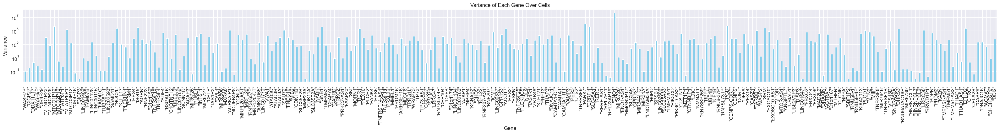

In [17]:
gene_variances = df_HCC_SmartS_unfiltered.var(axis=1)

# Calculate the number of genes that correspond to the first 10%
num_genes = int(len(gene_variances) * 0.01)

# Select the first 10% of genes
top_10_percent_variances = gene_variances.nlargest(num_genes)
top_10_percent_variances = gene_variances[:num_genes]
# Now plot the variances

plt.figure(figsize=(40, 3)) 
plt.yscale('log') # for a better scaling
top_10_percent_variances.plot(kind='bar', color='skyblue')
plt.title('Variance of Each Gene Over Cells')
plt.xlabel('Gene')
plt.ylabel('Variance')
plt.grid(True)
plt.show()

### Correlation Between Cells

In [18]:
#to check if there are any genes with all zero
genes_with_all_zeros = df_HCC_SmartS_unfiltered.columns[(df_HCC_SmartS_unfiltered.sum() == 0)]

print(np.shape(df_HCC_SmartS_unfiltered)) 
df_HCC_SmartS_unfiltered = df_HCC_SmartS_unfiltered.copy().drop(columns=genes_with_all_zeros)
print(np.shape(df_HCC_SmartS_unfiltered)) 



(23342, 243)
(23342, 243)


In [19]:
#checking correlation between cells
corr = df_HCC_SmartS_unfiltered.corr()
print(corr.values.min())


-0.0014178526896174335


Minimum Correlation between Cells:
* The minimum correlation coefficient between cells is approximately -0.0014.
* This value indicates the weakest correlation observed between any pair of cells in the dataset.
* A correlation coefficient very close to zero suggests that there is little to no linear relationship between the gene expression profiles of the corresponding cells.
* In this case, the minimum correlation coefficient indicates that there are pairs of cells that exhibit very weak or negligible similarity in their gene expression patterns.

In [20]:
off_diagonal = corr.values[np.tril_indices_from(corr.values, k=-1)]
average_correlation = np.mean(off_diagonal)
print(average_correlation)

0.7405170972155447


In [21]:

midpoint = (corr.values.max() - corr.values.min()) /2 + corr.values.min()
print(midpoint)

0.49929107365519126


Now we want to see why some cells are completely correlated from the others:


Text(0, 0.5, 'Frequency')

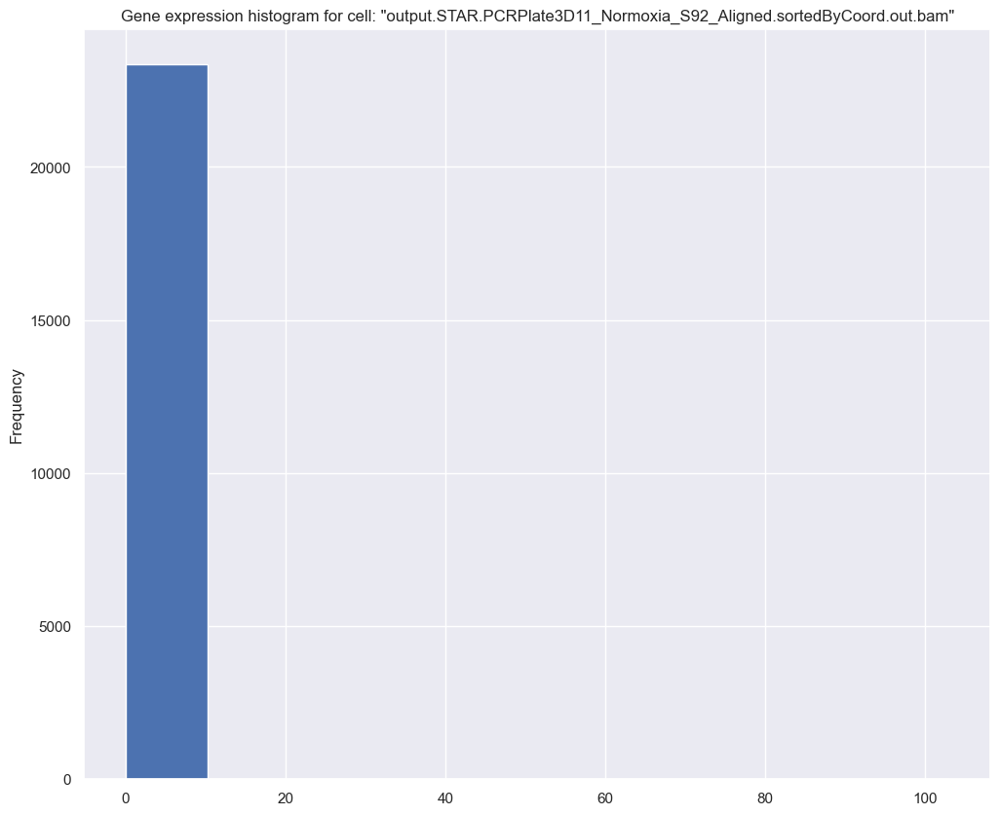

In [23]:
plt.figure(figsize=(12,10))
mini  = np.argmin(list(corr[corr.columns.values[1]]))
plt.hist(df_HCC_SmartS_unfiltered.iloc[:,mini])
plt.title(f"Gene expression histogram for cell: {df_HCC_SmartS_unfiltered.columns.values[mini]}")
plt.ylabel("Frequency")

These cells have zero count for every gene. These cells are abnormal and therefore will need to be removed.

TO SEE HOW MANY UNCORRELATED PAIRS WE HAVE

In [24]:
# Define the threshold for 'extremely uncorrelated' (example: between -0.1 and 0.1)
threshold = 0.01

# Create a mask for the correlation matrix where true values are those that meet the criterion
# for being 'extremely uncorrelated', excluding the diagonal.
mask = np.abs(corr.values) < threshold
np.fill_diagonal(mask, False)

# Extract the row and column indices where the mask is True
uncorrelated_pairs_indices = np.where(mask)

# Retrieve the actual gene names and correlation values for these pairs
uncorrelated_pairs = [(corr.index[i], corr.columns[j], corr.iloc[i, j]) 
                      for i, j in zip(*uncorrelated_pairs_indices)]

# Sort the pairs by the absolute value of their correlation to find the most uncorrelated
print(len(uncorrelated_pairs))


938


### Sparsity

In [25]:
total_elements = df_HCC_SmartS_unfiltered.size
non_zero_elements = df_HCC_SmartS_unfiltered.astype(bool).sum().sum()  # Counts the number of non-zero elements
sparsity = (total_elements - non_zero_elements) / total_elements
print(f'Sparsity: {sparsity:.2%}')

Sparsity: 55.77%


This means that, on average, 55.7% of the data is either 0 or missing values but we have seen that there are no missing values in our dataset. So this means that 55.7% of our dataset is sparse.

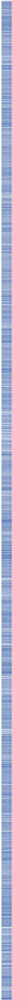

In [26]:
plt.figure(figsize=(25, 600))
plt.spy(df_HCC_SmartS_unfiltered.iloc[:, :], markersize=1)

Here we can see that we have a overall low number of genes expressed and this may be due to problems of measure, health of the single cell, lab mistakes, ecc...

Horizontal white lines in the plot represent groups of genes that are consistently expressed or unexpressed across multiple cells, suggesting coordinated regulation or functional relevance of these gene sets.

### Covariates-Correlation

We now want to analyse the structure among the covariates. Notice that here due to computational power issues we display the correlation just of the first 10% of the genes.

Average correlation between cells:  0.40951765039846083
Minimum correlation between cells:  -0.1809646992030784 



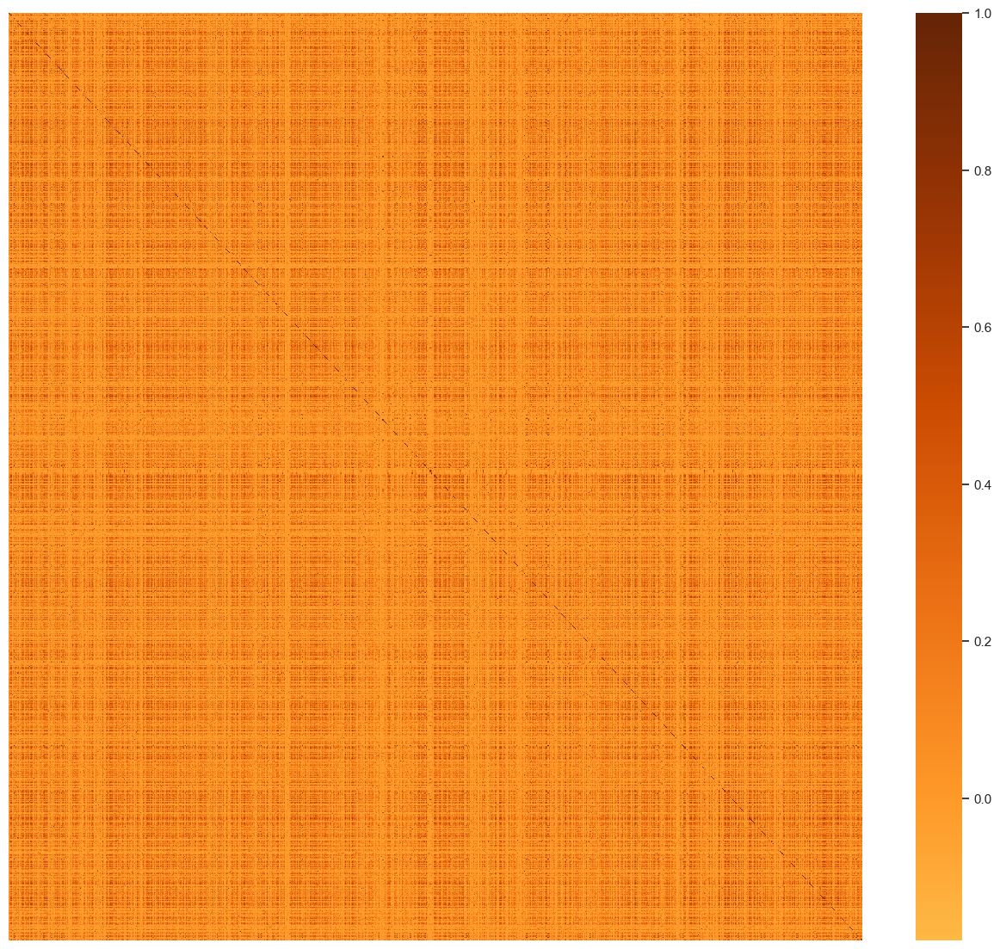

In [27]:
plt.figure(figsize=(16,14))
#df_small = df.iloc[:, :50]
#c= df_small.corr()

#we transpose it because we now look at the correlation between the genes
corr = df_HCC_SmartS_unfiltered.iloc[:3000,:].T.corr()
midpoint = (corr.values.max() - corr.values.min()) /2 + corr.values.min()
#sns.heatmap(c,cmap='coolwarm',annot=True, center=midpoint )
sns.heatmap(corr,cmap="YlOrBr", center=0, yticklabels=False , xticklabels=False)

print("Average correlation between cells: ", midpoint)
print("Minimum correlation between cells: ", corr.values.min(), "\n")

### Skewness and Kurtosis

Skewness:
* measures the degree of asymmetry of the distribution
* a positive skewness value indicates that the distribution is skewed to the right, meaning that the tail of the distribution extends more towards higher values.
* conversely, a negative skewness value indicates that the distribution is skewed to the left, with the tail extending more towards lower values.
* the magnitude of skewness indicates the extent of asymmetry. Larger magnitude values indicate more pronounced skewness

Kurtosis:
* measures the "tailedness" or peakedness of the distribution.
* a positive kurtosis value indicates that the distribution has heavier tails and is more peaked than a normal distribution (leptokurtic).
* a negative kurtosis value indicates that the distribution has lighter tails and is less peaked than a normal distribution (platykurtic).
* higher magnitude values of kurtosis indicate greater "tailedness" or peakedness of the distribution.

In [28]:
from scipy.stats import kurtosis, skew
import random

# Generate random cell indices
random_cells = [random.randrange(df_HCC_SmartS_unfiltered.shape[1]) for _ in range(4)]

# Calculate kurtosis and skewness for each randomly selected cell
for cell_idx in random_cells:
    gene_expression = df_HCC_SmartS_unfiltered.iloc[:, cell_idx]
    cell_skewness = skew(gene_expression)
    cell_kurtosis = kurtosis(gene_expression)
    
    print(f"Cell {cell_idx}:\nSkewness: {cell_skewness:.2f}\nKurtosis: {cell_kurtosis:.2f}\n")


Cell 235:
Skewness: 33.32
Kurtosis: 1582.33

Cell 241:
Skewness: 26.47
Kurtosis: 1104.74

Cell 44:
Skewness: 28.80
Kurtosis: 1283.17

Cell 136:
Skewness: 41.36
Kurtosis: 2507.18



Overall, we can see that these random cells have a gene distribution highly skewed to the right and a very heavy tail with a pronounced peak. These distributions deviate significantly from normality.

In [29]:
df_HCC_SmartS_meta

,Cell Line,PCR Plate,Pos,Condition,Hours,Cell name,PreprocessingTag,ProcessingComments
Filename,,,,,,,,
output.STAR.PCRPlate1A10_Normoxia_S123_Aligned.sortedByCoord.out.bam,HCC1806,1,A10,Normo,24,S123,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam,HCC1806,1,A12,Normo,24,S26,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.PCRPlate1A1_Hypoxia_S97_Aligned.sortedByCoord.out.bam,HCC1806,1,A1,Hypo,24,S97,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.sortedByCoord.out.bam,HCC1806,1,A2,Hypo,24,S104,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam,HCC1806,1,A3,Hypo,24,S4,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
...,...,...,...,...,...,...,...,...
output.STAR.PCRPlate4H10_Normoxia_S210_Aligned.sortedByCoord.out.bam,HCC1806,4,H10,Normo,24,S210,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.PCRPlate4H11_Normoxia_S214_Aligned.sortedByCoord.out.bam,HCC1806,4,H11,Normo,24,S214,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.PCRPlate4H2_Hypoxia_S199_Aligned.sortedByCoord.out.bam,HCC1806,4,H2,Hypo,24,S199,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"


Text(0, 0.5, 'Frequency')

<Figure size 2000x1700 with 0 Axes>

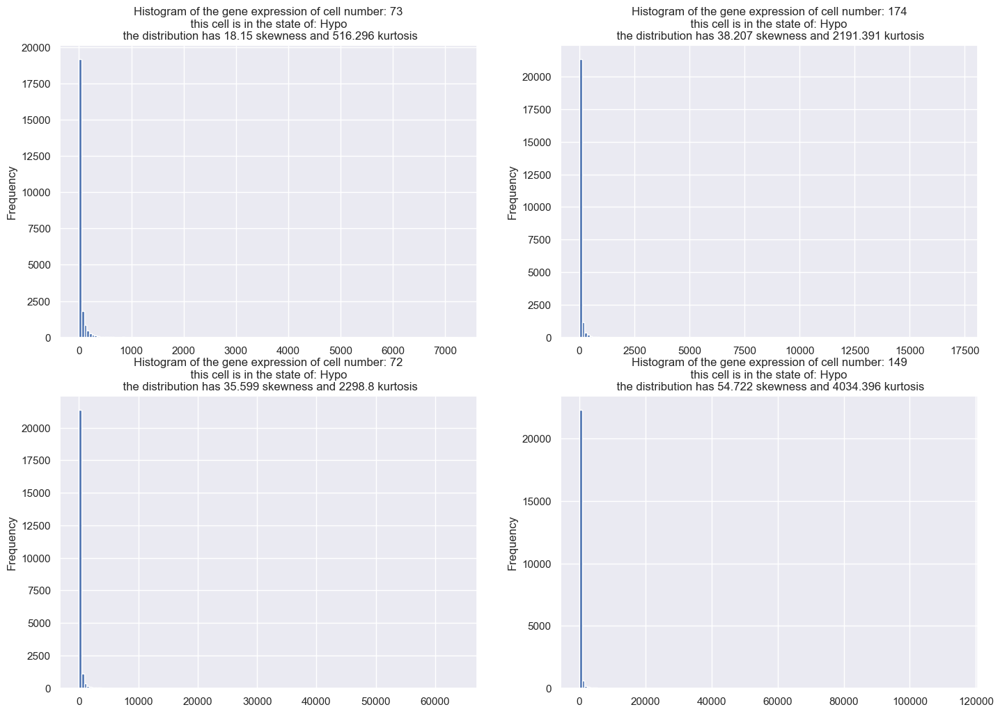

In [30]:
from scipy.stats import kurtosis, skew
import random

plt.figure(figsize=(20, 17))

first_cell = random.randrange(df_HCC_SmartS_unfiltered.shape[1])
second_cell = random.randrange(df_HCC_SmartS_unfiltered.shape[1])
third_cell = random.randrange(df_HCC_SmartS_unfiltered.shape[1])
fourth_cell = random.randrange(df_HCC_SmartS_unfiltered.shape[1])


plt.figure(figsize=(17, 12))

plt.subplot(2, 2, 1)
plt.hist(df_HCC_SmartS_unfiltered.iloc[:,first_cell], bins=150)
plt.title(f"Histogram of the gene expression of cell number: {first_cell}\n this cell is in the state of: {df_HCC_SmartS_meta.iloc[first_cell, 3]} \n the distribution has {round(skew(df_HCC_SmartS_unfiltered.iloc[:,first_cell]), 3)} skewness and {round(kurtosis(df_HCC_SmartS_unfiltered.iloc[:,first_cell]), 3)} kurtosis")
plt.ylabel("Frequency")

plt.subplot(2, 2, 2)
plt.hist(df_HCC_SmartS_unfiltered.iloc[:,second_cell], bins=150)
plt.title(f"Histogram of the gene expression of cell number: {second_cell}\n this cell is in the state of: {df_HCC_SmartS_meta.iloc[second_cell, 3]} \n the distribution has {round(skew(df_HCC_SmartS_unfiltered.iloc[:,second_cell]), 3)} skewness and {round(kurtosis(df_HCC_SmartS_unfiltered.iloc[:,second_cell]), 3)} kurtosis")
plt.ylabel("Frequency")

plt.subplot(2, 2, 3)
plt.hist(df_HCC_SmartS_unfiltered.iloc[:,third_cell], bins=150)
plt.title(f"Histogram of the gene expression of cell number: {third_cell}\n this cell is in the state of: {df_HCC_SmartS_meta.iloc[third_cell, 3]} \n the distribution has {round(skew(df_HCC_SmartS_unfiltered.iloc[:,third_cell]), 3)} skewness and {round(kurtosis(df_HCC_SmartS_unfiltered.iloc[:,third_cell]), 3)} kurtosis")
plt.ylabel("Frequency")

plt.subplot(2, 2, 4)
plt.hist(df_HCC_SmartS_unfiltered.iloc[:,fourth_cell], bins=150)
plt.title(f"Histogram of the gene expression of cell number: {fourth_cell}\n this cell is in the state of: {df_HCC_SmartS_meta.iloc[fourth_cell, 3]} \n the distribution has {round(skew(df_HCC_SmartS_unfiltered.iloc[:,fourth_cell]), 3)} skewness and {round(kurtosis(df_HCC_SmartS_unfiltered.iloc[:,fourth_cell]), 3)} kurtosis")
plt.ylabel("Frequency")


The result is as expected by choosing at random four cells in our sample. The histogram is showing how for these cells the big majority of genes have zero reads, but those who are not can count up to almost 45000 reads (seen from the table above). Moreover, from the values of kurtosis and skewness we see that the distributions are highly non normal

As the the kurtosis for normal distribution is 0 and the skewness is 0. 
But some accepted normal values for kurtosis can be between -2 and +2 and for skewness between -0.5 and +0.5. So we can see that we are talking about a very different, non normal distribution.

We learn an important thing about this dataset, the interesting datapoints are the outliers! This means that we cannot procede with the elimination of the outliers as you would normally do, because it would leave us with no information at all



### Removing Outliers

If we try to remove the outliers by computing the inter quantile range and use this to define outliers and filter them as below:

In [31]:
Q1 = df_HCC_SmartS_unfiltered.quantile(0.25)
Q3 = df_HCC_SmartS_unfiltered.quantile(0.75)
IQR = Q3 - Q1
print(IQR)

"output.STAR.PCRPlate1A10_Normoxia_S123_Aligned.sortedByCoord.out.bam"     52.0
"output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam"     126.0
"output.STAR.PCRPlate1A1_Hypoxia_S97_Aligned.sortedByCoord.out.bam"         5.0
"output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.sortedByCoord.out.bam"       40.0
"output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam"         22.0
                                                                          ...  
"output.STAR.PCRPlate4H10_Normoxia_S210_Aligned.sortedByCoord.out.bam"     76.0
"output.STAR.PCRPlate4H11_Normoxia_S214_Aligned.sortedByCoord.out.bam"     24.0
"output.STAR.PCRPlate4H2_Hypoxia_S199_Aligned.sortedByCoord.out.bam"       68.0
"output.STAR.PCRPlate4H7_Normoxia_S205_Aligned.sortedByCoord.out.bam"      23.0
"output.STAR.PCRPlate4H9_Normoxia_S236_Aligned.sortedByCoord.out.bam"      45.0
Length: 243, dtype: float64


Let's try to eliminate those using inter quantile range:

In [32]:
#create a new dataset
unfilt_n = df_HCC_SmartS_unfiltered[~((df_HCC_SmartS_unfiltered < (Q1 - 1.5 * IQR)) |(df_HCC_SmartS_unfiltered> (Q3 + 1.5 * IQR))).any(axis=1)]
unfilt_n.shape
unfilt_n.head(3)

,"""output.STAR.PCRPlate1A10_Normoxia_S123_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A1_Hypoxia_S97_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A4_Hypoxia_S8_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A5_Hypoxia_S108_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A6_Hypoxia_S11_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A7_Normoxia_S113_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A8_Normoxia_S119_Aligned.sortedByCoord.out.bam""",...,"""output.STAR.PCRPlate4G12_Normoxia_S243_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4G1_Hypoxia_S193_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4G2_Hypoxia_S198_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4G6_Hypoxia_S232_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4G7_Normoxia_S204_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4H10_Normoxia_S210_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4H11_Normoxia_S214_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4H2_Hypoxia_S199_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4H7_Normoxia_S205_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4H9_Normoxia_S236_Aligned.sortedByCoord.out.bam"""
"""WASH7P""",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""CICP27""",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""DDX11L17""",0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


Look at violin plots with the outliers removed:

<Axes: xlabel='"output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam"'>

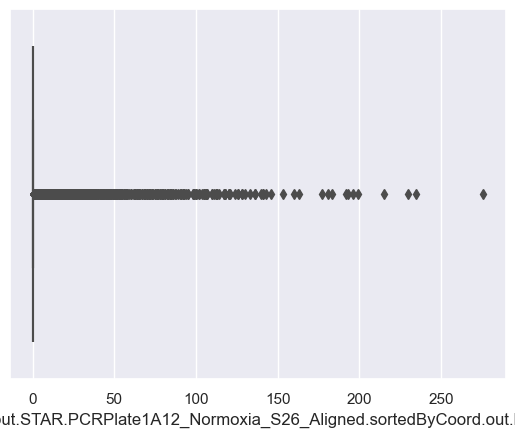

In [33]:
cnames = list(df_HCC_SmartS_unfiltered.columns)
sns.boxplot(x=unfilt_n[cnames[1]])

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

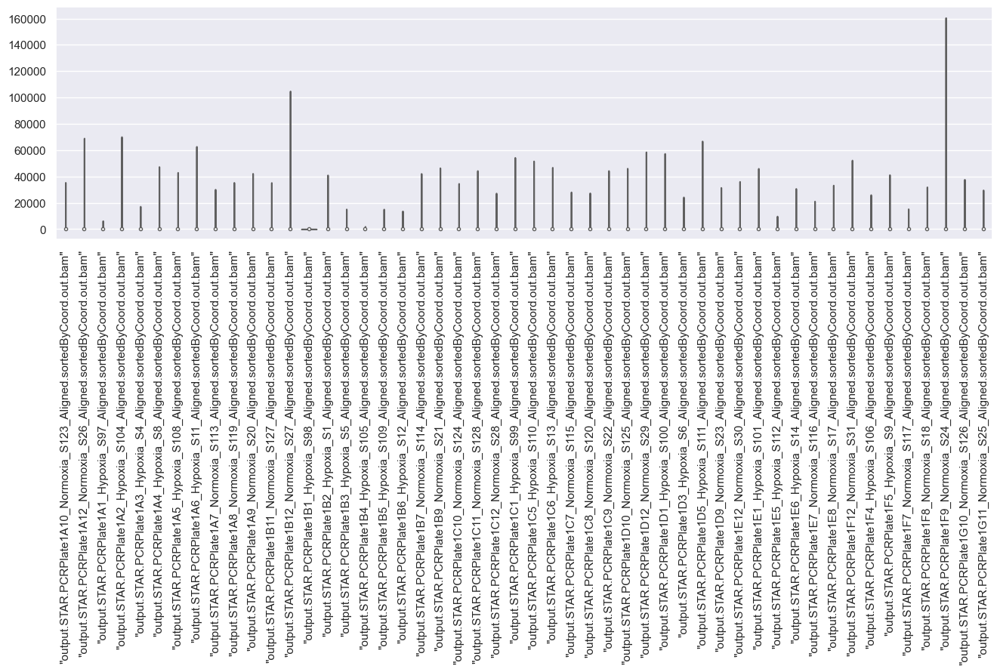

In [34]:
unfilt_n_small = df_HCC_SmartS_unfiltered.iloc[:, :50]
np.shape(unfilt_n_small)
plt.figure(figsize=(16,4))
plot=sns.violinplot(data=unfilt_n_small,palette="Set3",cut=0)
plt.setp(plot.get_xticklabels(), rotation=90)

This is not good as we have just 0 now. So simply removing the outliers now doesn't work here as we would loose a lot of information.

Now that we assessed that there are a lot of zeros in our dataset, we want to see for some genes how is the distributions on non-zero values, maybe there are some sort of clusters that we can identify (at least that's what we would expect: if the gene is expressed we will record a certain gene expression (more or less) and if it's not expressed we recover almost all zeros. Mathematically we would expect the histogram to show a binomodal behaviour with one of the peaks around zero.

Text(0, 0.5, 'Frequency (possibly scaled)')

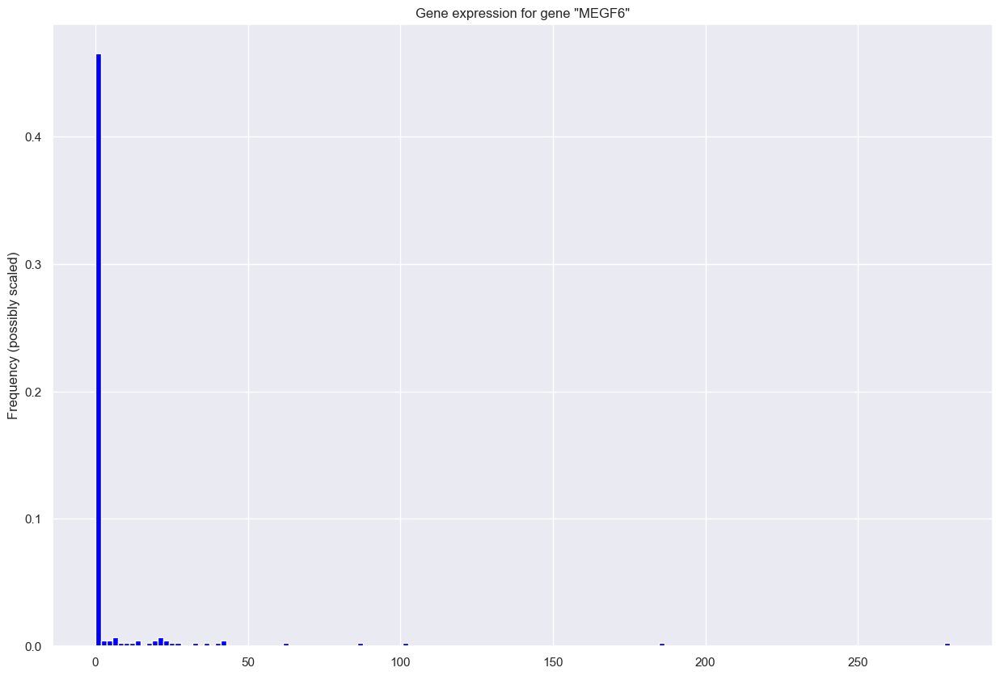

In [35]:
rdn_gene = random.randrange(df_HCC_SmartS_unfiltered.shape[0])

plt.figure(figsize=(15, 10))
df_HCC_SmartS_unfiltered.iloc[rdn_gene, :].plot.hist(grid=True,
                                      density = True, 
                                      bins=150,
                                      color='blue')

plt.title(f"Gene expression for gene {df_HCC_SmartS_unfiltered.index[rdn_gene]}")
plt.ylabel("Frequency (possibly scaled)")

Here are some conclusions from this plotting, as other genes will display a similar distribution:
* A low number of counts associated with a higher number of genes
* A long right tail due to the lack of upper limits for expression
* A large range

Next, let us further investigate the relation between mean and variance of the gene expression among cells:

Text(0, 0.5, 'Variance')

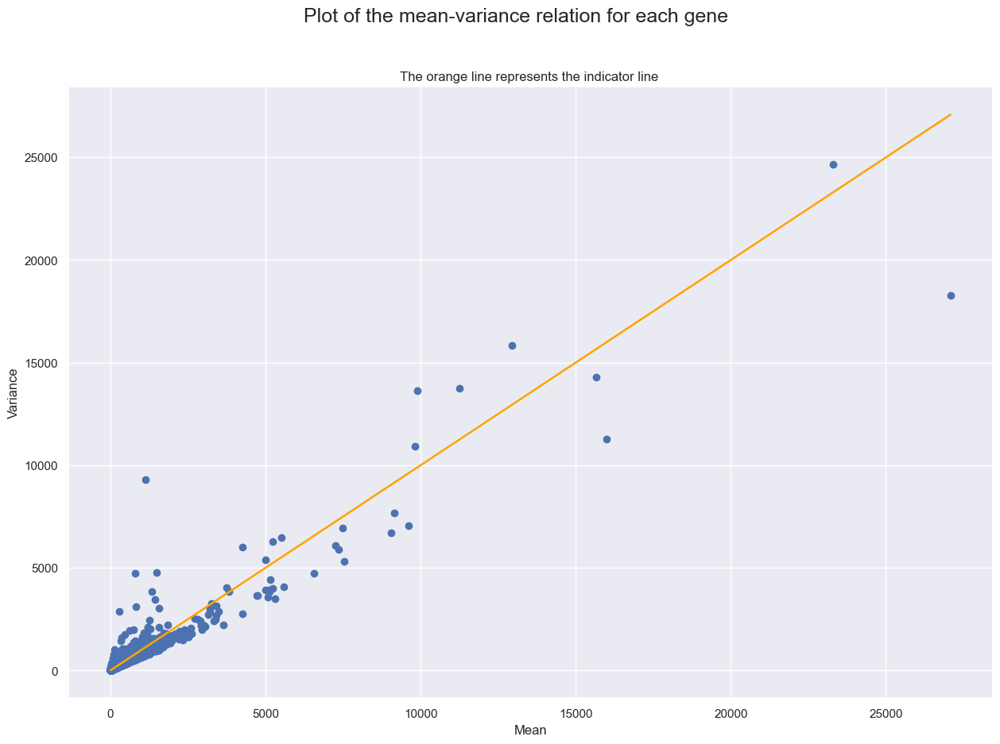

In [36]:
mean_vector = df_HCC_SmartS_unfiltered.T.describe().iloc[1,:]
var_vector = df_HCC_SmartS_unfiltered.T.describe().iloc[2,:]

plt.figure(figsize=(15, 10))
plt.scatter(mean_vector, var_vector)
plt.plot(mean_vector, mean_vector, color = "orange")
plt.title("The orange line represents the indicator line ", fontsize = 12)
plt.suptitle("Plot of the mean-variance relation for each gene", fontsize = 18)
plt.xlabel("Mean")
plt.ylabel("Variance")

### Filtering

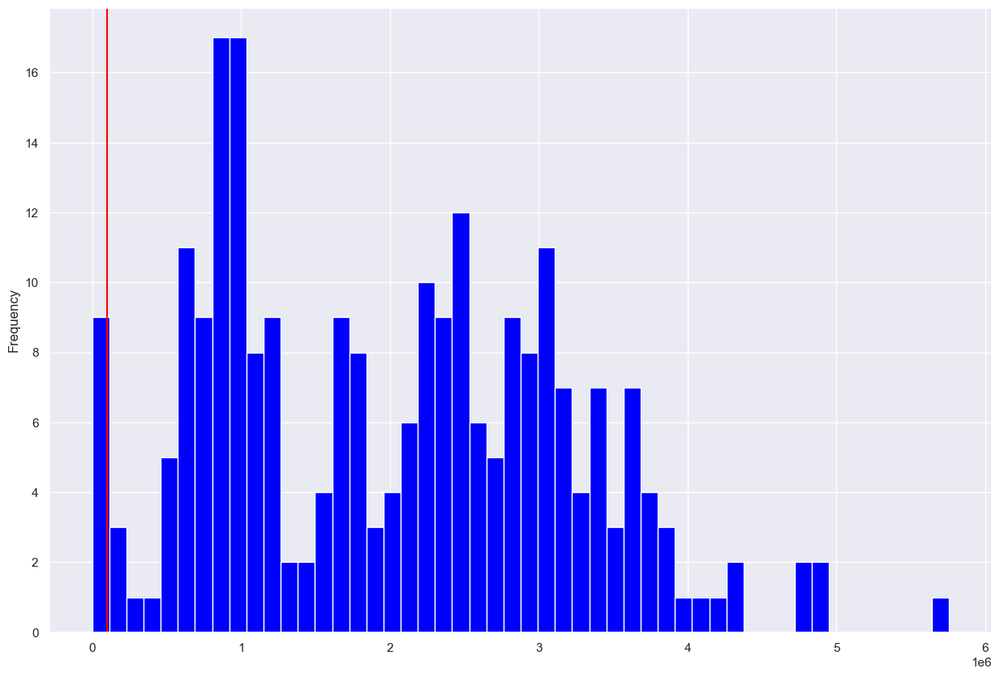

In [37]:
#creating a new data frame with all of the sums of genes 
sum_genes = df_HCC_SmartS_unfiltered.sum(axis = 0)

plt.figure(figsize = (15,10))
sum_genes.plot.hist(grid = True, bins = 50, color= "blue")
plt.axvline(x = .10e6, color = 'red')

WE ARE REMOVING THE GENES THAT LEFT ON THE LEFT SIDE OF THE THRESHOLD, because we have to follow a normal distribution in the count of genes since all of these rooted back to the same cell-line. , because their gene expression may be corrupted by human mistakes in extracting the data or by the health status of the cell itself

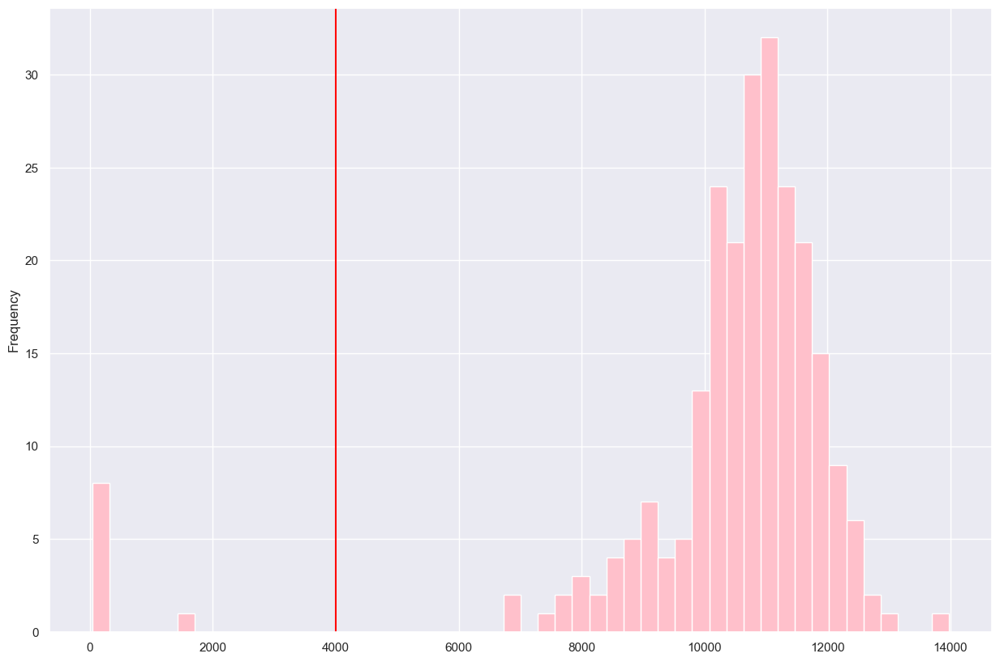

In [38]:
count_type_genes = df_HCC_SmartS_unfiltered.copy()
count_type_genes[count_type_genes != 0] = 1 #turning non-zero values into 1 and sum them up
sum_number = count_type_genes.sum(axis = 0)

plt.figure(figsize = (15,10))
sum_number.plot.hist(grid = True, bins = 50, color= "pink")
plt.axvline(x = 4000, color = 'red') #THRESHOLD

#### REMOVAL OF EXCLUDED CELLS FROM NORMAL DISTRIBUTION

In [39]:
filtered  = df_HCC_SmartS_unfiltered.loc[:, (count_type_genes.sum(axis = 0) >= 4000)]
#(sum_genes >= .10e6) &
perc_cell_lost = (df_HCC_SmartS_unfiltered.shape[1] - filtered.shape[1]) / df_HCC_SmartS_unfiltered.shape[1] * 100

print(np.shape(filtered), perc_cell_lost) # WE MOVED FROM 243 TO 23O

(23342, 234) 3.7037037037037033


#### THE RULE OF THUMB

We now want to study the percentage of mitochondrial RNA and cut those cells at a rate that is too high (above 4%/5% is the rule of thumb that we adopt here, but in general this trashold is study-specific and there's active discussion inside the community about how to decide it). The idea behind this filtering is that when a cell is lysed during the process of Rna extraction or the cell membrane is disrupted, the cytoplasmatic transcript is released while mitochondrial RNA is more protected because of a double membrane around mitochondria. Therefore the high percentage of mtRNA would indicate poor quality of the cell condition

['"INMT-MINDY4"', '"MT-TF"', '"MT-RNR1"', '"MT-TV"', '"MT-RNR2"', '"MT-TL1"', '"MT-ND1"', '"MT-TI"', '"MT-TQ"', '"MT-TM"', '"MT-ND2"', '"MT-TW"', '"MT-TA"', '"MT-TC"', '"MT-TY"', '"MT-CO1"', '"MT-TS1"', '"MT-TD"', '"MT-CO2"', '"MT-TK"', '"MT-ATP8"', '"MT-ATP6"', '"MT-CO3"', '"MT-TG"', '"MT-ND3"', '"MT-TR"', '"MT-ND4L"', '"MT-ND4"', '"MT-TH"', '"MT-TS2"', '"MT-TL2"', '"MT-ND5"', '"MT-ND6"', '"MT-TE"', '"MT-CYB"', '"MT-TT"', '"MT-TP"']
['"INMT-MINDY4"', '"MT-TF"', '"MT-RNR1"', '"MT-TV"', '"MT-RNR2"', '"MT-TL1"', '"MT-ND1"', '"MT-TI"', '"MT-TQ"', '"MT-TM"', '"MT-ND2"', '"MT-TW"', '"MT-TA"', '"MT-TC"', '"MT-TY"', '"MT-CO1"', '"MT-TS1"', '"MT-TD"', '"MT-CO2"', '"MT-TK"', '"MT-ATP8"', '"MT-ATP6"', '"MT-CO3"', '"MT-TG"', '"MT-ND3"', '"MT-TR"', '"MT-ND4L"', '"MT-ND4"', '"MT-TH"', '"MT-TS2"', '"MT-TL2"', '"MT-ND5"', '"MT-ND6"', '"MT-TE"', '"MT-CYB"', '"MT-TT"', '"MT-TP"']
"output.STAR.PCRPlate1A10_Normoxia_S123_Aligned.sortedByCoord.out.bam"    0.036439
"output.STAR.PCRPlate1A12_Normoxia_S26_Al

<Axes: ylabel='Frequency'>

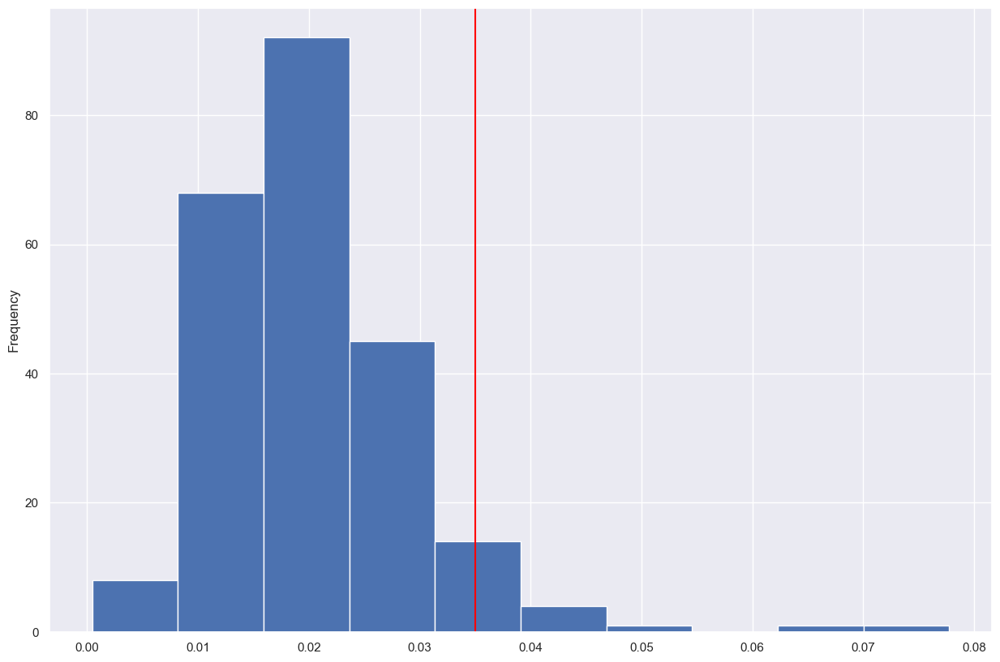

In [40]:
mt_gene_names = filtered.index[filtered.index.str.contains("MT-")].tolist()

print(mt_gene_names)
#mt_gene_names.remove(mt_gene_names[0]) #cause it had the first "INMT-MINDY4", that is not initialized with MT, so er remopved it manually
print(mt_gene_names)

sum_mt_genes = filtered.loc[mt_gene_names].sum(axis = 0)
total = filtered.sum(axis = 0)

mito_ratio = sum_mt_genes / total
print(mito_ratio)
plt.figure(figsize=(15, 10))
plt.axvline(x=0.035, color = "red") #Where do we want to do the cut in our filtering
mito_ratio.plot.hist()

In [41]:
filtered_cells = filtered.loc[:, (mito_ratio <= 0.035)]
cell_lost = (filtered.shape[1] - filtered_cells.shape[1]) / filtered.shape[1] * 100

print(np.shape(filtered_cells), cell_lost) # WE MOVED FROM 243 TO 23O

(23342, 219) 6.41025641025641


### Normalization

Library Size Normalization is a crucial preprocessing step in the analysis of RNA-sequencing (RNA-seq) or other sequencing data where the number of reads or counts per sample can vary considerably. This variation can be due to differences in sequencing depth or efficiency across different samples, rather than reflecting genuine biological differences in gene expression levels. Without proper normalization, comparing expression levels across samples can be misleading. The right way has to be chosen.

In [42]:
#print(filtered_cells.index)
gene_name = filtered_cells.index[filtered_cells.index.str.contains("KAZN")].tolist()

print(gene_name)

['"KAZN"']


/var/folders/sc/040g6l752pg38ngvcz_ths0c0000gn/T/ipykernel_43285/2513447728.py:12: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(filtered_cells.iloc[gene_number, :], fit=stats.gamma,


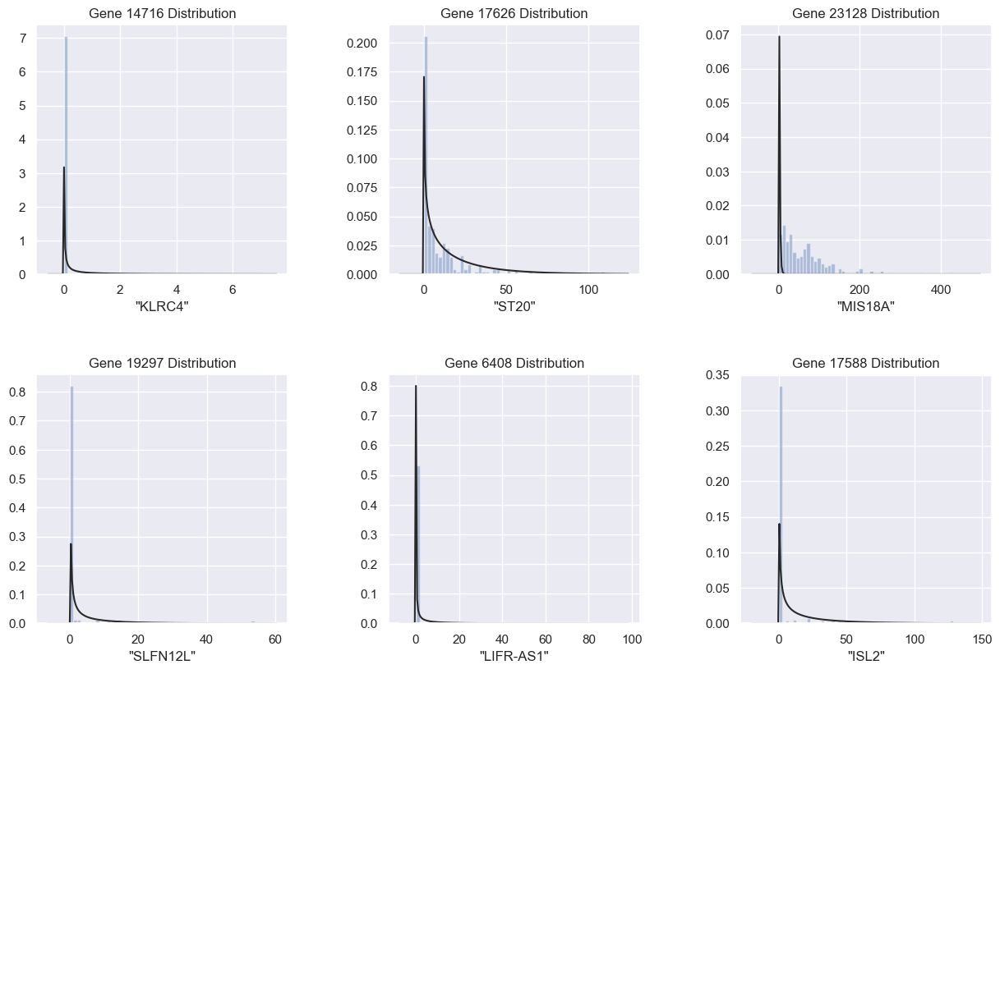

In [43]:
import scipy.stats as stats
import random

gene_numbers = random.sample(range(filtered_cells.shape[0]), 6)

fig, axes = plt.subplots(3, 3, figsize=(15, 15))  # Adjust the figure size as needed
fig.subplots_adjust(hspace=0.4, wspace=0.4)  

axes_flat = axes.flatten()

for i, gene_number in enumerate(gene_numbers):
    sns.distplot(filtered_cells.iloc[gene_number, :], fit=stats.gamma,
                 kde=False, bins=50, ax=axes_flat[i])
    axes_flat[i].set_title(f'Gene {gene_number} Distribution')

# If you don't want to plot on the remaining subplots, you can turn them off
for j in range(i+1, 9):
    axes_flat[j].axis('off')

plt.show()


gene that is not highly expressed in the majority of these cells, with most cells showing low to no expression. However, there are cells with higher expression levels, though they are much fewer in number. so gamma distribution is a very nice fit to this distribution. because of sparsity.
we need to make sure the same distribution is sustained when normalized.

first apply CPM, so that sum of all genes in each cell is the same.This normalization makes it possible to compare gene expression levels across different samples by accounting for differences in sequencing depth (total read count).

In [44]:
normalized = filtered_cells.copy()

#for cell_number in range(normalized.shape[1]):
    #normalized.iloc[:, cell_number] = normalized.iloc[:, cell_number]/(sum(normalized.iloc[:, cell_number]))/10e6
for i in range(normalized.shape[1]):
  normalized.iloc[:,i] = normalized.iloc[:,i]/(sum(normalized.iloc[:,i])/10e6)

In [45]:
normalized.head(10)

,"""output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A1_Hypoxia_S97_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A4_Hypoxia_S8_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A5_Hypoxia_S108_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A6_Hypoxia_S11_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A7_Normoxia_S113_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A8_Normoxia_S119_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A9_Normoxia_S20_Aligned.sortedByCoord.out.bam""",...,"""output.STAR.PCRPlate4G12_Normoxia_S243_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4G1_Hypoxia_S193_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4G2_Hypoxia_S198_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4G6_Hypoxia_S232_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4G7_Normoxia_S204_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4H10_Normoxia_S210_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4H11_Normoxia_S214_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4H2_Hypoxia_S199_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4H7_Normoxia_S205_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4H9_Normoxia_S236_Aligned.sortedByCoord.out.bam"""
"""WASH7P""",0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
"""CICP27""",0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
"""DDX11L17""",0.000000,0.000000,0.000000,0.000000,9.077054,0.000000,0.000000,0.000000,0.000000,5.295113,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
"""WASH9P""",0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,11.141292,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,4.081068,0.000000,3.950472,0.000000,0.000000
"""OR4F29""",0.000000,0.000000,0.000000,0.000000,0.000000,2.797290,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
"""MTND1P23""",872.769549,485.008818,178.736791,323.289410,735.241391,853.173343,257.961088,512.499415,1662.290242,603.642826,...,1147.517584,457.581210,371.877809,387.776147,517.629729,595.835923,449.516830,327.889188,538.939528,1394.936883
"""MTND2P28""",205.841875,0.000000,45.393471,35.921046,9.077054,195.810276,25.166935,55.706458,93.914703,190.624050,...,151.136462,141.728693,63.298350,57.448318,59.157683,191.810194,72.894621,118.514164,80.267589,212.881934
"""MTCO1P12""",4816.699869,970.017637,2893.833751,3628.025600,5328.230819,7194.628980,3158.450396,4935.592193,7315.955357,4474.370067,...,3576.896273,3199.019075,5095.517211,5543.762692,4392.457987,3921.906316,4519.466509,4456.132575,2958.434002,5490.113035
"""MTCO2P12""",10.292094,0.000000,8.511276,0.000000,0.000000,2.797290,15.729335,0.000000,18.782941,0.000000,...,5.597647,8.098782,0.000000,14.362080,14.789421,4.081068,0.000000,15.801889,11.466798,0.000000
"""MTATP8P1""",2.058419,0.000000,0.000000,0.000000,0.000000,8.391869,0.000000,0.000000,9.391470,5.295113,...,0.000000,4.049391,0.000000,0.000000,29.578842,0.000000,0.000000,0.000000,0.000000,0.000000


to make it close to a normal distribution, we need to apply log transformation. but first check if the distribution has been disturbed, which gamma in prior

/var/folders/sc/040g6l752pg38ngvcz_ths0c0000gn/T/ipykernel_43285/3853355528.py:9: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(normalized.iloc[gene_numbers_norm, :], fit=stats.gamma,


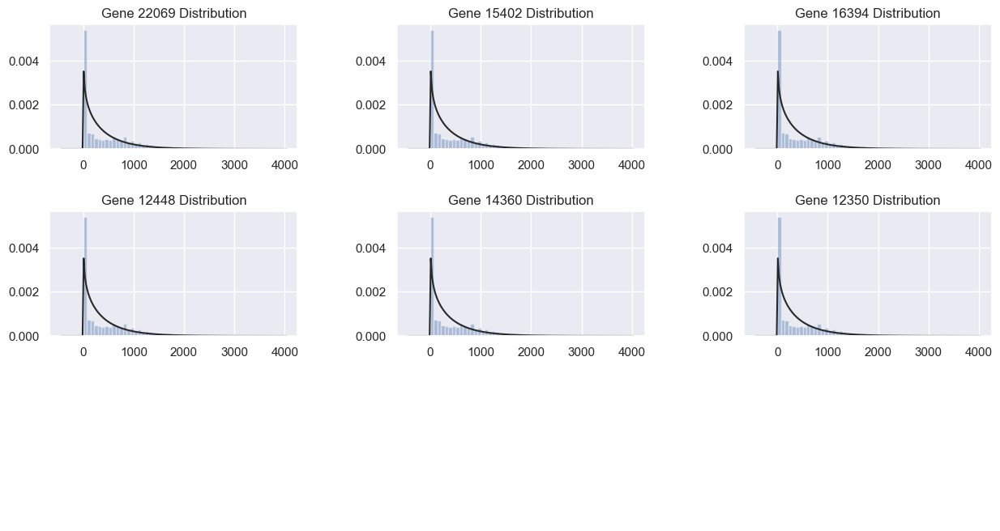

In [46]:
gene_numbers_norm = random.sample(range(normalized.shape[0]), 6)

fig, axes = plt.subplots(3, 3, figsize=(15, 8))  # Adjust the figure size as needed
fig.subplots_adjust(hspace=0.5, wspace=0.4)  

axes_flat = axes.flatten()

for i, gene_number in enumerate(gene_numbers_norm):
    sns.distplot(normalized.iloc[gene_numbers_norm, :], fit=stats.gamma,
                 kde=False, bins=50, ax=axes_flat[i])
    axes_flat[i].set_title(f'Gene {gene_number} Distribution')

# If you don't want to plot on the remaining subplots, you can turn them off
for j in range(i+1, 9):
    axes_flat[j].axis('off')

plt.show()

it is not normalized yet, as it can be seen from the graph

/var/folders/sc/040g6l752pg38ngvcz_ths0c0000gn/T/ipykernel_43285/2906230858.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(normalized.iloc[gene_norm_rand, :], fit=stats.norm,


<Axes: xlabel='"P4HA2"'>

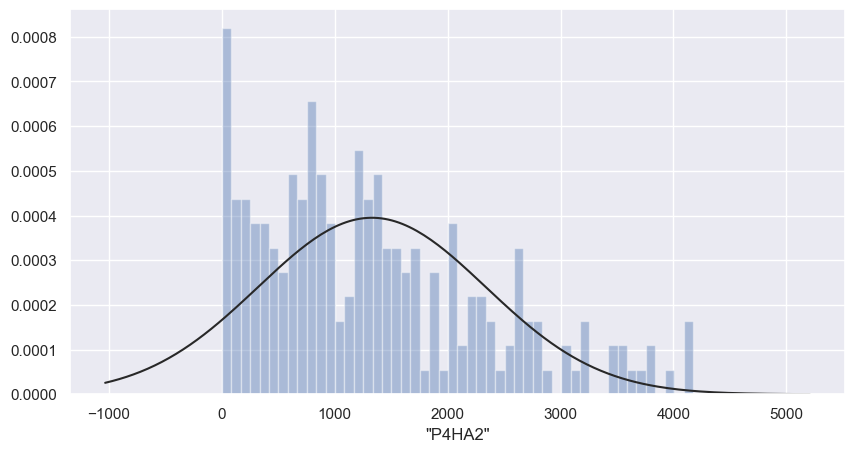

In [47]:
gene_norm_rand = random.randrange(normalized.shape[0])

plt.figure(figsize=(10,5))
sns.distplot(normalized.iloc[gene_norm_rand, :], fit=stats.norm, 
                                          kde=False, 
                                          bins = 50)

/var/folders/sc/040g6l752pg38ngvcz_ths0c0000gn/T/ipykernel_43285/3403879344.py:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(normalized.iloc[gene_norm_rand_log, :], fit=stats.norm,


<Axes: xlabel='"RPL12P24"'>

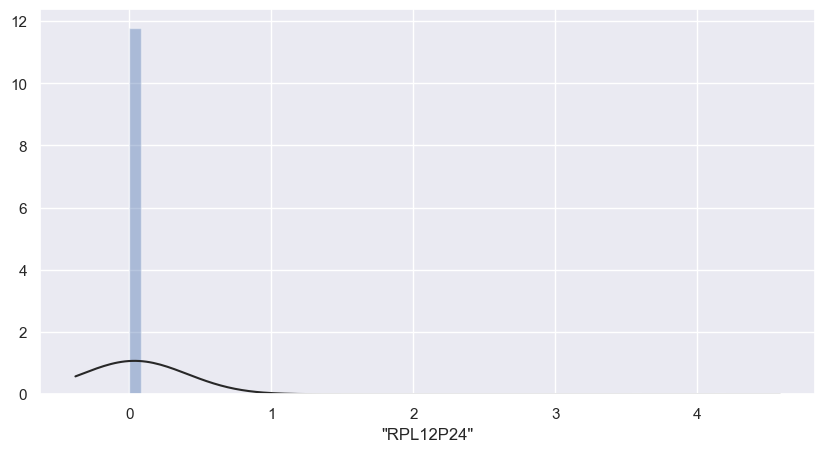

In [48]:
normalized = np.log(normalized.copy() + 1)

gene_norm_rand_log = random.randrange(normalized.shape[0])

plt.figure(figsize=(10,5))
sns.distplot(normalized.iloc[gene_norm_rand_log, :], fit=stats.norm, 
                                          kde=False, 
                                          bins = 50)

T-TEST 

creating two datasets with hypo and norm, and clearing out the names

In [49]:
normalized

,"""output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A1_Hypoxia_S97_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A4_Hypoxia_S8_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A5_Hypoxia_S108_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A6_Hypoxia_S11_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A7_Normoxia_S113_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A8_Normoxia_S119_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A9_Normoxia_S20_Aligned.sortedByCoord.out.bam""",...,"""output.STAR.PCRPlate4G12_Normoxia_S243_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4G1_Hypoxia_S193_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4G2_Hypoxia_S198_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4G6_Hypoxia_S232_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4G7_Normoxia_S204_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4H10_Normoxia_S210_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4H11_Normoxia_S214_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4H2_Hypoxia_S199_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4H7_Normoxia_S205_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4H9_Normoxia_S236_Aligned.sortedByCoord.out.bam"""
"""WASH7P""",0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
"""CICP27""",0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
"""DDX11L17""",0.000000,0.000000,0.000000,0.000000,2.310261,0.000000,0.000000,0.000000,0.000000,1.839774,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
"""WASH9P""",0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.496612,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,1.625521,0.000000,1.599483,0.000000,0.000000
"""OR4F29""",0.000000,0.000000,0.000000,0.000000,0.000000,1.334288,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"""MT-TE""",4.494373,0.000000,0.000000,0.000000,3.340426,4.886376,2.608853,3.147706,4.332466,4.511045,...,4.907816,4.122946,4.784858,4.068143,4.096969,4.673835,2.576354,2.821491,3.847318,4.727769
"""MT-CYB""",9.500185,7.006054,9.523174,8.219553,8.749820,8.996055,8.493594,8.313537,9.751385,9.794540,...,8.742697,8.663470,8.763136,9.571416,9.514002,9.627635,9.388965,9.095296,9.328117,9.343454
"""MT-TT""",4.856878,0.000000,3.472215,3.889670,0.000000,4.750904,3.378024,3.147706,4.332466,3.884775,...,5.597262,4.840488,3.208295,4.752699,4.316783,5.149846,2.576354,4.098620,4.245645,5.254748
"""MT-TP""",4.991437,3.808698,2.252478,4.689172,4.852645,5.543431,4.251478,3.538750,5.644542,5.282793,...,6.502970,5.354548,4.477737,5.758794,5.406460,5.282652,5.392190,4.964361,4.529739,6.094856


In [50]:
t_test = normalized.T.copy()
hypo = t_test[t_test.index.str.contains("Hypoxia")]
hypo.index = hypo.index.str.replace("output.STAR.PCRPlate", "", regex=True)
hypo.index = hypo.index.str.replace("_Aligned.sortedByCoord.out.bam", "", regex=True)

normo = t_test[t_test.index.str.contains("Normoxia")]
normo.index = normo.index.str.replace("output.STAR.PCRPlate", "", regex=True)
normo.index = normo.index.str.replace("_Aligned.sortedByCoord.out.bam", "", regex=True)

hypo = hypo.transpose()
normo = normo.transpose()

In [51]:
print(np.shape(normo), np.shape(hypo))

(23342, 104) (23342, 115)


In [52]:
from scipy.stats import ttest_ind

p_values = {}

for gene in range(normalized.shape[0]):
    hypoxia_values = hypo.iloc[gene, :]
    normoxia_values = normo.iloc[gene, :]
    t_stat, p_val = ttest_ind(hypoxia_values, normoxia_values, equal_var=False) #WELCH'S TEST SINCE VARIATIONS ARE DIFFERENT
    p_values[normalized.index[gene]] = p_val    

APPLYING FDR AND q_VALUES
By filtering for low q-values, you are essentially saying, "I want to consider only those genes for which the evidence is strong enough that even after accounting for the multiple comparisons I've made, there's still a low chance that my findings are false positives."
The traditional 0.05 threshold is somewhat arbitrary and does not necessarily apply when dealing with q-values and multiple comparisons. The threshold you choose for significance when using q-values can be adjusted based on the context of the study and the acceptable level of FDR.

In [53]:

def q_value(p_val_dict):
    # Sort p-values in ascending order
    sorted_p_vals = sorted(p_val_dict.items(), key=lambda x: x[1])
    m = len(sorted_p_vals)  # Total number of p-values
    q_vals = {}
    min_qval = 1
    for i, (gene, p_val) in enumerate(sorted_p_vals[::-1]):
        current_qval = min(min_qval, p_val * m / (m - i)) #For each p-value, the code calculates a corresponding q-value.
        #This q-value is the adjusted p-value that accounts for the multiple comparisons. 
        #The calculation multiplies the p-value by the total number of tests and 
        #then divides by the rank of the p-value (its position in the sorted list).
        q_vals[gene] = current_qval
        min_qval = current_qval
    # Return the q-values in the original order
    return {gene: q_vals[gene] for gene in p_val_dict}


CREATING A CPM LIST OUT OF NORMALIZED DATAFRAME, by looking at if more than 2 values exceeds the threshold among all the cell values for the cell, it removes from the dictionary

<Axes: ylabel='Frequency'>

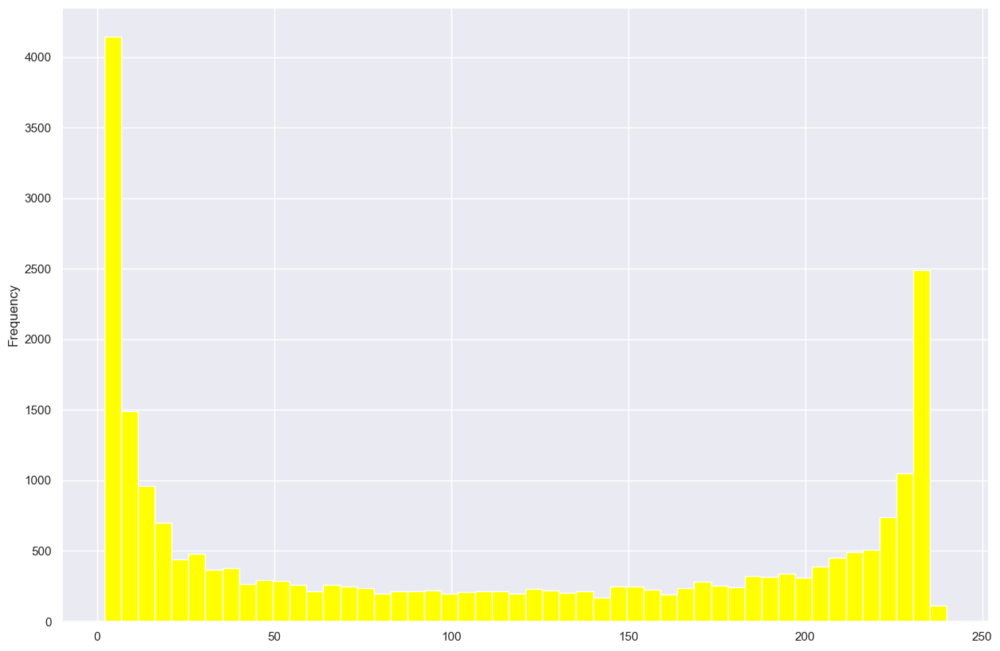

In [54]:
gene_expression = normalized.copy()
gene_expression[gene_expression != 0] = 1 #turning non-zero values into 1 and sum them up
sum_number = count_type_genes.sum(axis = 1)

plt.figure(figsize = (15,10))
sum_number.plot.hist(grid = True, bins = 50, color= "yellow")


In [55]:
cpm_threshold = 5 #for example
to_filter_list = []
for i in range(normalized.shape[0]):
    mask = [element for element in normalized.iloc[i,:] if element >= cpm_threshold]
    if len(mask) <= 2:
      to_filter_list.append(i)
print(f"the initial lenght of cpm values, before filtering out : {len(p_values)}")

indices_to_filter = set(to_filter_list)
cpm_p_values_dict = {
    gene: p for i, (gene, p) in enumerate(p_values.items()) if i not in indices_to_filter
}
cpm_p_values_list = [p for i, p in enumerate(p_values.values()) if i not in indices_to_filter]
print(f"the final length of cpm values after applying threshold of {cpm_threshold}: {len(cpm_p_values_list)}")

the initial lenght of cpm values, before filtering out : 23342
the final length of cpm values after applying threshold of 5: 13837


#### Q_VALUE THRESHOLD

In [56]:
q_value_threshold = 0.05
q_values = q_value(cpm_p_values_dict)

significant_genes = {gene: cpm_p_values_dict[gene] for gene in cpm_p_values_dict if q_values[gene] <= q_value_threshold}

#significant_genes = {
    #gene: p_values[gene] for gene in p_values 
    #if q_values[gene] <= significance_threshold and gene not in indices_to_filter
#}
# Print the significant genes
#print("Significant genes and their q-values:")
#for gene, qval in significant_genes.items():

#   print(gene, qval)

print(len(significant_genes))

3560


In [57]:
p_values = dict(sorted(p_values.items(), key=lambda item: p_values[item[0]]))
def top_genes(significant_genes, n):
    # Get the top n genes from the significant_genes dictionary
    # Since significant_genes is already filtered, no need to check q-values again
    top_n_genes = list(significant_genes.items())[:n]
    
    # Print the gene names and their p-values (or q-values if you pass those)
    for gene, val in top_n_genes:
        print(gene, val)

# Assuming `significant_genes` is your dictionary of genes to p-values
# with only significant genes based on q-value threshold
top_genes(p_values, 50)

"SLC2A1" 1.0225752357510285e-38
"C4orf3" 2.9975092223554444e-37
"LOXL2" 3.803216371195867e-29
"DANT1" 1.5184249556260855e-28
"PPP1R3G" 2.3205176088452306e-28
"BHLHE40-AS1" 1.677327239550972e-26
"TPI1P1" 1.975218010538724e-24
"BNIP3L" 2.7848712181436364e-21
"SLC25A33" 7.868107119567715e-20
"SLC6A8" 1.7022386742120696e-19
"TIMM17A" 2.0745121719362176e-19
"PNCK" 2.226557975389031e-19
"PGK1" 4.954121689322853e-19
"BRIX1" 1.9703509186890834e-17
"PSMA5" 2.9055811243602513e-16
"ARRDC3" 4.670939647185648e-16
"CCT6A" 6.548287985231515e-16
"DNTTIP2" 8.121402929843452e-16
"ANKRD37" 1.5188778915358847e-15
"INSIG2" 5.179844983004678e-15
"KDM3A" 1.3163973413889427e-14
"AK4" 1.5871783308209307e-14
"IFRD1" 3.6830561229057066e-14
"EBNA1BP2" 6.467299895187463e-14
"SEC61G" 7.976189684183893e-14
"GAPDHP1" 1.4287851058217596e-13
"GAPDHP65" 1.6570159202752025e-13
"FAM83A" 1.042497017382403e-12
"ZBTB8OS" 1.0554999597203967e-12
"SLC7A11" 1.075559153375889e-12
"ENO1" 1.1829084427100063e-12
"HK2" 1.394754886379

In [58]:
print(np.shape(normalized), len(significant_genes))

(23342, 219) 3560


FILTERING OUT THE NORMALIZED DATA WITH SIGNIFICANT GENES

In [59]:
significant_gene_list = list(significant_genes.keys())
final_df = normalized.copy()
final_df = final_df[final_df.index.isin(significant_genes)]

### Final Result

In [60]:
print(f"we moved from {np.shape(df_HCC_SmartS_unfiltered)} to {np.shape(final_df)}")

we moved from (23342, 243) to (3560, 219)


### Non-Parametric

If you're moving from a parametric test like the t-test, which assumes normality, to a nonparametric approach for differential expression analysis, it's a way to address potential issues with the normality assumption. Nonparametric tests can be particularly useful when the data doesn't seem to follow a normal distribution or when you have outliers that could heavily skew the results of parametric tests.

NON-PARAMETRIC TEST

In [61]:
cpm_threshold2 = 7#for example
to_filter_list2 = []
for i in range(normalized.shape[0]):
    mask = [element for element in normalized.iloc[i,:] if element >= cpm_threshold2]
    if len(mask) <= 2:
      to_filter_list2.append(i)
print(f"the initial lenght of cpm values, before filtering out : {len(p_values)}")

indices_to_filter2 = list(to_filter_list2)

cpm_p_values_dict2 = {
    gene: p for i, (gene, p) in enumerate(p_values.items()) if i not in indices_to_filter2
}
cpm_p_values_list2 = [p for i, p in enumerate(p_values.values()) if i not in indices_to_filter2]
print(f"the final length of cpm values after applying threshold of {cpm_threshold2}: {len(cpm_p_values_list2)}")

the initial lenght of cpm values, before filtering out : 23342
the final length of cpm values after applying threshold of 7: 6323


In [62]:
normalized

,"""output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A1_Hypoxia_S97_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A4_Hypoxia_S8_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A5_Hypoxia_S108_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A6_Hypoxia_S11_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A7_Normoxia_S113_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A8_Normoxia_S119_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A9_Normoxia_S20_Aligned.sortedByCoord.out.bam""",...,"""output.STAR.PCRPlate4G12_Normoxia_S243_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4G1_Hypoxia_S193_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4G2_Hypoxia_S198_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4G6_Hypoxia_S232_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4G7_Normoxia_S204_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4H10_Normoxia_S210_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4H11_Normoxia_S214_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4H2_Hypoxia_S199_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4H7_Normoxia_S205_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4H9_Normoxia_S236_Aligned.sortedByCoord.out.bam"""
"""WASH7P""",0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
"""CICP27""",0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
"""DDX11L17""",0.000000,0.000000,0.000000,0.000000,2.310261,0.000000,0.000000,0.000000,0.000000,1.839774,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
"""WASH9P""",0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.496612,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,1.625521,0.000000,1.599483,0.000000,0.000000
"""OR4F29""",0.000000,0.000000,0.000000,0.000000,0.000000,1.334288,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"""MT-TE""",4.494373,0.000000,0.000000,0.000000,3.340426,4.886376,2.608853,3.147706,4.332466,4.511045,...,4.907816,4.122946,4.784858,4.068143,4.096969,4.673835,2.576354,2.821491,3.847318,4.727769
"""MT-CYB""",9.500185,7.006054,9.523174,8.219553,8.749820,8.996055,8.493594,8.313537,9.751385,9.794540,...,8.742697,8.663470,8.763136,9.571416,9.514002,9.627635,9.388965,9.095296,9.328117,9.343454
"""MT-TT""",4.856878,0.000000,3.472215,3.889670,0.000000,4.750904,3.378024,3.147706,4.332466,3.884775,...,5.597262,4.840488,3.208295,4.752699,4.316783,5.149846,2.576354,4.098620,4.245645,5.254748
"""MT-TP""",4.991437,3.808698,2.252478,4.689172,4.852645,5.543431,4.251478,3.538750,5.644542,5.282793,...,6.502970,5.354548,4.477737,5.758794,5.406460,5.282652,5.392190,4.964361,4.529739,6.094856


In [63]:
# Convert list of indices to the actual index labels
indices_to_drop = normalized.index[indices_to_filter2].tolist()
print(len(indices_to_drop))
# Drop the rows corresponding to these indices
np_filtered = normalized.drop(index=indices_to_drop)



17019


In [64]:
print(np.shape(np_filtered))

(6323, 219)


In [65]:
u_test = np_filtered.T.copy()
hypo2 = u_test[u_test.index.str.contains("Hypoxia")]
hypo2.index = hypo2.index.str.replace("output.STAR.PCRPlate", "", regex=True)
hypo2.index = hypo2.index.str.replace("_Aligned.sortedByCoord.out.bam", "", regex=True)

normo2 = u_test[t_test.index.str.contains("Normoxia")]
normo2.index = normo2.index.str.replace("output.STAR.PCRPlate", "", regex=True)
normo2.index = normo2.index.str.replace("_Aligned.sortedByCoord.out.bam", "", regex=True)

hypo2 = hypo2.transpose()
normo2 = normo2.transpose()

In [66]:
p_val_row_np = {}
for i in range(len(cpm_p_values_list2)):  
  p_val_row_np[i] = stats.mannwhitneyu(x=hypo2.iloc[i,:], y=normo2.iloc[i,:], alternative = 'two-sided').pvalue

print(len(p_val_row_np))


6323


In [67]:
q_value_threshold2 =  0.001
q_values2 = q_value(cpm_p_values_dict2)

significant_genes2 = {gene: cpm_p_values_dict2[gene] for gene in cpm_p_values_dict2 if q_values2[gene] <= q_value_threshold2}

In [68]:
print(len(significant_genes2))

4224


In [69]:
significant_gene_list2 = list(significant_genes2.keys())
final_df2 = normalized.copy()
final_df2 = final_df2[final_df2.index.isin(significant_genes2)]

In [70]:
final_df2

,"""output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A1_Hypoxia_S97_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A4_Hypoxia_S8_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A5_Hypoxia_S108_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A6_Hypoxia_S11_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A7_Normoxia_S113_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A8_Normoxia_S119_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1A9_Normoxia_S20_Aligned.sortedByCoord.out.bam""",...,"""output.STAR.PCRPlate4G12_Normoxia_S243_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4G1_Hypoxia_S193_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4G2_Hypoxia_S198_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4G6_Hypoxia_S232_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4G7_Normoxia_S204_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4H10_Normoxia_S210_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4H11_Normoxia_S214_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4H2_Hypoxia_S199_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4H7_Normoxia_S205_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4H9_Normoxia_S236_Aligned.sortedByCoord.out.bam"""
"""MTCO2P12""",2.424103,0.000000,2.252478,0.000000,0.000000,1.334288,2.817164,0.000000,2.984820,0.000000,...,1.886713,2.208141,0.000000,2.731902,2.759340,1.625521,0.000000,2.821491,2.523069,0.000000
"""MTATP6P1""",8.125904,5.868544,7.524896,6.994488,7.287838,8.153417,7.229034,7.552846,8.468523,8.235127,...,7.767775,7.605640,7.602307,7.806662,8.055522,7.871329,7.662512,7.832570,7.527590,7.869863
"""MTCO3P12""",5.928611,3.808698,5.310412,4.888170,5.155970,5.487146,4.738400,5.359810,5.826274,5.903624,...,5.338081,4.988922,5.019487,5.558824,5.406460,5.672484,5.392190,5.290908,4.845248,5.441068
"""OR4F16""",0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
"""LINC00115""",0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.496612,0.000000,0.000000,...,0.000000,0.000000,0.000000,3.391960,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"""CBR1""",8.075331,7.698748,8.380597,8.320685,6.831802,8.353377,8.232257,8.546417,8.727648,8.383608,...,8.403425,8.094671,7.678352,8.255838,7.737773,7.930281,7.534742,7.390609,8.781731,8.020590
"""WDR4""",6.358461,6.273067,6.405725,6.509553,0.000000,6.093506,5.671327,6.150463,6.683705,6.404638,...,6.853302,5.210702,0.000000,6.450362,6.627063,6.583892,7.103248,4.783435,5.578734,5.488494
"""PFKL""",8.191299,8.522669,8.262680,8.618457,8.514049,7.235947,8.954135,6.830580,2.984820,7.702717,...,7.506721,7.437027,8.318637,7.846766,7.718237,7.836473,7.780877,7.568757,7.767755,6.397647
"""TRPM2""",6.108659,5.986013,6.918700,6.291228,0.000000,6.061423,5.893782,7.198898,6.193091,5.074257,...,6.665264,0.000000,5.735215,4.620399,7.089196,4.996661,7.207527,6.673417,6.052728,6.452118


# 5. UNSUPERVISED LEARNING

## 5.1. MCF SmartS

In [98]:
df_MCF_SmartS_meta

,Cell Line,Lane,Pos,Condition,Hours,Cell name,PreprocessingTag,ProcessingComments
Filename,,,,,,,,
output.STAR.1_A10_Hypo_S28_Aligned.sortedByCoord.out.bam,MCF7,output.STAR.1,A10,Hypo,72,S28,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.1_A11_Hypo_S29_Aligned.sortedByCoord.out.bam,MCF7,output.STAR.1,A11,Hypo,72,S29,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.1_A12_Hypo_S30_Aligned.sortedByCoord.out.bam,MCF7,output.STAR.1,A12,Hypo,72,S30,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.1_A1_Norm_S1_Aligned.sortedByCoord.out.bam,MCF7,output.STAR.1,A1,Norm,72,S1,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.1_A2_Norm_S2_Aligned.sortedByCoord.out.bam,MCF7,output.STAR.1,A2,Norm,72,S2,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
...,...,...,...,...,...,...,...,...
output.STAR.4_H5_Norm_S359_Aligned.sortedByCoord.out.bam,MCF7,output.STAR.4,H5,Norm,72,S359,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.4_H6_Norm_S360_Aligned.sortedByCoord.out.bam,MCF7,output.STAR.4,H6,Norm,72,S360,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.4_H7_Hypo_S379_Aligned.sortedByCoord.out.bam,MCF7,output.STAR.4,H7,Hypo,72,S379,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"


In [99]:
df_MCF_SmartS_condition = df_MCF_SmartS_filtered_normalised

df_MCF_SmartS_condition.index= df_MCF_SmartS_condition.index.astype(str).str.replace('"', '')



In [100]:
# now merge the condition into our main dataset 
condition_MCF_SmartS = df_MCF_SmartS_meta ["Condition"]
df_MCF_SmartS_condition= df_MCF_SmartS_condition.join(condition_MCF_SmartS)

condition_MCF_SmartS = df_MCF_SmartS_condition["Condition"]
condition_MCF_SmartS

output.STAR.2_B3_Norm_S57_Aligned.sortedByCoord.out.bam     Norm
output.STAR.2_B4_Norm_S58_Aligned.sortedByCoord.out.bam     Norm
output.STAR.2_B5_Norm_S59_Aligned.sortedByCoord.out.bam     Norm
output.STAR.2_B6_Norm_S60_Aligned.sortedByCoord.out.bam     Norm
output.STAR.2_B7_Hypo_S79_Aligned.sortedByCoord.out.bam     Hypo
                                                            ... 
output.STAR.4_H5_Norm_S359_Aligned.sortedByCoord.out.bam    Norm
output.STAR.4_H6_Norm_S360_Aligned.sortedByCoord.out.bam    Norm
output.STAR.4_H7_Hypo_S379_Aligned.sortedByCoord.out.bam    Hypo
output.STAR.4_H8_Hypo_S380_Aligned.sortedByCoord.out.bam    Hypo
output.STAR.4_H9_Hypo_S381_Aligned.sortedByCoord.out.bam    Hypo
Name: Condition, Length: 250, dtype: object

### UMAP

/Users/emmamora/anaconda3/lib/python3.11/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


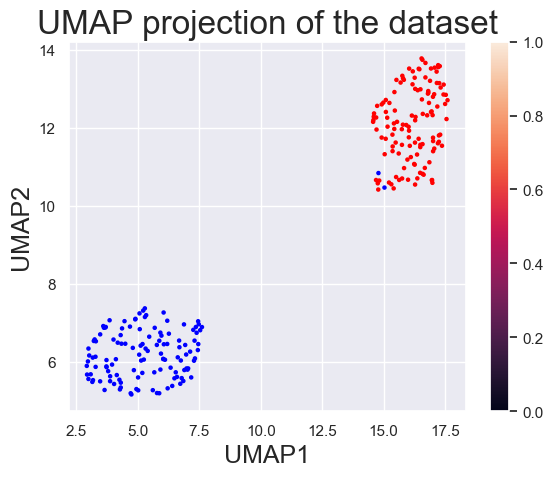

In [103]:
import umap

n_components = 2

reducer = umap.UMAP(n_neighbors=15, min_dist=0.1, n_components=n_components, random_state=42)

embedding_MCF_SmartS = reducer.fit_transform(df_MCF_SmartS_filtered_normalised)

condition_color_MCF_SmartS = np.where(condition_MCF_SmartS == "Norm","red","blue")


#visualization in 2d
plt.scatter(embedding_MCF_SmartS[:, 0], embedding_MCF_SmartS[:, 1], s=5, c=condition_color_MCF_SmartS)
plt.title('UMAP projection of the dataset', fontsize=24)
plt.xlabel('UMAP1', fontsize=18)
plt.ylabel('UMAP2', fontsize=18)
plt.colorbar()


plt.show()

umap_data_MCF_SmartS = pd.DataFrame(embedding_MCF_SmartS, index = df_MCF_SmartS_filtered_normalised.index, columns =[f'UMAP{i+1}' for i in range(n_components)])

### PCA

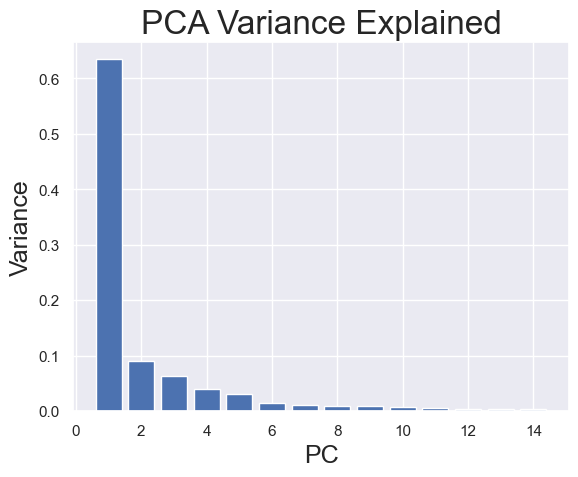

In [104]:
from sklearn.decomposition import PCA

pca = PCA()

pca.fit(df_MCF_SmartS_filtered_normalised)

plt.bar(np.arange(1,15), pca.explained_variance_ratio_[:14])
plt.title('PCA Variance Explained', fontsize=24)
plt.xlabel('PC', fontsize=18)
plt.ylabel('Variance', fontsize=18)
plt.show()


### Components of PCA

In [105]:
n_components=8

pca = PCA(n_components=n_components)

pca_result= pca.fit_transform(df_MCF_SmartS_filtered_normalised)



pca_data_MCF_SmartS = pd.DataFrame(pca_result, index = df_MCF_SmartS_filtered_normalised.index, columns=[f'PC{i+1}' for i in range(n_components)])

loadings_MCF_SmartS = pca.components_.T  


df_loadings_MCF_SmartS = pd.DataFrame(loadings_MCF_SmartS, index=df_MCF_SmartS_filtered_normalised.columns, columns=[f'PC{i+1}' for i in range(n_components)])

#sort the df

loadings_abs = df_loadings_MCF_SmartS.abs()
loadings_sorted= loadings_abs.sort_values(by="PC1",ascending=False)
loadings_sorted.head(10)




,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8
"""GAPDH""",0.704093,0.600763,0.148521,0.077477,0.239999,0.168059,0.031535,0.067300
"""ACTG1""",0.449360,0.670894,0.233131,0.372700,0.246855,0.069411,0.089864,0.026269
"""ALDOA""",0.406931,0.156439,0.039396,0.109703,0.840931,0.002385,0.025086,0.027638
"""CYP1B1""",0.149746,0.254172,0.371415,0.565685,0.187437,0.198140,0.085374,0.241903
"""MT-CO1""",0.102793,0.035583,0.124772,0.026913,0.070586,0.072686,0.359027,0.555144
"""UBC""",0.102706,0.077056,0.054210,0.052185,0.155972,0.120438,0.062837,0.184515
"""GPI""",0.101459,0.012130,0.037191,0.080830,0.160187,0.178630,0.028148,0.075726
"""PGK1""",0.101246,0.071201,0.043148,0.039979,0.049471,0.346652,0.335031,0.128671
"""FTH1""",0.091947,0.074444,0.576367,0.392247,0.039289,0.059251,0.054980,0.065265
"""BEST1""",0.081450,0.065070,0.515896,0.351206,0.036614,0.055654,0.053473,0.061481


### Hierarchical

/Users/emmamora/anaconda3/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/Users/emmamora/anaconda3/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


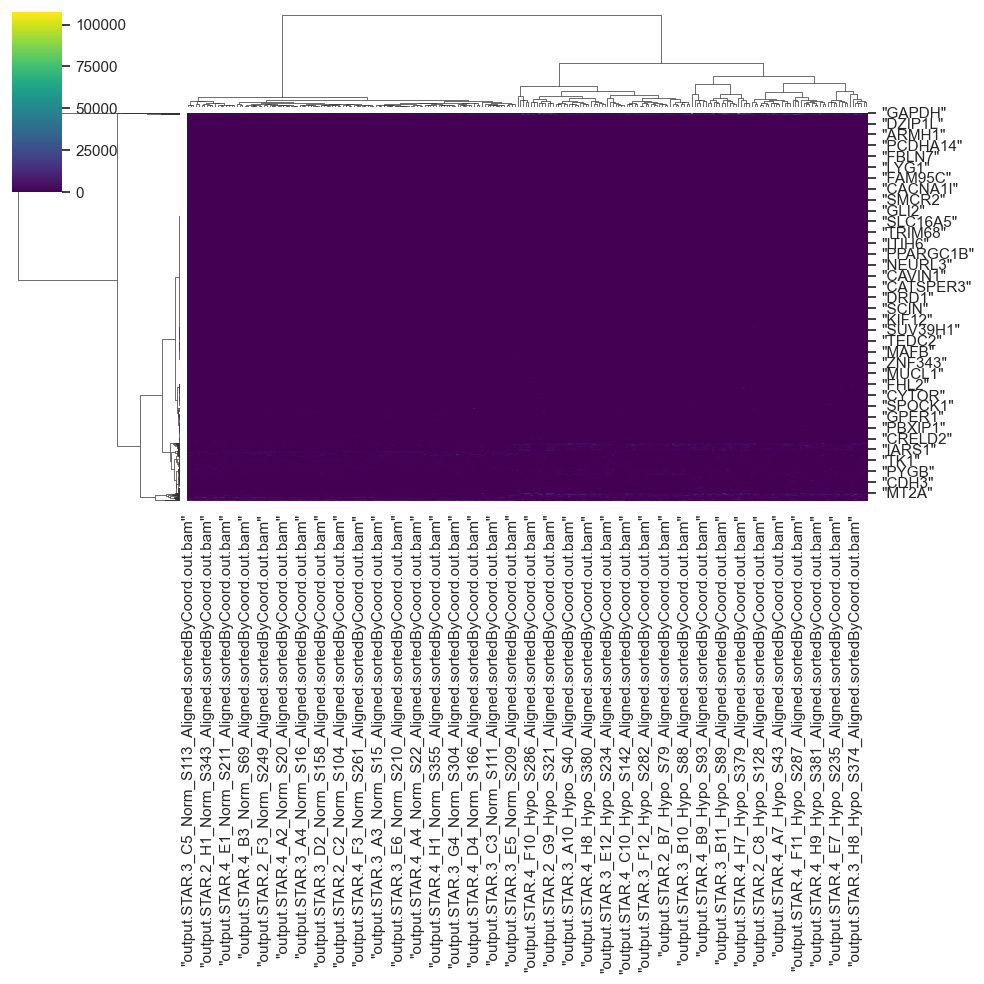

In [116]:
s = sns.clustermap(df_MCF_SmartS_filtered_normalised_init, method='ward', cmap='viridis')
plt.show()

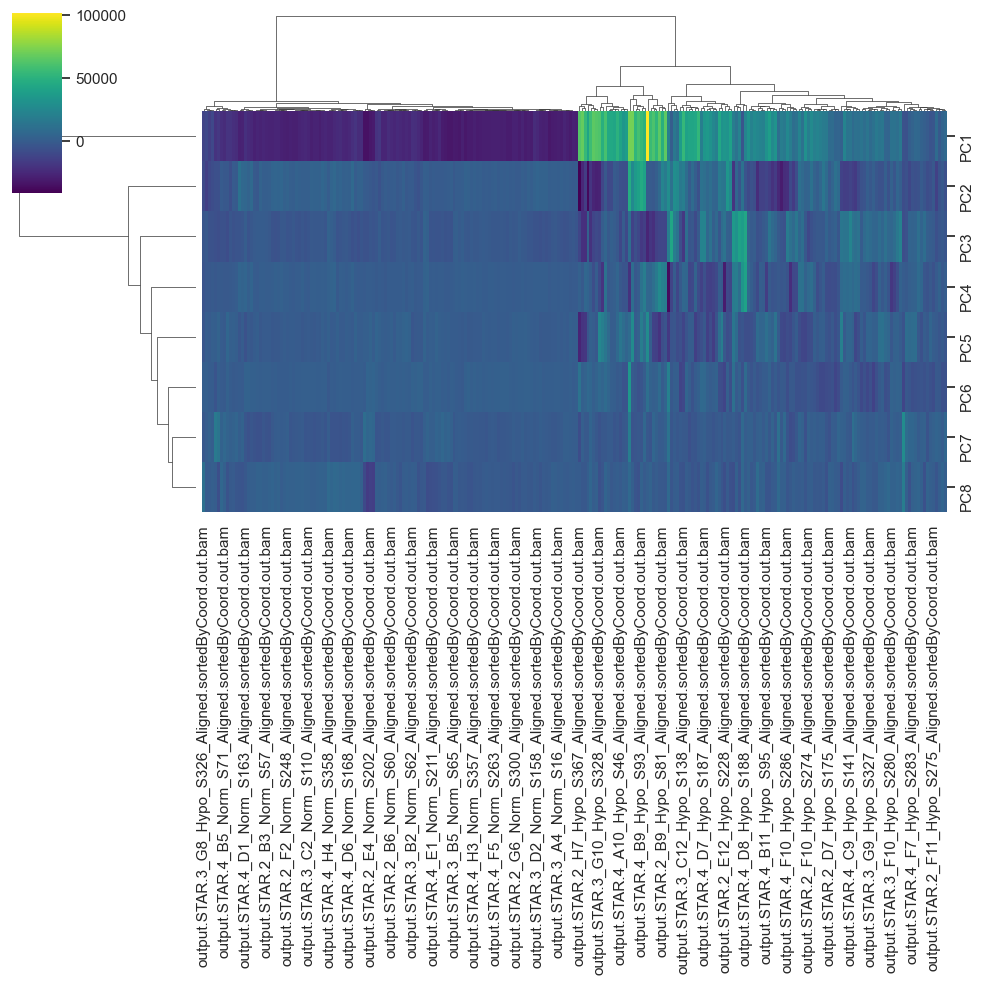

In [117]:
s = sns.clustermap(pca_data_MCF_SmartS.T, method='ward', cmap='viridis')
plt.show()

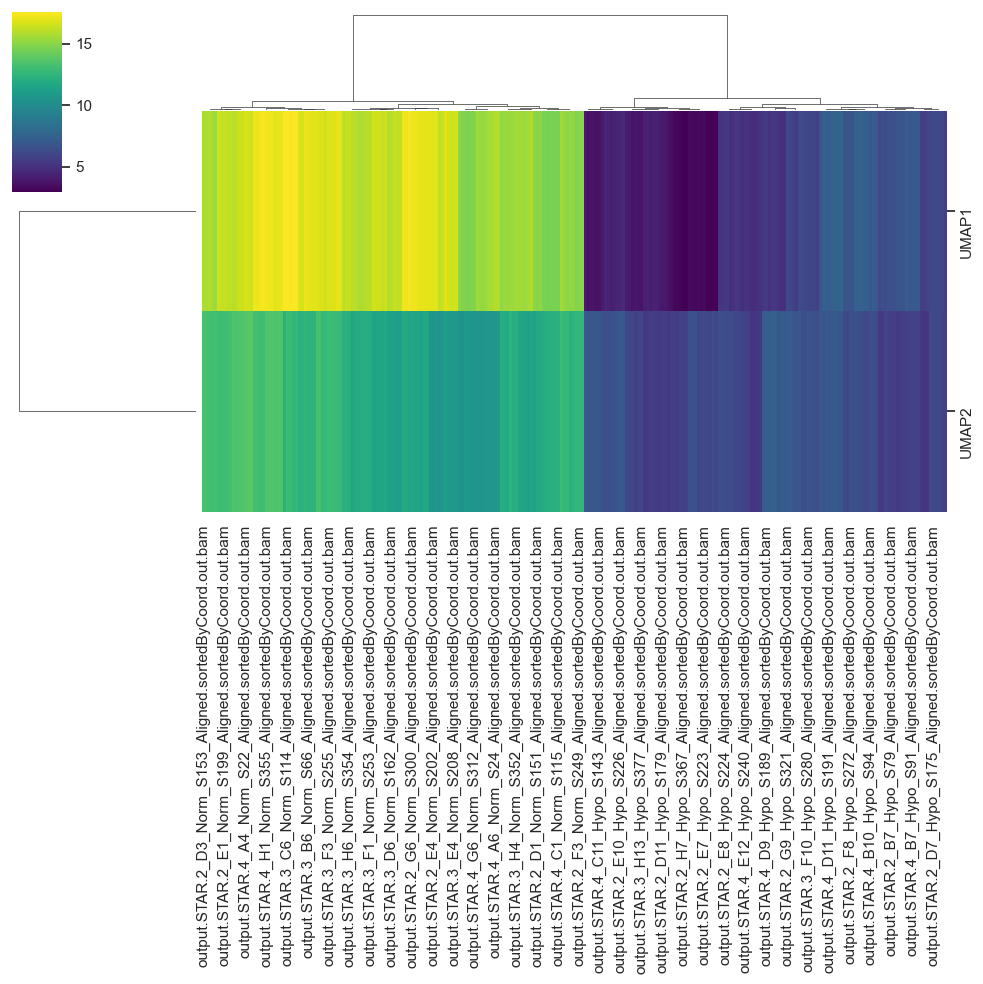

In [118]:
s = sns.clustermap(umap_data_MCF_SmartS.T, method='ward', cmap='viridis')
plt.show()

### Kmeans 

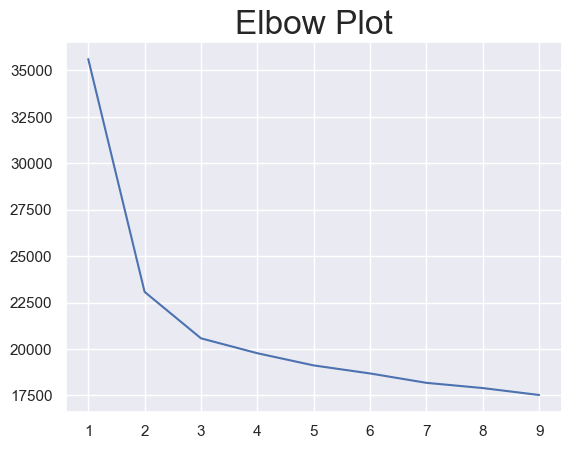

In [119]:
from scipy.cluster.vq import kmeans,vq

distortions = []
df_kmeans_MCF_SmartS = df_MCF_SmartS_filtered_normalised.astype(float)

for i in np.arange(1,10):
    cluster_center, distortion = kmeans(df_kmeans_MCF_SmartS,i)
    distortions.append(distortion)

plt.plot(np.arange(1,10),distortions)
plt.title('Elbow Plot', fontsize=24)

plt.show()

In [120]:
#doing it with main data
cluster_center_main, distortion = kmeans(df_kmeans_MCF_SmartS,2)

cluster_labels_main, _ = vq(df_kmeans_MCF_SmartS, cluster_center_main)

condition_no_MCF_SmartS = np.where(condition_MCF_SmartS == "Norm",1,0)


def scoring_kmeans(cluster_labels):
    return max(sum(abs(cluster_labels-condition_no_MCF_SmartS))/len(cluster_labels),1-sum(abs(cluster_labels-condition_no_MCF_SmartS))/len(cluster_labels))

print(f"The accuracy of the clustering is: {scoring_kmeans(cluster_labels_main) * 100:.2f}%")


The accuracy of the clustering is: 97.20%


### Kmeans PCA

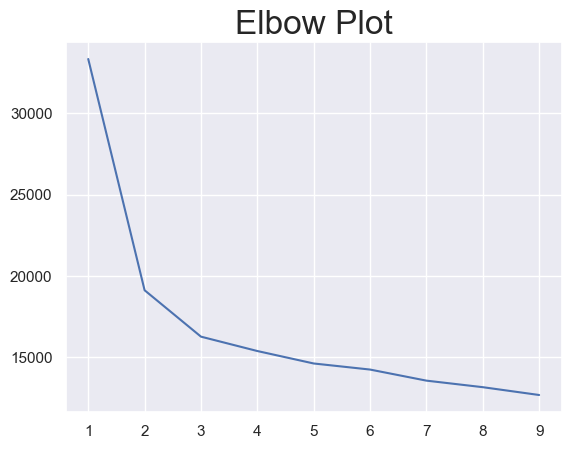

In [121]:
distortions = []

for i in np.arange(1,10):
    cluster_center, distortion = kmeans(pca_data_MCF_SmartS,i)
    distortions.append(distortion)

plt.plot(np.arange(1,10),distortions)
plt.title('Elbow Plot', fontsize=24)

plt.show()

In [122]:
#doing it with pca

cluster_center_pca_1, distortion = kmeans(pca_data_MCF_SmartS,2)

cluster_labels_pca_1, _ = vq(pca_data_MCF_SmartS, cluster_center_pca_1)


cluster_center_pca_2, distortion = kmeans(pca_data_MCF_SmartS,3)

cluster_labels_pca_2, _ = vq(pca_data_MCF_SmartS, cluster_center_pca_2)


#looking to compare scores

print(f"The accuracy of the clustering is: {scoring_kmeans(cluster_labels_pca_1) * 100:.2f}%")


The accuracy of the clustering is: 97.20%


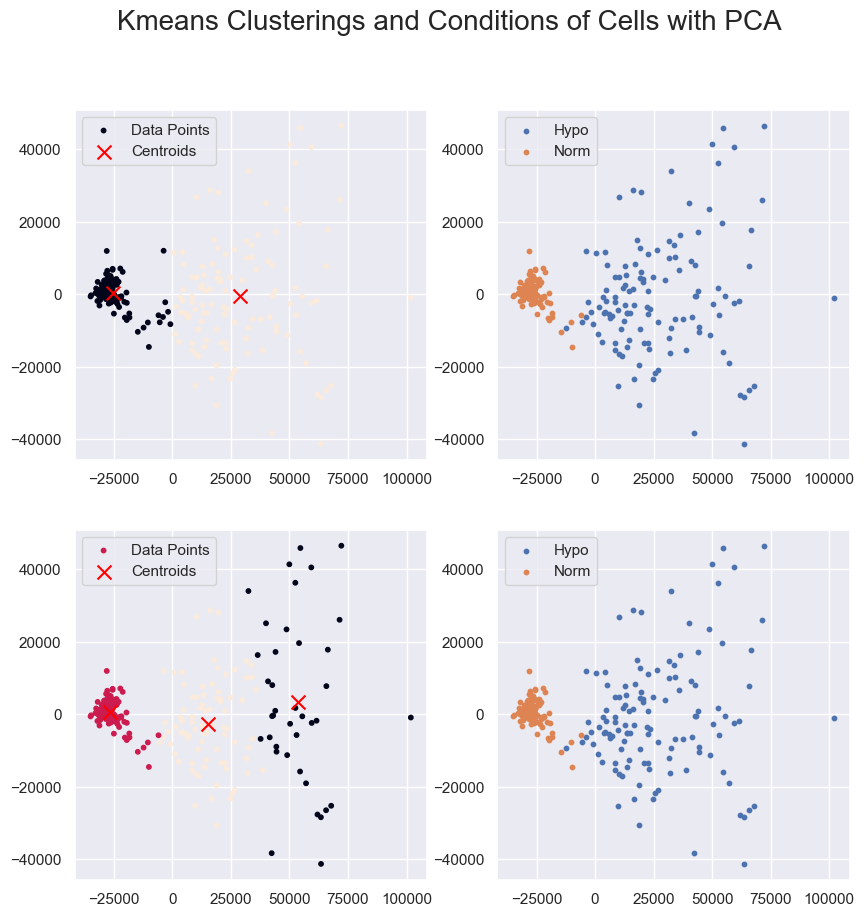

In [123]:
#visualization with PCA

fig,ax =plt.subplots(2,2,figsize=(10,10))

ax[0,0].scatter(pca_data_MCF_SmartS.iloc[:,0], pca_data_MCF_SmartS.iloc[:,1],s=10, c=cluster_labels_pca_1, label='Data Points')
ax[0,0].scatter(cluster_center_pca_1[:, 0], cluster_center_pca_1[:, 1], c='red', s=100, marker='x', label='Centroids')
ax[0,0].legend()


pca_data_hypo_MCF_SmartS = pca_data_MCF_SmartS[np.where(condition_MCF_SmartS =="Hypo",True,False)]
pca_data_norm_MCF_Smarts = pca_data_MCF_SmartS[np.where(condition_MCF_SmartS =="Norm",True,False)]

ax[0,1].scatter(pca_data_hypo_MCF_SmartS.iloc[:,0], pca_data_hypo_MCF_SmartS.iloc[:,1], s=10,label="Hypo")
ax[0,1].scatter(pca_data_norm_MCF_Smarts.iloc[:,0], pca_data_norm_MCF_Smarts.iloc[:,1], s=10,label="Norm")
ax[0,1].legend()


ax[1,0].scatter(pca_data_MCF_SmartS.iloc[:,0], pca_data_MCF_SmartS.iloc[:,1],s=10, c=cluster_labels_pca_2, label='Data Points')
ax[1,0].scatter(cluster_center_pca_2[:, 0], cluster_center_pca_2[:, 1], c='red', s=100, marker='x', label='Centroids')
ax[1,0].legend()

ax[1,1].scatter(pca_data_hypo_MCF_SmartS.iloc[:,0], pca_data_hypo_MCF_SmartS.iloc[:,1], s=10,label="Hypo")
ax[1,1].scatter(pca_data_norm_MCF_Smarts.iloc[:,0], pca_data_norm_MCF_Smarts.iloc[:,1], s=10,label="Norm")
ax[1,1].legend()

fig.suptitle('Kmeans Clusterings and Conditions of Cells with PCA', fontsize=20)


plt.show()


###  Kmeans UMAP

The accuracy of the clustering is: 99.20%


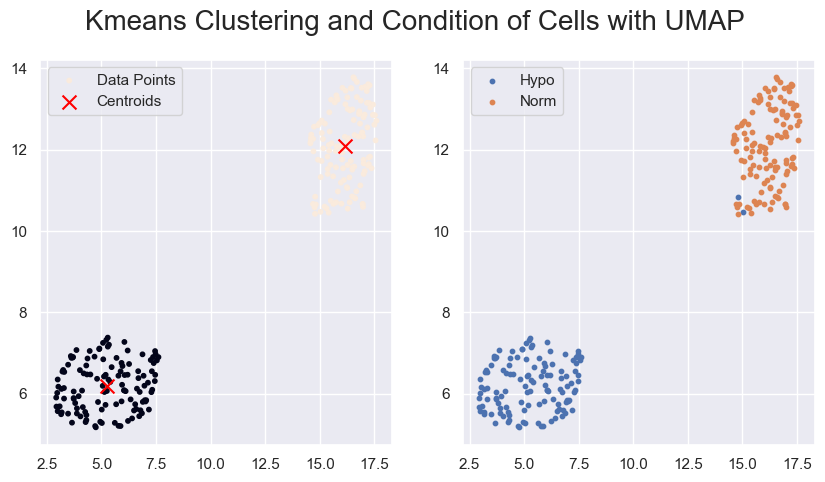

In [124]:
cluster_center_umap, distortion = kmeans(umap_data_MCF_SmartS,2)

cluster_labels_umap, _ = vq(umap_data_MCF_SmartS, cluster_center_umap)


#looking to compare scores

print(f"The accuracy of the clustering is: {scoring_kmeans(cluster_labels_umap) * 100:.2f}%")



fig,ax =plt.subplots(1,2,figsize=(10,5))

ax[0].scatter(umap_data_MCF_SmartS.iloc[:,0], umap_data_MCF_SmartS.iloc[:,1],s=10, c=cluster_labels_umap, marker='o', label='Data Points')
ax[0].scatter(cluster_center_umap[:, 0], cluster_center_umap[:, 1], c='red', s=100, marker='x', label='Centroids')
ax[0].legend()


umap_data_hypo_MCF_SmartS = umap_data_MCF_SmartS[np.where(condition_MCF_SmartS =="Hypo",True,False)]
umap_data_norm_MCF_SmartS = umap_data_MCF_SmartS[np.where(condition_MCF_SmartS =="Norm",True,False)]

ax[1].scatter(umap_data_hypo_MCF_SmartS.iloc[:,0], umap_data_hypo_MCF_SmartS.iloc[:,1],s=10, label="Hypo")
ax[1].scatter(umap_data_norm_MCF_SmartS.iloc[:,0], umap_data_norm_MCF_SmartS.iloc[:,1],s=10, label="Norm")
ax[1].legend()

fig.suptitle("Kmeans Clustering and Condition of Cells with UMAP", fontsize=20)

plt.show()



## 5.2. HCC SmartS

In [125]:
df_HCC_SmartS_condition = df_HCC_SmartS_filtered_normalised

df_HCC_SmartS_condition.index= df_HCC_SmartS_condition.index.astype(str).str.replace('"', '')


# now merge the condition into our main dataset 
condition_HCC_SmartS = df_HCC_SmartS_meta["Condition"]
df_HCC_SmartS_condition= df_HCC_SmartS_condition.join(condition_HCC_SmartS)

condition_HCC_SmartS = df_HCC_SmartS_condition["Condition"]


### UMAP


/Users/emmamora/anaconda3/lib/python3.11/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


/var/folders/sc/040g6l752pg38ngvcz_ths0c0000gn/T/ipykernel_12426/1762511636.py:12: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(embedding_HCC_SmartS[:, 0], embedding_HCC_SmartS[:, 1], cmap='Spectral', s=5, color=condition_color_HCC_SmartS)


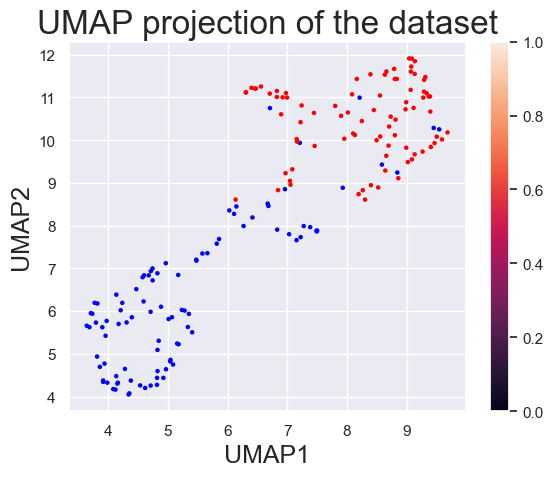

In [126]:
import umap

n_components = 2

reducer = umap.UMAP(n_neighbors=15, min_dist=0.001, n_components=n_components, random_state=42)

embedding_HCC_SmartS = reducer.fit_transform(df_HCC_SmartS_filtered_normalised)

condition_color_HCC_SmartS = np.where(condition_HCC_SmartS == "Normo","red","blue")


plt.scatter(embedding_HCC_SmartS[:, 0], embedding_HCC_SmartS[:, 1], cmap='Spectral', s=5, color=condition_color_HCC_SmartS)
plt.title('UMAP projection of the dataset', fontsize=24)
plt.xlabel('UMAP1', fontsize=18)
plt.ylabel('UMAP2', fontsize=18)
plt.colorbar()

umap_data_HCC_SmartS = pd.DataFrame(embedding_HCC_SmartS, index = df_HCC_SmartS_filtered_normalised.index, columns =[f'UMAP{i+1}' for i in range(n_components)])


### PCA

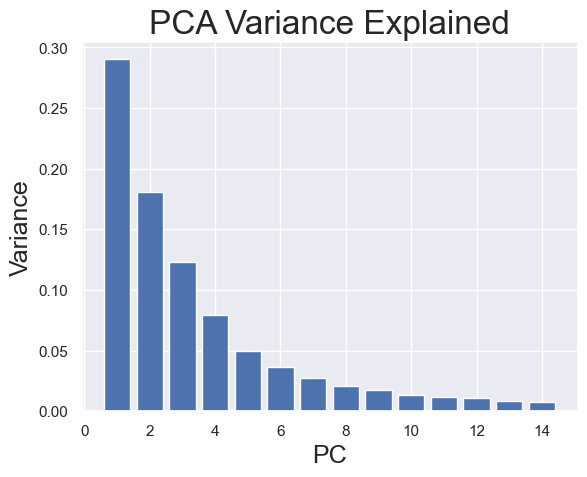

In [127]:
from sklearn.decomposition import PCA

pca = PCA()

pca.fit(df_HCC_SmartS_filtered_normalised)

plt.bar(np.arange(1,15), pca.explained_variance_ratio_[:14])
plt.title('PCA Variance Explained', fontsize=24)
plt.xlabel('PC', fontsize=18)
plt.ylabel('Variance', fontsize=18)
plt.show()

### Components of PCA

In [128]:
n_components=15

pca = PCA(n_components=n_components)

pca_result= pca.fit_transform(df_HCC_SmartS_filtered_normalised)


pca_data_HCC_SmartS = pd.DataFrame(pca_result, index = df_HCC_SmartS_filtered_normalised.index, columns=[f'PC{i+1}' for i in range(n_components)])


loadings_HCC_SmartS = pca.components_.T  

df_loadings_HCC_SmartS = pd.DataFrame(loadings_HCC_SmartS, index=df_HCC_SmartS_filtered_normalised.columns, columns=[f'PC{i+1}' for i in range(n_components)])

#sort the df

loadings_abs = df_loadings_HCC_SmartS.abs()
loadings_sorted= loadings_abs.sort_values(by="PC1",ascending=False)
loadings_sorted.head(10)


,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,PC15
"""FTL""",0.707134,0.552097,0.158409,0.246967,0.215853,0.011641,0.079066,0.119540,0.013099,0.005221,0.010350,0.054405,0.067866,0.033032,0.022004
"""FTH1""",0.471801,0.279377,0.037195,0.306600,0.287639,0.103416,0.129568,0.160849,0.060601,0.004580,0.036599,0.091960,0.001229,0.027431,0.029487
"""BEST1""",0.408769,0.245214,0.032535,0.271679,0.251904,0.088201,0.109680,0.133190,0.054234,0.001263,0.046057,0.071243,0.004023,0.025213,0.025496
"""KRT19""",0.120655,0.450115,0.007410,0.255661,0.205579,0.157976,0.422656,0.168792,0.309840,0.076356,0.048001,0.050362,0.174097,0.304609,0.062628
"""KRT17""",0.108529,0.175159,0.181996,0.532754,0.175566,0.274365,0.323419,0.083501,0.133143,0.027062,0.056139,0.048947,0.030918,0.054272,0.123012
"""AKR1C2""",0.100046,0.006389,0.038614,0.030941,0.008252,0.046142,0.041597,0.042257,0.021857,0.020945,0.140255,0.181178,0.117019,0.171891,0.197923
"""CD44""",0.088630,0.221431,0.133824,0.072014,0.364200,0.261952,0.155395,0.056163,0.362096,0.196657,0.351949,0.305011,0.113571,0.162742,0.229109
"""LAMC2""",0.074047,0.114566,0.151597,0.123025,0.554605,0.143369,0.141092,0.044054,0.073698,0.046445,0.140744,0.155997,0.492542,0.227029,0.262440
"""HSPA5""",0.072679,0.055295,0.111797,0.040079,0.026696,0.304766,0.589425,0.382140,0.328406,0.201109,0.159907,0.009130,0.083230,0.032749,0.017398
"""MT-RNR2""",0.061053,0.039819,0.020262,0.187270,0.017931,0.321653,0.036488,0.362796,0.393072,0.388260,0.111412,0.157236,0.274168,0.015538,0.053802


### Hierarchical

/Users/emmamora/anaconda3/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


/Users/emmamora/anaconda3/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


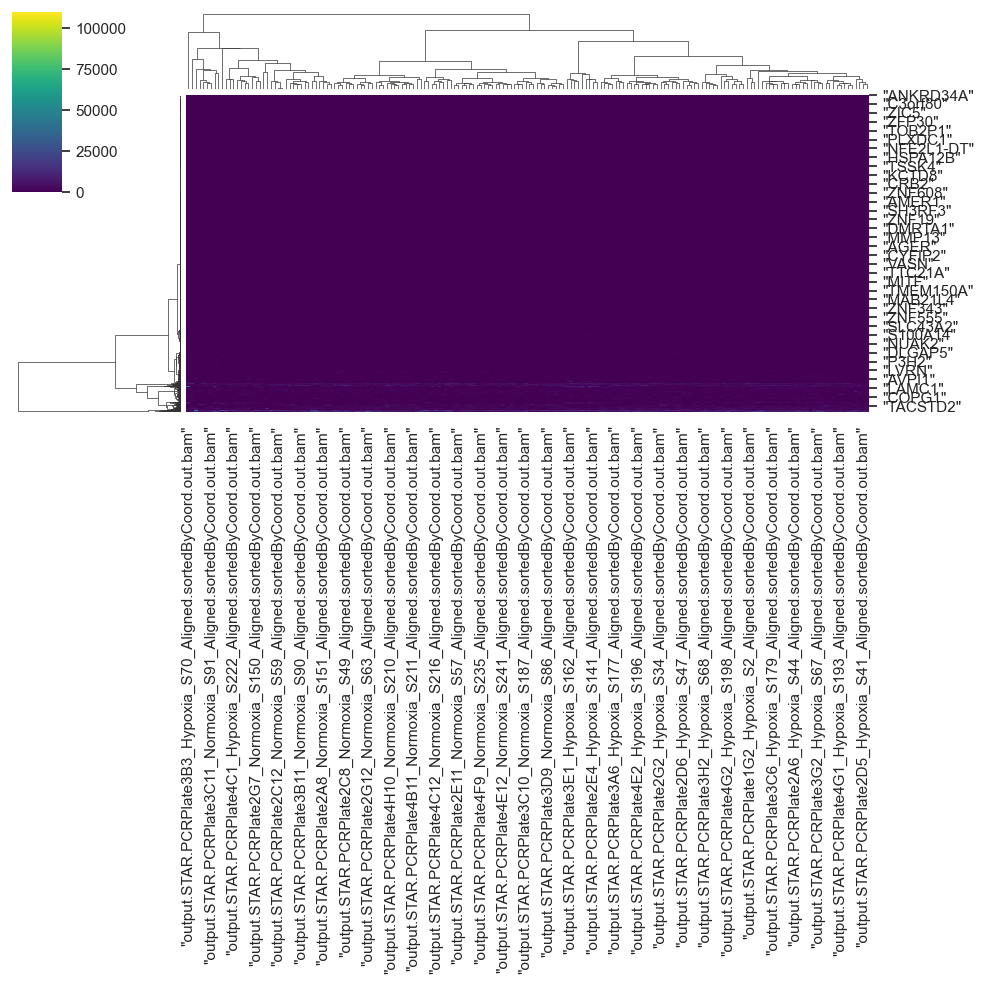

In [129]:
s = sns.clustermap(df_HCC_SmartS_filtered_normalised_init, method='ward', cmap='viridis')
plt.show()

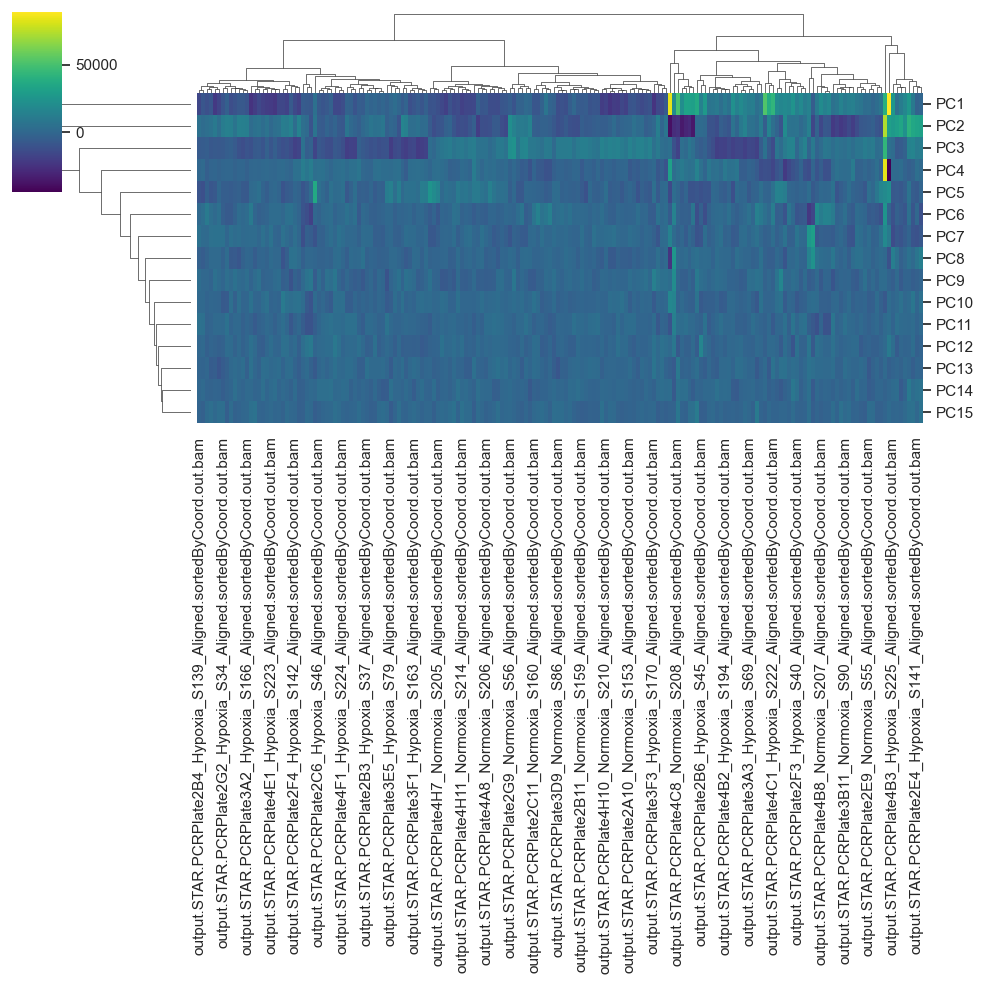

In [130]:
s = sns.clustermap(pca_data_HCC_SmartS.T, method='ward', cmap='viridis')
plt.show()

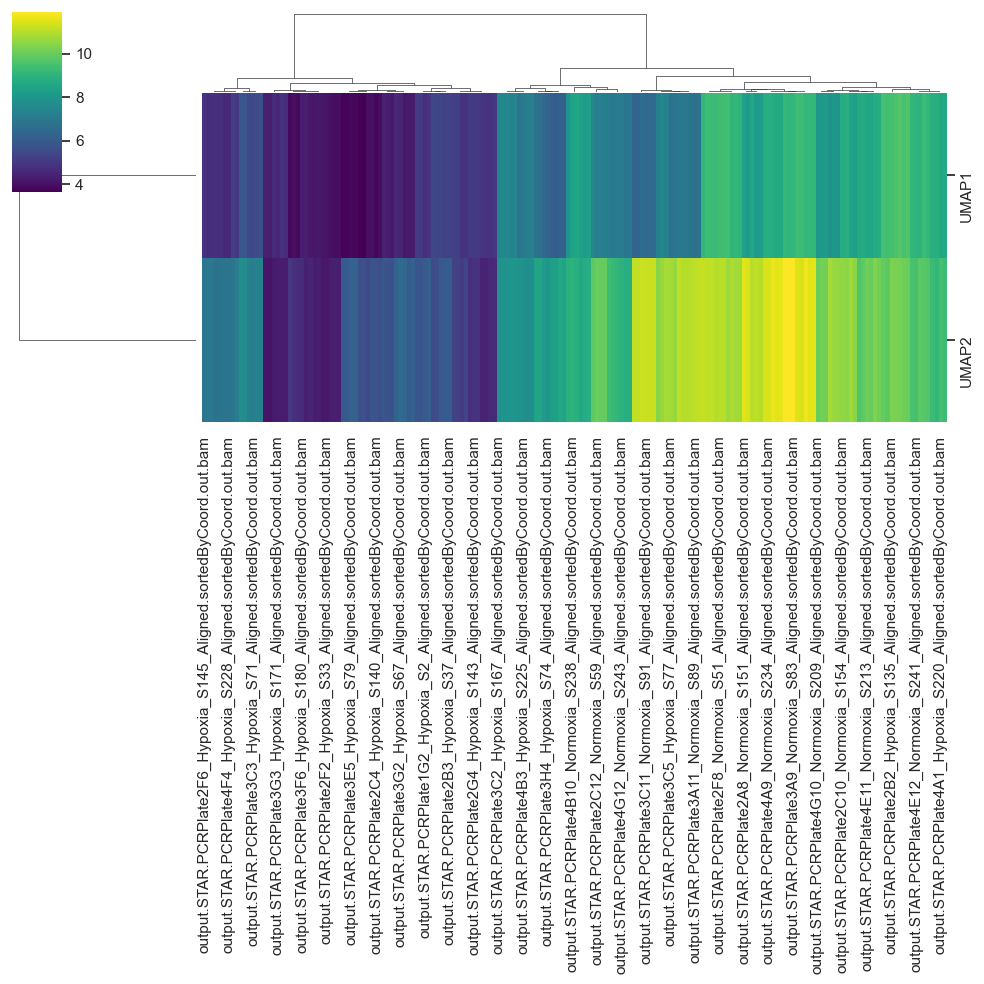

In [131]:
s = sns.clustermap(umap_data_HCC_SmartS.T, method='ward', cmap='viridis')
plt.show()

### Kmeans

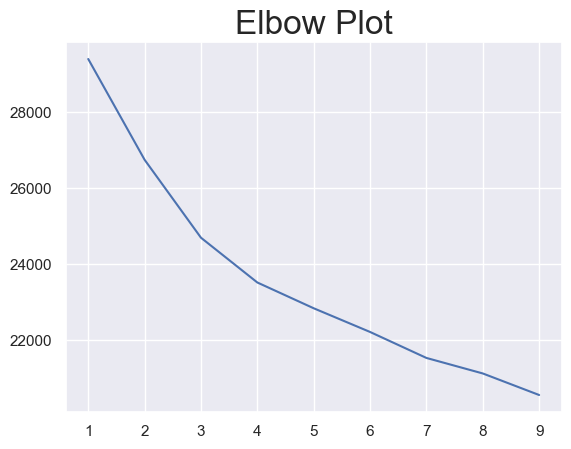

In [132]:
from scipy.cluster.vq import kmeans,vq

distortions = []
df_kmeans_HCC_SmartS = df_HCC_SmartS_filtered_normalised.astype(float)

for i in np.arange(1,10):
    cluster_center, distortion = kmeans(df_kmeans_HCC_SmartS,i)
    distortions.append(distortion)

plt.plot(np.arange(1,10),distortions)
plt.title('Elbow Plot', fontsize=24)

plt.show()

In [133]:
#doing it with main data
cluster_center_main, distortion = kmeans(df_kmeans_HCC_SmartS,2)

cluster_labels_main, _ = vq(df_kmeans_HCC_SmartS, cluster_center_main)

condition_no_HCC_SmartS = np.where(condition_HCC_SmartS == "Normo",1,0)

def scoring_kmeans(cluster_labels):
    return max(sum(abs(cluster_labels-condition_no_HCC_SmartS))/len(cluster_labels),1-sum(abs(cluster_labels-condition_no_HCC_SmartS))/len(cluster_labels))

print(f"The accuracy of the clustering is: {scoring_kmeans(cluster_labels_main) * 100:.2f}%")


The accuracy of the clustering is: 51.65%


### Kmeans PCA

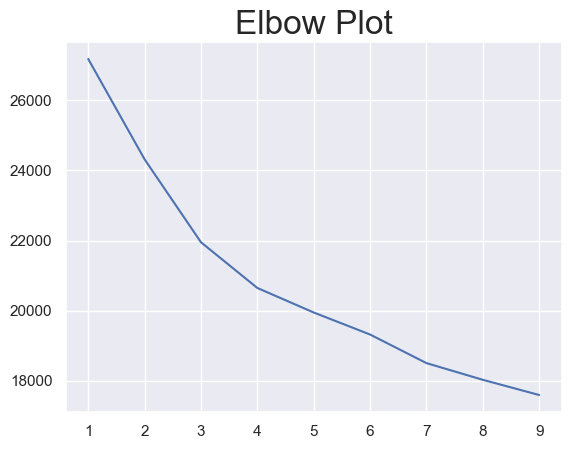

In [134]:
distortions = []

for i in np.arange(1,10):
    cluster_center, distortion = kmeans(pca_data_HCC_SmartS,i)
    distortions.append(distortion)

plt.plot(np.arange(1,10),distortions)
plt.title('Elbow Plot', fontsize=24)

plt.show()

In [135]:
#doing it with pca

cluster_center_pca_1, distortion = kmeans(pca_data_HCC_SmartS,2)

cluster_labels_pca_1, _ = vq(pca_data_HCC_SmartS, cluster_center_pca_1)


cluster_center_pca_2, distortion = kmeans(pca_data_HCC_SmartS,4)

cluster_labels_pca_2, _ = vq(pca_data_HCC_SmartS, cluster_center_pca_2)

print(f"The accuracy of the clustering is: {scoring_kmeans(cluster_labels_pca_1) * 100:.2f}%")



The accuracy of the clustering is: 52.20%


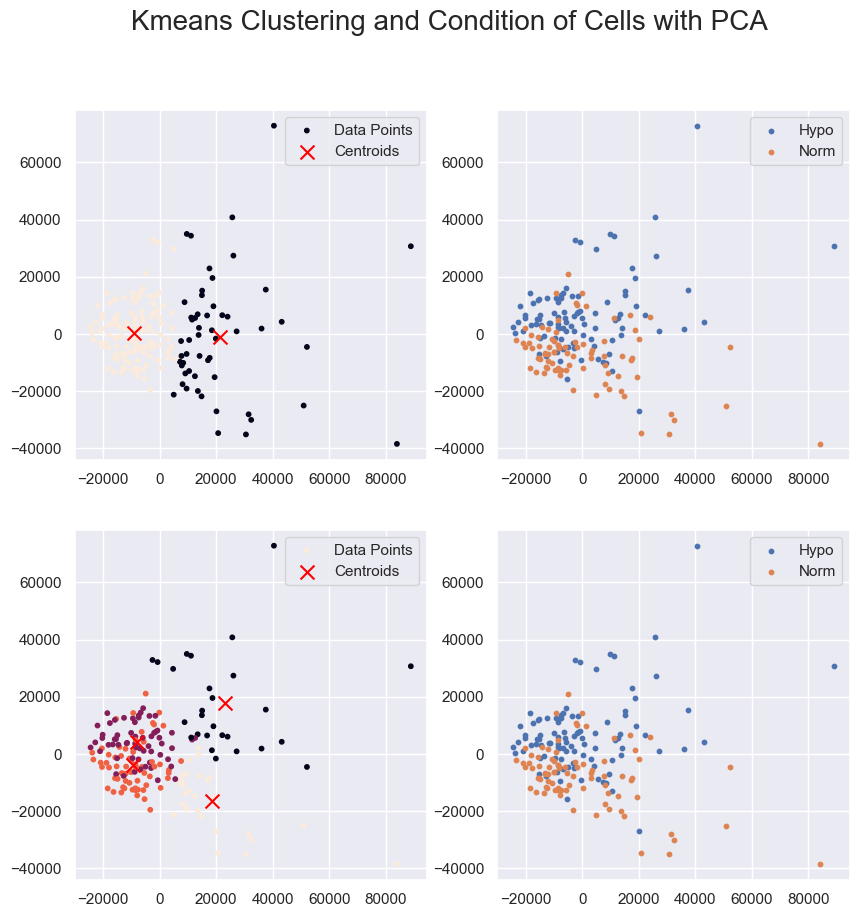

In [136]:
#plotting with pca

fig,ax =plt.subplots(2,2,figsize=(10,10))

ax[0,0].scatter(pca_data_HCC_SmartS.iloc[:,0], pca_data_HCC_SmartS.iloc[:,1],s=10, c=cluster_labels_pca_1, marker='o', label='Data Points')
ax[0,0].scatter(cluster_center_pca_1[:, 0], cluster_center_pca_1[:, 1], c='red', s=100, marker='x', label='Centroids')
ax[0,0].legend()


pca_data_hypo_HCC_SmartS = pca_data_HCC_SmartS[np.where(condition_HCC_SmartS =="Hypo",True,False)]
pca_data_norm_HCC_SmartS = pca_data_HCC_SmartS[np.where(condition_HCC_SmartS =="Normo",True,False)]

ax[0,1].scatter(pca_data_hypo_HCC_SmartS.iloc[:,0], pca_data_hypo_HCC_SmartS.iloc[:,1],s=10, label="Hypo")
ax[0,1].scatter(pca_data_norm_HCC_SmartS.iloc[:,0], pca_data_norm_HCC_SmartS.iloc[:,1],s=10, label="Norm")
ax[0,1].legend()

ax[1,0].scatter(pca_data_HCC_SmartS.iloc[:,0], pca_data_HCC_SmartS.iloc[:,1],s=10, c=cluster_labels_pca_2, marker='o', label='Data Points')
ax[1,0].scatter(cluster_center_pca_2[:, 0], cluster_center_pca_2[:, 1], c='red', s=100, marker='x', label='Centroids')
ax[1,0].legend()

ax[1,1].scatter(pca_data_hypo_HCC_SmartS.iloc[:,0], pca_data_hypo_HCC_SmartS.iloc[:,1],s=10, label="Hypo")
ax[1,1].scatter(pca_data_norm_HCC_SmartS.iloc[:,0], pca_data_norm_HCC_SmartS.iloc[:,1],s=10, label="Norm")
ax[1,1].legend()

fig.suptitle("Kmeans Clustering and Condition of Cells with PCA", fontsize=20)


plt.show()


### Kmeans UMAP

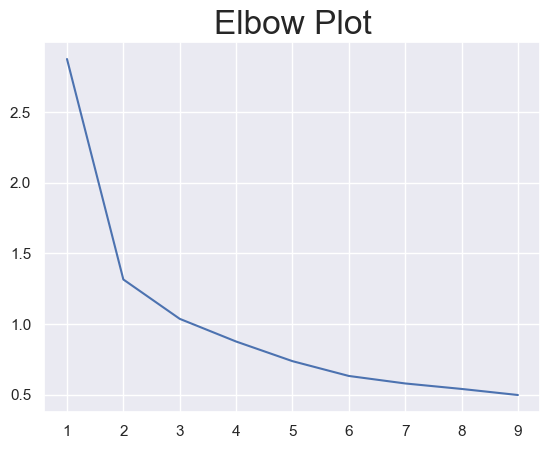

In [137]:
from scipy.cluster.vq import kmeans,vq

distortions = []

for i in np.arange(1,10):
    cluster_center, distortion = kmeans(umap_data_HCC_SmartS,i)
    distortions.append(distortion)

plt.plot(np.arange(1,10),distortions)
plt.title("Elbow Plot", fontsize=24)
plt.show()

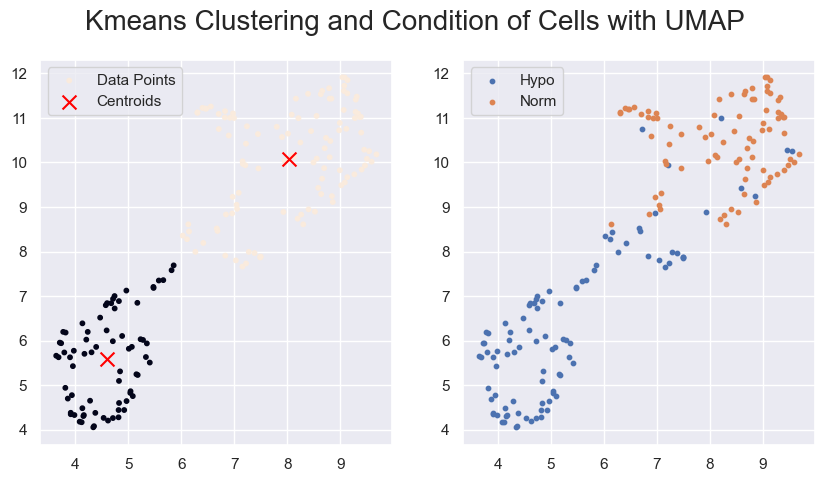

The accuracy of the clustering is: 86.26%


In [138]:
cluster_center_umap, distortion = kmeans(umap_data_HCC_SmartS,2)

cluster_labels_umap, _ = vq(umap_data_HCC_SmartS, cluster_center_umap)


fig, ax = plt.subplots(1,2,figsize=(10,5))

ax[0].scatter(umap_data_HCC_SmartS.iloc[:,0], umap_data_HCC_SmartS.iloc[:,1], c=cluster_labels_umap,s=10, marker='o', label='Data Points')
ax[0].scatter(cluster_center_umap[:, 0], cluster_center_umap[:, 1], c='red', s=100, marker='x', label='Centroids')
ax[0].legend()




umap_data_hypo_HCC_SmartS = umap_data_HCC_SmartS[np.where(condition_HCC_SmartS =="Hypo",True,False)]
umap_data_norm_HCC_SmartS = umap_data_HCC_SmartS[np.where(condition_HCC_SmartS =="Normo",True,False)]

ax[1].scatter(umap_data_hypo_HCC_SmartS.iloc[:,0], umap_data_hypo_HCC_SmartS.iloc[:,1],s=10, label="Hypo")
ax[1].scatter(umap_data_norm_HCC_SmartS.iloc[:,0], umap_data_norm_HCC_SmartS.iloc[:,1],s=10, label="Norm")
ax[1].legend()

fig.suptitle("Kmeans Clustering and Condition of Cells with UMAP", fontsize=20)


plt.show()


print(f"The accuracy of the clustering is: {scoring_kmeans(cluster_labels_umap) * 100:.2f}%")





## 5.3. MCF DropS

In [139]:
df_MCF_DropS.head()

,Hypoxia,"""MALAT1""","""MT-RNR2""","""NEAT1""","""H1-5""","""TFF1""","""MT-RNR1""","""H4C3""","""GDF15""","""KRT81""",...,"""MROH1""","""SKIDA1""","""MICALL1""","""RARG""","""MYO1F""","""BRWD1-AS2""","""RPS19BP1""","""AUNIP""","""TNK2""","""SUDS3"""
"""AAAAACCTATCG_Normoxia""",0,1,0,0,0,4,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACAACCCTA_Normoxia""",0,3,0,0,0,1,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACACTCTCA_Normoxia""",0,3,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACCAGGCAC_Normoxia""",0,6,2,0,0,1,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACCTAGCTC_Normoxia""",0,4,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


### Full Data

#### UMAP

/Users/emmamora/anaconda3/lib/python3.11/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


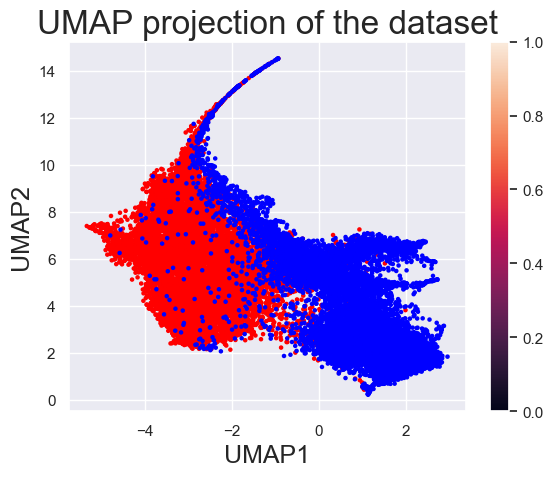

In [140]:
import umap

n_components=2

reducer = umap.UMAP(n_neighbors=15, min_dist=0.1, n_components=n_components, random_state=42)

embedding_MCF_DropS = reducer.fit_transform(df_MCF_DropS)


condition_color_MCF_DropS = ["red" if 'normoxia' in idx.lower() else "blue" for idx in df_MCF_DropS.index]
condition_color_MCF_DropS = np.array(condition_color_MCF_DropS)

plt.scatter(embedding_MCF_DropS[:, 0], embedding_MCF_DropS[:, 1], s=5, color=condition_color_MCF_DropS)
plt.title('UMAP projection of the dataset', fontsize=24)
plt.xlabel('UMAP1', fontsize=18)
plt.ylabel('UMAP2', fontsize=18)
plt.colorbar()

plt.show()

umap_data_MCF_DropS = pd.DataFrame(embedding_MCF_DropS, index = df_MCF_DropS.index, columns =[f'UMAP{i+1}' for i in range(n_components)])


#### PCA

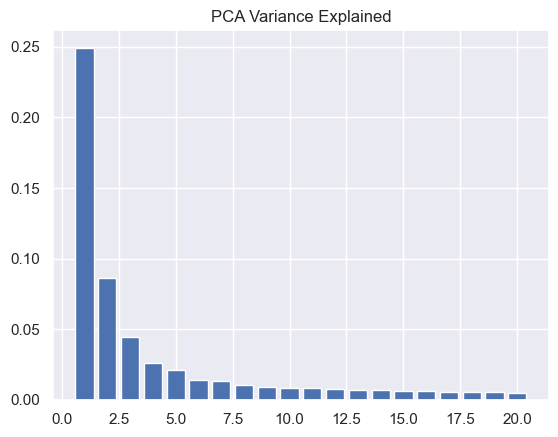

In [141]:
from sklearn.decomposition import PCA

pca = PCA()

pca.fit(df_MCF_DropS)

plt.bar(np.arange(1,21), pca.explained_variance_ratio_[:20])
plt.title("PCA Variance Explained")
plt.show()

#### Looking into PCA

In [142]:
n_components=15

pca = PCA(n_components=n_components)

pca_result= pca.fit_transform(df_MCF_DropS)



pca_data_MCF_DropS = pd.DataFrame(pca_result, index = df_MCF_DropS.index, columns=[f'PC{i+1}' for i in range(n_components)])


loadings = pca.components_.T  

loadings_df = pd.DataFrame(loadings, index=df_MCF_DropS.columns, columns=[f'PC{i+1}' for i in range(n_components)])

#sort the df

loadings_abs = loadings_df.abs()
loadings_sorted= loadings_abs.sort_values(by="PC1",ascending=False)
loadings_sorted.head(10)

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,PC15
"""MALAT1""",0.936675,0.340739,0.003793,0.037041,0.005002,0.020975,0.001262,0.007767,0.026787,0.002478,0.003541,0.000286,0.006425,0.001094,0.002269
"""BCYRN1""",0.148095,0.353475,0.771303,0.409534,0.215116,0.052723,0.112628,0.111876,0.019116,0.007128,0.018717,0.029997,0.027431,0.034937,0.008014
"""RPS19""",0.137994,0.416637,0.098201,0.178456,0.370649,0.466930,0.609916,0.134352,0.004337,0.034530,0.085475,0.027695,0.015258,0.019154,0.002167
"""TFF1""",0.087979,0.255989,0.411221,0.191786,0.770372,0.292106,0.056250,0.121111,0.004542,0.024259,0.050402,0.018825,0.094189,0.004465,0.002347
"""RPL13""",0.081916,0.220036,0.046638,0.062711,0.070320,0.161379,0.260600,0.077202,0.091801,0.671475,0.576023,0.041662,0.008675,0.093331,0.072378
"""RPL35""",0.080592,0.215769,0.032070,0.022528,0.079948,0.065778,0.210979,0.148914,0.089115,0.696677,0.551699,0.079661,0.109550,0.134036,0.075698
"""RPS14""",0.066244,0.177508,0.084460,0.025267,0.080298,0.067656,0.106505,0.011818,0.039450,0.073511,0.204846,0.885973,0.186317,0.089702,0.016560
"""RPL12""",0.058796,0.164026,0.021708,0.059589,0.044158,0.059060,0.126735,0.057932,0.029108,0.013749,0.129184,0.050895,0.170605,0.193114,0.356941
"""RPS12""",0.056229,0.154396,0.017809,0.048366,0.066146,0.020895,0.152324,0.125017,0.057614,0.009188,0.094506,0.129568,0.160541,0.285120,0.254566
"""RPS27""",0.051306,0.139868,0.017737,0.007312,0.065114,0.009882,0.117153,0.070648,0.063705,0.010159,0.193121,0.047469,0.239639,0.165575,0.858613


#### Hierarchical

/Users/emmamora/anaconda3/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/Users/emmamora/anaconda3/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


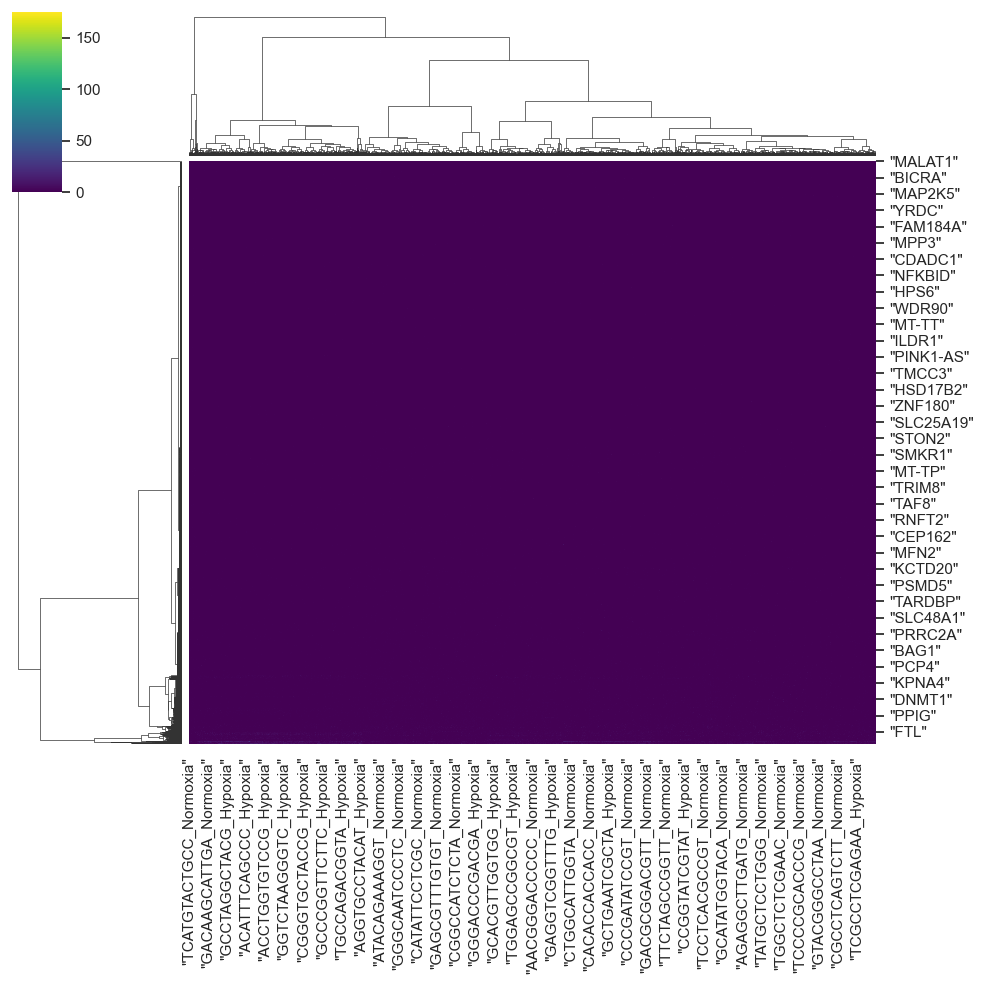

In [143]:
s = sns.clustermap(df_MCF_DropS.T, method='ward', cmap='viridis')
plt.show()

/Users/emmamora/anaconda3/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/Users/emmamora/anaconda3/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


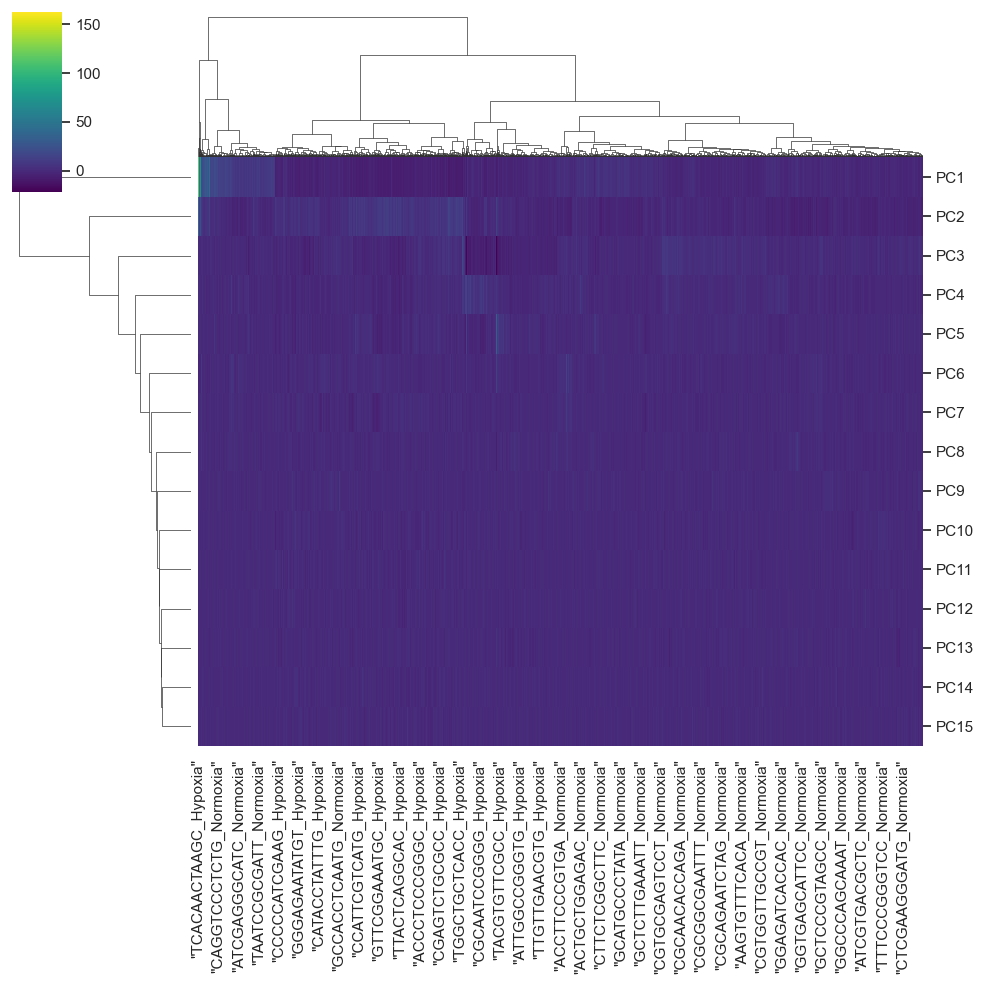

In [144]:
s = sns.clustermap(pca_data_MCF_DropS.T, method='ward', cmap='viridis')
plt.show()

/Users/emmamora/anaconda3/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/Users/emmamora/anaconda3/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


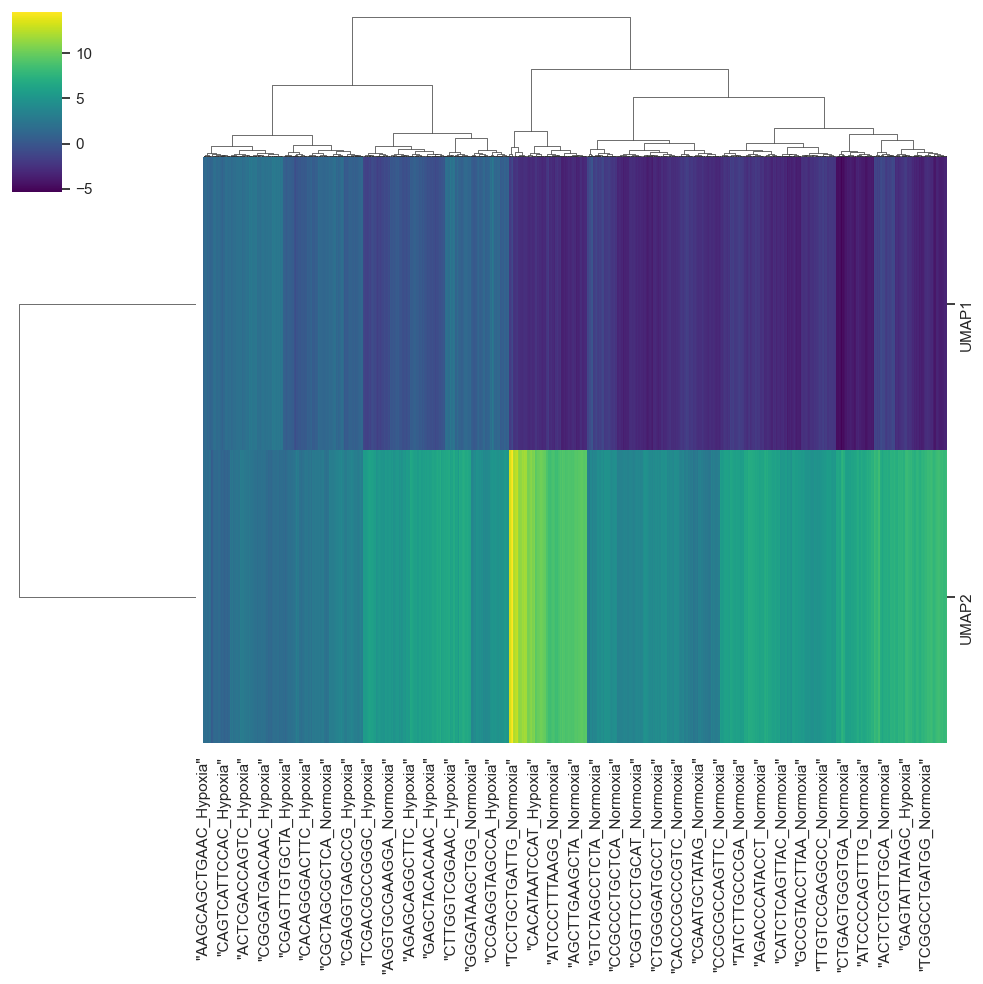

In [145]:
s = sns.clustermap(umap_data_MCF_DropS.T, method='ward', cmap='viridis')
plt.show()

#### Kmeans

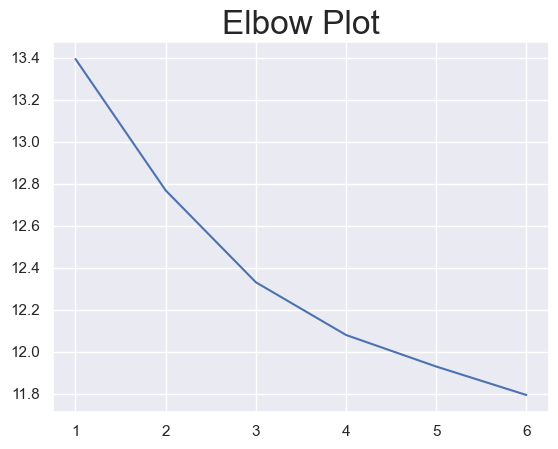

In [146]:
from scipy.cluster.vq import kmeans,vq

distortions = []
df_kmeans_MCF_DropS = df_MCF_DropS.astype(float)

for i in np.arange(1,7):
    cluster_center, distortion = kmeans(df_kmeans_MCF_DropS,i)
    distortions.append(distortion)

plt.plot(np.arange(1,7),distortions)
plt.title("Elbow Plot", fontsize=24)
plt.show()

In [147]:
#doing it with main data
from scipy.cluster.vq import kmeans,vq

df_kmeans_MCF_DropS = df_MCF_DropS.astype(float)

cluster_center, distortion = kmeans(df_kmeans_MCF_DropS,2)

cluster_labels, _ = vq(df_kmeans_MCF_DropS, cluster_center)

#looking to compare scores

condition_no_MCF_DropS = [1 if 'normoxia' in idx.lower() else 0 for idx in df_kmeans_MCF_DropS.index]
condition_no_MCF_DropS=np.array(condition_no_MCF_DropS)


def scoring_kmeans(cluster_labels):
    return max(sum(abs(cluster_labels-condition_no_MCF_DropS))/len(cluster_labels),1-sum(abs(cluster_labels-condition_no_MCF_DropS))/len(cluster_labels))

print(f"The accuracy of the clustering is: {scoring_kmeans(cluster_labels) * 100:.2f}%")

The accuracy of the clustering is: 79.77%


#### Kmeans PCA

In [148]:
#doing it with pca

cluster_center_2, distortion = kmeans(pca_data_MCF_DropS ,2)

cluster_labels_2, _ = vq(pca_data_MCF_DropS, cluster_center_2)


cluster_center_3, distortion = kmeans(pca_data_MCF_DropS,4)

cluster_labels_3, _ = vq(pca_data_MCF_DropS, cluster_center_3)

print(f"The accuracy of the clustering is: {scoring_kmeans(cluster_labels_2) * 100:.2f}%")

The accuracy of the clustering is: 79.77%


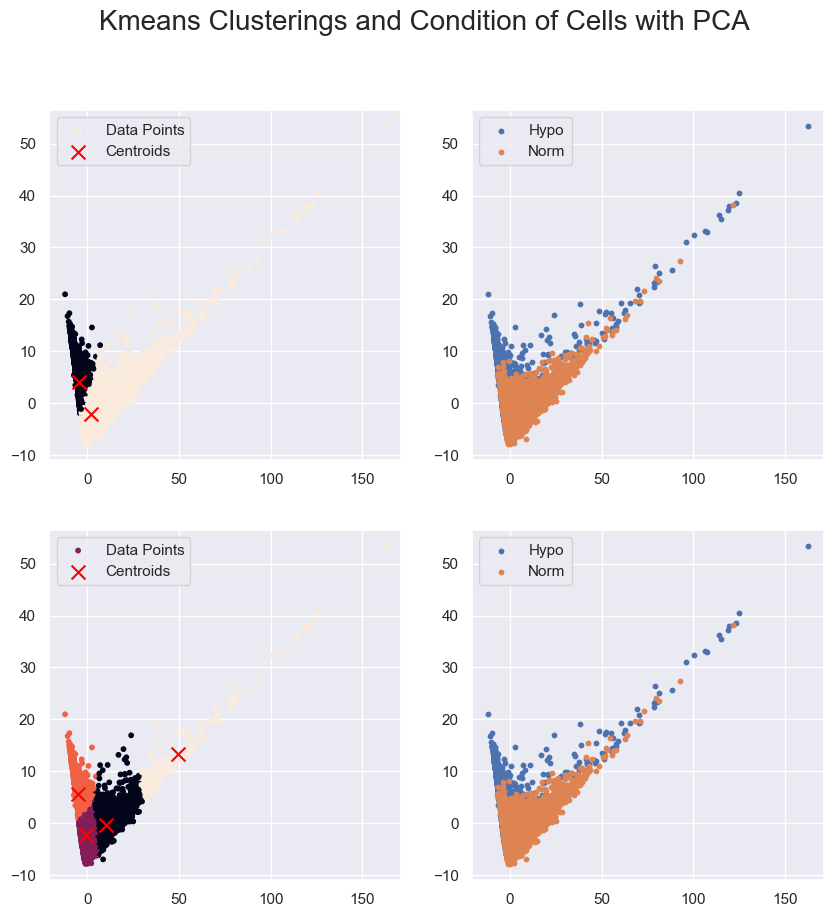

In [149]:
#plotting with pca

fig,ax =plt.subplots(2,2,figsize=(10,10))

ax[0,0].scatter(pca_data_MCF_DropS.iloc[:,0], pca_data_MCF_DropS.iloc[:,1], c=cluster_labels_2,s=10, marker='o', label='Data Points')
ax[0,0].scatter(cluster_center_2[:, 0], cluster_center_2[:, 1], c='red', s=100, marker='x', label='Centroids')
ax[0,0].legend()


pca_data_norm_MCF_DropS = pca_data_MCF_DropS[np.where(condition_no_MCF_DropS == 1,True,False)]
pca_data_hypo_MCF_DropS = pca_data_MCF_DropS[np.where(condition_no_MCF_DropS == 0,True,False)]

ax[0,1].scatter(pca_data_hypo_MCF_DropS.iloc[:,0], pca_data_hypo_MCF_DropS.iloc[:,1],s=10, label="Hypo")
ax[0,1].scatter(pca_data_norm_MCF_DropS.iloc[:,0], pca_data_norm_MCF_DropS.iloc[:,1], s=10,label="Norm")
ax[0,1].legend()


ax[1,0].scatter(pca_data_MCF_DropS.iloc[:,0], pca_data_MCF_DropS.iloc[:,1], c=cluster_labels_3,s=10, marker='o', label='Data Points')
ax[1,0].scatter(cluster_center_3[:, 0], cluster_center_3[:, 1], c='red', s=100, marker='x', label='Centroids')
ax[1,0].legend()

ax[1,1].scatter(pca_data_hypo_MCF_DropS.iloc[:,0], pca_data_hypo_MCF_DropS.iloc[:,1], s=10,label="Hypo")
ax[1,1].scatter(pca_data_norm_MCF_DropS.iloc[:,0], pca_data_norm_MCF_DropS.iloc[:,1],s=10, label="Norm")
ax[1,1].legend()

fig.suptitle("Kmeans Clusterings and Condition of Cells with PCA", fontsize=20)
plt.show()


#### Kmeans UMAP

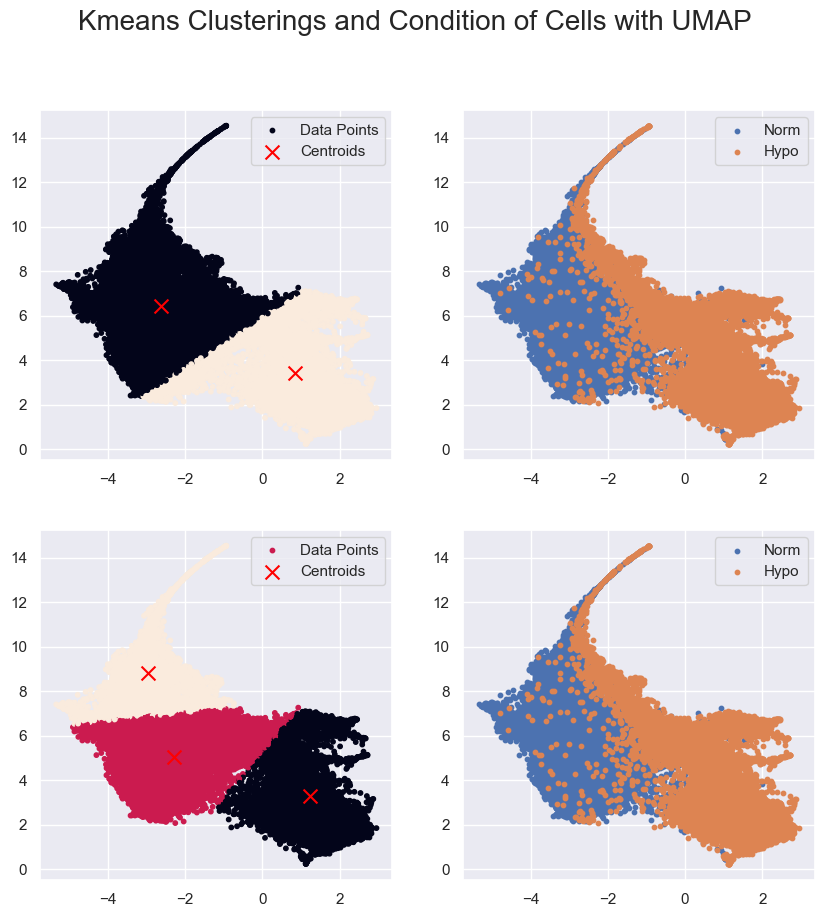

The accuracy of the clustering is: 86.29%


In [150]:
from scipy.cluster.vq import kmeans,vq

cluster_center_2, distortion = kmeans(umap_data_MCF_DropS,2)

cluster_labels_2, _ = vq(umap_data_MCF_DropS, cluster_center_2)


cluster_center_3, distortion = kmeans(umap_data_MCF_DropS,3)

cluster_labels_3, _ = vq(umap_data_MCF_DropS, cluster_center_3)

fig,ax =plt.subplots(2,2,figsize=(10,10))
ax[0,0].scatter(umap_data_MCF_DropS.iloc[:,0], umap_data_MCF_DropS.iloc[:,1], s=10,c=cluster_labels_2, marker='o', label='Data Points')
ax[0,0].scatter(cluster_center_2[:, 0], cluster_center_2[:, 1], c='red', s=100, marker='x', label='Centroids')
ax[0,0].legend()



umap_data_norm_MCF_DropS = umap_data_MCF_DropS[np.where(condition_no_MCF_DropS == 1,True,False)]
umap_data_hypo_MCF_DropS = umap_data_MCF_DropS[np.where(condition_no_MCF_DropS == 0,True,False)]

ax[0,1].scatter(umap_data_norm_MCF_DropS.iloc[:,0], umap_data_norm_MCF_DropS.iloc[:,1], s=10,label="Norm")
ax[0,1].scatter(umap_data_hypo_MCF_DropS.iloc[:,0], umap_data_hypo_MCF_DropS.iloc[:,1], s=10, label="Hypo")
ax[0,1].legend()

ax[1,0].scatter(umap_data_MCF_DropS.iloc[:,0], umap_data_MCF_DropS.iloc[:,1], c=cluster_labels_3,s=10, marker='o', label='Data Points')
ax[1,0].scatter(cluster_center_3[:, 0], cluster_center_3[:, 1], c='red', s=100, marker='x', label='Centroids')
ax[1,0].legend()

ax[1,1].scatter(umap_data_norm_MCF_DropS.iloc[:,0], umap_data_norm_MCF_DropS.iloc[:,1], s=10,label="Norm")
ax[1,1].scatter(umap_data_hypo_MCF_DropS.iloc[:,0], umap_data_hypo_MCF_DropS.iloc[:,1], s=10,label="Hypo")
ax[1,1].legend()
fig.suptitle("Kmeans Clusterings and Condition of Cells with UMAP", fontsize=20)


plt.show()

print(f"The accuracy of the clustering is: {scoring_kmeans(cluster_labels_2)*100:.2f}%")

#### Gaussian Clustering

In [151]:
from sklearn.mixture import GaussianMixture

gmm = GaussianMixture(n_components=2)
gmm.fit(df_kmeans_MCF_DropS)
clusters = gmm.predict(df_kmeans_MCF_DropS)

print(f"The accuracy of the clustering is: {scoring_kmeans(clusters) * 100:.2f}%")

The accuracy of the clustering is: 65.89%


#### Gaussian PCA

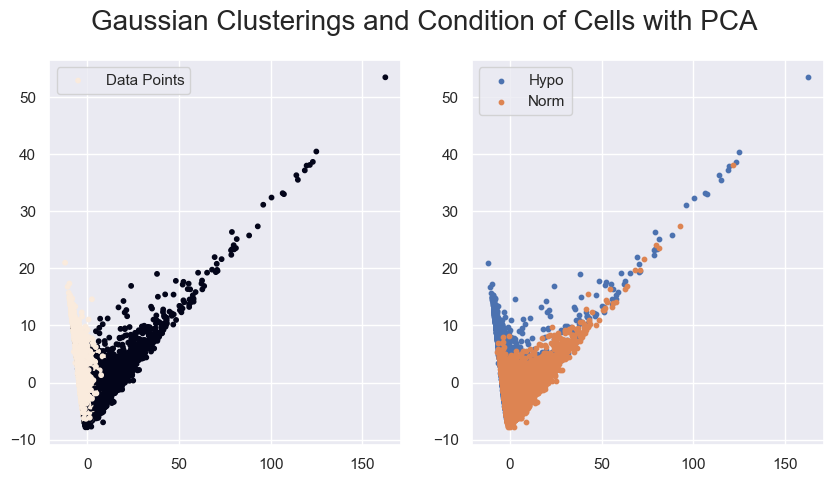

The accuracy of the clustering is: 83.38%


In [152]:
from sklearn.mixture import GaussianMixture

gmm = GaussianMixture(n_components=2)
gmm.fit(pca_data_MCF_DropS)
clusters = gmm.predict(pca_data_MCF_DropS)



fig, ax = plt.subplots(1,2,figsize=(10,5))

ax[0].scatter(pca_data_MCF_DropS.iloc[:,0], pca_data_MCF_DropS.iloc[:,1],s=10, c=clusters, marker='o', label='Data Points')
ax[0].legend()

ax[1].scatter(pca_data_hypo_MCF_DropS.iloc[:,0], pca_data_hypo_MCF_DropS.iloc[:,1],s=10, label="Hypo")
ax[1].scatter(pca_data_norm_MCF_DropS.iloc[:,0], pca_data_norm_MCF_DropS.iloc[:,1], s=10,label="Norm")
ax[1].legend()

fig.suptitle("Gaussian Clusterings and Condition of Cells with PCA", fontsize=20)


plt.show()


print(f"The accuracy of the clustering is: {scoring_kmeans(clusters) * 100:.2f}%")

#### Gaussian UMAP

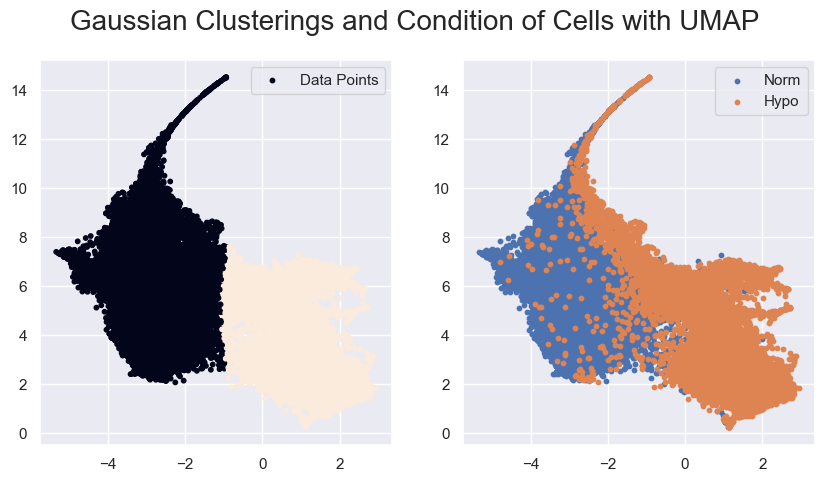

The accuracy of the clustering is: 91.84%


In [153]:
from sklearn.mixture import GaussianMixture

gmm = GaussianMixture(n_components=2)
gmm.fit(umap_data_MCF_DropS)
clusters = gmm.predict(umap_data_MCF_DropS)



fig, ax = plt.subplots(1,2,figsize=(10,5))

ax[0].scatter(umap_data_MCF_DropS.iloc[:,0], umap_data_MCF_DropS.iloc[:,1], s=10,c=clusters, marker='o', label='Data Points')
ax[0].legend()


ax[1].scatter(umap_data_norm_MCF_DropS.iloc[:,0], umap_data_norm_MCF_DropS.iloc[:,1], s=10,label="Norm")
ax[1].scatter(umap_data_hypo_MCF_DropS.iloc[:,0], umap_data_hypo_MCF_DropS.iloc[:,1],s=10, label="Hypo")
ax[1].legend()

fig.suptitle("Gaussian Clusterings and Condition of Cells with UMAP", fontsize=20)

plt.show()

print(f"The accuracy of the clustering is: {scoring_kmeans(clusters) * 100:.2f}%")


### Feature selection


Here we select features to examine our models of unsupervised learning

In [154]:
df_MCF_DropS_feature_select = df_MCF_DropS

if "Hypoxia" not in df_MCF_DropS_feature_select.columns:
    df_MCF_DropS_feature_select.loc[:, "Hypoxia"] = [1 if "Hypoxia" in idx else 0 for idx in df_MCF_DropS_feature_select.index]
    cols = ['Hypoxia'] + [col for col in df_MCF_DropS_feature_select.columns if col != 'Hypoxia']
    df_MCF_DropS_feature_select = df_MCF_DropS_feature_select[cols]

In [155]:
# calculate correlation matrix
correlations_MCF_DropS = df_MCF_DropS_feature_select.corr()

# get correlations with the 'Hypoxia' column
correlations_MCF_DropS = correlations_MCF_DropS['Hypoxia'].sort_values(ascending=False)

# filter out the target variable itself 
correlations_MCF_DropS = correlations_MCF_DropS.drop(labels=['Hypoxia'])
print(correlations_MCF_DropS)
significant_genes_MCF_DropS = correlations_MCF_DropS[abs(correlations_MCF_DropS) > 0.2]
print(significant_genes_MCF_DropS)

df_MCF_DropS_feature_select = df_MCF_DropS_feature_select.loc[:,list(significant_genes_MCF_DropS.index)]

"TFF1"       0.503544
"TMSB10"     0.466682
"RPS19"      0.461537
"KRT19"      0.453162
"RPL13"      0.451473
               ...   
"TOB1"      -0.219071
"SET"       -0.229521
"MT-ND4"    -0.250744
"MT-RNR1"   -0.313027
"MT-RNR2"   -0.366593
Name: Hypoxia, Length: 3000, dtype: float64
"TFF1"       0.503544
"TMSB10"     0.466682
"RPS19"      0.461537
"KRT19"      0.453162
"RPL13"      0.451473
"RPS14"      0.443339
"LGALS1"     0.441337
"GAPDH"      0.436868
"RPL35"      0.406370
"PGK1"       0.398095
"TPI1"       0.383217
"RPL12"      0.378812
"RPL34"      0.371134
"RPL15"      0.368787
"RPS5"       0.362652
"RPLP1"      0.353983
"RPL35A"     0.343673
"RPL30"      0.337611
"RPL39"      0.336855
"RPL36"      0.323383
"S100A10"    0.322777
"TMEM258"    0.314062
"ROMO1"      0.311261
"RPS15A"     0.309510
"RPS27"      0.302663
"SNRPD2"     0.301909
"HES1"       0.301172
"RPS16"      0.298994
"RPLP2"      0.297037
"SERF2"      0.296213
"ENO1"       0.295909
"UBA52"      0.295408
"PKM"     

#### UMAP

/Users/emmamora/anaconda3/lib/python3.11/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/var/folders/sc/040g6l752pg38ngvcz_ths0c0000gn/T/ipykernel_12426/3104156117.py:14: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(embedding_reduced_MCF_DropS[:, 0], embedding_reduced_MCF_DropS[:, 1], cmap='Spectral', s=5, color=condition_reduced_color_MCF_DropS)


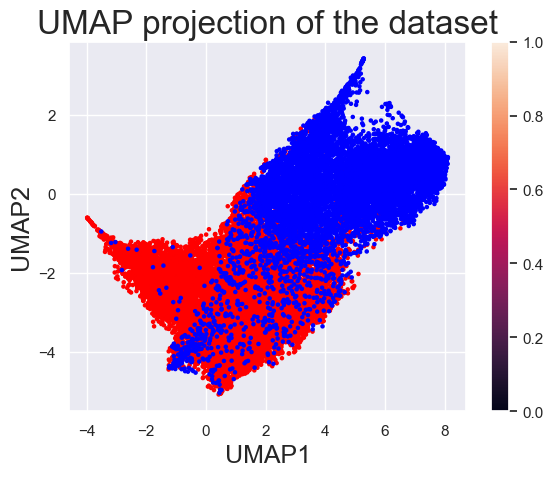

In [156]:
# analysis with feature selection
import umap

n_components=2

reducer = umap.UMAP(n_neighbors=15, min_dist=0.1, n_components=n_components, random_state=42)

embedding_reduced_MCF_DropS = reducer.fit_transform(df_MCF_DropS_feature_select)


condition_reduced_color_MCF_DropS = ["red" if 'normoxia' in idx.lower() else "blue" for idx in df_MCF_DropS_feature_select.index]
condition_reduced_color_MCF_DropS=np.array(condition_reduced_color_MCF_DropS)

plt.scatter(embedding_reduced_MCF_DropS[:, 0], embedding_reduced_MCF_DropS[:, 1], cmap='Spectral', s=5, color=condition_reduced_color_MCF_DropS)
plt.title('UMAP projection of the dataset', fontsize=24)
plt.xlabel('UMAP1', fontsize=18)
plt.ylabel('UMAP2', fontsize=18)
plt.colorbar()


plt.show()

umap_data_reduced_MCF_DropS = pd.DataFrame(embedding_reduced_MCF_DropS, index = df_MCF_DropS_feature_select.index, columns=[f'UMAP{i+1}' for i in range(n_components)])

#### PCA

In [157]:
from sklearn.decomposition import PCA

n_components=15

pca = PCA(n_components=n_components)

pca_result= pca.fit_transform(df_MCF_DropS_feature_select)


# look for pca components

pca_data_reduced_MCF_DropS = pd.DataFrame(pca_result, index = df_MCF_DropS_feature_select.index, columns=[f'PC{i+1}' for i in range(n_components)])

#### Hierarchical

/Users/emmamora/anaconda3/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


/Users/emmamora/anaconda3/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


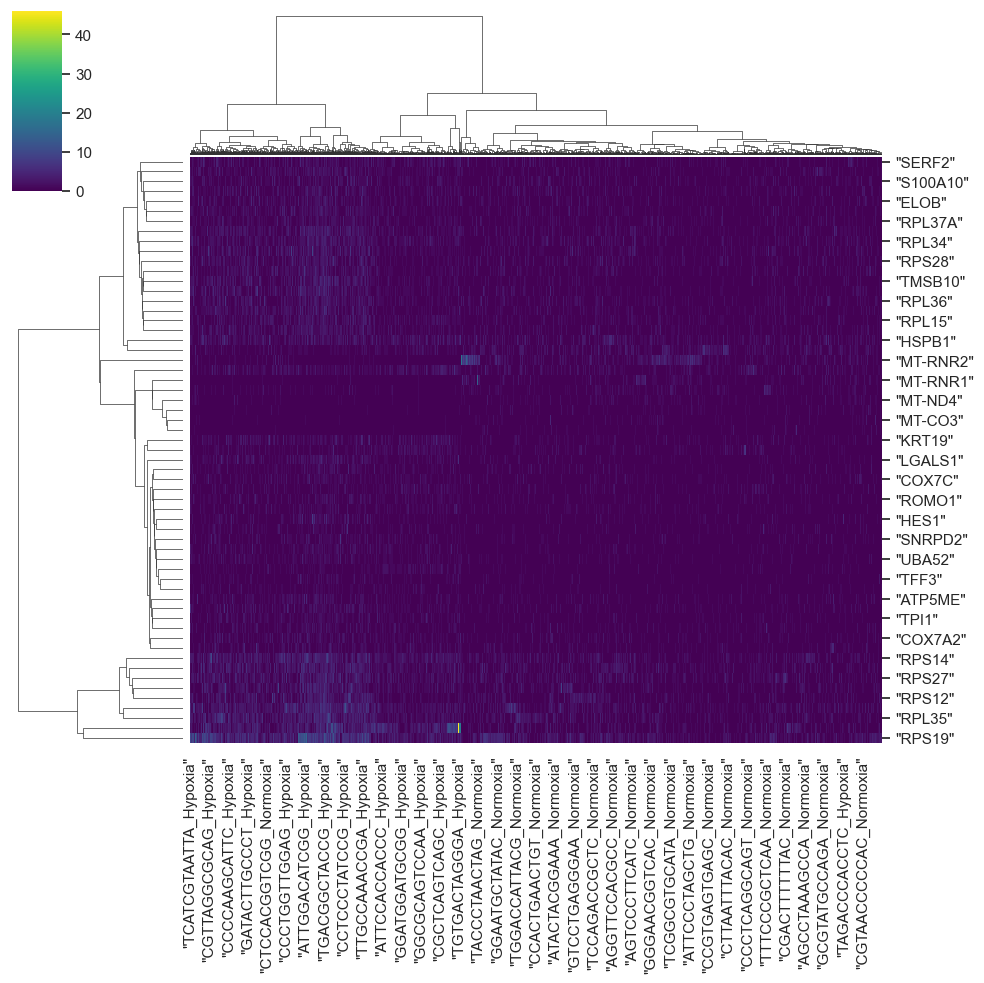

In [158]:
s = sns.clustermap(df_MCF_DropS_feature_select.T, method='ward', cmap='viridis')
plt.show()

/Users/emmamora/anaconda3/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/Users/emmamora/anaconda3/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


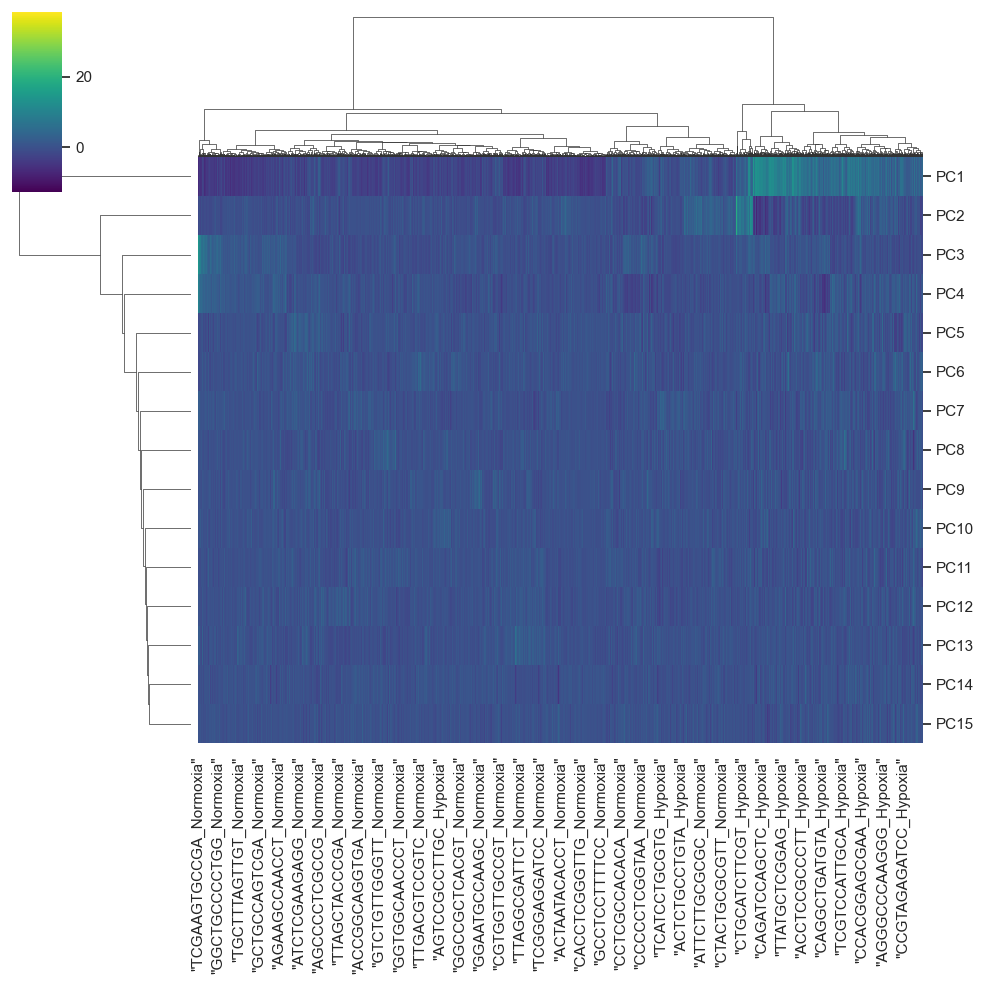

In [159]:
s = sns.clustermap(pca_data_reduced_MCF_DropS.T, method='ward', cmap='viridis')
plt.show()

/Users/emmamora/anaconda3/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/Users/emmamora/anaconda3/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


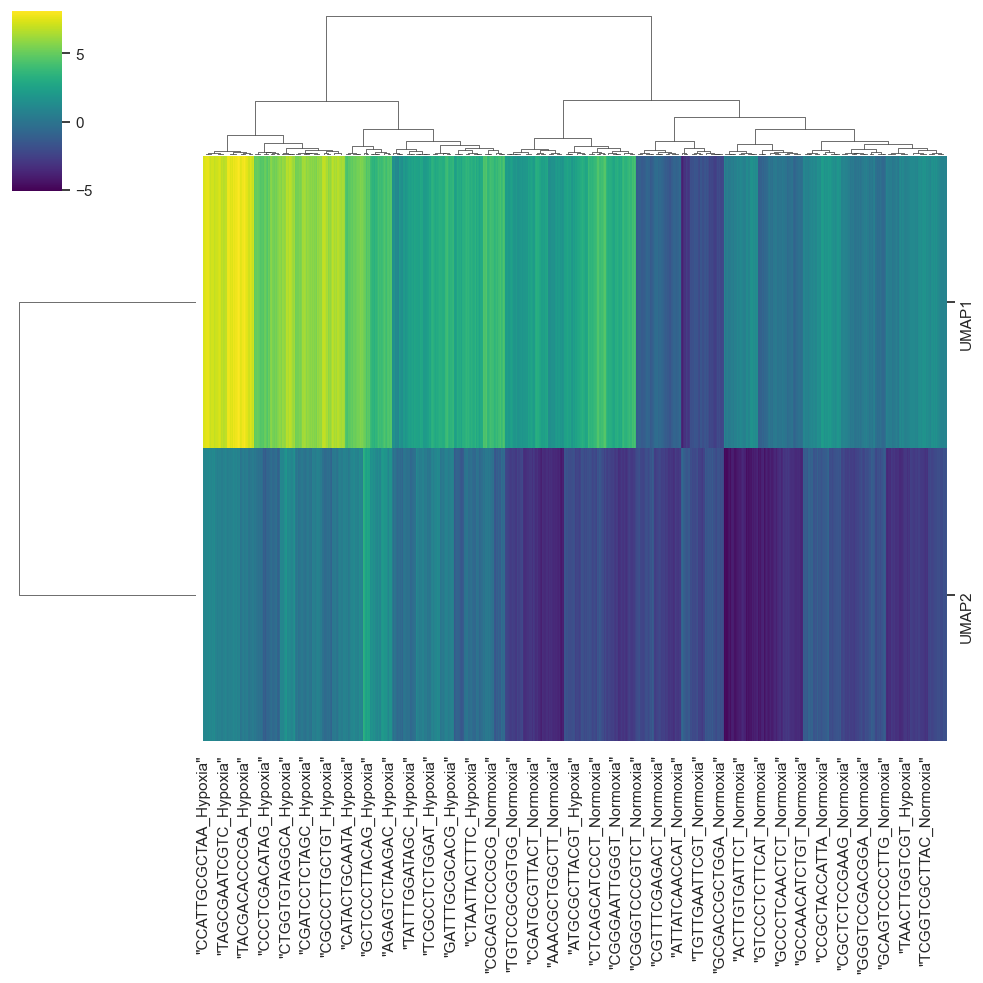

In [160]:
s = sns.clustermap(umap_data_reduced_MCF_DropS.T, method='ward', cmap='viridis')
plt.show() 

#### Kmeans

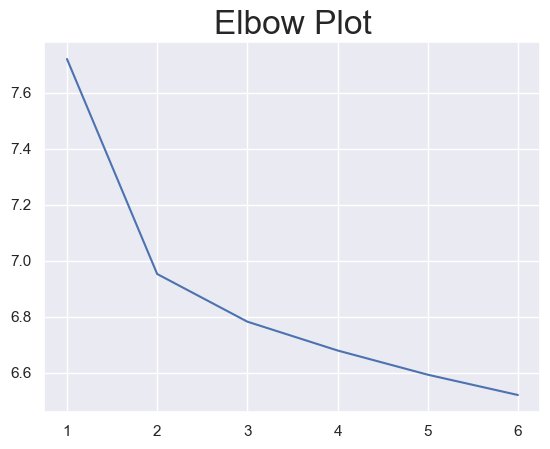

In [161]:
from scipy.cluster.vq import kmeans,vq

distortions = []

df_MCF_DropS_feature_select = df_MCF_DropS_feature_select.astype(float)

for i in np.arange(1,7):
    cluster_center, distortion = kmeans(df_MCF_DropS_feature_select,i)
    distortions.append(distortion)

plt.plot(np.arange(1,7),distortions)
plt.title("Elbow Plot", fontsize=24)
plt.show()

In [162]:
cluster_center, distortion = kmeans(df_MCF_DropS_feature_select,2)

cluster_labels, _ = vq(df_MCF_DropS_feature_select, cluster_center)

print(f"The accuracy of the clustering is: {scoring_kmeans(cluster_labels) * 100:.2f}%")

The accuracy of the clustering is: 82.69%


#### Kmeans PCA

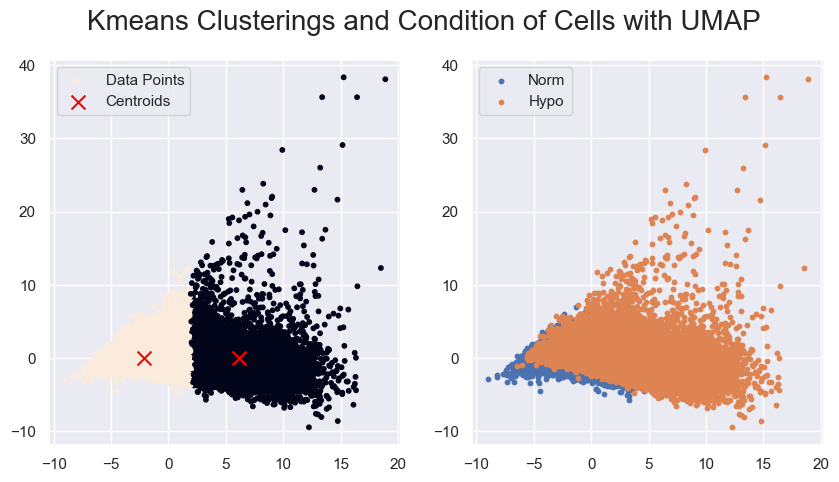

The accuracy of the clustering is: 82.65%


In [163]:
cluster_center, distortion = kmeans(pca_data_reduced_MCF_DropS,2)

cluster_labels, _ = vq(pca_data_reduced_MCF_DropS, cluster_center)

fig,ax =plt.subplots(1,2,figsize=(10,5))
ax[0].scatter(pca_data_reduced_MCF_DropS.iloc[:,0], pca_data_reduced_MCF_DropS.iloc[:,1], s=10,c=cluster_labels, marker='o', label='Data Points')
ax[0].scatter(cluster_center[:, 0], cluster_center[:, 1], c='red', s=100, marker='x', label='Centroids')
ax[0].legend()


pca_data_norm_reduced_MCF = pca_data_reduced_MCF_DropS[np.where(condition_no_MCF_DropS == 1,True,False)]
pca_data_hypo_reduced_MCF = pca_data_reduced_MCF_DropS[np.where(condition_no_MCF_DropS == 0,True,False)]

ax[1].scatter(pca_data_norm_reduced_MCF.iloc[:,0], pca_data_norm_reduced_MCF.iloc[:,1], s=10,label="Norm")
ax[1].scatter(pca_data_hypo_reduced_MCF.iloc[:,0], pca_data_hypo_reduced_MCF.iloc[:,1], s=10, label="Hypo")
ax[1].legend()

fig.suptitle("Kmeans Clusterings and Condition of Cells with UMAP", fontsize=20)


plt.show()
    

print(f"The accuracy of the clustering is: {scoring_kmeans(cluster_labels) * 100:.2f}%")

#### Kmeans UMAP

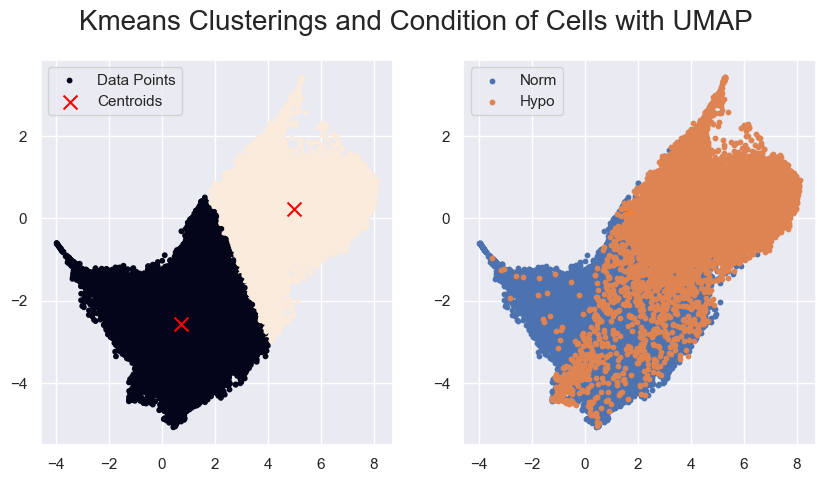

The accuracy of the clustering is: 90.66%


In [164]:
cluster_center, distortion = kmeans(umap_data_reduced_MCF_DropS,2)

cluster_labels, _ = vq(umap_data_reduced_MCF_DropS, cluster_center)

fig,ax =plt.subplots(1,2,figsize=(10,5))
ax[0].scatter(umap_data_reduced_MCF_DropS.iloc[:,0], umap_data_reduced_MCF_DropS.iloc[:,1], s=10,c=cluster_labels, marker='o', label='Data Points')
ax[0].scatter(cluster_center[:, 0], cluster_center[:, 1], c='red', s=100, marker='x', label='Centroids')
ax[0].legend()


umap_data_norm_reduced_MCF = umap_data_reduced_MCF_DropS[np.where(condition_no_MCF_DropS == 1,True,False)]
umap_data_hypo_reduced_MCF = umap_data_reduced_MCF_DropS[np.where(condition_no_MCF_DropS == 0,True,False)]

ax[1].scatter(umap_data_norm_reduced_MCF.iloc[:,0], umap_data_norm_reduced_MCF.iloc[:,1], s=10,label="Norm")
ax[1].scatter(umap_data_hypo_reduced_MCF.iloc[:,0], umap_data_hypo_reduced_MCF.iloc[:,1], s=10, label="Hypo")
ax[1].legend()

fig.suptitle("Kmeans Clusterings and Condition of Cells with UMAP", fontsize=20)


plt.show()
    

print(f"The accuracy of the clustering is: {scoring_kmeans(cluster_labels) * 100:.2f}%")

## 5.4. HCC DropS

In [165]:
df_HCC_DropS.head()

,Hypoxia,"""H1-5""","""MALAT1""","""MT-RNR2""","""ARVCF""","""BCYRN1""","""ATXN7L2""","""IGFBP3""","""H1-3""","""CTIF""",...,"""BATF3""","""CDKN3""","""DLD""","""PMPCA""","""ZNF165""","""SCCPDH""","""NTAN1""","""CLIP2""","""DUSP23""","""ZNF682"""
"""AAAAAACCCGGC_Normoxia""",0,2,3,0,0,0,0,0,2,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACCGGATGC_Normoxia""",0,2,3,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACGAGCTAG_Normoxia""",0,5,2,0,0,1,0,1,3,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACTTCCCCG_Normoxia""",0,1,3,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAAGCCTACCC_Normoxia""",0,0,12,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


### Full Data

### UMAP

/Users/emmamora/anaconda3/lib/python3.11/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


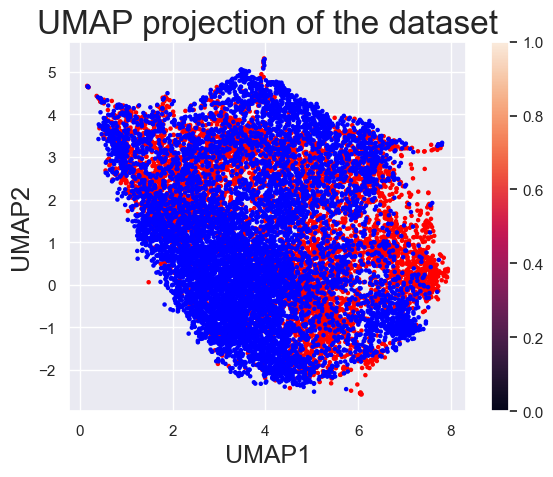

In [166]:
n_components =2

reducer = umap.UMAP(n_neighbors=10, min_dist=0.1, n_components=n_components, random_state=42)

# Fit the model and transform the data
embedding_HCC_DropS = reducer.fit_transform(df_HCC_DropS)


condition_color_HCC_DropS = ["red" if 'normoxia' in idx.lower() else "blue" for idx in df_HCC_DropS.index]
condition_color_HCC_DropS=np.array(condition_color_HCC_DropS)

plt.scatter(embedding_HCC_DropS[:, 0], embedding_HCC_DropS[:, 1], s=5, color=condition_color_HCC_DropS)
plt.title('UMAP projection of the dataset', fontsize=24)
plt.xlabel('UMAP1', fontsize=18)
plt.ylabel('UMAP2', fontsize=18)
plt.colorbar()


# Plotting the results

plt.show()

umap_data_HCC_DropS = pd.DataFrame(embedding_HCC_DropS, index = df_HCC_DropS.index, columns=[f'UMAP{i+1}' for i in range(n_components)])

### PCA

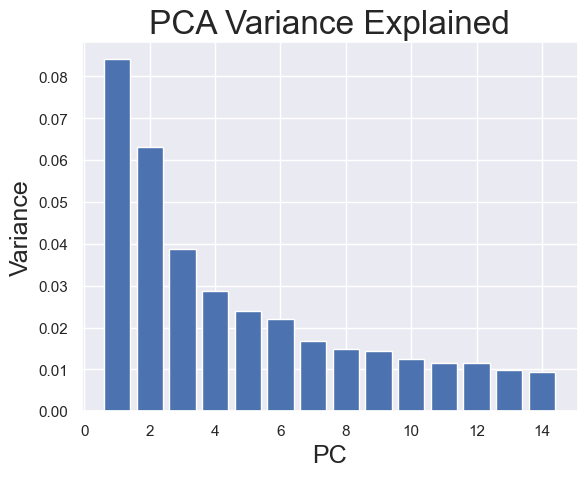

In [71]:
from sklearn.decomposition import PCA

pca = PCA()


pca.fit(df_HCC_DropS)
plt.bar(np.arange(1,15), pca.explained_variance_ratio_[:14])
plt.title('PCA Variance Explained', fontsize=24)
plt.xlabel('PC', fontsize=18)
plt.ylabel('Variance', fontsize=18)
plt.show()



### Looking into PCA

In [168]:
n_components=30

pca = PCA(n_components=n_components)

pca_result= pca.fit_transform(df_HCC_DropS)


#look for pca.components

pca_data_HCC_DropS = pd.DataFrame(pca_result, index = df_HCC_DropS.index, columns=[f'PC{i+1}' for i in range(n_components)])


# Loadings are the components_ attribute of the PCA object
loadings = pca.components_.T  # Transpose to align with the original data structure: variables as rows

# Create a DataFrame for better visualization and understanding
loadings_df = pd.DataFrame(loadings, index=df_HCC_DropS.columns, columns=[f'PC{i+1}' for i in range(n_components)])

#sort the df

loadings_abs = loadings_df.abs()
loadings_sorted= loadings_abs.sort_values(by="PC1",ascending=False)
loadings_sorted.head(10)


,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,...,PC21,PC22,PC23,PC24,PC25,PC26,PC27,PC28,PC29,PC30
"""FTL""",0.474701,0.147384,0.341016,0.600120,0.306813,0.392671,0.028059,0.086101,0.010830,0.035560,...,0.019170,0.000923,0.005326,0.000923,0.011680,0.021135,0.004198,0.005419,0.001533,0.020918
"""MALAT1""",0.403342,0.036179,0.887003,0.056701,0.060324,0.131365,0.057221,0.029302,0.092392,0.003888,...,0.003163,0.020562,0.016227,0.010568,0.022970,0.010196,0.013145,0.005075,0.019219,0.001732
"""RPS5""",0.373101,0.134687,0.163745,0.581586,0.135750,0.081251,0.323677,0.525618,0.189347,0.101390,...,0.020776,0.016992,0.006379,0.042001,0.018288,0.005588,0.044778,0.007788,0.030794,0.018103
"""HSP90B1""",0.215643,0.099268,0.002109,0.112383,0.538709,0.138713,0.477167,0.007930,0.411706,0.004475,...,0.008198,0.069877,0.057700,0.045007,0.085177,0.032701,0.025432,0.045340,0.055807,0.033978
"""RPS28""",0.200785,0.004376,0.050611,0.094577,0.151291,0.237989,0.078731,0.240973,0.078570,0.249531,...,0.025033,0.060272,0.065093,0.064508,0.022260,0.042049,0.009525,0.009359,0.042106,0.003588
"""BCYRN1""",0.181009,0.071828,0.088178,0.201520,0.080423,0.194434,0.041037,0.455092,0.000949,0.213750,...,0.038775,0.064699,0.038508,0.064461,0.031957,0.062884,0.073357,0.025069,0.012655,0.068181
"""H1-5""",0.146789,0.123030,0.080912,0.064758,0.183803,0.119914,0.673447,0.326705,0.181254,0.231336,...,0.059313,0.029470,0.082558,0.034784,0.029627,0.029546,0.039187,0.007359,0.054744,0.019183
"""RPL35""",0.142194,0.030654,0.050915,0.108179,0.020250,0.002894,0.027814,0.136772,0.042483,0.061790,...,0.113102,0.111363,0.025914,0.108215,0.024836,0.072121,0.082111,0.047422,0.008058,0.048229
"""ENO1""",0.133895,0.071813,0.110047,0.055540,0.438790,0.037460,0.097382,0.092122,0.766082,0.317748,...,0.011851,0.002643,0.021882,0.046590,0.022995,0.058143,0.001661,0.011917,0.002522,0.030970
"""RPL41""",0.132961,0.006291,0.029311,0.045743,0.150327,0.245066,0.027585,0.154779,0.071532,0.150712,...,0.108276,0.072595,0.031841,0.039736,0.025913,0.050959,0.025430,0.007906,0.032783,0.014541


### Hierarchical

/Users/emmamora/anaconda3/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/Users/emmamora/anaconda3/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


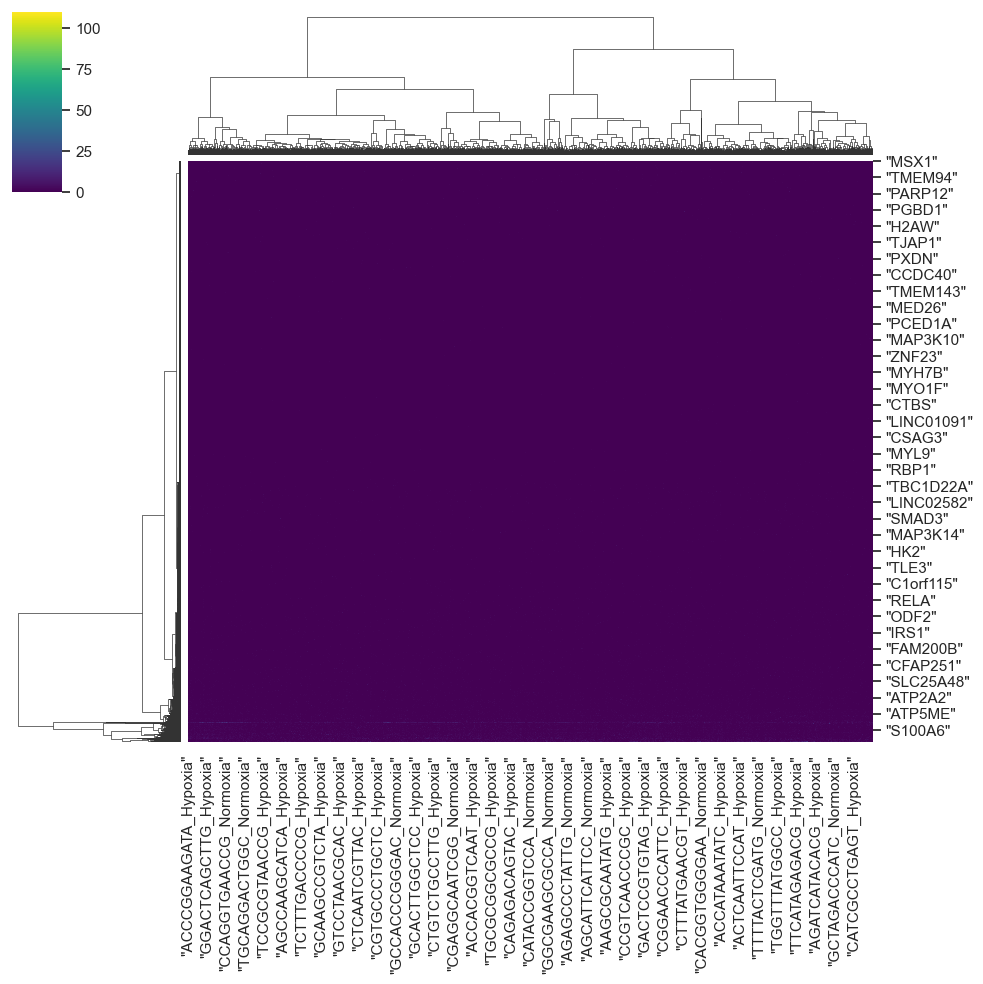

In [169]:
s = sns.clustermap(df_HCC_DropS.T, method='ward', cmap='viridis')
plt.show()

/Users/emmamora/anaconda3/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/Users/emmamora/anaconda3/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


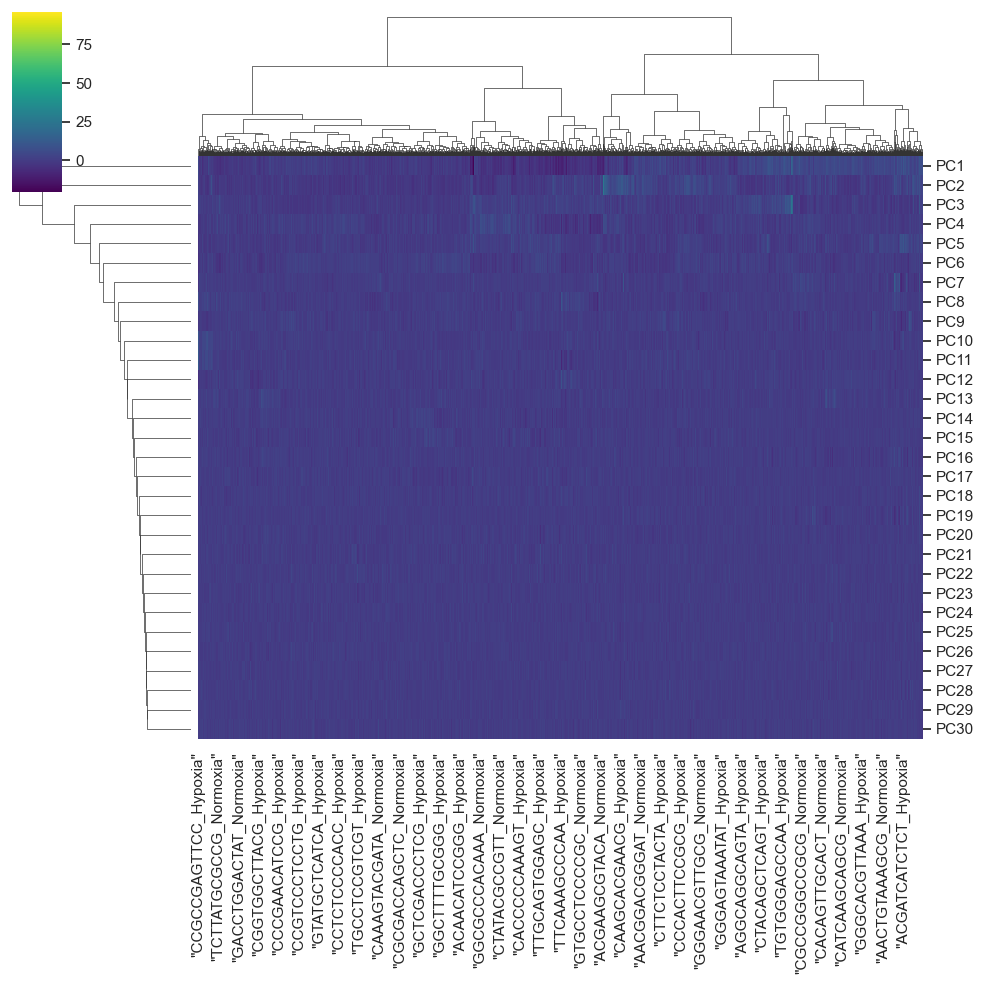

In [170]:
s = sns.clustermap(pca_data_HCC_DropS.T, method='ward', cmap='viridis')
plt.show()

/Users/emmamora/anaconda3/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/Users/emmamora/anaconda3/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


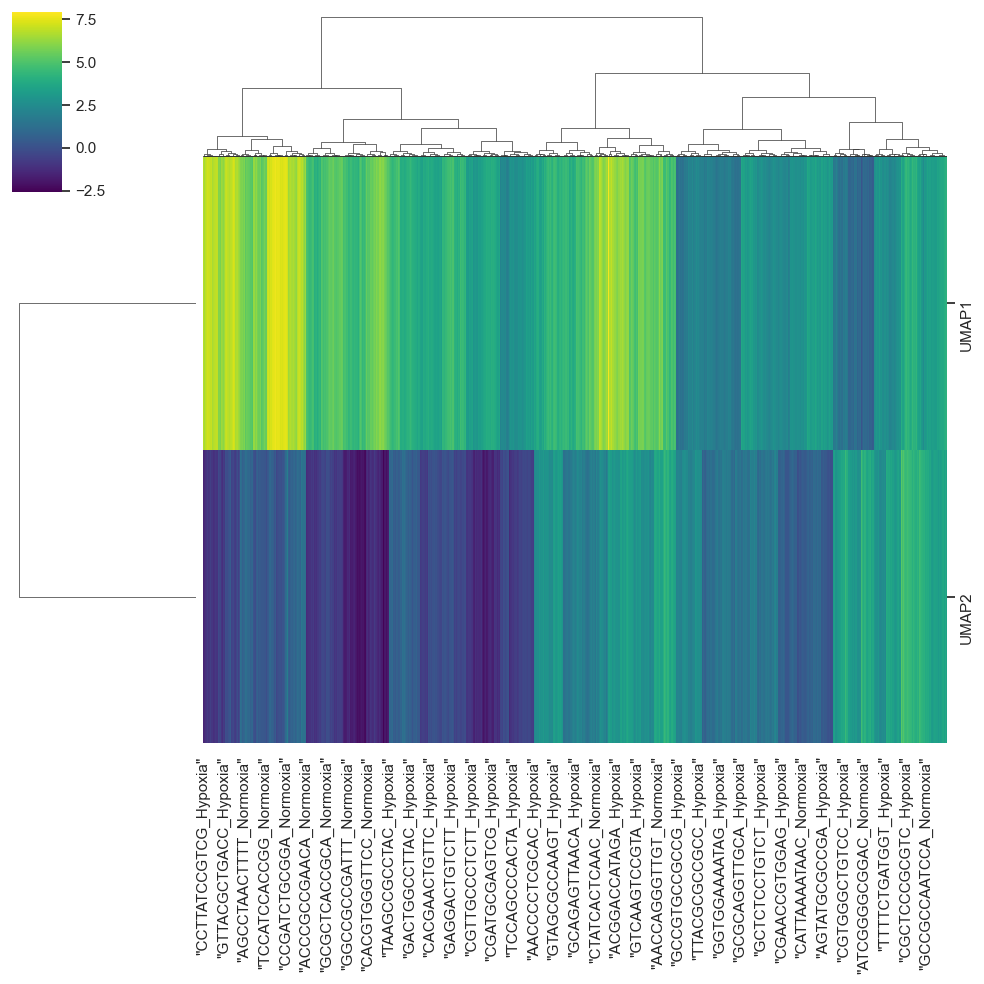

In [171]:
s = sns.clustermap(umap_data_HCC_DropS.T, method='ward', cmap='viridis')
plt.show()

### Kmeans

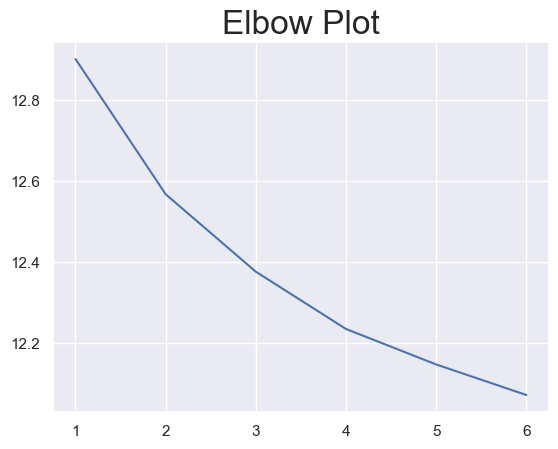

In [172]:
from scipy.cluster.vq import kmeans,vq

distortions = []
df_kmeans_HCC_DropS = df_HCC_DropS.astype(float)


for i in np.arange(1,7):
    cluster_center, distortion = kmeans(df_kmeans_HCC_DropS,i)
    distortions.append(distortion)

plt.plot(np.arange(1,7),distortions)

plt.title("Elbow Plot", fontsize=24)
plt.show()


In [173]:
#doing it with main data
cluster_center, distortion = kmeans(df_kmeans_HCC_DropS,2)

cluster_labels, _ = vq(df_kmeans_HCC_DropS, cluster_center)


condition_no_HCC_DropS = [1 if 'normoxia' in idx.lower() else 0 for idx in df_kmeans_HCC_DropS.index]
condition_no_HCC_DropS=np.array(condition_no_HCC_DropS)


def scoring_kmeans(cluster_labels):
    return max(sum(abs(cluster_labels-condition_no_HCC_DropS))/len(cluster_labels),1-sum(abs(cluster_labels-condition_no_HCC_DropS))/len(cluster_labels))

print(f"The accuracy of the clustering is: {scoring_kmeans(cluster_labels) * 100:.2f}%")

The accuracy of the clustering is: 58.71%


### Kmeans PCA

In [174]:
#doing it with pca
from scipy.cluster.vq import kmeans,vq


cluster_center_2, distortion = kmeans(pca_data_HCC_DropS,2)

cluster_labels_2, _ = vq(pca_data_HCC_DropS, cluster_center_2)


cluster_center_3, distortion = kmeans(pca_data_HCC_DropS,4)

cluster_labels_3, _ = vq(pca_data_HCC_DropS, cluster_center_3)

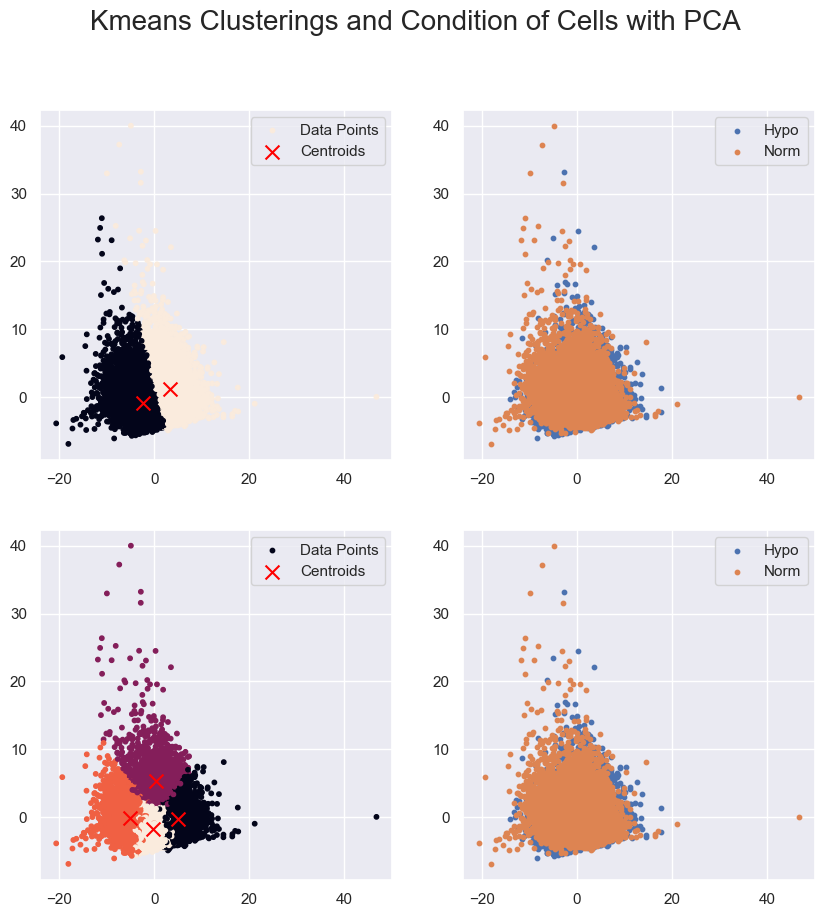

The accuracy of the clustering is: 58.94%


In [175]:
#plotting with pca

fig, ax = plt.subplots(2,2,figsize=(10,10))

ax[0,0].scatter(pca_data_HCC_DropS.iloc[:,0], pca_data_HCC_DropS.iloc[:,1], c=cluster_labels_2,s=10,marker='o', label='Data Points')
ax[0,0].scatter(cluster_center_2[:, 0], cluster_center_2[:, 1], c='red', s=100, marker='x', label='Centroids')
ax[0,0].legend()


pca_data_norm_HCC_DropS = pca_data_HCC_DropS[np.where(condition_no_HCC_DropS == 1,True,False)]
pca_data_hypo_HCC_DropS = pca_data_HCC_DropS[np.where(condition_no_HCC_DropS ==0,True,False)]

ax[0,1].scatter(pca_data_hypo_HCC_DropS.iloc[:,0], pca_data_hypo_HCC_DropS.iloc[:,1], s=10,label="Hypo")
ax[0,1].scatter(pca_data_norm_HCC_DropS.iloc[:,0], pca_data_norm_HCC_DropS.iloc[:,1], s=10,label="Norm")
ax[0,1].legend()


ax[1,0].scatter(pca_data_HCC_DropS.iloc[:,0], pca_data_HCC_DropS.iloc[:,1], c=cluster_labels_3,s=10, marker='o', label='Data Points')
ax[1,0].scatter(cluster_center_3[:, 0], cluster_center_3[:, 1], c='red', s=100, marker='x', label='Centroids')
ax[1,0].legend()

ax[1,1].scatter(pca_data_hypo_HCC_DropS.iloc[:,0], pca_data_hypo_HCC_DropS.iloc[:,1],s=10, label="Hypo")
ax[1,1].scatter(pca_data_norm_HCC_DropS.iloc[:,0], pca_data_norm_HCC_DropS.iloc[:,1],s=10, label="Norm")
ax[1,1].legend()

fig.suptitle("Kmeans Clusterings and Condition of Cells with PCA", fontsize=20)


plt.show()

print(f"The accuracy of the clustering is: {scoring_kmeans(cluster_labels_2) * 100:.2f}%")

### Kmeans UMAP

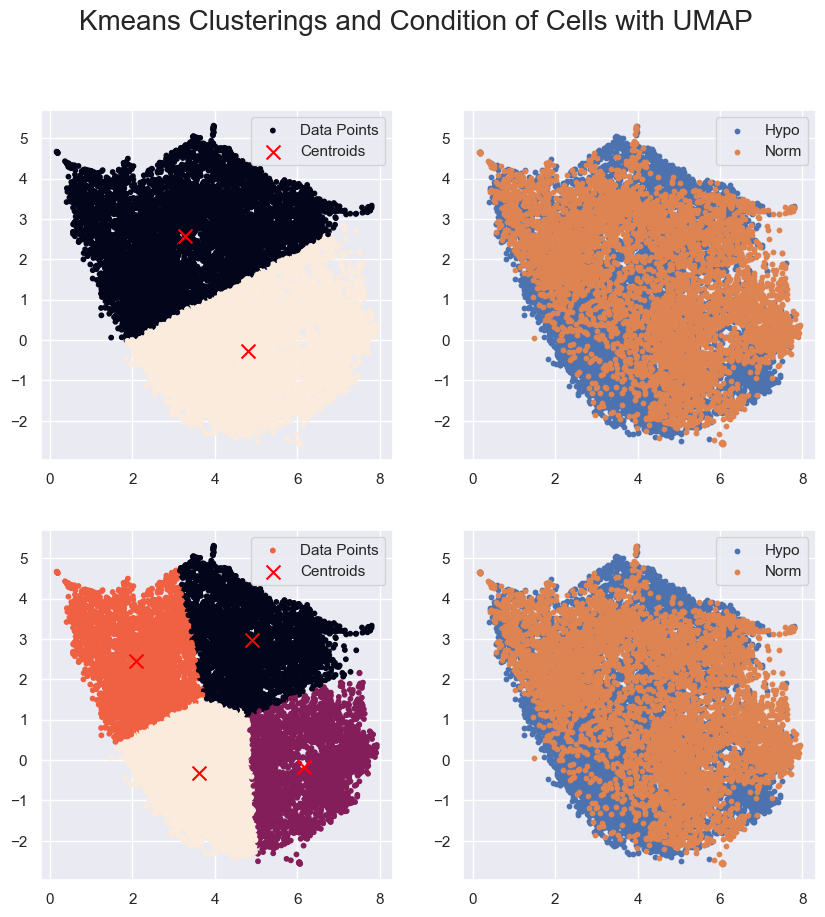

The accuracy of the clustering is: 51.33%


In [176]:
from scipy.cluster.vq import kmeans,vq


cluster_center_2, distortion = kmeans(umap_data_HCC_DropS,2)

cluster_labels_2, _ = vq(umap_data_HCC_DropS, cluster_center_2)


cluster_center_3, distortion = kmeans(umap_data_HCC_DropS,4)

cluster_labels_3, _ = vq(umap_data_HCC_DropS, cluster_center_3)


fig, ax = plt.subplots(2,2,figsize=(10,10))

ax[0,0].scatter(umap_data_HCC_DropS.iloc[:,0], umap_data_HCC_DropS.iloc[:,1],s=10, c=cluster_labels_2, marker='o', label='Data Points')
ax[0,0].scatter(cluster_center_2[:, 0], cluster_center_2[:, 1], c='red', s=100, marker='x', label='Centroids')
ax[0,0].legend()

umap_data_norm_HCC_DropS = umap_data_HCC_DropS[np.where(condition_no_HCC_DropS == 1,True,False)]
umap_data_hypo_HCC_DropS = umap_data_HCC_DropS[np.where(condition_no_HCC_DropS ==0,True,False)]

ax[0,1].scatter(umap_data_hypo_HCC_DropS.iloc[:,0], umap_data_hypo_HCC_DropS.iloc[:,1], s=10,label="Hypo")
ax[0,1].scatter(umap_data_norm_HCC_DropS.iloc[:,0], umap_data_norm_HCC_DropS.iloc[:,1], s=10,label="Norm")
ax[0,1].legend()


ax[1,0].scatter(umap_data_HCC_DropS.iloc[:,0], umap_data_HCC_DropS.iloc[:,1],s=10, c=cluster_labels_3, marker='o', label='Data Points')
ax[1,0].scatter(cluster_center_3[:, 0], cluster_center_3[:, 1], c='red', s=100, marker='x', label='Centroids')
ax[1,0].legend()


ax[1,1].scatter(umap_data_hypo_HCC_DropS.iloc[:,0], umap_data_hypo_HCC_DropS.iloc[:,1], s=10,label="Hypo")
ax[1,1].scatter(umap_data_norm_HCC_DropS.iloc[:,0], umap_data_norm_HCC_DropS.iloc[:,1], s=10,label="Norm")
ax[1,1].legend()

fig.suptitle("Kmeans Clusterings and Condition of Cells with UMAP", fontsize=20)


plt.show()

print(f"The accuracy of the clustering is: {scoring_kmeans(cluster_labels_2) * 100:.2f}%")



### Gaussian

In [177]:
from sklearn.mixture import GaussianMixture

gmm = GaussianMixture(n_components=2)
gmm.fit(df_HCC_DropS)
clusters = gmm.predict(df_HCC_DropS)

print(f"The accuracy of the clustering is: {scoring_kmeans(clusters) * 100:.2f}%")

The accuracy of the clustering is: 59.77%


### Gaussian PCA

The accuracy of the clustering is: 51.33%


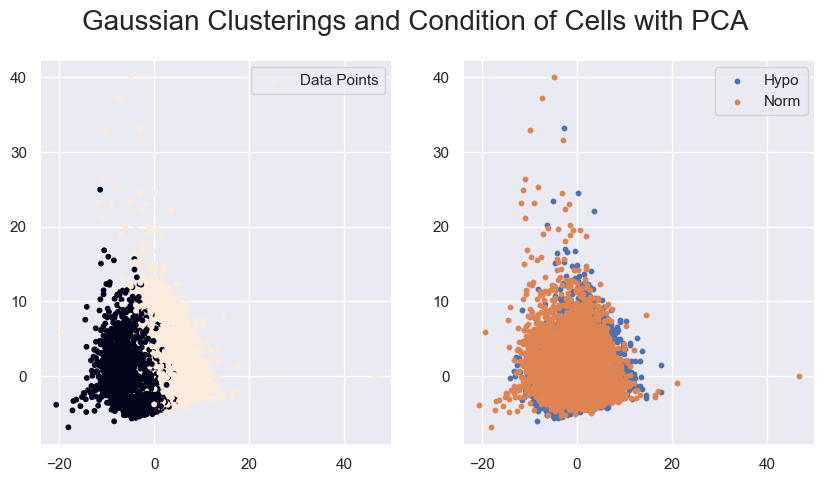

In [178]:
from sklearn.mixture import GaussianMixture

gmm = GaussianMixture(n_components=2)
gmm.fit(pca_data_HCC_DropS)
clusters = gmm.predict(pca_data_HCC_DropS)


fig, ax = plt.subplots(1,2,figsize=(10,5))

ax[0].scatter(pca_data_HCC_DropS.iloc[:,0], pca_data_HCC_DropS.iloc[:,1], c=clusters, s=10, marker='o', label='Data Points')
ax[0].legend()

pca_data_norm_HCC_Drops = pca_data_HCC_DropS[np.where(condition_no_HCC_DropS == 1,True,False)]
pca_data_hypo_HCC_Drops = pca_data_HCC_DropS[np.where(condition_no_HCC_DropS ==0,True,False)]

ax[1].scatter(pca_data_hypo_HCC_Drops.iloc[:,0], pca_data_hypo_HCC_Drops.iloc[:,1], s=10,label="Hypo")
ax[1].scatter(pca_data_norm_HCC_Drops.iloc[:,0], pca_data_norm_HCC_Drops.iloc[:,1], s=10,label="Norm")
ax[1].legend()

fig.suptitle("Gaussian Clusterings and Condition of Cells with PCA", fontsize=20)

print(f"The accuracy of the clustering is: {scoring_kmeans(cluster_labels_2) * 100:.2f}%")

### Gaussian UMAP

The accuracy of the clustering is: 51.33%


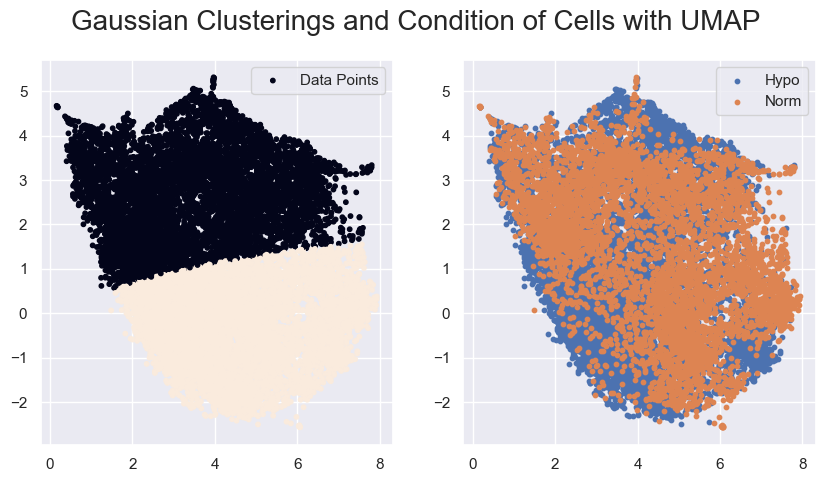

In [179]:
from sklearn.mixture import GaussianMixture

gmm = GaussianMixture(n_components=2)
gmm.fit(umap_data_HCC_DropS)
clusters = gmm.predict(umap_data_HCC_DropS)


fig, ax = plt.subplots(1,2,figsize=(10,5))

ax[0].scatter(umap_data_HCC_DropS.iloc[:,0], umap_data_HCC_DropS.iloc[:,1], c=clusters, marker='o',s=10, label='Data Points')
ax[0].legend()

umap_data_norm_HCC_DropS = umap_data_HCC_DropS[np.where(condition_no_HCC_DropS == 1,True,False)]
umap_data_hypo_HCC_DropS = umap_data_HCC_DropS[np.where(condition_no_HCC_DropS ==0,True,False)]

ax[1].scatter(umap_data_hypo_HCC_DropS.iloc[:,0], umap_data_hypo_HCC_DropS.iloc[:,1], s=10,label="Hypo")
ax[1].scatter(umap_data_norm_HCC_DropS.iloc[:,0], umap_data_norm_HCC_DropS.iloc[:,1], s=10,label="Norm")
ax[1].legend()

fig.suptitle("Gaussian Clusterings and Condition of Cells with UMAP", fontsize=20)


print(f"The accuracy of the clustering is: {scoring_kmeans(cluster_labels_2) * 100:.2f}%")
plt.show()


### Feature Selection

In [180]:
df_HCC_DropS_select = df_HCC_DropS

if "Hypoxia" not in df_HCC_DropS_select.columns:
    df_HCC_DropS_select.loc[:, "Hypoxia"] = [1 if "Hypoxia" in idx else 0 for idx in df_HCC_DropS_select.index]
    cols = ['Hypoxia'] + [col for col in df_HCC_DropS_select.columns if col != 'Hypoxia']
    df_HCC_DropS_select = df_HCC_DropS_select[cols]

In [181]:
# calculate correlation matrix
correlations_hcc_DropS = df_HCC_DropS_select.corr()

# get correlations with the 'Hypoxia' column
correlations_hcc_DropS = correlations_hcc_DropS['Hypoxia'].sort_values(ascending=False)

# filter out the target variable itself 
correlations_hcc_DropS = correlations_hcc_DropS.drop(labels=['Hypoxia'])
print(correlations_hcc_DropS)
significant_genes_hcc_DropS = correlations_hcc_DropS[abs(correlations_hcc_DropS) > 0.2]
print(significant_genes_hcc_DropS)

df_HCC_DropS_select = df_HCC_DropS_select.loc[:,list(significant_genes_hcc_DropS.index)]

df_HCC_DropS_select_sample = df_HCC_DropS_select.sample(frac=0.3)

"NDRG1"       0.295208
"FGF23"       0.294537
"LDHA"        0.263947
"GPM6A"       0.259232
"IGFBP3"      0.256976
                ...   
"HSPD1"      -0.271943
"BCYRN1"     -0.286631
"HSP90AA1"   -0.287526
"AKR1C1"     -0.288468
"AKR1C2"     -0.316988
Name: Hypoxia, Length: 3000, dtype: float64
"NDRG1"       0.295208
"FGF23"       0.294537
"LDHA"        0.263947
"GPM6A"       0.259232
"IGFBP3"      0.256976
"TMSB10"      0.231498
"P4HA1"       0.209708
"RPL41"       0.209241
"NPM1P40"     0.203324
"EIF3J"      -0.224491
"NCL"        -0.229151
"HSP90AB1"   -0.241342
"WDR43"      -0.267613
"HSPD1"      -0.271943
"BCYRN1"     -0.286631
"HSP90AA1"   -0.287526
"AKR1C1"     -0.288468
"AKR1C2"     -0.316988
Name: Hypoxia, dtype: float64


### UMAP

/Users/emmamora/anaconda3/lib/python3.11/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/var/folders/sc/040g6l752pg38ngvcz_ths0c0000gn/T/ipykernel_12426/3383297297.py:10: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(embedding_reduced_HCC[:, 0], embedding_reduced_HCC[:, 1], cmap='Spectral', s=5, color=condition_color_HCC_DropS)


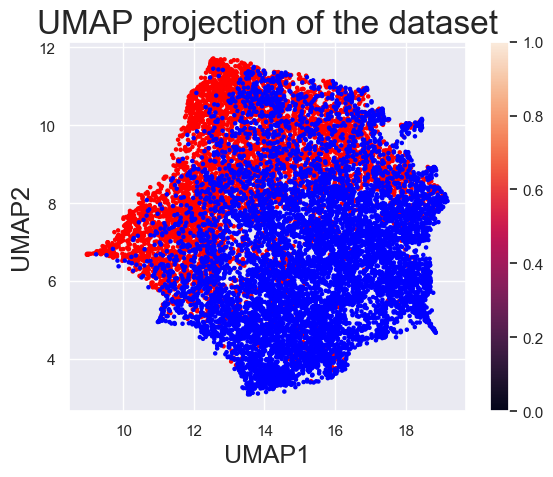

In [182]:
import umap

n_components=2

reducer = umap.UMAP(n_neighbors=15, min_dist=0.1, n_components=n_components, random_state=42)

embedding_reduced_HCC = reducer.fit_transform(df_HCC_DropS_select)


plt.scatter(embedding_reduced_HCC[:, 0], embedding_reduced_HCC[:, 1], cmap='Spectral', s=5, color=condition_color_HCC_DropS)
plt.title('UMAP projection of the dataset', fontsize=24)
plt.xlabel('UMAP1', fontsize=18)
plt.ylabel('UMAP2', fontsize=18)
plt.colorbar()



plt.show()

umap_data_reduced_HCC = pd.DataFrame(embedding_reduced_HCC, index = df_HCC_DropS_select.index, columns=[f'UMAP{i+1}' for i in range(n_components)])

### PCA

In [183]:
from sklearn.decomposition import PCA

n_components=10

pca = PCA(n_components=n_components)

pca_result= pca.fit_transform(df_HCC_DropS_select)


#look for pca components

pca_data_reduced_HCC = pd.DataFrame(pca_result, index = df_HCC_DropS.index, columns=[f'PC{i+1}' for i in range(n_components)])

### Hierarchical

/Users/emmamora/anaconda3/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/Users/emmamora/anaconda3/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


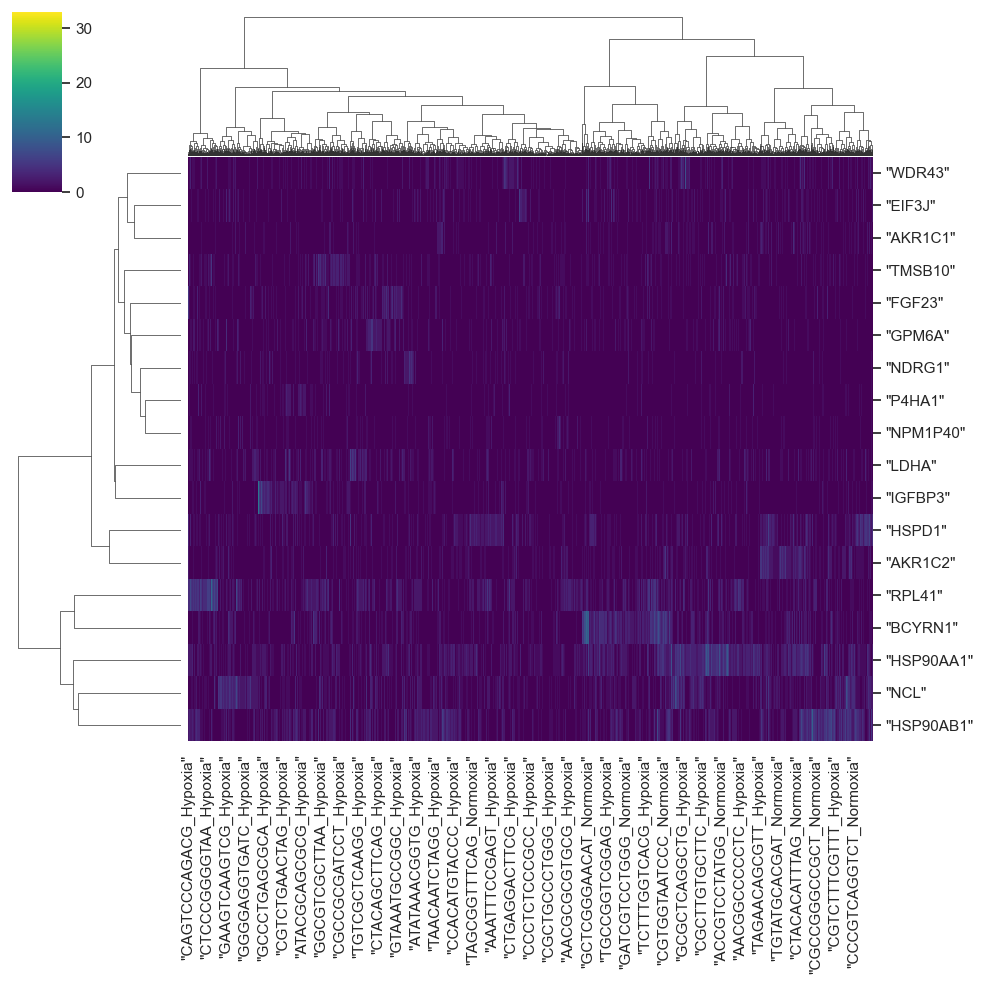

In [184]:
s = sns.clustermap(df_HCC_DropS_select.T, method='ward', cmap='viridis')
plt.show()

/Users/emmamora/anaconda3/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/Users/emmamora/anaconda3/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


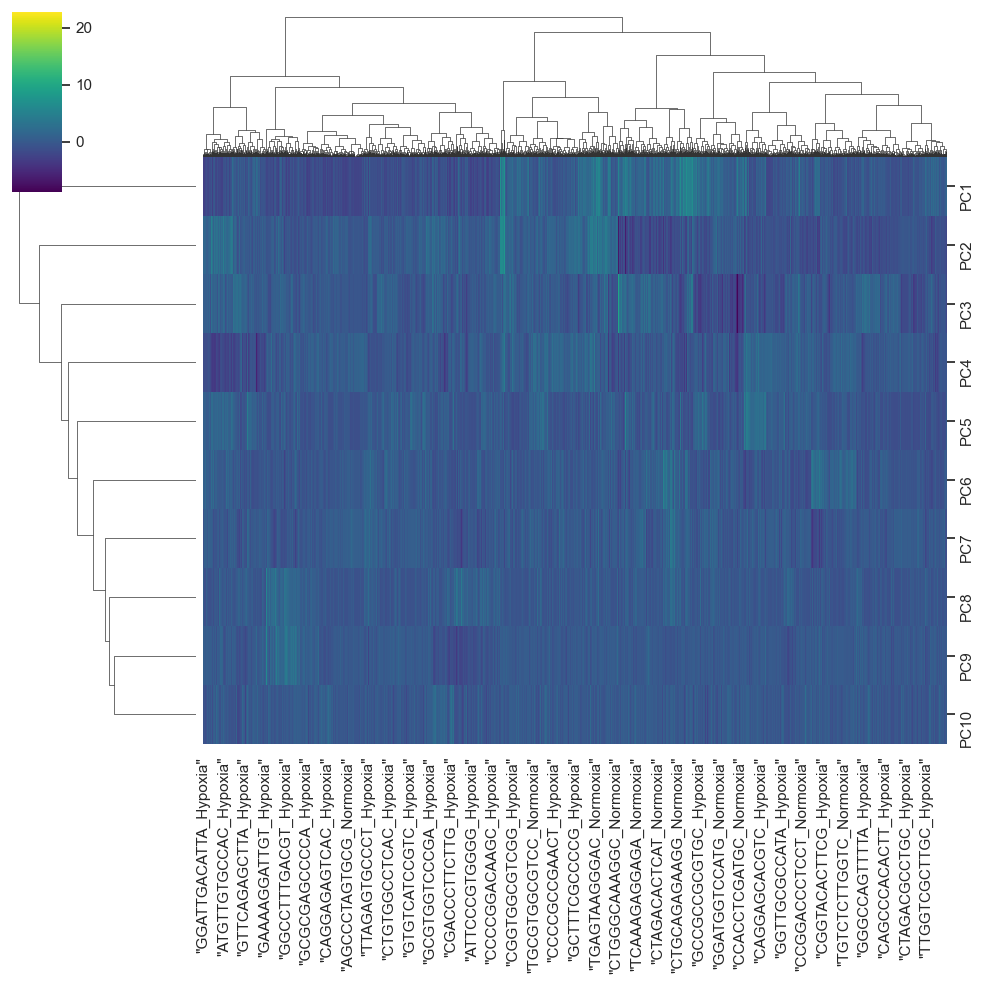

In [185]:
s = sns.clustermap(pca_data_reduced_HCC.T, method='ward', cmap='viridis')
plt.show()

/Users/emmamora/anaconda3/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/Users/emmamora/anaconda3/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


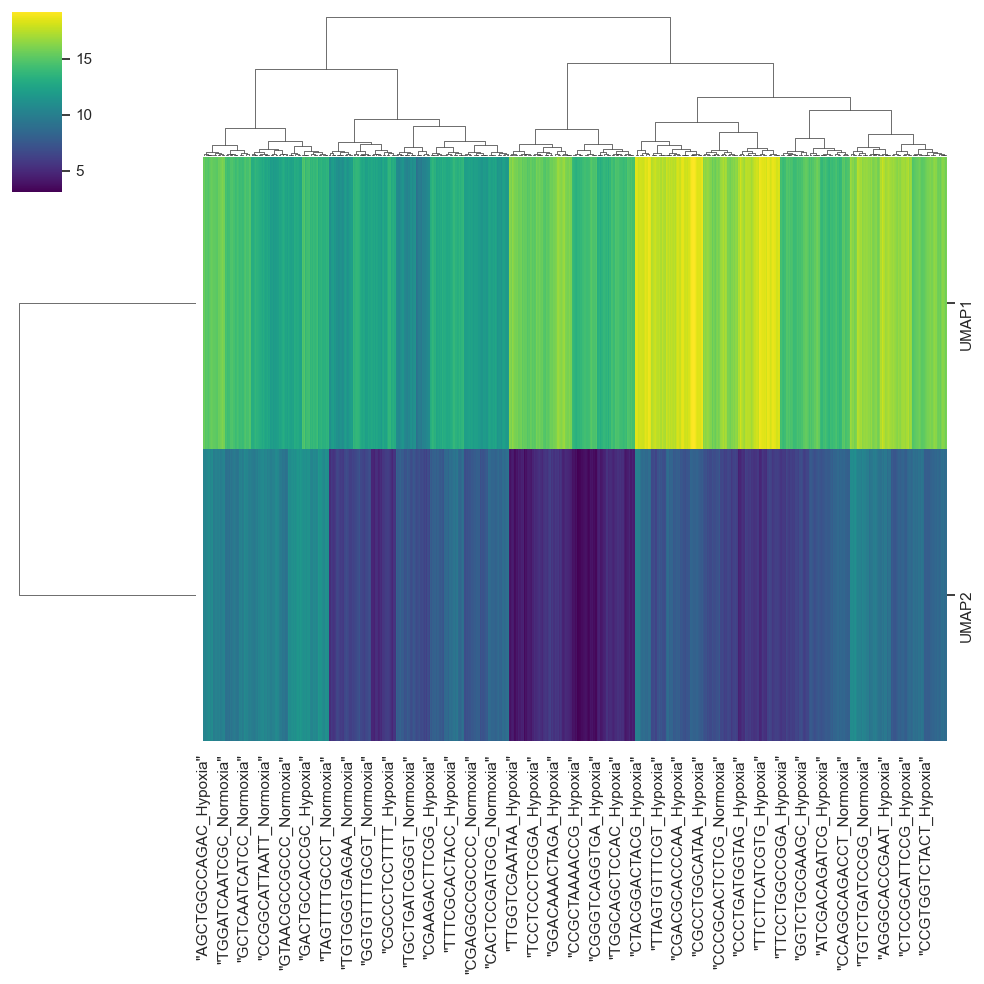

In [186]:
s = sns.clustermap(umap_data_reduced_HCC.T, method='ward', cmap='viridis')
plt.show()

### Kmeans

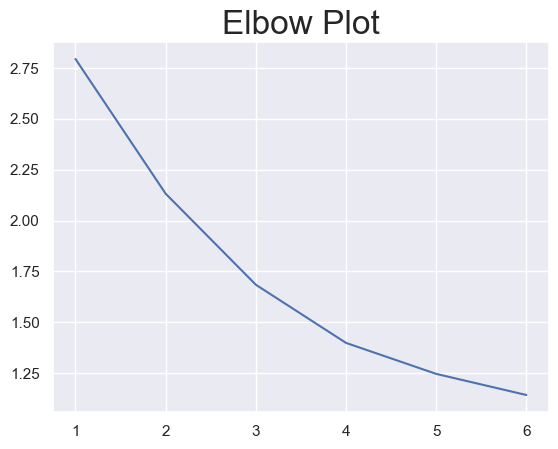

In [187]:
from scipy.cluster.vq import kmeans,vq

distortions = []

for i in np.arange(1,7):
    cluster_center, distortion = kmeans(umap_data_reduced_HCC,i)
    distortions.append(distortion)

plt.plot(np.arange(1,7),distortions)
plt.title("Elbow Plot", fontsize=24)
plt.show()

In [188]:
df_HCC_DropS_select = df_HCC_DropS_select.astype(float)

cluster_center, distortion = kmeans(df_HCC_DropS_select,2)

cluster_labels, _ = vq(df_HCC_DropS_select, cluster_center)

print(f"The accuracy of the clustering is: {scoring_kmeans(cluster_labels) * 100:.2f}%")

The accuracy of the clustering is: 76.87%


### Kmeans PCA

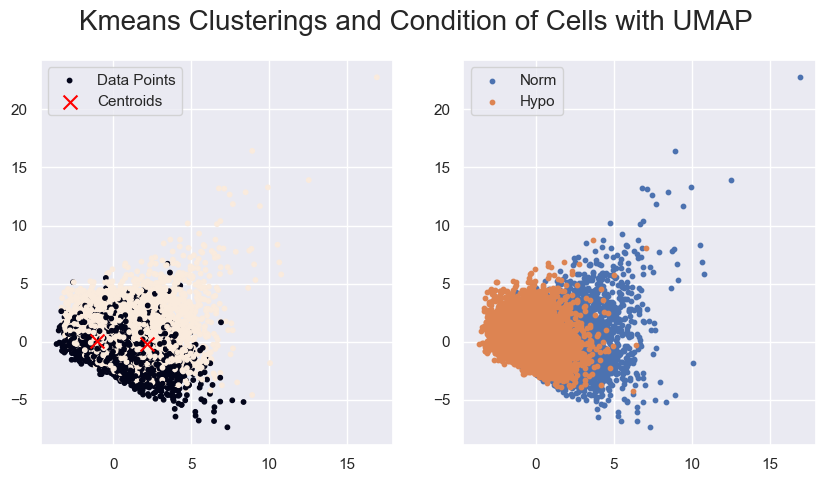

The accuracy of the clustering is: 76.79%


In [189]:
cluster_center, distortion = kmeans(pca_data_reduced_HCC,2)

cluster_labels, _ = vq(pca_data_reduced_HCC, cluster_center)

fig,ax =plt.subplots(1,2,figsize=(10,5))
ax[0].scatter(pca_data_reduced_HCC.iloc[:,0], pca_data_reduced_HCC.iloc[:,1], s=10,c=cluster_labels_2, marker='o', label='Data Points')
ax[0].scatter(cluster_center[:, 0], cluster_center[:, 1], c='red', s=100, marker='x', label='Centroids')
ax[0].legend()

pca_data_norm_reduced_HCC = pca_data_reduced_HCC[np.where(condition_no_HCC_DropS == 1,True,False)]
pca_data_hypo_reduced_HCC = pca_data_reduced_HCC[np.where(condition_no_HCC_DropS == 0,True,False)]


ax[1].scatter(pca_data_norm_reduced_HCC.iloc[:,0], pca_data_norm_reduced_HCC.iloc[:,1], s=10,label="Norm")
ax[1].scatter(pca_data_hypo_reduced_HCC.iloc[:,0], pca_data_hypo_reduced_HCC.iloc[:,1], s=10, label="Hypo")
ax[1].legend()

fig.suptitle("Kmeans Clusterings and Condition of Cells with UMAP", fontsize=20)


plt.show()
print(f"The accuracy of the clustering is: {scoring_kmeans(cluster_labels) * 100:.2f}%")

### Kmeans UMAP

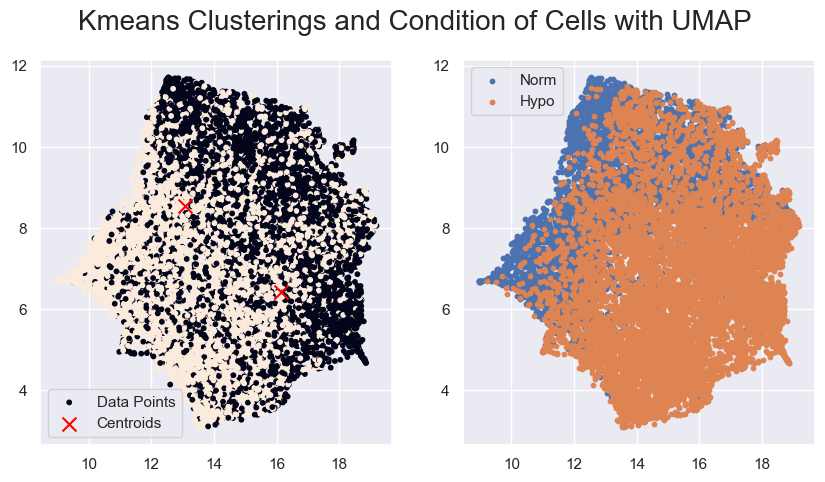

The accuracy of the clustering is: 76.39%


In [190]:
cluster_center, distortion = kmeans(umap_data_reduced_HCC,2)

cluster_labels, _ = vq(umap_data_reduced_HCC, cluster_center)

fig,ax =plt.subplots(1,2,figsize=(10,5))
ax[0].scatter(umap_data_reduced_HCC.iloc[:,0], umap_data_reduced_HCC.iloc[:,1], s=10,c=cluster_labels_2, marker='o', label='Data Points')
ax[0].scatter(cluster_center[:, 0], cluster_center[:, 1], c='red', s=100, marker='x', label='Centroids')
ax[0].legend()

umap_data_norm_reduced_HCC = umap_data_reduced_HCC[np.where(condition_no_HCC_DropS == 1,True,False)]
umap_data_hypo_reduced_HCC = umap_data_reduced_HCC[np.where(condition_no_HCC_DropS == 0,True,False)]

ax[1].scatter(umap_data_norm_reduced_HCC.iloc[:,0], umap_data_norm_reduced_HCC.iloc[:,1], s=10,label="Norm")
ax[1].scatter(umap_data_hypo_reduced_HCC.iloc[:,0], umap_data_hypo_reduced_HCC.iloc[:,1], s=10, label="Hypo")
ax[1].legend()

fig.suptitle("Kmeans Clusterings and Condition of Cells with UMAP", fontsize=20)


plt.show()
print(f"The accuracy of the clustering is: {scoring_kmeans(cluster_labels) * 100:.2f}%")

### Gaussian

In [191]:
from sklearn.mixture import GaussianMixture

gmm = GaussianMixture(n_components=2)
gmm.fit(pca_data_reduced_HCC)
clusters = gmm.predict(pca_data_reduced_HCC)

print(f"The accuracy of the clustering is: {scoring_kmeans(clusters) * 100:.2f}%")

The accuracy of the clustering is: 73.57%


### Gaussian PCA

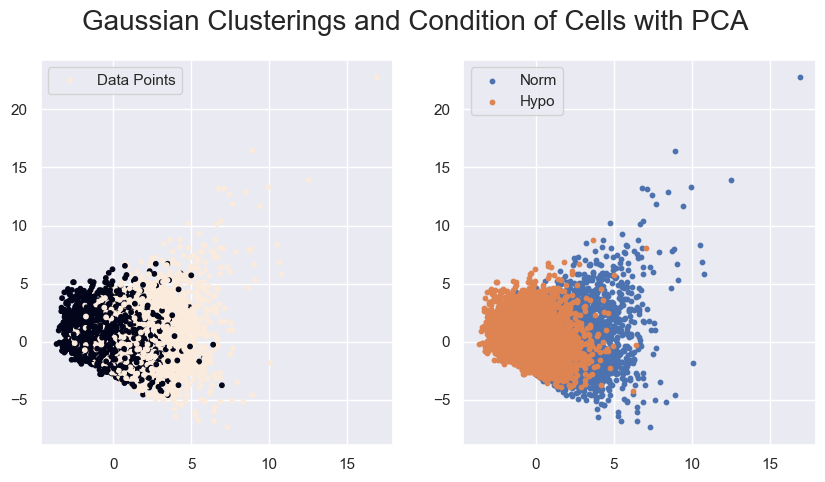

The accuracy of the clustering is: 73.57%


In [192]:
from sklearn.mixture import GaussianMixture

gmm = GaussianMixture(n_components=2)
gmm.fit(pca_data_reduced_HCC)
clusters = gmm.predict(pca_data_reduced_HCC)


fig, ax = plt.subplots(1,2,figsize=(10,5))

ax[0].scatter(pca_data_reduced_HCC.iloc[:,0], pca_data_reduced_HCC.iloc[:,1], s=10,c=clusters, marker='o', label='Data Points')
ax[0].legend()



ax[1].scatter(pca_data_norm_reduced_HCC.iloc[:,0], pca_data_norm_reduced_HCC.iloc[:,1], s=10,label="Norm")
ax[1].scatter(pca_data_hypo_reduced_HCC.iloc[:,0], pca_data_hypo_reduced_HCC.iloc[:,1], s=10, label="Hypo")
ax[1].legend()


fig.suptitle("Gaussian Clusterings and Condition of Cells with PCA", fontsize=20)

plt.show()

print(f"The accuracy of the clustering is: {scoring_kmeans(clusters) * 100:.2f}%")

### Gaussian UMAP

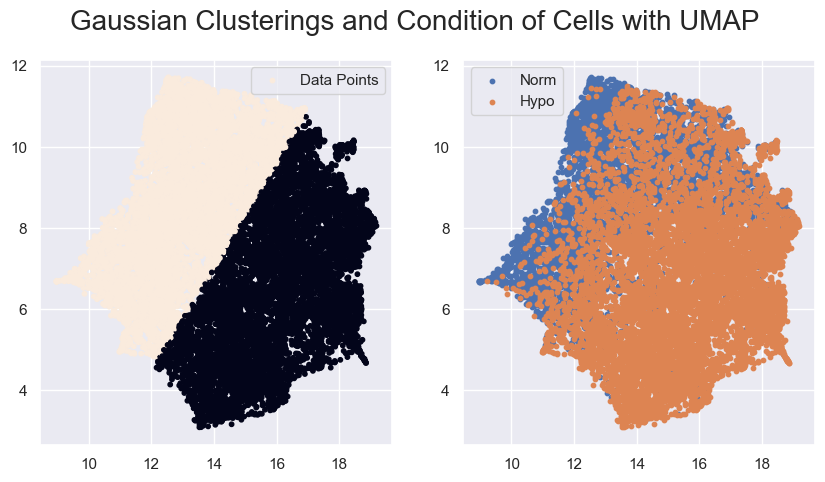

The accuracy of the clustering is: 77.70%


In [193]:
from sklearn.mixture import GaussianMixture

gmm = GaussianMixture(n_components=2)
gmm.fit(umap_data_reduced_HCC)
clusters = gmm.predict(umap_data_reduced_HCC)



fig, ax = plt.subplots(1,2,figsize=(10,5))

ax[0].scatter(umap_data_reduced_HCC.iloc[:,0], umap_data_reduced_HCC.iloc[:,1], s=10,c=clusters, marker='o', label='Data Points')
ax[0].legend()



ax[1].scatter(umap_data_norm_reduced_HCC.iloc[:,0], umap_data_norm_reduced_HCC.iloc[:,1], s=10,label="Norm")
ax[1].scatter(umap_data_hypo_reduced_HCC.iloc[:,0], umap_data_hypo_reduced_HCC.iloc[:,1], s=10, label="Hypo")
ax[1].legend()


fig.suptitle("Gaussian Clusterings and Condition of Cells with UMAP", fontsize=20)

plt.show()

print(f"The accuracy of the clustering is: {scoring_kmeans(clusters) * 100:.2f}%")

# 6. SUPERVISED LEARNING
In this part, we aim construct classifiers for each combination of cell line-classifier, that predict whether a given cell will develop hypoxia based on its gene expression.

### Approach for SmartSeq datasets

For each SmartSeq dataset, we constructed five model types: Logistic Regression, Decision Tree, XGBoost, LinearSVM, and RandomForest. Each model was trained on four subsets of features:
- **FULL**: All 3,000 features.
- **SIG**: Features significant by correlation coefficient to Hypoxia.
- **M_INFO**: Features with the highest mutual information to Hypoxia.
- **PCA**: Principal components.


This resulted in 20 models per SmartSeq dataset, totaling 40 models, whose performance metrics were stored in a dictionary. Generally, these models performed well, achieving over 90% accuracy on the test set. However, due to the small number of observations (250 for MCF7 SmartSeq and 182 for HCC1806 SmartSeq), some models may be overfitting, which led us to avoid Deep Learning models for these datasets.

### Approach for DropSeq datasets
For the DropS datasets, given the significantly higher number of observations, we decided to try both a DeepLearning approach and a LinearSVM classifier. 

#### Deep Learning for DropSeq Datasets
With a larger number of observations in the DropSeq datasets, we explored a Deep Learning approach alongside a LinearSVM classifier. Initially, our neural network model was not performing satisfactorily on the test set. To enhance the model's performance and prevent overfitting, we introduced several adjustments:

- **Regularization**: Added L2 regularization to the Dense layers.
- **Learning Rate**: Decreased the learning rate in the Adam optimizer to 0.0001 for more stable training.
- **Dropout**: Integrated Dropout layers to reduce the chance of overfitting further.

**Neural Network Setup**:

- **Model Layers**: Sequential configuration including:
  - Dense layers with ReLU activation, complemented by L2 regularization to penalize complex models.
  - Dropout layers following each Dense layer to randomly omit a subset of features at each iteration.
- **Optimizer**: Adam with a reduced learning rate of 0.0001.
- **Loss Function**: Binary Crossentropy.
- **Metrics**: Accuracy.
- **Validation Strategy**: Uses 20% of the training data for validation with early stopping based on validation loss to prevent overtraining.

#### LinearSVM classifier
The linear SVM classifiers also achieved good performance with 0.94 classification accuracy for the HCC DropSeq dataset and 1.00 accuracy for the MCF Dropseq dataset.


## 6.1. MCF SmartS


### 6.1.1. Feature Selection

#### Gene Count: Most Expressed Genes 

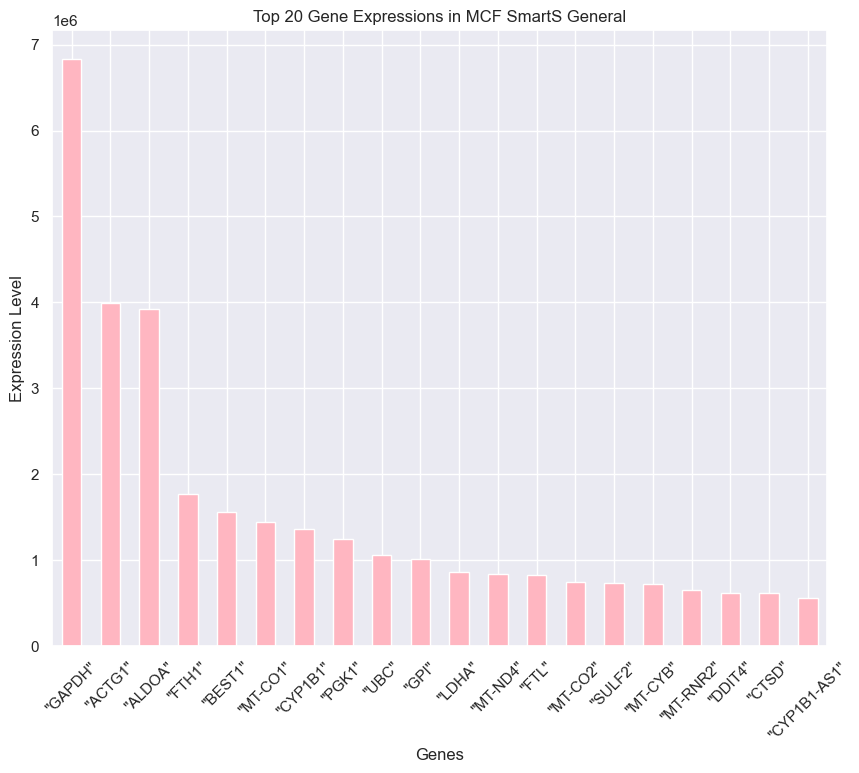

In [194]:
## see gene expression by total columns
gene_sum_MCF_SmartS_general = df_MCF_SmartS_filtered_normalised.drop(columns=['Hypoxia']).sum(axis=0)
gene_expression_MCF_SmartS_general = gene_sum_MCF_SmartS_general.sort_values(ascending=False)
gene_expression_MCF_SmartS_general
### GAPDH is by far the most expressed

## ploting the first 20 to get a sense of what's happening
top_genes_MCF_SmartS_general = gene_expression_MCF_SmartS_general.head(20)
plt.figure(figsize=(10,8))
top_genes_MCF_SmartS_general.plot(kind='bar', color='lightpink')
plt.title('Top 20 Gene Expressions in MCF SmartS General')
plt.xlabel('Genes')
plt.ylabel('Expression Level')
plt.xticks(rotation=45)
plt.show()

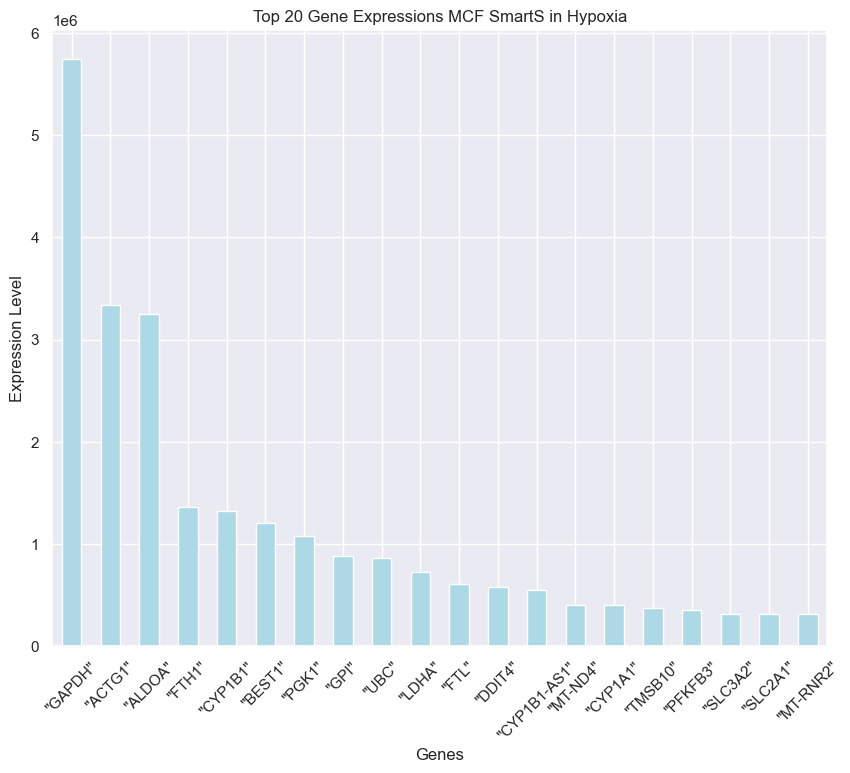

In [195]:
## gene expression by Hypoxia
df_MCF_SmartS_filtered = df_MCF_SmartS_filtered_normalised[df_MCF_SmartS_filtered_normalised['Hypoxia'] != 0]
gene_sum_MCF_SmartS_Hypo = df_MCF_SmartS_filtered.drop(columns=['Hypoxia']).sum(axis=0)
gene_expression_MCF_SmartS_Hypo = gene_sum_MCF_SmartS_Hypo.sort_values(ascending=False)
gene_expression_MCF_SmartS_Hypo

## ploting the first 20 to get a sense of what's happening
top_genes_MCF_SmartS_Hypo = gene_expression_MCF_SmartS_Hypo.head(20)
plt.figure(figsize=(10,8))
top_genes_MCF_SmartS_Hypo.plot(kind='bar', color='lightblue')
plt.title('Top 20 Gene Expressions MCF SmartS in Hypoxia')
plt.xlabel('Genes')
plt.ylabel('Expression Level')
plt.xticks(rotation=45)
plt.show()


### 6.1.2. Model Development

We start by creating the baseline models on the full normalised data (3000 genes). We try different ML Classifiers: Logistic Regression (LogReg), Decision Trees (DTree), XGBoost (XGB), Support Vector Machines (SVM) and Random Forrest (RandF). We store the evaluation results and then compare them to see which model works best for which type of data.

In [19]:
# dictionary to hold model results
results_MCF_SmartS_dict ={}

#### Logistic Regression

##### 1. Full Data

In [20]:
# separate features and target
X_MCF_SmartS_full = df_MCF_SmartS_filtered_normalised.drop('Hypoxia', axis=1)  
y_MCF_SmartS_full = df_MCF_SmartS_filtered_normalised['Hypoxia']  

# split the data - 80% for training and 20% for testing
X_MCF_SmartS_full_train, X_MCF_SmartS_full_test, y_MCF_SmartS_full_train, y_MCF_SmartS_full_test = train_test_split(X_MCF_SmartS_full, y_MCF_SmartS_full, test_size=0.2, random_state=42)

# model training
model_LogReg_MCF_SmartS_full = LogisticRegression(max_iter=1000) 
## increased max_iter for convergence with large datasets
model_LogReg_MCF_SmartS_full.fit(X_MCF_SmartS_full_train, y_MCF_SmartS_full_train)

# model evaluation
y_MCF_SmartS_full_pred = model_LogReg_MCF_SmartS_full.predict(X_MCF_SmartS_full_test)
print('Confusion matrix LogReg on full data MCF SmartS:')
print(confusion_matrix(y_MCF_SmartS_full_test, y_MCF_SmartS_full_pred))
print('Classification report LogReg on full data MCF SmartS:')
print(classification_report(y_MCF_SmartS_full_test, y_MCF_SmartS_full_pred))

# saving results
results_MCF_SmartS_dict['LogReg_full'] = {
    'conf_matrix': confusion_matrix(y_MCF_SmartS_full_test, y_MCF_SmartS_full_pred),
    'class_report': classification_report(y_MCF_SmartS_full_test, y_MCF_SmartS_full_pred, output_dict=True)
}

Confusion matrix LogReg on full data MCF SmartS:
[[25  0]
 [ 0 25]]
Classification report LogReg on full data MCF SmartS:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        25
           1       1.00      1.00      1.00        25

    accuracy                           1.00        50
   macro avg       1.00      1.00      1.00        50
weighted avg       1.00      1.00      1.00        50



In [21]:
# setup cross-validation method with shuffling the data
kf_LogReg_MCF_SmartS_full = KFold(n_splits=5, shuffle=True, random_state=42)

# perform cross-validation
cv_scores_LogReg_MCF_SmartS_full = cross_val_score(model_LogReg_MCF_SmartS_full, X_MCF_SmartS_full, y_MCF_SmartS_full, cv=kf_LogReg_MCF_SmartS_full, scoring='accuracy')

print("CV Scores for 5 folds with shuffling: ", cv_scores_LogReg_MCF_SmartS_full)
print("Average CV Score with shuffling: {:.2f}".format(cv_scores_LogReg_MCF_SmartS_full.mean()))

CV Scores for 5 folds with shuffling:  [1. 1. 1. 1. 1.]
Average CV Score with shuffling: 1.00


#### Decision Trees

Confusion matrix DecisionTree on full data MCF SmartS:
[[25  0]
 [ 1 24]]
Classification report DecisionTree on full data MCF SmartS:
              precision    recall  f1-score   support

           0       0.96      1.00      0.98        25
           1       1.00      0.96      0.98        25

    accuracy                           0.98        50
   macro avg       0.98      0.98      0.98        50
weighted avg       0.98      0.98      0.98        50



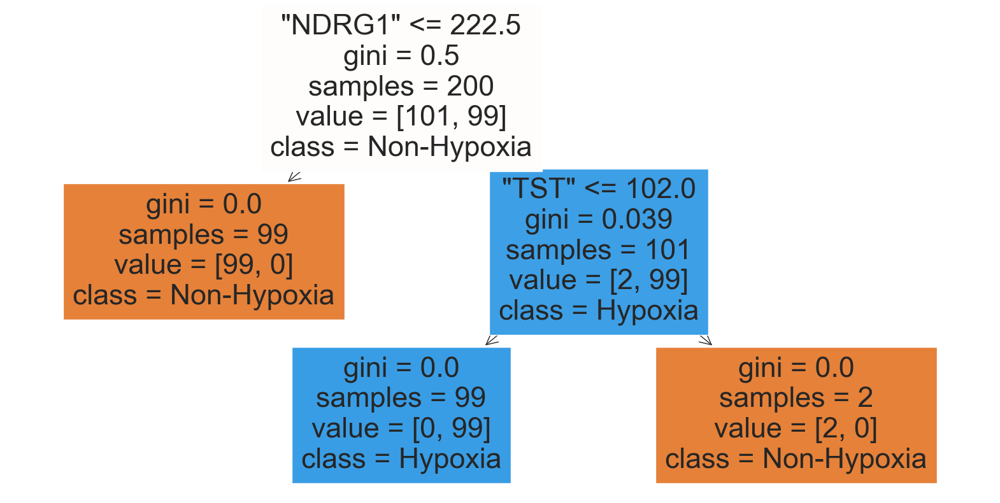

In [22]:
# separate features and target
X_MCF_SmartS_full = df_MCF_SmartS_filtered_normalised.drop('Hypoxia', axis=1)  
y_MCF_SmartS_full = df_MCF_SmartS_filtered_normalised['Hypoxia']  

# split the data - 80% for training and 20% for testing
X_MCF_SmartS_full_train, X_MCF_SmartS_full_test, y_MCF_SmartS_full_train, y_MCF_SmartS_full_test = train_test_split(X_MCF_SmartS_full, y_MCF_SmartS_full, test_size=0.2, random_state=42)

# model training
model_DTree_MCF_SmartS_full = DecisionTreeClassifier(max_depth=5, criterion='gini', random_state=42)
## increased max_iter for convergence with large datasets
model_DTree_MCF_SmartS_full.fit(X_MCF_SmartS_full_train, y_MCF_SmartS_full_train)

# model evaluation
y_MCF_SmartS_full_pred = model_DTree_MCF_SmartS_full.predict(X_MCF_SmartS_full_test)
print('Confusion matrix DecisionTree on full data MCF SmartS:')
print(confusion_matrix(y_MCF_SmartS_full_test, y_MCF_SmartS_full_pred))
print('Classification report DecisionTree on full data MCF SmartS:')
print(classification_report(y_MCF_SmartS_full_test, y_MCF_SmartS_full_pred))

#saving results
results_MCF_SmartS_dict['DTree_full'] = {
    'conf_matrix': confusion_matrix(y_MCF_SmartS_full_test, y_MCF_SmartS_full_pred),
    'class_report': classification_report(y_MCF_SmartS_full_test, y_MCF_SmartS_full_pred, output_dict=True)
}

# visualisation
plt.figure(figsize=(20,10))
plot_tree(model_DTree_MCF_SmartS_full, filled=True, feature_names=X_MCF_SmartS_full.columns, class_names=["Non-Hypoxia", "Hypoxia"])
plt.show()

In [302]:
# setup cross-validation method with shuffling the data
kf_DTree_MCF_SmartS_full = KFold(n_splits=5, shuffle=True, random_state=42)

# perform cross-validation
cv_scores_DTree_MCF_SmartS_full = cross_val_score(model_DTree_MCF_SmartS_full, X_MCF_SmartS_full, y_MCF_SmartS_full, cv=kf_DTree_MCF_SmartS_full, scoring='accuracy')

print("CV Scores for 5 folds with shuffling: ", cv_scores_DTree_MCF_SmartS_full)
print("Average CV Score with shuffling: {:.2f}".format(cv_scores_DTree_MCF_SmartS_full.mean()))

CV Scores for 5 folds with shuffling:  [0.98 0.94 1.   0.94 0.98]
Average CV Score with shuffling: 0.97


#### XGBoost

In [23]:
# separate features and target
X_MCF_SmartS_full = df_MCF_SmartS_filtered_normalised.drop('Hypoxia', axis=1)  
y_MCF_SmartS_full = df_MCF_SmartS_filtered_normalised['Hypoxia']  

# split the data - 80% for training and 20% for testing
X_MCF_SmartS_full_train, X_MCF_SmartS_full_test, y_MCF_SmartS_full_train, y_MCF_SmartS_full_test = train_test_split(X_MCF_SmartS_full, y_MCF_SmartS_full, test_size=0.2, random_state=42)

# model training
model_XGB_MCF_SmartS_full = xgb.XGBClassifier(objective='binary:logistic', eval_metric="logloss", use_label_encoder=False)
## increased max_iter for convergence with large datasets
model_XGB_MCF_SmartS_full.fit(X_MCF_SmartS_full_train, y_MCF_SmartS_full_train)

# model evaluation
y_MCF_SmartS_full_prediction = model_XGB_MCF_SmartS_full.predict(X_MCF_SmartS_full_test)
print('Confusion matrix XGB on full data MCF SmartS:')
print(confusion_matrix(y_MCF_SmartS_full_test, y_MCF_SmartS_full_prediction))
print('Classification report XGB on full data MCF SmartS:')
print(classification_report(y_MCF_SmartS_full_test, y_MCF_SmartS_full_prediction))

#saving results
results_MCF_SmartS_dict['XGB_full'] = {
    'conf_matrix': confusion_matrix(y_MCF_SmartS_full_test, y_MCF_SmartS_full_pred),
    'class_report': classification_report(y_MCF_SmartS_full_test, y_MCF_SmartS_full_pred, output_dict=True)
}


Confusion matrix XGB on full data MCF SmartS:
[[25  0]
 [ 1 24]]
Classification report XGB on full data MCF SmartS:
              precision    recall  f1-score   support

           0       0.96      1.00      0.98        25
           1       1.00      0.96      0.98        25

    accuracy                           0.98        50
   macro avg       0.98      0.98      0.98        50
weighted avg       0.98      0.98      0.98        50



In [24]:
# setup cross-validation method with shuffling the data
kf_XGB_MCF_SmartS_full = KFold(n_splits=5, shuffle=True, random_state=42)

# perform cross-validation
cv_scores_XGB_MCF_SmartS_full = cross_val_score(model_XGB_MCF_SmartS_full, X_MCF_SmartS_full, y_MCF_SmartS_full, cv=kf_XGB_MCF_SmartS_full, scoring='accuracy')

print("CV Scores for 5 folds with shuffling: ", cv_scores_XGB_MCF_SmartS_full)
print("Average CV Score with shuffling: {:.2f}".format(cv_scores_XGB_MCF_SmartS_full.mean()))

CV Scores for 5 folds with shuffling:  [0.98 0.96 1.   0.98 1.  ]
Average CV Score with shuffling: 0.98


#### Linear Support Vector Machine


In [25]:
# separate features and target
X_MCF_SmartS_full = df_MCF_SmartS_filtered_normalised.drop('Hypoxia', axis=1)  
y_MCF_SmartS_full = df_MCF_SmartS_filtered_normalised['Hypoxia']  

# split the data - 80% for training and 20% for testing
X_MCF_SmartS_full_train, X_MCF_SmartS_full_test, y_MCF_SmartS_full_train, y_MCF_SmartS_full_test = train_test_split(X_MCF_SmartS_full, y_MCF_SmartS_full, test_size=0.2, random_state=42)

# model training
model_LinSVM_MCF_SmartS_full = LinearSVC(random_state=42, max_iter=15000)
## increased max_iter for convergence with large datasets
model_LinSVM_MCF_SmartS_full.fit(X_MCF_SmartS_full_train, y_MCF_SmartS_full_train)

# model evaluation
y_MCF_SmartS_full_pred = model_LinSVM_MCF_SmartS_full.predict(X_MCF_SmartS_full_test)
print('Confusion matrix LinSVM on full data MCF SmartS:')
print(confusion_matrix(y_MCF_SmartS_full_test, y_MCF_SmartS_full_pred))
print('Classification report LinSVM on full data MCF SmartS:')
print(classification_report(y_MCF_SmartS_full_test, y_MCF_SmartS_full_pred))

# saving results
results_MCF_SmartS_dict['LinSVM_full'] = {
    'conf_matrix': confusion_matrix(y_MCF_SmartS_full_test, y_MCF_SmartS_full_pred),
    'class_report': classification_report(y_MCF_SmartS_full_test, y_MCF_SmartS_full_pred, output_dict=True)
}

Confusion matrix LinSVM on full data MCF SmartS:
[[25  0]
 [ 0 25]]
Classification report LinSVM on full data MCF SmartS:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        25
           1       1.00      1.00      1.00        25

    accuracy                           1.00        50
   macro avg       1.00      1.00      1.00        50
weighted avg       1.00      1.00      1.00        50



In [26]:
# setup cross-validation method with shuffling the data
kf_LinSVM_MCF_SmartS_full = KFold(n_splits=5, shuffle=True, random_state=42)

# perform cross-validation
cv_scores_LinSVM_MCF_SmartS_full = cross_val_score(model_LinSVM_MCF_SmartS_full, X_MCF_SmartS_full, y_MCF_SmartS_full, cv=kf_LinSVM_MCF_SmartS_full, scoring='accuracy')

print("CV Scores for 5 folds with shuffling: ", cv_scores_LinSVM_MCF_SmartS_full)
print("Average CV Score with shuffling: {:.2f}".format(cv_scores_LinSVM_MCF_SmartS_full.mean()))

CV Scores for 5 folds with shuffling:  [1. 1. 1. 1. 1.]
Average CV Score with shuffling: 1.00


#### Random Forest

In [27]:
# separate features and target
X_MCF_SmartS_full = df_MCF_SmartS_filtered_normalised.drop('Hypoxia', axis=1)  
y_MCF_SmartS_full = df_MCF_SmartS_filtered_normalised['Hypoxia']  

# split the data - 80% for training and 20% for testing
X_MCF_SmartS_full_train, X_MCF_SmartS_full_test, y_MCF_SmartS_full_train, y_MCF_SmartS_full_test = train_test_split(X_MCF_SmartS_full, y_MCF_SmartS_full, test_size=0.2, random_state=42)

# model training
model_RandF_MCF_SmartS_full = RandomForestClassifier(n_estimators=100, random_state=42)
## increased max_iter for convergence with large datasets
model_RandF_MCF_SmartS_full.fit(X_MCF_SmartS_full_train, y_MCF_SmartS_full_train)

# model evaluation
y_MCF_SmartS_full_pred = model_RandF_MCF_SmartS_full.predict(X_MCF_SmartS_full_test)
print('Confusion matrix RandForest on full data MCF SmartS:')
print(confusion_matrix(y_MCF_SmartS_full_test, y_MCF_SmartS_full_pred))
print('Classification report RandForest on full data MCF SmartS:')
print(classification_report(y_MCF_SmartS_full_test, y_MCF_SmartS_full_pred))

#saving results
results_MCF_SmartS_dict['RandF_full'] = {
    'conf_matrix': confusion_matrix(y_MCF_SmartS_full_test, y_MCF_SmartS_full_pred),
    'class_report': classification_report(y_MCF_SmartS_full_test, y_MCF_SmartS_full_pred, output_dict=True)
}

Confusion matrix RandForest on full data MCF SmartS:
[[25  0]
 [ 0 25]]
Classification report RandForest on full data MCF SmartS:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        25
           1       1.00      1.00      1.00        25

    accuracy                           1.00        50
   macro avg       1.00      1.00      1.00        50
weighted avg       1.00      1.00      1.00        50



In [28]:
# setup cross-validation method with shuffling the data
kf_RandF_MCF_SmartS_full = KFold(n_splits=5, shuffle=True, random_state=42)

# perform cross-validation
cv_scores_RandF_MCF_SmartS_full = cross_val_score(model_RandF_MCF_SmartS_full, X_MCF_SmartS_full, y_MCF_SmartS_full, cv=kf_RandF_MCF_SmartS_full, scoring='accuracy')

print("CV Scores for 5 folds with shuffling: ", cv_scores_RandF_MCF_SmartS_full)
print("Average CV Score with shuffling: {:.2f}".format(cv_scores_RandF_MCF_SmartS_full.mean()))

CV Scores for 5 folds with shuffling:  [1.   0.98 1.   1.   1.  ]
Average CV Score with shuffling: 1.00


### 6.1.3. Storing Model Evaluation Results

In [29]:
results_list_MCF_SmartS = []
for model_key, metrics in results_MCF_SmartS_dict.items():
    # leave the confusion matrix as a np.array
    conf_matrix = metrics['conf_matrix']
    # extract the overall classification metrics
    report = metrics['class_report']
    accuracy = report['accuracy']
    precision = report['weighted avg']['precision']
    recall = report['weighted avg']['recall']
    f1_score = report['weighted avg']['f1-score']
    # append a dictionary to the list, which will be used to create DataFrame
    results_list_MCF_SmartS.append({
        'Model': model_key,
        'Confusion Matrix': conf_matrix,
        'Accuracy': f"{accuracy:.2f}",
        'Precision': f"{precision:.2f}",
        'Recall': f"{recall:.2f}",
        'F1-Score': f"{f1_score:.2f}"
    })
results_df_MCF_SmartS = pd.DataFrame(results_list_MCF_SmartS)
# sort by Accuracy column
results_df_MCF_SmartS = results_df_MCF_SmartS.sort_values(by='Accuracy', ascending=False).reset_index(drop=True)
# save as a csv file
results_df_MCF_SmartS.to_csv('results_MCF_SmartS.csv', index=False)
results_df_MCF_SmartS

,Model,Confusion Matrix,Accuracy,Precision,Recall,F1-Score
0,LogReg_full,"[[25, 0], [0, 25]]",1.00,1.00,1.00,1.00
1,LinSVM_full,"[[25, 0], [0, 25]]",1.00,1.00,1.00,1.00
2,RandF_full,"[[25, 0], [0, 25]]",1.00,1.00,1.00,1.00
3,DTree_full,"[[25, 0], [1, 24]]",0.98,0.98,0.98,0.98
4,XGB_full,"[[25, 0], [1, 24]]",0.98,0.98,0.98,0.98


## 6.2. HCC SmartS

### 6.2.1. Feature Selection

#### Gene count : Most Expressed genes

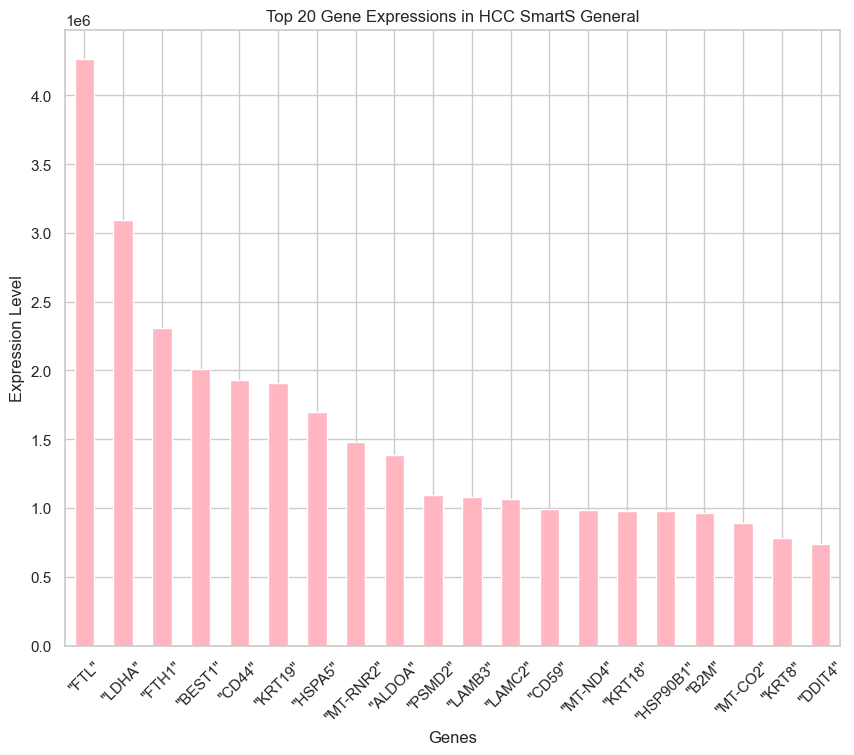

In [335]:
## see gene expression by total columns
gene_sum_HCC_SmartS_general = df_HCC_SmartS_filtered_normalised.drop(columns=['Hypoxia']).sum(axis=0)
gene_expression_HCC_SmartS_general = gene_sum_HCC_SmartS_general.sort_values(ascending=False)
gene_expression_HCC_SmartS_general
### FTL is most expressed here

## ploting the first 20 to get a sense of what's happening
top_genes_HCC_SmartS_general = gene_expression_HCC_SmartS_general.head(20)
plt.figure(figsize=(10,8))
top_genes_HCC_SmartS_general.plot(kind='bar', color='lightpink')
plt.title('Top 20 Gene Expressions in HCC SmartS General')
plt.xlabel('Genes')
plt.ylabel('Expression Level')
plt.xticks(rotation=45)
plt.show()

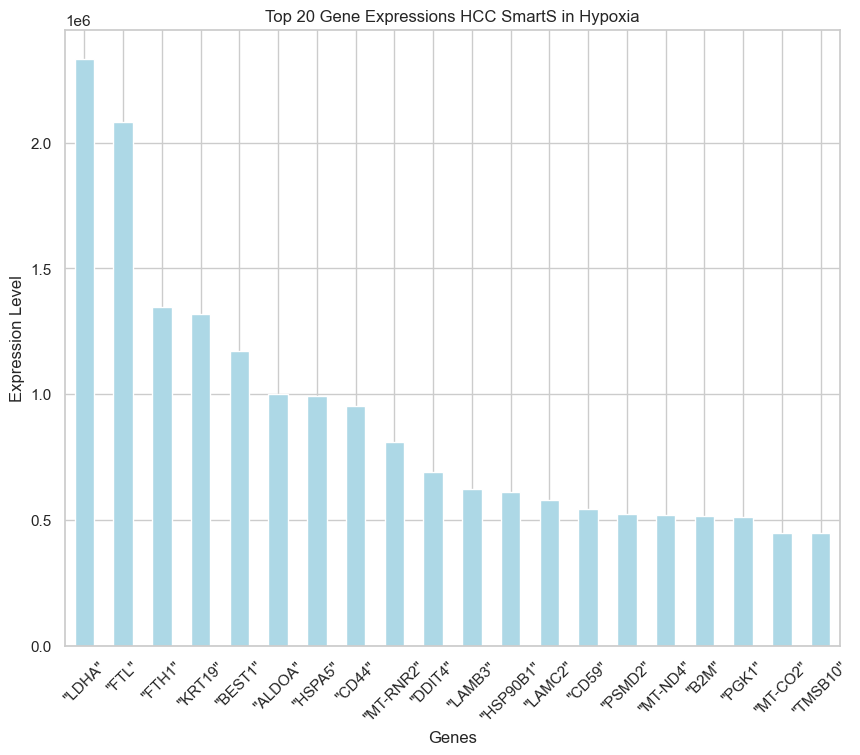

In [336]:
## gene expression by Hypoxia
df_HCC_SmartS_filtered = df_HCC_SmartS_filtered_normalised[df_HCC_SmartS_filtered_normalised['Hypoxia'] != 0]
gene_sum_HCC_SmartS_Hypo = df_HCC_SmartS_filtered.drop(columns=['Hypoxia']).sum(axis=0)
gene_expression_HCC_SmartS_Hypo = gene_sum_HCC_SmartS_Hypo.sort_values(ascending=False)
gene_expression_HCC_SmartS_Hypo


## ploting the first 20 to get a sense of what's happening
top_genes_HCC_SmartS_Hypo = gene_expression_HCC_SmartS_Hypo.head(20)
plt.figure(figsize=(10,8))
top_genes_HCC_SmartS_Hypo.plot(kind='bar', color='lightblue')
plt.title('Top 20 Gene Expressions HCC SmartS in Hypoxia')
plt.xlabel('Genes')
plt.ylabel('Expression Level')
plt.xticks(rotation=45)
plt.show()


We observe that LDHA is the most expressed gene in cells with Hypoxia whereas it is only second best by a quite big margin in the full dataset. 

### 6.2.2 Model Development

In [30]:
# dictionary to hold model results
results_HCC_SmartS_dict ={}

#### Logistic Regression

In [31]:
# separate features and target
X_HCC_SmartS_full = df_HCC_SmartS_filtered_normalised.drop('Hypoxia', axis=1)  
y_HCC_SmartS_full = df_HCC_SmartS_filtered_normalised['Hypoxia']  

# split the data - 80% for training and 20% for testing
X_HCC_SmartS_full_train, X_HCC_SmartS_full_test, y_HCC_SmartS_full_train, y_HCC_SmartS_full_test = train_test_split(X_HCC_SmartS_full, y_HCC_SmartS_full, test_size=0.2, random_state=42)

# model training
model_LogReg_HCC_SmartS_full = LogisticRegression(max_iter=1000) 
## increased max_iter for convergence with large datasets
model_LogReg_HCC_SmartS_full.fit(X_HCC_SmartS_full_train, y_HCC_SmartS_full_train)

# model evaluation
y_HCC_SmartS_full_pred = model_LogReg_HCC_SmartS_full.predict(X_HCC_SmartS_full_test)
print('Confusion matrix LogReg on full data HCC SmartS:')
print(confusion_matrix(y_HCC_SmartS_full_test, y_HCC_SmartS_full_pred))
print('Classification report LogReg on full data HCC SmartS:')
print(classification_report(y_HCC_SmartS_full_test, y_HCC_SmartS_full_pred))

# saving results
results_HCC_SmartS_dict['LogReg_full'] = {
    'conf_matrix': confusion_matrix(y_HCC_SmartS_full_test, y_HCC_SmartS_full_pred),
    'class_report': classification_report(y_HCC_SmartS_full_test, y_HCC_SmartS_full_pred, output_dict=True)
}

Confusion matrix LogReg on full data HCC SmartS:
[[14  0]
 [ 0 23]]
Classification report LogReg on full data HCC SmartS:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        14
           1       1.00      1.00      1.00        23

    accuracy                           1.00        37
   macro avg       1.00      1.00      1.00        37
weighted avg       1.00      1.00      1.00        37



In [32]:
# setup cross-validation method with shuffling the data
kf_LogReg_HCC_SmartS_full = KFold(n_splits=5, shuffle=True, random_state=42)

# perform cross-validation
cv_scores_LogReg_HCC_SmartS_full = cross_val_score(model_LogReg_HCC_SmartS_full, X_HCC_SmartS_full, y_HCC_SmartS_full, cv=kf_LogReg_HCC_SmartS_full, scoring='accuracy')

print("CV Scores for 5 folds with shuffling: ", ['{:.2f}'.format(score) for score in cv_scores_LogReg_HCC_SmartS_full])
print("Average CV Score with shuffling: {:.2f}".format(cv_scores_LogReg_HCC_SmartS_full.mean()))

CV Scores for 5 folds with shuffling:  ['1.00', '0.97', '0.94', '1.00', '1.00']
Average CV Score with shuffling: 0.98


#### Decision Trees

Confusion matrix DecisionTree on full data HCC SmartS:
[[14  0]
 [ 0 23]]
Classification report DecisionTree on full data HCC SmartS:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        14
           1       1.00      1.00      1.00        23

    accuracy                           1.00        37
   macro avg       1.00      1.00      1.00        37
weighted avg       1.00      1.00      1.00        37



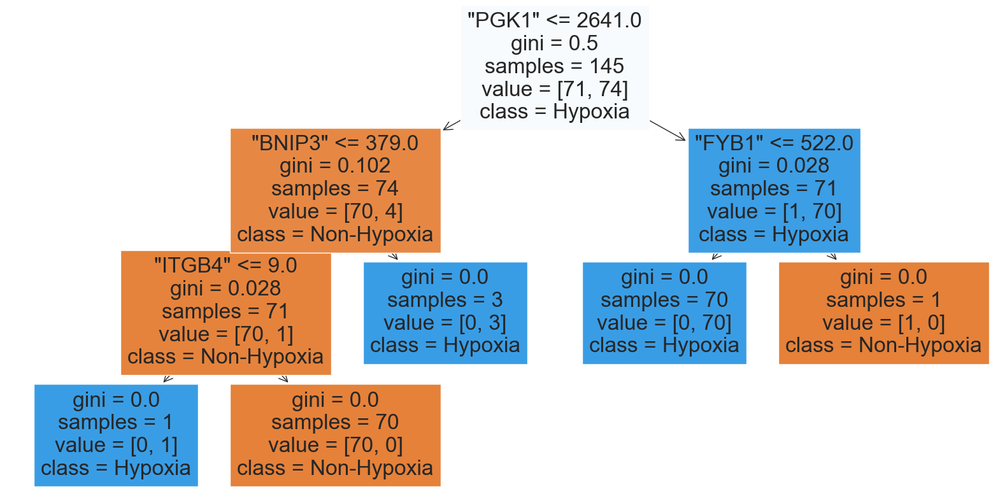

In [33]:
# separate features and target
X_HCC_SmartS_full = df_HCC_SmartS_filtered_normalised.drop('Hypoxia', axis=1)  
y_HCC_SmartS_full = df_HCC_SmartS_filtered_normalised['Hypoxia']  

# split the data - 80% for training and 20% for testing
X_HCC_SmartS_full_train, X_HCC_SmartS_full_test, y_HCC_SmartS_full_train, y_HCC_SmartS_full_test = train_test_split(X_HCC_SmartS_full, y_HCC_SmartS_full, test_size=0.2, random_state=42)

# model training
model_DTree_HCC_SmartS_full = DecisionTreeClassifier(max_depth=5, criterion='gini', random_state=42)
## increased max_iter for convergence with large datasets
model_DTree_HCC_SmartS_full.fit(X_HCC_SmartS_full_train, y_HCC_SmartS_full_train)

# model evaluation
y_HCC_SmartS_full_pred = model_DTree_HCC_SmartS_full.predict(X_HCC_SmartS_full_test)
print('Confusion matrix DecisionTree on full data HCC SmartS:')
print(confusion_matrix(y_HCC_SmartS_full_test, y_HCC_SmartS_full_pred))
print('Classification report DecisionTree on full data HCC SmartS:')
print(classification_report(y_HCC_SmartS_full_test, y_HCC_SmartS_full_pred))

#saving results
results_HCC_SmartS_dict['DTree_full'] = {
    'conf_matrix': confusion_matrix(y_HCC_SmartS_full_test, y_HCC_SmartS_full_pred),
    'class_report': classification_report(y_HCC_SmartS_full_test, y_HCC_SmartS_full_pred, output_dict=True)
}

# visualisation
plt.figure(figsize=(20,10))
plot_tree(model_DTree_HCC_SmartS_full, filled=True, feature_names=X_HCC_SmartS_full.columns, class_names=["Non-Hypoxia", "Hypoxia"])
plt.show()

In [34]:
# setup cross-validation method with shuffling the data
kf_DTree_HCC_SmartS_full = KFold(n_splits=5, shuffle=True, random_state=42)

# perform cross-validation
cv_scores_DTree_HCC_SmartS_full = cross_val_score(model_DTree_HCC_SmartS_full, X_HCC_SmartS_full, y_HCC_SmartS_full, cv=kf_LogReg_HCC_SmartS_full, scoring='accuracy')

print("CV Scores for 5 folds with shuffling: ", ['{:.2f}'.format(score) for score in cv_scores_DTree_HCC_SmartS_full])
print("Average CV Score with shuffling: {:.2f}".format(cv_scores_DTree_HCC_SmartS_full.mean()))

CV Scores for 5 folds with shuffling:  ['1.00', '0.95', '0.83', '0.92', '0.97']
Average CV Score with shuffling: 0.93


#### XGBoost

In [35]:
# separate features and target
X_HCC_SmartS_full = df_HCC_SmartS_filtered_normalised.drop('Hypoxia', axis=1)  
y_HCC_SmartS_full = df_HCC_SmartS_filtered_normalised['Hypoxia']  

# split the data - 80% for training and 20% for testing
X_HCC_SmartS_full_train, X_HCC_SmartS_full_test, y_HCC_SmartS_full_train, y_HCC_SmartS_full_test = train_test_split(X_HCC_SmartS_full, y_HCC_SmartS_full, test_size=0.2, random_state=42)

# model training
model_XGB_HCC_SmartS_full = xgb.XGBClassifier(objective='binary:logistic', eval_metric="logloss", use_label_encoder=False)
## increased max_iter for convergence with large datasets
model_XGB_HCC_SmartS_full.fit(X_HCC_SmartS_full_train, y_HCC_SmartS_full_train)

# model evaluation
y_HCC_SmartS_full_prediction = model_XGB_HCC_SmartS_full.predict(X_HCC_SmartS_full_test)
print('Confusion matrix XGB on full data HCC SmartS:')
print(confusion_matrix(y_HCC_SmartS_full_test, y_HCC_SmartS_full_prediction))
print('Classification report XGB on full data HCC SmartS:')
print(classification_report(y_HCC_SmartS_full_test, y_HCC_SmartS_full_prediction))

#saving results
results_HCC_SmartS_dict['XGB_full'] = {
    'conf_matrix': confusion_matrix(y_HCC_SmartS_full_test, y_HCC_SmartS_full_pred),
    'class_report': classification_report(y_HCC_SmartS_full_test, y_HCC_SmartS_full_pred, output_dict=True)
}


Confusion matrix XGB on full data HCC SmartS:
[[13  1]
 [ 0 23]]
Classification report XGB on full data HCC SmartS:
              precision    recall  f1-score   support

           0       1.00      0.93      0.96        14
           1       0.96      1.00      0.98        23

    accuracy                           0.97        37
   macro avg       0.98      0.96      0.97        37
weighted avg       0.97      0.97      0.97        37



In [36]:
# setup cross-validation method with shuffling the data
kf_XGB_HCC_SmartS_full = KFold(n_splits=5, shuffle=True, random_state=42)

# perform cross-validation
cv_scores_XGB_HCC_SmartS_full = cross_val_score(model_XGB_HCC_SmartS_full, X_HCC_SmartS_full, y_HCC_SmartS_full, cv=kf_XGB_HCC_SmartS_full, scoring='accuracy')

print("CV Scores for 5 folds with shuffling: ", ['{:.2f}'.format(score) for score in cv_scores_XGB_HCC_SmartS_full])
print("Average CV Score with shuffling: {:.2f}".format(cv_scores_XGB_HCC_SmartS_full.mean()))

CV Scores for 5 folds with shuffling:  ['0.97', '0.95', '0.94', '1.00', '1.00']
Average CV Score with shuffling: 0.97


#### Linear Support Vector Machine


In [37]:
# separate features and target
X_HCC_SmartS_full = df_HCC_SmartS_filtered_normalised.drop('Hypoxia', axis=1)  
y_HCC_SmartS_full = df_HCC_SmartS_filtered_normalised['Hypoxia']  

# split the data - 80% for training and 20% for testing
X_HCC_SmartS_full_train, X_HCC_SmartS_full_test, y_HCC_SmartS_full_train, y_HCC_SmartS_full_test = train_test_split(X_HCC_SmartS_full, y_HCC_SmartS_full, test_size=0.2, random_state=42)

# model training
model_LinSVM_HCC_SmartS_full = LinearSVC(random_state=42, max_iter=15000, dual=True if X_HCC_SmartS_full.shape[0] > X_HCC_SmartS_full.shape[1] else False)
## increased max_iter for convergence with large datasets
model_LinSVM_HCC_SmartS_full.fit(X_HCC_SmartS_full_train, y_HCC_SmartS_full_train)

# model evaluation
y_HCC_SmartS_full_pred = model_LinSVM_HCC_SmartS_full.predict(X_HCC_SmartS_full_test)
print('Confusion matrix LinSVM on full data HCC SmartS:')
print(confusion_matrix(y_HCC_SmartS_full_test, y_HCC_SmartS_full_pred))
print('Classification report LinSVM on full data HCC SmartS:')
print(classification_report(y_HCC_SmartS_full_test, y_HCC_SmartS_full_pred))

# saving results
results_HCC_SmartS_dict['LinSVM_full'] = {
    'conf_matrix': confusion_matrix(y_HCC_SmartS_full_test, y_HCC_SmartS_full_pred),
    'class_report': classification_report(y_HCC_SmartS_full_test, y_HCC_SmartS_full_pred, output_dict=True)
}

Confusion matrix LinSVM on full data HCC SmartS:
[[14  0]
 [ 0 23]]
Classification report LinSVM on full data HCC SmartS:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        14
           1       1.00      1.00      1.00        23

    accuracy                           1.00        37
   macro avg       1.00      1.00      1.00        37
weighted avg       1.00      1.00      1.00        37



In [38]:
# setup cross-validation method with shuffling the data
kf_LinSVM_HCC_SmartS_full = KFold(n_splits=5, shuffle=True, random_state=42)

# perform cross-validation
cv_scores_LinSVM_HCC_SmartS_full = cross_val_score(model_LinSVM_HCC_SmartS_full, X_HCC_SmartS_full, y_HCC_SmartS_full, cv=kf_LinSVM_HCC_SmartS_full, scoring='accuracy')

print("CV Scores for 5 folds with shuffling: ", ['{:.2f}'.format(score) for score in cv_scores_LinSVM_HCC_SmartS_full])
print("Average CV Score with shuffling: {:.2f}".format(cv_scores_LinSVM_HCC_SmartS_full.mean()))

CV Scores for 5 folds with shuffling:  ['1.00', '0.97', '0.94', '1.00', '1.00']
Average CV Score with shuffling: 0.98


#### Random Forest

In [39]:
# separate features and target
X_HCC_SmartS_full = df_HCC_SmartS_filtered_normalised.drop('Hypoxia', axis=1)  
y_HCC_SmartS_full = df_HCC_SmartS_filtered_normalised['Hypoxia']  

# split the data - 80% for training and 20% for testing
X_HCC_SmartS_full_train, X_HCC_SmartS_full_test, y_HCC_SmartS_full_train, y_HCC_SmartS_full_test = train_test_split(X_HCC_SmartS_full, y_HCC_SmartS_full, test_size=0.2, random_state=42)

# model training
model_RandF_HCC_SmartS_full = RandomForestClassifier(n_estimators=100, random_state=42)
## increased max_iter for convergence with large datasets
model_RandF_HCC_SmartS_full.fit(X_HCC_SmartS_full_train, y_HCC_SmartS_full_train)

# model evaluation
y_HCC_SmartS_full_pred = model_RandF_HCC_SmartS_full.predict(X_HCC_SmartS_full_test)
print('Confusion matrix RandForest on full data HCC SmartS:')
print(confusion_matrix(y_HCC_SmartS_full_test, y_HCC_SmartS_full_pred))
print('Classification report RandForest on full data HCC SmartS:')
print(classification_report(y_HCC_SmartS_full_test, y_HCC_SmartS_full_pred))

#saving results
results_HCC_SmartS_dict['RandF_full'] = {
    'conf_matrix': confusion_matrix(y_HCC_SmartS_full_test, y_HCC_SmartS_full_pred),
    'class_report': classification_report(y_HCC_SmartS_full_test, y_HCC_SmartS_full_pred, output_dict=True)
}

Confusion matrix RandForest on full data HCC SmartS:
[[14  0]
 [ 0 23]]
Classification report RandForest on full data HCC SmartS:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        14
           1       1.00      1.00      1.00        23

    accuracy                           1.00        37
   macro avg       1.00      1.00      1.00        37
weighted avg       1.00      1.00      1.00        37



In [40]:
# setup cross-validation method with shuffling the data
kf_RandF_HCC_SmartS_full = KFold(n_splits=5, shuffle=True, random_state=42)

# perform cross-validation
cv_scores_RandF_HCC_SmartS_full = cross_val_score(model_RandF_HCC_SmartS_full, X_HCC_SmartS_full, y_HCC_SmartS_full, cv=kf_RandF_HCC_SmartS_full, scoring='accuracy')

print("CV Scores for 5 folds with shuffling: ", ['{:.2f}'.format(score) for score in cv_scores_RandF_HCC_SmartS_full])
print("Average CV Score with shuffling: {:.2f}".format(cv_scores_RandF_HCC_SmartS_full.mean()))

CV Scores for 5 folds with shuffling:  ['1.00', '0.97', '0.97', '1.00', '1.00']
Average CV Score with shuffling: 0.99


### 6.2.3. Storing Model Evaluation Results

In [41]:
results_list_HCC_SmartS = []
for model_key, metrics in results_HCC_SmartS_dict.items():
    # leave the confusion matrix as a np.array
    conf_matrix = metrics['conf_matrix']
    # extract the overall classification metrics
    report = metrics['class_report']
    accuracy = report['accuracy']
    precision = report['weighted avg']['precision']
    recall = report['weighted avg']['recall']
    f1_score = report['weighted avg']['f1-score']
    # append a dictionary to the list, which will be used to create DataFrame
    results_list_HCC_SmartS.append({
        'Model': model_key,
        'Confusion Matrix': conf_matrix,
        'Accuracy': f"{accuracy:.2f}",
        'Precision': f"{precision:.2f}",
        'Recall': f"{recall:.2f}",
        'F1-Score': f"{f1_score:.2f}"
    })
results_df_HCC_SmartS = pd.DataFrame(results_list_HCC_SmartS)
# sort values by accuracy column
results_df_HCC_SmartS = results_df_HCC_SmartS.sort_values(by='Accuracy', ascending=False).reset_index(drop=True)
# save as CSV file
results_df_HCC_SmartS.to_csv('results_HCC_SmartS.csv', index=False)
results_df_HCC_SmartS

,Model,Confusion Matrix,Accuracy,Precision,Recall,F1-Score
0,LogReg_full,"[[14, 0], [0, 23]]",1.00,1.00,1.00,1.00
1,DTree_full,"[[14, 0], [0, 23]]",1.00,1.00,1.00,1.00
2,XGB_full,"[[14, 0], [0, 23]]",1.00,1.00,1.00,1.00
3,LinSVM_full,"[[14, 0], [0, 23]]",1.00,1.00,1.00,1.00
4,RandF_full,"[[14, 0], [0, 23]]",1.00,1.00,1.00,1.00


## 6.3. MCF DropS

### 6.3.1. Feature Selection

**NB** : We initially tried to perform some feature selection in order to reduce the number of features to feed to the models we developed for this dataset. We proceed as we did for SmartSeq datasets: we looked at the most expressed genes by gene count and we calculated the correlation coefficient and mutual information of the genes with respect to the Hypoxia column. Based on these metrics, we tried to create reduced models. However, these models did not perform well: they had high loss on the test set and low loss on the train set, indicating overfitting. 
For these reasons, we did not keep these models and trained our LinearSVM classifier and our NN on the full dataset will all 3000 features.

#### Gene Count: Most Expressed Genes 

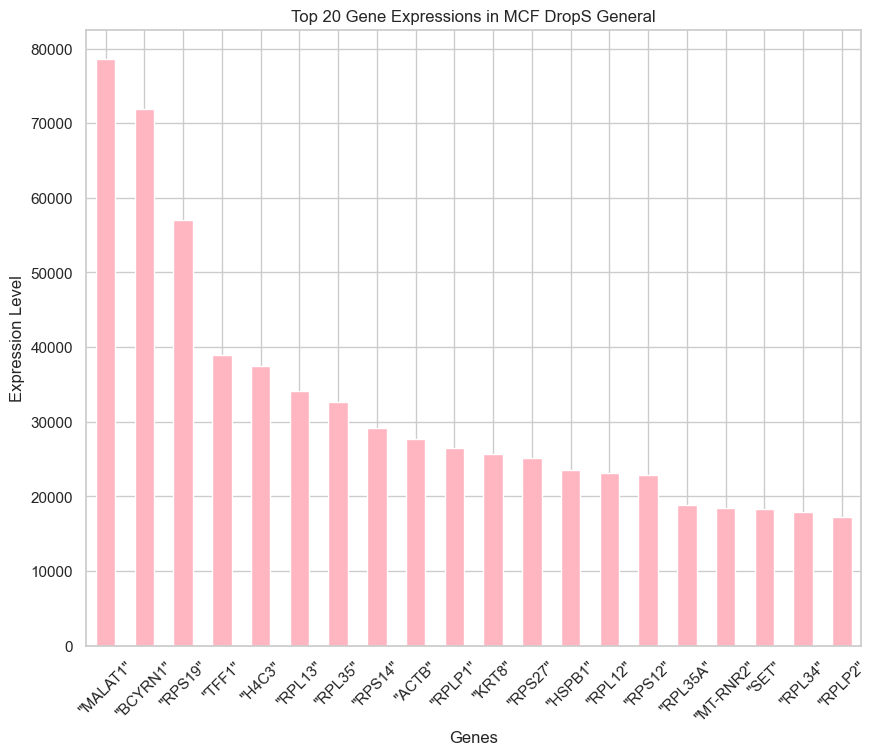

"MALAT1"     78606
"BCYRN1"     71927
"RPS19"      56997
"TFF1"       38913
"H4C3"       37434
"RPL13"      34143
"RPL35"      32611
"RPS14"      29088
"ACTB"       27683
"RPLP1"      26484
"KRT8"       25655
"RPS27"      25169
"HSPB1"      23475
"RPL12"      23057
"RPS12"      22860
"RPL35A"     18793
"MT-RNR2"    18392
"SET"        18273
"RPL34"      17910
"RPLP2"      17167
dtype: int64


In [388]:
## see gene expression by total columns
gene_sum_MCF_DropS_general = df_MCF_DropS.drop(columns=['Hypoxia']).sum(axis=0)
gene_expression_MCF_DropS_general = gene_sum_MCF_DropS_general.sort_values(ascending=False)
gene_expression_MCF_DropS_general
### MALAT1 is by far the most expressed

## ploting the first 20 to get a sense of what's happening
top_genes_MCF_DropS_general = gene_expression_MCF_DropS_general.head(20)
plt.figure(figsize=(10,8))
top_genes_MCF_DropS_general.plot(kind='bar', color='lightpink')
plt.title('Top 20 Gene Expressions in MCF DropS General')
plt.xlabel('Genes')
plt.ylabel('Expression Level')
plt.xticks(rotation=45)
plt.show()

print(gene_expression_MCF_DropS_general.head(20))

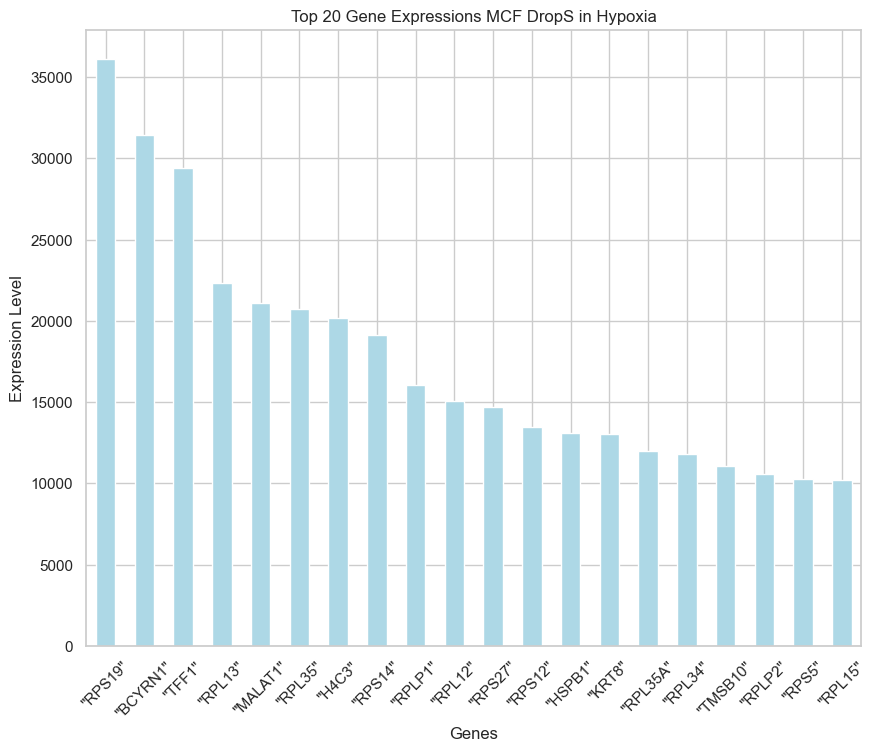

"RPS19"     36114
"BCYRN1"    31412
"TFF1"      29379
"RPL13"     22308
"MALAT1"    21122
"RPL35"     20718
"H4C3"      20164
"RPS14"     19154
"RPLP1"     16058
"RPL12"     15039
"RPS27"     14672
"RPS12"     13483
"HSPB1"     13092
"KRT8"      13029
"RPL35A"    11962
"RPL34"     11779
"TMSB10"    11048
"RPLP2"     10566
"RPS5"      10247
"RPL15"     10217
dtype: int64


In [389]:
## gene expression by Hypoxia
df_MCF_DropS_filtered = df_MCF_DropS[df_MCF_DropS['Hypoxia'] != 0]
gene_sum_MCF_DropS_Hypo = df_MCF_DropS_filtered.drop(columns=['Hypoxia']).sum(axis=0)
gene_expression_MCF_DropS_Hypo = gene_sum_MCF_DropS_Hypo.sort_values(ascending=False)
gene_expression_MCF_DropS_Hypo

## ploting the first 20 to get a sense of what's happening
top_genes_MCF_DropS_Hypo = gene_expression_MCF_DropS_Hypo.head(20)
plt.figure(figsize=(10,8))
top_genes_MCF_DropS_Hypo.plot(kind='bar', color='lightblue')
plt.title('Top 20 Gene Expressions MCF DropS in Hypoxia')
plt.xlabel('Genes')
plt.ylabel('Expression Level')
plt.xticks(rotation=45)
plt.show()

print(gene_expression_MCF_DropS_Hypo.head(20))

### 6.3.2 Model Development

In [42]:
# optionally suppress future warnings
warnings.filterwarnings('ignore', category=FutureWarning)

In [43]:
# dictionary to store results
results_MCF_DropS_dict = {}

#### Linear Support Vector Machine - Full Data

This is the first model we creted for this dataframe. We can see, it performs very well.

In [400]:
# separate features and target
X_MCF_DropS_full = df_MCF_DropS.drop('Hypoxia', axis=1)  
y_MCF_DropS_full = df_MCF_DropS['Hypoxia']  

# split the data - 80% for training and 20% for testing
X_MCF_DropS_full_train, X_MCF_DropS_full_test, y_MCF_DropS_full_train, y_MCF_DropS_full_test = train_test_split(X_MCF_DropS_full, y_MCF_DropS_full, test_size=0.2, random_state=42)

# model training
## increased max_iter for convergence with large datasets
model_LinSVM_MCF_DropS_full = LinearSVC(random_state=42, max_iter=15000)

# perform cross-validation
kf_LinSVM_MCF_DropS = KFold(n_splits=5, shuffle=True, random_state=42)
cv_scores = cross_val_score(model_LinSVM_MCF_DropS_full, X_MCF_DropS_full, y_MCF_DropS_full, cv=kf_LinSVM_MCF_DropS, scoring='accuracy')
print("CV Scores for 5 folds with shuffling: ", ['{:.2f}'.format(score) for score in cv_scores])
print("Average CV Score with shuffling: {:.2f}".format(cv_scores.mean()))


# fit model
model_LinSVM_MCF_DropS_full.fit(X_MCF_DropS_full_train, y_MCF_DropS_full_train)
# model evaluation
y_MCF_DropS_full_pred = model_LinSVM_MCF_DropS_full.predict(X_MCF_DropS_full_test)
print('Confusion matrix LinSVM on full data MCF DropS:')
print(confusion_matrix(y_MCF_DropS_full_test, y_MCF_DropS_full_pred))
print('Classification report LinSVM on full data MCF DropS:')
print(classification_report(y_MCF_DropS_full_test, y_MCF_DropS_full_pred))

# store results
results_MCF_DropS_dict['LinSVM'] = {
    'conf_matrix': confusion_matrix(y_MCF_DropS_full_test, y_MCF_DropS_full_pred),
    'class_report': classification_report(y_MCF_DropS_full_test, y_MCF_DropS_full_pred, output_dict=True)
}

/Users/emmamora/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/Users/emmamora/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/Users/emmamora/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/Users/emmamora/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


CV Scores for 5 folds with shuffling:  ['0.97', '0.97', '0.97', '0.97', '0.97']
Average CV Score with shuffling: 0.97
Confusion matrix LinSVM on full data MCF DropS:
[[2491   74]
 [  61 1700]]
Classification report LinSVM on full data MCF DropS:
              precision    recall  f1-score   support

           0       0.98      0.97      0.97      2565
           1       0.96      0.97      0.96      1761

    accuracy                           0.97      4326
   macro avg       0.97      0.97      0.97      4326
weighted avg       0.97      0.97      0.97      4326



/Users/emmamora/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


In [397]:
# perform cross-validation with shuffling the data
kf_LinSVM_MCF_DropS = KFold(n_splits=5, shuffle=True, random_state=42)
cv_scores_LinSVM_MCF_DropS = cross_val_score(model_LinSVM_MCF_DropS_full, X_MCF_DropS_full, y_MCF_DropS_full, cv=kf_LinSVM_MCF_DropS, scoring='accuracy')
print("CV Scores for 5 folds with shuffling: ", ['{:.2f}'.format(score) for score in cv_scores_LinSVM_MCF_DropS])
print("Average CV Score with shuffling: {:.2f}".format(cv_scores_LinSVM_MCF_DropS.mean()))


/Users/emmamora/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/Users/emmamora/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/Users/emmamora/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/Users/emmamora/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


CV Scores for 5 folds with shuffling:  ['0.97', '0.97', '0.97', '0.97', '0.97']
Average CV Score with shuffling: 0.97


#### Neural Network 

#####  Creating the NN

In [401]:
# separate features and targets 
## using .values to transform the df into an np array because tensorflow works with np arrays
X_MCF_DropS = df_MCF_DropS.drop('Hypoxia', axis=1).values
y_MCF_DropS = df_MCF_DropS['Hypoxia'].values

# split the data - 80% for training and 20% for testing
X_MCF_DropS_train, X_MCF_DropS_test, y_MCF_DropS_train, y_MCF_DropS_test = train_test_split(X_MCF_DropS, y_MCF_DropS, test_size=0.2, random_state=42)

# defining the model
model_NN_MCF_DropS = Sequential([
    Dense(128, activation='relu', input_dim=X_MCF_DropS_train.shape[1], kernel_regularizer=l2(0.01)),
    Dropout(0.4),  # dropout for regularization
    Dense(64, activation='relu', kernel_regularizer=l2(0.01)), 
    Dropout(0.2),  # dropout for regularization
    Dense(1, activation='sigmoid')  # output layer for binary classification
])

# compiling the model
model_NN_MCF_DropS.compile(optimizer=Adam(learning_rate=0.0001), loss='binary_crossentropy', metrics=['accuracy'])

# early stopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

# training the model with early stopping
history = model_NN_MCF_DropS.fit(X_MCF_DropS_train, y_MCF_DropS_train, validation_split=0.2, epochs=40, batch_size=64, verbose=2, callbacks=[early_stopping])

# model evaluation 
test_loss_MCF_DropS, test_accuracy_MCF_DropS = model_NN_MCF_DropS.evaluate(X_MCF_DropS_test, y_MCF_DropS_test, verbose=2)
print(f"Test Loss: {test_loss_MCF_DropS}, Test Accuracy: {test_accuracy_MCF_DropS}")

/Users/emmamora/anaconda3/lib/python3.11/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/40
217/217 - 2s - 10ms/step - accuracy: 0.8423 - loss: 2.6581 - val_accuracy: 0.9497 - val_loss: 1.6687
Epoch 2/40
217/217 - 1s - 4ms/step - accuracy: 0.9488 - loss: 1.2727 - val_accuracy: 0.9720 - val_loss: 0.9256
Epoch 3/40
217/217 - 1s - 3ms/step - accuracy: 0.9643 - loss: 0.7915 - val_accuracy: 0.9766 - val_loss: 0.6324
Epoch 4/40
217/217 - 1s - 3ms/step - accuracy: 0.9702 - loss: 0.5748 - val_accuracy: 0.9792 - val_loss: 0.4779
Epoch 5/40
217/217 - 1s - 3ms/step - accuracy: 0.9735 - loss: 0.4477 - val_accuracy: 0.9806 - val_loss: 0.3771
Epoch 6/40
217/217 - 1s - 3ms/step - accuracy: 0.9746 - loss: 0.3579 - val_accuracy: 0.9812 - val_loss: 0.3054
Epoch 7/40
217/217 - 1s - 3ms/step - accuracy: 0.9780 - loss: 0.2955 - val_accuracy: 0.9815 - val_loss: 0.2547
Epoch 8/40
217/217 - 1s - 3ms/step - accuracy: 0.9781 - loss: 0.2511 - val_accuracy: 0.9827 - val_loss: 0.2159
Epoch 9/40
217/217 - 1s - 3ms/step - accuracy: 0.9788 - loss: 0.2156 - val_accuracy: 0.9832 - val_loss: 0.1880


In [402]:
# get the predicted probabilities for the test set
y_MCF_DropS_pred_probs = model_NN_MCF_DropS.predict(X_MCF_DropS_test)

# convert probabilities to predicted labels
y_MCF_DropS_pred = (y_MCF_DropS_pred_probs > 0.5).astype("int32")
y_MCF_DropS_pred_probs

136/136 ━━━━━━━━━━━━━━━━━━━━ 0s 868us/step


array([[0.00456122],
       [0.641166  ],
       [0.999038  ],
       ...,
       [0.00621953],
       [0.00404929],
       [0.9996383 ]], dtype=float32)

##### Visualising the Training Process

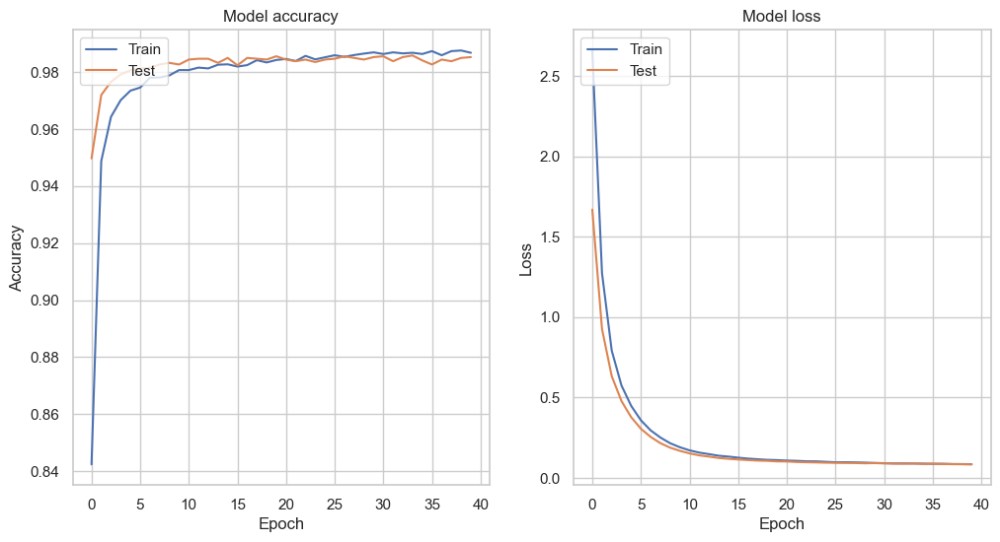

In [404]:
# plotting the training history to visualize the training process
plt.figure(figsize=(12, 6))

# plot training & validation accuracy values
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

# plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

#save_fig("training_process_NN_plot_MCF_DropS")
plt.show()

##### Visualising the Confusion Matrix

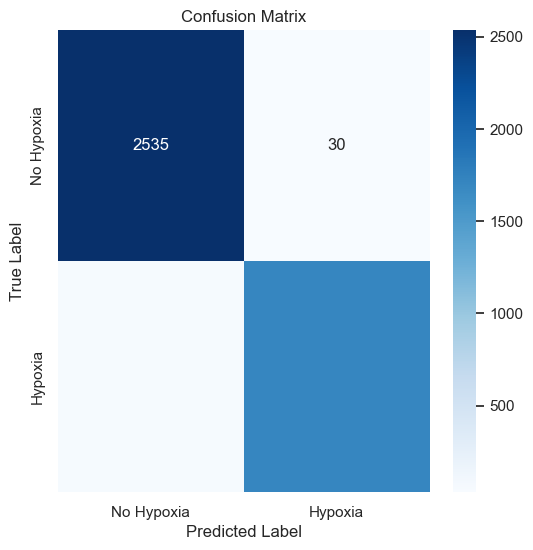

In [405]:
# confusion matrix
cm_MCF_DropS = confusion_matrix(y_MCF_DropS_test, y_MCF_DropS_pred)

plt.figure(figsize=(6,6))
sns.heatmap(cm_MCF_DropS, annot=True, fmt='d', cmap='Blues', xticklabels=['No Hypoxia', 'Hypoxia'], yticklabels=['No Hypoxia', 'Hypoxia'])
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix')
plt.show()

##### Store results


In [406]:
# store results
results_MCF_DropS_dict['NN'] = {
    'conf_matrix': confusion_matrix(y_MCF_DropS_test, y_MCF_DropS_pred),
    'class_report': classification_report(y_MCF_DropS_test, y_MCF_DropS_pred, output_dict=True)
}

### 6.3.3. Storing Model Evaluation Results

In [407]:
results_list_MCF_DropS = []
for model_key, metrics in results_MCF_DropS_dict.items():
    # leave the confusion matrix as a np.array
    conf_matrix = metrics['conf_matrix']
    # extract the overall classification metrics
    report = metrics['class_report']
    accuracy = report['accuracy']
    precision = report['weighted avg']['precision']
    recall = report['weighted avg']['recall']
    f1_score = report['weighted avg']['f1-score']
    # append a dictionary to the list, which will be used to create DataFrame
    results_list_MCF_DropS.append({
        'Model': model_key,
        'Confusion Matrix': conf_matrix,
        'Accuracy': f"{accuracy:.2f}",
        'Precision': f"{precision:.2f}",
        'Recall': f"{recall:.2f}",
        'F1-Score': f"{f1_score:.2f}"
    })
results_df_MCF_DropS = pd.DataFrame(results_list_MCF_DropS)
# sort values by accuracy column
results_df_MCF_DropS = results_df_MCF_DropS.sort_values(by='Accuracy', ascending=False).reset_index(drop=True)
# save as CSV file
results_df_MCF_DropS.to_csv('results_MCF_DropS.csv', index=False)
results_df_MCF_DropS

,Model,Confusion Matrix,Accuracy,Precision,Recall,F1-Score
0,NN,"[[2535, 30], [55, 1706]]",0.98,0.98,0.98,0.98
1,LinSVM,"[[2491, 74], [61, 1700]]",0.97,0.97,0.97,0.97


Both models perform very well, with a slight advantage for the NN model.

## 6.4. HCC DropS

### 6.4.1. Model Development

For this dataset we skipped the Feature Selection, as the models done on the reduced data (features selected by feature selection such as genest with highest correlation and highest mutual information to the Hypoxia column) did not produce good results for the MCF DropSeq dataset. They were overfitting to the training data.

In [408]:
# dictionary to store results
results_HCC_DropS_dict = {}

#### Linear Support Vector Machine - Full Data

In [409]:
# separate features and target
X_HCC_DropS_full = df_HCC_DropS.drop('Hypoxia', axis=1)  
y_HCC_DropS_full = df_HCC_DropS['Hypoxia']  

# split the data - 80% for training and 20% for testing
X_HCC_DropS_full_train, X_HCC_DropS_full_test, y_HCC_DropS_full_train, y_HCC_DropS_full_test = train_test_split(X_HCC_DropS_full, y_HCC_DropS_full, test_size=0.2, random_state=42)

# model training
model_LinSVM_HCC_DropS_full = LinearSVC(random_state=42, max_iter=15000)
## increased max_iter for convergence with large datasets
model_LinSVM_HCC_DropS_full.fit(X_HCC_DropS_full_train, y_HCC_DropS_full_train)

# model evaluation
y_HCC_DropS_full_pred = model_LinSVM_HCC_DropS_full.predict(X_HCC_DropS_full_test)
print('Confusion matrix LinSVM on full data HCC DropS:')
print(confusion_matrix(y_HCC_DropS_full_test, y_HCC_DropS_full_pred))
print('Classification report LinSVM on full data HCC DropS:')
print(classification_report(y_HCC_DropS_full_test, y_HCC_DropS_full_pred))

# store results
results_HCC_DropS_dict['LinSVM'] = {
    'conf_matrix': confusion_matrix(y_HCC_DropS_full_test, y_HCC_DropS_full_pred),
    'class_report': classification_report(y_HCC_DropS_full_test, y_HCC_DropS_full_pred, output_dict=True)
}


Confusion matrix LinSVM on full data HCC DropS:
[[1102   69]
 [ 101 1665]]
Classification report LinSVM on full data HCC DropS:
              precision    recall  f1-score   support

           0       0.92      0.94      0.93      1171
           1       0.96      0.94      0.95      1766

    accuracy                           0.94      2937
   macro avg       0.94      0.94      0.94      2937
weighted avg       0.94      0.94      0.94      2937



In [410]:
# perform cross-validation with shuffling the data
kf_LinSVM_HCC_DropS = KFold(n_splits=5, shuffle=True, random_state=42)
cv_scores_LinSVM_HCC_DropS = cross_val_score(model_LinSVM_HCC_DropS_full, X_HCC_DropS_full, y_HCC_DropS_full, cv=kf_LinSVM_HCC_DropS, scoring='accuracy')
print("CV Scores for 5 folds with shuffling: ", ['{:.2f}'.format(score) for score in cv_scores_LinSVM_HCC_DropS])
print("Average CV Score with shuffling: {:.2f}".format(cv_scores_LinSVM_HCC_DropS.mean()))


CV Scores for 5 folds with shuffling:  ['0.94', '0.95', '0.93', '0.94', '0.94']
Average CV Score with shuffling: 0.94


#### Neural Network

##### Creating the NN

In [411]:
# separate features and targets 
## using .values to transform the df into an np array because tensorflow works with np arrays
X_HCC_DropS = df_HCC_DropS.drop('Hypoxia', axis=1).values
y_HCC_DropS = df_HCC_DropS['Hypoxia'].values

# split the data - 80% for training and 20% for testing
X_HCC_DropS_train, X_HCC_DropS_test, y_HCC_DropS_train, y_HCC_DropS_test = train_test_split(X_HCC_DropS, y_HCC_DropS, test_size=0.2, random_state=42)

# defining the model
model_NN_HCC_DropS = Sequential([
    Dense(128, activation='relu', input_dim=X_HCC_DropS_train.shape[1], kernel_regularizer=l2(0.01)),
    Dropout(0.4),  # dropout for regularization
    Dense(64, activation='relu', kernel_regularizer=l2(0.01)), 
    Dropout(0.2),  # dropout for regularization
    Dense(1, activation='sigmoid')  # output layer for binary classification
])

# compiling the model
model_NN_HCC_DropS.compile(optimizer=Adam(learning_rate=0.0001), loss='binary_crossentropy', metrics=['accuracy'])

# early stopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

# training the model with early stopping
history = model_NN_HCC_DropS.fit(X_HCC_DropS_train, y_HCC_DropS_train, validation_split=0.2, epochs=40, batch_size=64, verbose=2, callbacks=[early_stopping])

# model evaluation 
test_loss_HCC_DropS, test_accuracy_HCC_DropS = model_NN_HCC_DropS.evaluate(X_HCC_DropS_test, y_HCC_DropS_test, verbose=2)
print(f"Test Loss: {test_loss_HCC_DropS}, Test Accuracy: {test_accuracy_HCC_DropS}")

Epoch 1/40


/Users/emmamora/anaconda3/lib/python3.11/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


147/147 - 1s - 10ms/step - accuracy: 0.6583 - loss: 3.1115 - val_accuracy: 0.8723 - val_loss: 2.3333
Epoch 2/40
147/147 - 1s - 5ms/step - accuracy: 0.8653 - loss: 1.8570 - val_accuracy: 0.9319 - val_loss: 1.4140
Epoch 3/40
147/147 - 1s - 4ms/step - accuracy: 0.9183 - loss: 1.2190 - val_accuracy: 0.9430 - val_loss: 0.9979
Epoch 4/40
147/147 - 0s - 3ms/step - accuracy: 0.9364 - loss: 0.9063 - val_accuracy: 0.9502 - val_loss: 0.7830
Epoch 5/40
147/147 - 1s - 6ms/step - accuracy: 0.9424 - loss: 0.7352 - val_accuracy: 0.9523 - val_loss: 0.6489
Epoch 6/40
147/147 - 1s - 5ms/step - accuracy: 0.9477 - loss: 0.6175 - val_accuracy: 0.9523 - val_loss: 0.5575
Epoch 7/40
147/147 - 1s - 5ms/step - accuracy: 0.9507 - loss: 0.5353 - val_accuracy: 0.9536 - val_loss: 0.4879
Epoch 8/40
147/147 - 1s - 4ms/step - accuracy: 0.9524 - loss: 0.4675 - val_accuracy: 0.9562 - val_loss: 0.4329
Epoch 9/40
147/147 - 1s - 4ms/step - accuracy: 0.9566 - loss: 0.4152 - val_accuracy: 0.9591 - val_loss: 0.3895
Epoch 10/40

In [412]:
# get the predicted probabilities for the test set
y_HCC_DropS_pred_probs = model_NN_HCC_DropS.predict(X_HCC_DropS_test)

# convert probabilities to predicted labels
y_HCC_DropS_pred = (y_HCC_DropS_pred_probs > 0.5).astype("int32")
y_HCC_DropS_pred_probs

92/92 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step  


array([[9.8385507e-01],
       [9.9297774e-01],
       [9.9977130e-01],
       ...,
       [2.3977688e-01],
       [8.7247149e-04],
       [9.9946231e-01]], dtype=float32)

##### Visualising the Training Process

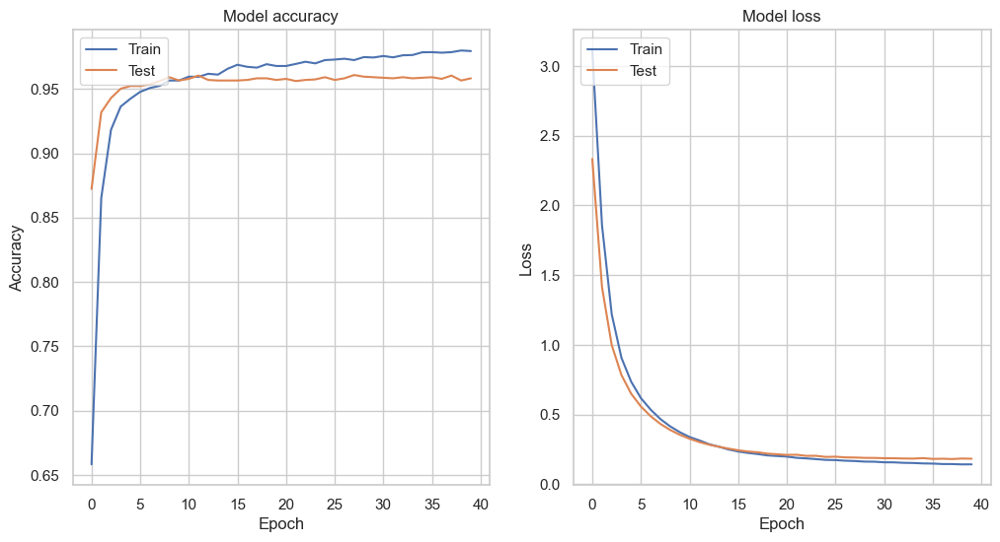

In [413]:
# plotting the training history to visualize the training process
plt.figure(figsize=(12, 6))

# plot training & validation accuracy values
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

# plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

#save_fig("training_process_NN_plot_MCF_DropS")
plt.show()

##### Visualising the Confusion Matrix

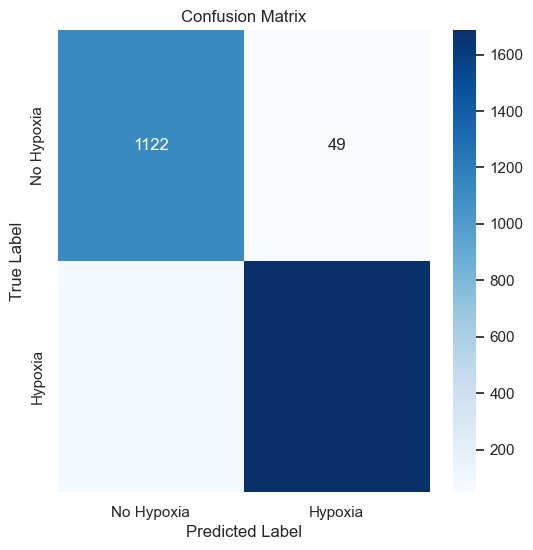

In [414]:
# confusion matrix
cm_HCC_DropS = confusion_matrix(y_HCC_DropS_test, y_HCC_DropS_pred)

plt.figure(figsize=(6,6))
sns.heatmap(cm_HCC_DropS, annot=True, fmt='d', cmap='Blues', xticklabels=['No Hypoxia', 'Hypoxia'], yticklabels=['No Hypoxia', 'Hypoxia'])
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix')
plt.show()

##### Store results


In [415]:
# store results
results_HCC_DropS_dict['NN'] = {
    'conf_matrix': confusion_matrix(y_HCC_DropS_test, y_HCC_DropS_pred),
    'class_report': classification_report(y_HCC_DropS_test, y_HCC_DropS_pred, output_dict=True)
}

### 6.4.2. Storing Model Evaluation Results

In [416]:
results_list_HCC_DropS = []
for model_key, metrics in results_HCC_DropS_dict.items():
    # leave the confusion matrix as a np.array
    conf_matrix = metrics['conf_matrix']
    # extract the overall classification metrics
    report = metrics['class_report']
    accuracy = report['accuracy']
    precision = report['weighted avg']['precision']
    recall = report['weighted avg']['recall']
    f1_score = report['weighted avg']['f1-score']
    # append a dictionary to the list, which will be used to create DataFrame
    results_list_HCC_DropS.append({
        'Model': model_key,
        'Confusion Matrix': conf_matrix,
        'Accuracy': f"{accuracy:.2f}",
        'Precision': f"{precision:.2f}",
        'Recall': f"{recall:.2f}",
        'F1-Score': f"{f1_score:.2f}"
    })
results_df_HCC_DropS = pd.DataFrame(results_list_HCC_DropS)
# sort values by accuracy column
results_df_HCC_DropS = results_df_HCC_DropS.sort_values(by='Accuracy', ascending=False).reset_index(drop=True)
# save as CSV file
results_df_HCC_DropS.to_csv('results_HCC_DropS.csv', index=False)
results_df_HCC_DropS

,Model,Confusion Matrix,Accuracy,Precision,Recall,F1-Score
0,NN,"[[1122, 49], [80, 1686]]",0.96,0.96,0.96,0.96
1,LinSVM,"[[1102, 69], [101, 1665]]",0.94,0.94,0.94,0.94


Similarly to the MCF DropSeq dataset, the NN performed slightly better.

## 6.5. Other Models

### 6.5.1. General DropS Model

#### Data Integration - Full DropS Data

In [44]:
df_MCF_DropS_common = df_MCF_DropS[genes_DropS_common].copy()
df_HCC_DropS_common = df_HCC_DropS[genes_DropS_common].copy()

In [45]:
df_HCC_DropS_common

,"""MALAT1""","""MT-RNR2""","""NEAT1""","""H1-5""","""MT-RNR1""","""H4C3""","""MT-CO3""","""MT-ND4""","""MT-ND3""","""MT-CYB""",...,"""PYGO1""","""TCL6""","""ZBTB2""","""TUBD1""","""PPP2R5D""","""SUNO1""","""CHN1""","""RARG""","""MYO1F""","""TNK2"""
"""AAAAAACCCGGC_Normoxia""",3,0,1,2,0,2,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACCGGATGC_Normoxia""",3,0,0,2,0,9,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACGAGCTAG_Normoxia""",2,0,0,5,0,7,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACTTCCCCG_Normoxia""",3,0,0,1,0,2,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAAGCCTACCC_Normoxia""",12,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"""TTTTTACCAATC_Hypoxia""",0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""TTTTTCCGTGCA_Hypoxia""",4,1,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""TTTTTGCCTGGG_Hypoxia""",1,0,0,0,4,3,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
"""TTTTTGTAACAG_Hypoxia""",3,1,0,3,0,5,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [46]:
# columns = df_MCF_SmartS_common.columns.drop('Hypoxia')  # features only
column = genes_DropS_common
df_MCF_DropS_common = df_MCF_DropS[genes_DropS_common].copy()
df_HCC_DropS_common = df_HCC_DropS[genes_DropS_common].copy()

# Create DataFrames with the index and exclude the 'Hypoxia' column for now
df_X_MCF_DropS = pd.DataFrame(df_MCF_DropS, columns=df_MCF_DropS_common.columns, index=df_MCF_DropS_common.index)
df_X_HCC_DropS = pd.DataFrame(df_HCC_DropS, columns=df_HCC_DropS_common.columns, index=df_HCC_DropS_common.index)

# Insert the 'Hypoxia' column at the beginning of each DataFrame
df_X_MCF_DropS.insert(0, 'Hypoxia', df_MCF_DropS['Hypoxia'])
df_X_HCC_DropS.insert(0, 'Hypoxia', df_HCC_DropS['Hypoxia'])
# merge all datasets
df_general_DropS = pd.concat([df_X_MCF_DropS,df_X_HCC_DropS], ignore_index=False)

In [47]:
df_general_DropS

,Hypoxia,"""MALAT1""","""MT-RNR2""","""NEAT1""","""H1-5""","""MT-RNR1""","""H4C3""","""MT-CO3""","""MT-ND4""","""MT-ND3""",...,"""PYGO1""","""TCL6""","""ZBTB2""","""TUBD1""","""PPP2R5D""","""SUNO1""","""CHN1""","""RARG""","""MYO1F""","""TNK2"""
"""AAAAACCTATCG_Normoxia""",0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACAACCCTA_Normoxia""",0,3,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACACTCTCA_Normoxia""",0,3,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACCAGGCAC_Normoxia""",0,6,2,0,0,0,1,0,3,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACCTAGCTC_Normoxia""",0,4,0,0,0,0,0,1,1,1,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"""TTTTTACCAATC_Hypoxia""",1,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""TTTTTCCGTGCA_Hypoxia""",1,4,1,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""TTTTTGCCTGGG_Hypoxia""",1,1,0,0,0,4,3,0,0,0,...,0,0,0,0,0,0,0,1,0,0
"""TTTTTGTAACAG_Hypoxia""",1,3,1,0,3,0,5,0,0,0,...,0,0,0,0,0,0,0,0,0,0


#### Random Forest on Full Data

In [48]:
len(df_X_HCC_DropS)

14682

In [49]:
# separate features and target
#X_general_DropS = df_general_DropS.drop(['Hypoxia','Dataset'], axis=1) 
X_general_DropS = df_general_DropS.drop(['Hypoxia'], axis=1) 
y_general_DropS = df_general_DropS['Hypoxia']  

# split the data - 80% for training and 20% for testing
X_general_DropS_train, X_general_DropS_test, y_general_DropS_train, y_general_DropS_test = train_test_split(X_general_DropS, y_general_DropS, test_size=0.2, random_state=42)

In [50]:
# model training
#model_RandF_general_sampled = RandomForestClassifier(n_estimators=100, random_state=42)
model_RandF_general_DropS = RandomForestClassifier(n_estimators=200, random_state=42, min_samples_leaf=1, min_samples_split=10, max_depth=None)
#'max_depth': None, 'max_features': 'auto', 'min_samples_leaf': 1, 'min_samples_split': 10, 'n_estimators': 200
model_RandF_general_DropS.fit(X_general_DropS_train, y_general_DropS_train)

# model evaluation
y_general_DropS_pred = model_RandF_general_DropS.predict(X_general_DropS_test)
print('Confusion matrix RandF on full data:')
print(confusion_matrix(y_general_DropS_test, y_general_DropS_pred))
print('Classification report RandF on full data:')
print(classification_report(y_general_DropS_test, y_general_DropS_pred))

# saving results
# results_general_dict['RandF'] = {
#     'conf_matrix': confusion_matrix(y_general_sampled_test, y_general_sampled_pred),
#     'class_report': classification_report(y_general_sampled_test, y_general_sampled_pred, output_dict=True)
# }

# feature importances
feature_importances_RandF_general_DropS = model_RandF_general_DropS.feature_importances_
## we'll create a df so it's easily stored
features_df_RandF_general_DropS = pd.DataFrame({
    'Feature': X_general_DropS_train.columns,
    'Importance': feature_importances_RandF_general_DropS
})
features_df_RandF_general_DropS = features_df_RandF_general_DropS.sort_values(by='Importance', ascending=False)
# print("Feature Importances:\n")
# print(features_df_RandF_general_sampled)
print("Feature Importances RandF full (first 10):\n")
print(features_df_RandF_general_DropS.head(10))

Confusion matrix RandF on full data:
[[3475  240]
 [ 261 3286]]
Classification report RandF on full data:
              precision    recall  f1-score   support

           0       0.93      0.94      0.93      3715
           1       0.93      0.93      0.93      3547

    accuracy                           0.93      7262
   macro avg       0.93      0.93      0.93      7262
weighted avg       0.93      0.93      0.93      7262

Feature Importances RandF full (first 10):

       Feature  Importance
28    "BCYRN1"    0.039534
197    "KRT19"    0.037627
11    "TMSB10"    0.036985
588     "PGK1"    0.033325
189     "ENO1"    0.031859
582    "GAPDH"    0.028586
1    "MT-RNR2"    0.025702
31      "RPS5"    0.024684
173      "FTL"    0.022727
0     "MALAT1"    0.022374


##### Fine-Tuning Random Forest on Full Data

Due to the large size of df_general_DropS, performing GridSearchCV is not computationally feasible. We explore other fine-tuning methods, such as: RandomizedSearchCV and BayesianOptimization (we end up not exploring the BayesianOptimization).

**RandomisedSearchCV**

In [ ]:
# parameter grid for RandF
param_distributions_RandF = {
    'n_estimators': randint(100, 300),  # number of trees
    'max_depth': [None, 10, 20, 30, 40, 50], # number of features to consider at every split
    'min_samples_split': randint(2, 20), # maximum number of levels in tree
    'min_samples_leaf': randint(1, 10), # minimum number of samples required to split a node
    'max_features': ['auto', 'sqrt', 'log2'] # minimum number of samples required at each leaf node
}

# set up RandomisedSearchCV
randomised_search_RandF = RandomizedSearchCV(RandomForestClassifier(random_state=42), param_distributions_RandF, n_iter=100, cv=3, verbose=2, random_state=42, n_jobs=-1)
randomised_search_RandF.fit(X_general_DropS_train, y_general_DropS_train)

# best parameters and score 
print("Best parameters for RandF:", randomised_search_RandF.best_params_)
print("Best cross-validated accuracy for RandF:", randomised_search_RandF.best_score_)

# we choose to clear the results of this part out as it occupies too much space in the final html file

In [207]:
# best parameters and score for RBF SVM
print("Best parameters for RandF:", randomised_search_RandF.best_params_)
print("Best cross-validated accuracy for RandF:", randomised_search_RandF.best_score_)

Best parameters for RandF: {'max_depth': 50, 'max_features': 'log2', 'min_samples_leaf': 1, 'min_samples_split': 6, 'n_estimators': 241}
Best cross-validated accuracy for RandF: 0.9273221786132342


##### Setting up Nested Cross Validation for RandF Model

**Outer Loop**
 - splits the data into test/train to evaluate the model's performance on unseen data (our usual cross-validation)
 
**Inner Loop**
 - nested within each training fold of the outer loop
 - used for model selection & hyperparameter tuning

We will set up the whole model again just to avoid any overlaps in terms of notation.

In [51]:
# define the model
model_RandF_general_DropS = RandomForestClassifier(max_features='log2', min_samples_leaf=1, min_samples_split=6, n_estimators=241, random_state=42, max_depth=50)

# nested cross validation
inner_cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
outer_cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# we'll use the full features X_general_sampled and target y_general_sampled (no splitting into test and train)
cv_nested_score_RandF_general_DropS = cross_val_score(model_RandF_general_DropS, X_general_DropS, y_general_DropS, cv=outer_cv, scoring='accuracy')

print("Cross-validation scores:\n", cv_nested_score_RandF_general_DropS)
print("Mean CV accuracy: {:.2f}".format(np.mean(cv_nested_score_RandF_general_DropS)))
print("Standard deviation in CV scores: {:.2f}".format(np.std(cv_nested_score_RandF_general_DropS)))

# model training 
## we train the model on the COMPLETE DATA
model_RandF_general_DropS.fit(X_general_DropS, y_general_DropS)

# feature importances
feature_importances_RandF_general_DropS = model_RandF_general_DropS.feature_importances_
## we'll create a df so it's easily stored
features_df_RandF_general_DropS = pd.DataFrame({
    'Feature': X_general_DropS.columns,
    'Importance': feature_importances_RandF_general_DropS
})
features_df_RandF_general_sampled = features_df_RandF_general_DropS.sort_values(by='Importance', ascending=False)
# print("Feature Importances:\n")
# print(features_df_RandF_general_sampled)
print("Feature Importances RandF full (first 10):\n")
print(features_df_RandF_general_DropS.head(10))

Cross-validation scores:
 [0.93527954 0.92701735 0.92756816 0.93430657 0.92728274]
Mean CV accuracy: 0.93
Standard deviation in CV scores: 0.00
Feature Importances RandF full (first 10):

     Feature  Importance
0   "MALAT1"    0.015680
1  "MT-RNR2"    0.020802
2    "NEAT1"    0.002300
3     "H1-5"    0.003580
4  "MT-RNR1"    0.012951
5     "H4C3"    0.010585
6   "MT-CO3"    0.005357
7   "MT-ND4"    0.006900
8   "MT-ND3"    0.005414
9   "MT-CYB"    0.006028


#### Neural Network on Full Data

Best Hyperparameters so far
* epochs = 40
* dropout layers both 0.2
* step_size = 0.0001

In [52]:
# separate features and targets 
## using .values to transform the df into an np array because tensorflow works with np arrays

# ## convert data to float32 explicitly(SAMPLED FILTERED)
# X_DropS = df_general_sampled_filtered_DropS.drop(['Hypoxia','Dataset'], axis=1).values.astype(np.float32)
# y_DropS = df_general_sampled_filtered_DropS['Hypoxia'].values.astype(np.float32)

## ALL COMMON GENES
## convert data to float32 explicitly
X_DropS = df_general_DropS.drop(['Hypoxia'], axis=1).values.astype(np.float32)
y_DropS = df_general_DropS['Hypoxia'].values.astype(np.float32)

# split the data - 80% for training and 20% for testing
X_DropS_train, X_DropS_test, y_DropS_train, y_DropS_test = train_test_split(X_DropS, y_DropS, test_size=0.2, random_state=42)

# defining the model
model_NN_DropS = Sequential([
    Dense(128, activation='relu', input_dim=X_DropS_train.shape[1], kernel_regularizer=l2(0.01)),
    Dropout(0.2),  # dropout for regularization
    Dense(64, activation='relu', kernel_regularizer=l2(0.01)), 
    Dropout(0.2),  # dropout for regularization
    Dense(1, activation='sigmoid')  # output layer for binary classification
])


# compiling the model
model_NN_DropS.compile(optimizer=Adam(learning_rate=0.0001), loss='binary_crossentropy', metrics=['accuracy'])

# early stopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# training the model with early stopping
history = model_NN_DropS.fit(X_DropS_train, y_DropS_train, validation_split=0.2, epochs=40, batch_size=64, verbose=2, callbacks=[early_stopping])

# model evaluation 
test_loss_DropS, test_accuracy_DropS = model_NN_DropS.evaluate(X_DropS_test, y_DropS_test, verbose=2)
print(f"Test Loss: {test_loss_DropS}, Test Accuracy: {test_accuracy_DropS}")

/Users/emmamora/anaconda3/lib/python3.11/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/40
364/364 - 2s - 6ms/step - accuracy: 0.7567 - loss: 2.5557 - val_accuracy: 0.8757 - val_loss: 1.6438
Epoch 2/40
364/364 - 1s - 2ms/step - accuracy: 0.8794 - loss: 1.2513 - val_accuracy: 0.8966 - val_loss: 0.9321
Epoch 3/40
364/364 - 1s - 1ms/step - accuracy: 0.8981 - loss: 0.7916 - val_accuracy: 0.9072 - val_loss: 0.6582
Epoch 4/40
364/364 - 1s - 2ms/step - accuracy: 0.9050 - loss: 0.6000 - val_accuracy: 0.9134 - val_loss: 0.5279
Epoch 5/40
364/364 - 1s - 2ms/step - accuracy: 0.9109 - loss: 0.4962 - val_accuracy: 0.9167 - val_loss: 0.4493
Epoch 6/40
364/364 - 1s - 2ms/step - accuracy: 0.9156 - loss: 0.4292 - val_accuracy: 0.9162 - val_loss: 0.4008
Epoch 7/40
364/364 - 1s - 1ms/step - accuracy: 0.9180 - loss: 0.3836 - val_accuracy: 0.9203 - val_loss: 0.3585
Epoch 8/40
364/364 - 1s - 2ms/step - accuracy: 0.9201 - loss: 0.3496 - val_accuracy: 0.9224 - val_loss: 0.3310
Epoch 9/40
364/364 - 1s - 1ms/step - accuracy: 0.9251 - loss: 0.3223 - val_accuracy: 0.9250 - val_loss: 0.3095
E

In [ ]:
# epochs = 40, DropOut = 0.5 and 0.5, learning rate = 0.0005, regularization = 0.1 both : 0.94 acc
# epochs = 40, DropOut = 0.4 and 0.4, learning rate = 0.0005, regularization = 0.1 both : 0.94 acc
# epochs = 40, DropOut = 0.4 and 0.4, learning rate = 0.001, regularization = 0.1 both : 0.92 acc
# epochs = 40, DropOut = 0.4 and 0.4, learning rate = 0.0001, regularization = 0.1 both : 0.945 acc
# epochs = 40, DropOut = 0.3 and 0.3, learning rate = 0.0001, regularization = 0.1 both : 0.944 acc
# epochs = 40, DropOut = 0.2 and 0.2, learning rate = 0.0001, regularization = 0.1 both : 0.947 acc


Our neural network achieves a 0.947 accuracy which we consider really well keeping in mind we merged the MCF and HCC DropSeq datasets to get a general model.

In [53]:
# get the predicted probabilities for the test set
y_DropS_pred_probs = model_NN_DropS.predict(X_DropS_test)

# convert probabilities to predicted labels
y_DropS_pred = (y_DropS_pred_probs > 0.5).astype("int32")
y_DropS_pred_probs

224/227 ━━━━━━━━━━━━━━━━━━━━ 0s 450us/step

227/227 ━━━━━━━━━━━━━━━━━━━━ 0s 567us/step


array([[0.0039419 ],
       [0.5211798 ],
       [0.00363636],
       ...,
       [0.87564695],
       [0.9977455 ],
       [0.0075101 ]], dtype=float32)

##### Visualising the Training Process

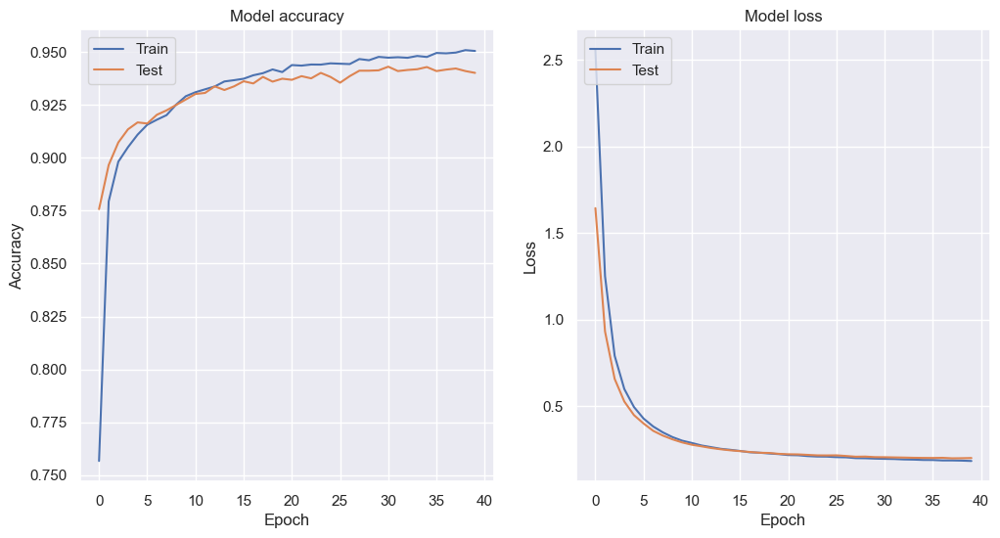

In [54]:
# plotting the training history to visualize the training process
plt.figure(figsize=(12, 6))

# plot training & validation accuracy values
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

# plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

#save_fig("training_process_NN_plot_DropS")
plt.show()

##### Visualising the Confusion Matrix

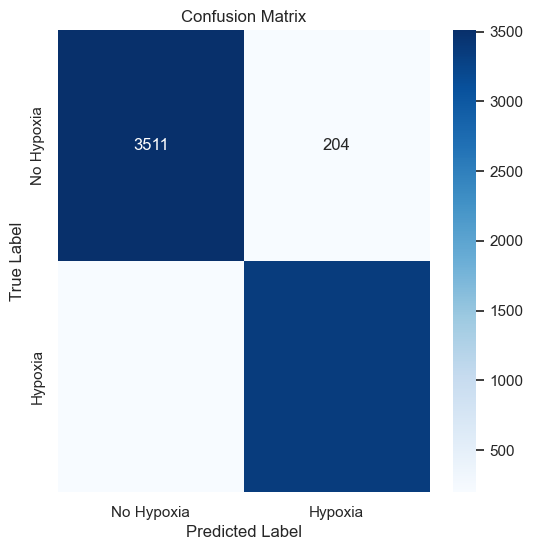

In [55]:
# confusion matrix
cm_DropS = confusion_matrix(y_DropS_test, y_DropS_pred)

plt.figure(figsize=(6,6))
sns.heatmap(cm_DropS, annot=True, fmt='d', cmap='Blues', xticklabels=['No Hypoxia', 'Hypoxia'], yticklabels=['No Hypoxia', 'Hypoxia'])
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix')
plt.show()

#### Data Integration - Sampled Filtered Data

##### Sampling from Datasets

In [213]:
# create function to balance classes within each dataset

def stratified_sample(df, target, sample_size):
    return df.groupby(target, group_keys=False).apply(lambda x: x.sample(int(np.rint(sample_size * len(x) / len(df))))).reset_index(drop=False)
    #return df.groupby(target, group_keys=False).apply(lambda x: x.sample(min(len(x), sample_size), random_state=42))

df_MCF_DropS_sampled = stratified_sample(df_MCF_DropS, 'Hypoxia', 6000).set_index('index', drop=True)
df_HCC_DropS_sampled = stratified_sample(df_HCC_DropS, 'Hypoxia', 6000).set_index('index', drop=True)

## target = 'Hypoxia'
## sample_size:
# MCF SmartS: 100-200
# HCC SmartS: 90-150
# MCF DropS: 5000-10000
# HCC DropS: 5000-8000

# The choice of sample_size depends on multiple factors, including the size of your datasets and the requirements of your analysis.
# If you have a very large dataset and computational resources or time are concerns, you might choose a smaller sample size.
# If maintaining a high degree of statistical power is critical, you might opt for a larger sample size.
# The sample size should not exceed the size of your smallest class multiplied by the number of classes if you aim to keep the data balanced without replacement.

In [214]:
print(df_MCF_DropS_sampled.shape)
print(df_MCF_DropS_sampled.index)

(6000, 3001)
Index(['"TGGCGGCGCCCT_Normoxia"', '"CTCGCCATATCC_Normoxia"',
       '"CGCCAATGTTCG_Normoxia"', '"GCCAAGGTGCCA_Normoxia"',
       '"GTTTGCGGCGGC_Normoxia"', '"TTTGCACAAAGC_Normoxia"',
       '"AGCCCCGTTAAG_Normoxia"', '"GATTTACAGCCT_Normoxia"',
       '"GGCTCAAATGGA_Normoxia"', '"GATTAGGCCGTG_Normoxia"',
       ...
       '"GAGCGTAAGCCA_Hypoxia"', '"CCGCCGACACTC_Hypoxia"',
       '"GGTCGTCCCGCC_Hypoxia"', '"CGCACTCGGCAC_Hypoxia"',
       '"AGAACCTGCAGC_Hypoxia"', '"AGAGGATGATCC_Hypoxia"',
       '"CGTCAAGTGACC_Hypoxia"', '"ACAGCGCTGGCA_Hypoxia"',
       '"TCCCGGCGCACA_Hypoxia"', '"AGGGGCATGGGG_Hypoxia"'],
      dtype='object', name='index', length=6000)


In [215]:
df_HCC_DropS_sampled

,Hypoxia,"""H1-5""","""MALAT1""","""MT-RNR2""","""ARVCF""","""BCYRN1""","""ATXN7L2""","""IGFBP3""","""H1-3""","""CTIF""",...,"""BATF3""","""CDKN3""","""DLD""","""PMPCA""","""ZNF165""","""SCCPDH""","""NTAN1""","""CLIP2""","""DUSP23""","""ZNF682"""
index,,,,,,,,,,,,,,,,,,,,,
"""CTGTTCCAGCCC_Normoxia""",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""CCTACGTCCCTG_Normoxia""",0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""GGGCTGCTTGAG_Normoxia""",0,0,0,3,0,2,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
"""AACGCCGCGGGT_Normoxia""",0,0,3,0,0,0,0,4,0,0,...,0,0,1,0,0,0,0,0,0,0
"""ACCACATGATTT_Normoxia""",0,1,0,0,0,3,0,0,2,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"""GTCTCCCGGTCA_Hypoxia""",1,0,0,2,0,2,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
"""AACCCCGAGCGG_Hypoxia""",1,1,2,0,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
"""TTATCTCCGGTC_Hypoxia""",1,0,0,2,0,0,0,2,0,0,...,0,0,0,0,0,0,0,0,0,0


In [216]:
df_MCF_DropS_common = df_MCF_DropS_sampled[['Hypoxia'] + list(genes_DropS_common)]
df_HCC_DropS_common = df_HCC_DropS_sampled[['Hypoxia'] + list(genes_DropS_common)]

# create common df for SmartS and DropS
# df_SmartS_common = pd.concat([df_MCF_SmartS_common, df_HCC_SmartS_common], ignore_index=True)
# df_DropS_common = pd.concat([df_MCF_DropS_common, df_HCC_DropS_common], ignore_index=True)

In [217]:
df_MCF_DropS_common

,Hypoxia,"""MALAT1""","""MT-RNR2""","""NEAT1""","""H1-5""","""MT-RNR1""","""H4C3""","""MT-CO3""","""MT-ND4""","""MT-ND3""",...,"""PYGO1""","""TCL6""","""ZBTB2""","""TUBD1""","""PPP2R5D""","""SUNO1""","""CHN1""","""RARG""","""MYO1F""","""TNK2"""
index,,,,,,,,,,,,,,,,,,,,,
"""TGGCGGCGCCCT_Normoxia""",0,4,6,0,0,1,2,1,0,1,...,0,0,0,0,0,0,0,0,0,0
"""CTCGCCATATCC_Normoxia""",0,3,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""CGCCAATGTTCG_Normoxia""",0,2,3,0,0,0,0,0,1,1,...,0,0,0,0,0,0,0,0,0,0
"""GCCAAGGTGCCA_Normoxia""",0,1,0,0,0,0,2,0,0,2,...,0,0,0,0,0,0,0,0,0,0
"""GTTTGCGGCGGC_Normoxia""",0,0,0,0,0,0,2,1,1,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"""AGAGGATGATCC_Hypoxia""",1,2,0,0,1,0,4,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""CGTCAAGTGACC_Hypoxia""",1,1,0,0,0,0,5,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""ACAGCGCTGGCA_Hypoxia""",1,1,1,0,0,0,3,0,0,0,...,0,0,0,0,0,0,0,0,0,0


##### Filtering the Data

**Genes with High Hypoxia Correlation**

In [218]:
# correlation matrices
correlation_matrix_MCF_DropS = df_MCF_DropS_common.corr()
correlation_matrix_HCC_DropS = df_HCC_DropS_common.corr()

# correlations with the 'Hypoxia' column
hypoxia_correlations_MCF_DropS = correlation_matrix_MCF_DropS.loc['Hypoxia']
hypoxia_correlations_HCC_DropS = correlation_matrix_HCC_DropS.loc['Hypoxia']



/Users/emmamora/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


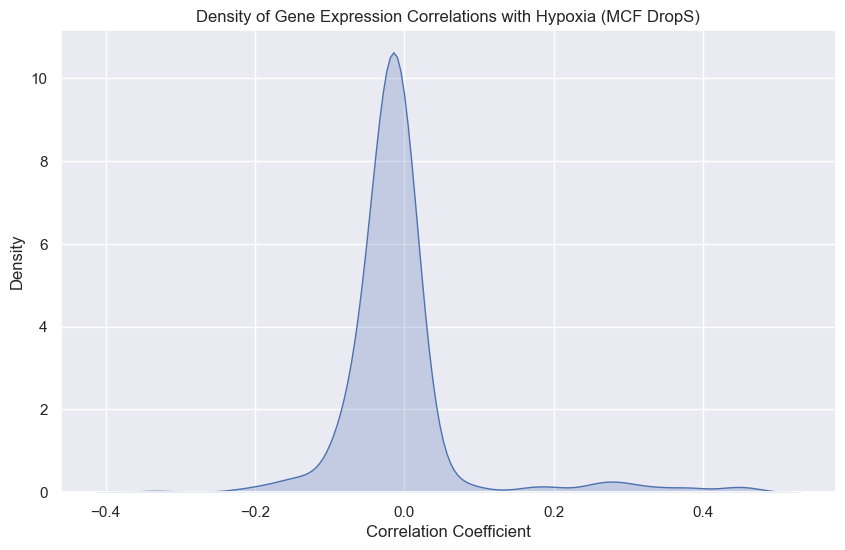

In [219]:
# plotting MCF DropS
filtered_correlations_MCF = hypoxia_correlations_MCF_DropS.drop('Hypoxia')

plt.figure(figsize=(10, 6))
sns.kdeplot(filtered_correlations_MCF, fill=True)
plt.title('Density of Gene Expression Correlations with Hypoxia (MCF DropS)')
plt.xlabel('Correlation Coefficient')
plt.ylabel('Density')
plt.grid(True)
plt.show()


/Users/emmamora/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


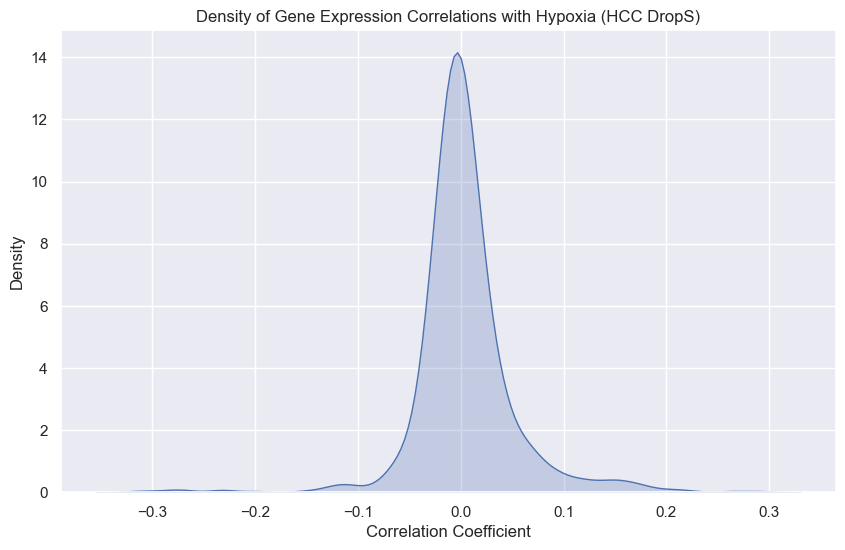

In [220]:
# plotting HCC DropS
filtered_correlations_HCC = hypoxia_correlations_HCC_DropS.drop('Hypoxia')

plt.figure(figsize=(10, 6))
sns.kdeplot(filtered_correlations_HCC, fill=True)
plt.title('Density of Gene Expression Correlations with Hypoxia (HCC DropS)')
plt.xlabel('Correlation Coefficient')
plt.ylabel('Density')
plt.grid(True)
plt.show()

Given the Hypoxia-Feature correlation results for both datasets, we decide to proceed with a feature selection based on this coefficient, by setting a threshold of 0.05 (we want to eliminate the insignificant genes but we are careful to not overdo it).

**Feature Selection**

In [221]:
threshold_DropS = 0.025 # chose this based on the fact that we want to perform the feature selection careful not to drop anything important

# filter genes based on the threshold 
significant_genes_MCF_DropS = hypoxia_correlations_MCF_DropS[abs(hypoxia_correlations_MCF_DropS) > threshold_DropS]
significant_genes_HCC_DropS = hypoxia_correlations_HCC_DropS[abs(hypoxia_correlations_HCC_DropS) > threshold_DropS]

# common genes with significant correlation in both datasets
common_significant_genes_DropS = significant_genes_MCF_DropS.index.intersection(significant_genes_HCC_DropS.index)

# filter the original dataframes to include only these genes
df_MCF_DropS_significant = df_MCF_DropS_common[common_significant_genes_DropS].copy()
df_HCC_DropS_significant = df_HCC_DropS_common[common_significant_genes_DropS].copy()

# include 'Hypoxia' (if it was dropped)
df_MCF_DropS_significant.loc[:, 'Hypoxia'] = df_MCF_DropS_common['Hypoxia']
df_HCC_DropS_significant.loc[:, 'Hypoxia'] = df_HCC_DropS_common['Hypoxia']

print("Filtered DataFrames with significant genes:")
#print(df_MCF_DropS_significant.head())
print(df_MCF_DropS_significant.shape)
#print(df_HCC_DropS_significant.head())
print(df_HCC_DropS_significant.shape)


Filtered DataFrames with significant genes:
(6000, 194)
(6000, 194)


In [222]:
df_HCC_DropS_significant

,Hypoxia,"""MALAT1""","""MT-RNR2""","""NEAT1""","""H1-5""","""MT-RNR1""","""H4C3""","""MT-CO3""","""MT-CYB""","""H1-3""",...,"""HSPD1""","""RPLP1""","""ESRP2""","""PCDHGA10""","""MAP7""","""UBE2Q2""","""RP9""","""SERF2""","""DGKZ""","""ZBTB2"""
index,,,,,,,,,,,,,,,,,,,,,
"""CTGTTCCAGCCC_Normoxia""",0,0,0,0,0,0,0,0,0,0,...,0,3,0,0,0,0,0,0,0,0
"""CCTACGTCCCTG_Normoxia""",0,0,0,0,0,1,1,0,0,0,...,1,1,0,0,0,0,0,2,0,0
"""GGGCTGCTTGAG_Normoxia""",0,0,3,0,0,1,2,0,0,1,...,1,0,0,0,0,0,0,1,0,0
"""AACGCCGCGGGT_Normoxia""",0,3,0,0,0,0,2,1,0,0,...,3,0,0,0,0,0,0,0,0,0
"""ACCACATGATTT_Normoxia""",0,0,0,2,1,0,5,0,0,2,...,0,0,0,0,0,0,0,3,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"""GTCTCCCGGTCA_Hypoxia""",1,0,2,0,0,1,2,0,0,1,...,0,1,0,0,0,0,0,0,0,0
"""AACCCCGAGCGG_Hypoxia""",1,2,0,0,1,0,0,0,0,0,...,3,0,0,0,0,0,0,0,0,1
"""TTATCTCCGGTC_Hypoxia""",1,0,2,0,0,0,2,0,0,0,...,0,0,0,0,0,0,0,0,0,0


**Plotting Distributions**

In [223]:
# Combine all datasets into one DataFrame with a label for each
datasets = {
    'MCF DropS': df_MCF_DropS_significant,
    'HCC DropS': df_HCC_DropS_significant
}
combined_data = pd.DataFrame()

for label, df in datasets.items():
    filtered_df = df[df['Hypoxia'] == 1].copy()  # Adding .copy() to avoid SettingWithCopyWarning
    filtered_df['Dataset'] = label
    combined_data = pd.concat([combined_data, filtered_df], ignore_index=True)

# melting the DataFrame to have 'Gene' and 'Expression' columns
melted_data = combined_data.melt(id_vars='Dataset', var_name='Gene', value_name='Expression')


     Dataset     Gene  Expression
0  MCF DropS  Hypoxia           1
1  MCF DropS  Hypoxia           1
2  MCF DropS  Hypoxia           1
3  MCF DropS  Hypoxia           1
4  MCF DropS  Hypoxia           1


/Users/emmamora/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/emmamora/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


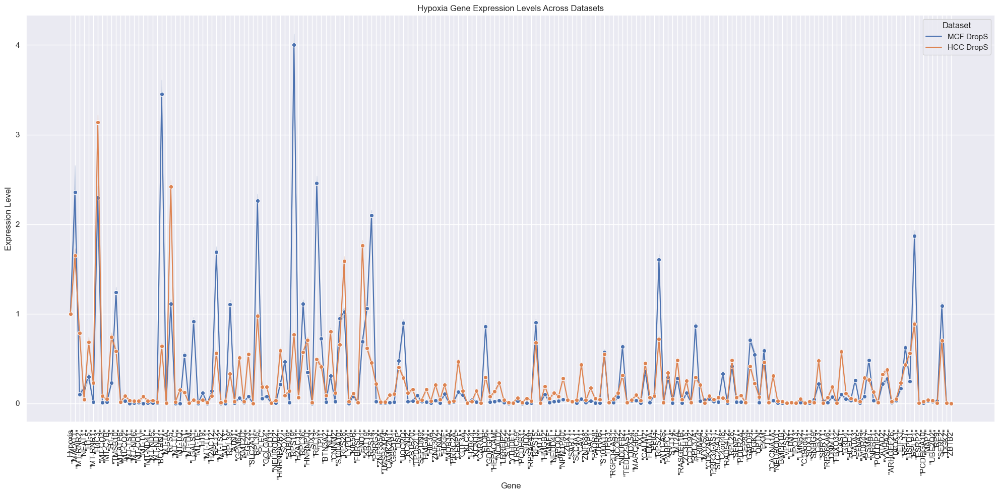

In [224]:
import seaborn as sns
import matplotlib.pyplot as plt

# Ensure the melting was successful
print(melted_data.head())

plt.figure(figsize=(20, 10))
sns.lineplot(data=melted_data, x='Gene', y='Expression', hue='Dataset', marker='o')
plt.xticks(rotation=90)  # Rotate gene names for better readability
plt.title('Hypoxia Gene Expression Levels Across Datasets')
plt.ylabel('Expression Level')
plt.xlabel('Gene')
plt.legend(title='Dataset')
plt.grid(True)
plt.tight_layout()  # Adjust layout to prevent clipping of tick-labels
plt.show()


Given this density plot, we can observe that the distribution of the gene expressions is consistent throughout the 2 datasets (peaks align), therefore we decide not to apply a scaler.

<Figure size 2000x5000 with 0 Axes>

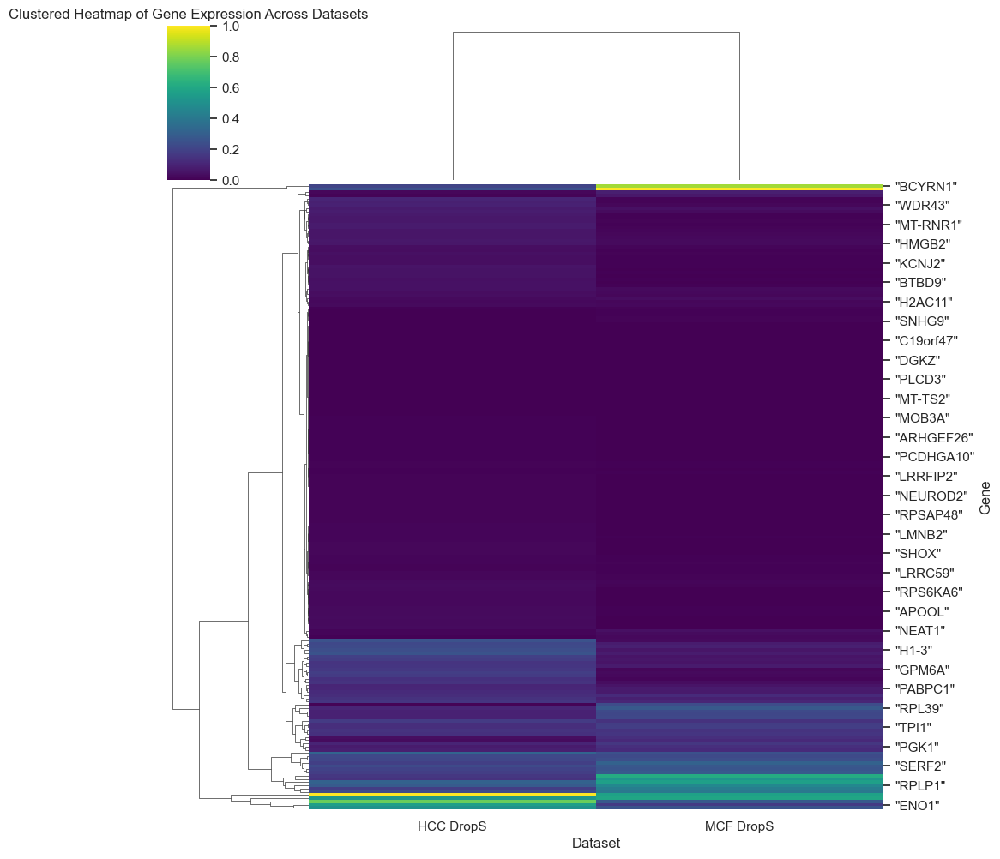

In [225]:
# pivot the data for heatmap
heatmap_data = melted_data.pivot_table(index='Gene', columns='Dataset', values='Expression', aggfunc='mean')

# clustered heatmap
plt.figure(figsize=(20, 50))
sns.clustermap(heatmap_data, method='average', metric='euclidean', cmap='viridis', standard_scale=1)
plt.title('Clustered Heatmap of Gene Expression Across Datasets')
plt.show()


##### General Sampled DropS Dataframe

In [226]:
# columns = df_MCF_SmartS_common.columns.drop('Hypoxia')  # features only
column = common_significant_genes_DropS

# Create DataFrames with the index and exclude the 'Hypoxia' column for now
df_X_MCF_DropS = pd.DataFrame(df_MCF_DropS_significant, columns=df_MCF_DropS_significant.columns.drop('Hypoxia'), index=df_MCF_DropS_common.index)
df_X_HCC_DropS = pd.DataFrame(df_HCC_DropS_significant, columns=df_HCC_DropS_significant.columns.drop('Hypoxia'), index=df_HCC_DropS_common.index)

# Insert the 'Hypoxia' column at the beginning of each DataFrame
df_X_MCF_DropS.insert(0, 'Hypoxia', df_MCF_DropS_sampled['Hypoxia'])
df_X_HCC_DropS.insert(0, 'Hypoxia', df_HCC_DropS_sampled['Hypoxia'])
# merge all datasets
df_general_sampled_filtered_DropS = pd.concat([df_X_MCF_DropS,df_X_HCC_DropS], ignore_index=False)


In [227]:
df_MCF_DropS_significant['Hypoxia'].value_counts()

Hypoxia
0    3525
1    2475
Name: count, dtype: int64

In [228]:
df_HCC_DropS_significant['Hypoxia'].value_counts()

Hypoxia
1    3637
0    2363
Name: count, dtype: int64

In [229]:
df_general_sampled_filtered_DropS['Hypoxia'].value_counts()
# debaity plot

Hypoxia
1    6112
0    5888
Name: count, dtype: int64

##### Model Development on Sampled Filtered Data 

We follow the pipeline from "Model Development - Random Forest on Full Data" and "Model Development - Neural Network on Full Data" in creating a RandF and NN for the Sampled Filtered Data. Due to the already large size of the notebook, we decide to not include the full code, just the results. They are slightly worse than the ones on the Full Data, indicating that even though the feature selection was successful, the Full Data better captures all relationships between features.


**Random Forest on Sampled Filtered Data**

**Model:**
- RandomForestClassifier(max_features='log2', min_samples_leaf=1, min_samples_split=2, n_estimators=300, random_state=42, max_depth=None)

**Results from training:**
- Confusion matrix RandF on sampled data: [[1062, 115],[ 127, 1096]]
- Accuracy: 0.90
- Feature Importances RandF Sampled (first 10): 

       - "BCYRN1": 0.065660
       - "TMSB10": 0.052990
       - "PGK1": 0.043165
       - "KRT19": 0.040318
       - "ENO1": 0.038123
       - "RPS5": 0.032844
       - "MALAT1": 0.032110
       - "GAPDH": 0.027227
       - "MT-RNR2": 0.024864
       - "LGALS1": 0.020423

**Results from nested cross-validation:**
- Cross-validation scores: [0.93527954 0.92701735 0.92756816 0.93430657 0.92728274]
- Mean CV accuracy: 0.93
- Standard deviation in CV scores: 0.00
- Feature Importances RandF Sampled (first 10):

       - "BCYRN1": 0.028051
       - "KRT19": 0.026539
       - "TMSB10": 0.024974
       - "ENO1": 0.022582
       - "GAPDH":0.021763
       - "PGK1": 0.021488
       - "MT-RNR2": 0.020802
       - "FTL": 0.019809
       - "RPS5": 0.019049
       - "MALAT1": 0.015680



**Neural Network on Sampled Filtered Data**

- **Model:** model_NN_DropS = Sequential([
       
       - Dense(128, activation='relu', input_dim=X_DropS_train.shape[1], kernel_regularizer=l2(0.01)),
       - Dropout(0.4),  
       - Dense(64, activation='relu', kernel_regularizer=l2(0.01)), 
       - Dropout(0.2),  
       - Dense(1, activation='sigmoid') ])
- **Accuracy:** 0.9079166650772095

- **Training process:**

![alt text](image.png)


### 6.5.2 General Model on Full Data - EXTRA

#### Data Integration and Feature Standardisation

##### Balanced Sampling

In [56]:
# checking if datasets are unbalanced wrt Hypoxia and Normoxia

## MCF SmartS - BALANCED
print('Shape of MCF SmartS:')
print(df_MCF_SmartS_filtered_normalised.shape)
print('Hypoxia Columns of MCF SmartS:')
print(df_MCF_SmartS_filtered_normalised['Hypoxia'].values.sum())
balanced_MCF_SmartS = df_MCF_SmartS_filtered_normalised.shape[0] / df_MCF_SmartS_filtered_normalised['Hypoxia'].values.sum()
print('MCF SmartS general/hypo balance:')
print(balanced_MCF_SmartS)

## HCC SmartS - BALANCED
print('Shape of HCC SmartS:')
print(df_HCC_SmartS_filtered_normalised.shape)
print('Hypoxia Columns of HCC SmartS:')
print(df_HCC_SmartS_filtered_normalised['Hypoxia'].values.sum())
balanced_HCC_SmartS = df_HCC_SmartS_filtered_normalised.shape[0] / df_HCC_SmartS_filtered_normalised['Hypoxia'].values.sum()
print('HCC SmartS general/hypo balance:')
print(balanced_HCC_SmartS)

## MCF DropS - BALANCED
print('Shape of MCF DropS:')
print(df_MCF_DropS.shape)
print('Hypoxia Columns of MCF DropS:')
print(df_MCF_DropS['Hypoxia'].values.sum())
balanced_MCF_DropS = df_MCF_DropS.shape[0] / df_MCF_DropS['Hypoxia'].values.sum()
print('MCF DropS  general/hypo balance:')
print(balanced_MCF_DropS)

## HCC DropS - BALANCED
print('Shape of HCC DropS:')
print(df_HCC_DropS.shape)
print('Hypoxia Columns of HCC DropS:')
print(df_HCC_DropS['Hypoxia'].values.sum())
balanced_HCC_DropS = df_HCC_DropS.shape[0] / df_HCC_DropS['Hypoxia'].values.sum()
print('HCC DropS  general/hypo balance:')
print(balanced_HCC_DropS)



Shape of MCF SmartS:
(250, 3001)
Hypoxia Columns of MCF SmartS:
124
MCF SmartS general/hypo balance:
2.0161290322580645
Shape of HCC SmartS:
(182, 3001)
Hypoxia Columns of HCC SmartS:
97
HCC SmartS general/hypo balance:
1.8762886597938144
Shape of MCF DropS:
(21626, 3001)
Hypoxia Columns of MCF DropS:
8921
MCF DropS  general/hypo balance:
2.4241676942046855
Shape of HCC DropS:
(14682, 3001)
Hypoxia Columns of HCC DropS:
8899
HCC DropS  general/hypo balance:
1.6498482975615238


##### Create New Datasets with Common Features

In [57]:
df_MCF_SmartS_common = df_MCF_SmartS_filtered_normalised[['Hypoxia'] + list(genes_common)]
df_HCC_SmartS_common = df_HCC_SmartS_filtered_normalised[['Hypoxia'] + list(genes_common)]
df_MCF_DropS_common = df_MCF_DropS[['Hypoxia'] + list(genes_common)]
df_HCC_DropS_common = df_HCC_DropS[['Hypoxia'] + list(genes_common)]

# create common df for SmartS and DropS
# df_SmartS_common = pd.concat([df_MCF_SmartS_common, df_HCC_SmartS_common], ignore_index=True)
# df_DropS_common = pd.concat([df_MCF_DropS_common, df_HCC_DropS_common], ignore_index=True)

# index preservation (used later before merging)
index_MCF_DropS = df_MCF_DropS_common.index
index_HCC_DropS = df_HCC_DropS_common.index
index_MCF_SmartS = df_MCF_SmartS_common.index
index_HCC_SmartS = df_HCC_SmartS_common.index
# index_SmartS = index_MCF_SmartS.append(index_HCC_SmartS)
# index_DropS = index_MCF_DropS.append(index_HCC_DropS)

##### Scaling the Features

In [58]:
from sklearn.preprocessing import StandardScaler
# since DropS and SmartS have very different outputs (they represent 2 different technologies, SmartS>100, DropS<100)
# use same scale
scaler_SmartS = StandardScaler()
scaler_DropS = StandardScaler()

# scale each df with it's scaler => fit the one with larger data
X_MCF_SmartS_scaled = scaler_SmartS.fit_transform(df_MCF_SmartS_common.drop('Hypoxia', axis=1))
X_HCC_SmartS_scaled = scaler_SmartS.transform(df_HCC_SmartS_common.drop('Hypoxia', axis=1))
X_MCF_DropS_scaled = scaler_DropS.fit_transform(df_MCF_DropS_common.drop('Hypoxia', axis=1))
X_HCC_DropS_scaled = scaler_DropS.transform(df_HCC_DropS_common.drop('Hypoxia', axis=1))


##### Merging the Datasets

In [59]:
columns = df_MCF_SmartS_common.columns.drop('Hypoxia')  # features only

# Create DataFrames with the index and exclude the 'Hypoxia' column for now
df_X_MCF_SmartS = pd.DataFrame(X_MCF_SmartS_scaled, columns=columns, index=index_MCF_SmartS)
df_X_HCC_SmartS = pd.DataFrame(X_HCC_SmartS_scaled, columns=columns, index=index_HCC_SmartS)
df_X_MCF_DropS = pd.DataFrame(X_MCF_DropS_scaled, columns=columns, index=index_MCF_DropS)
df_X_HCC_DropS = pd.DataFrame(X_HCC_DropS_scaled, columns=columns, index=index_HCC_DropS)

# Insert the 'Hypoxia' column at the beginning of each DataFrame
df_X_MCF_SmartS.insert(0, 'Hypoxia', df_MCF_SmartS_common['Hypoxia'])
df_X_HCC_SmartS.insert(0, 'Hypoxia', df_HCC_SmartS_common['Hypoxia'])
df_X_MCF_DropS.insert(0, 'Hypoxia', df_MCF_DropS_common['Hypoxia'])
df_X_HCC_DropS.insert(0, 'Hypoxia', df_HCC_DropS_common['Hypoxia'])
# merge all datasets
df_general = pd.concat([df_X_MCF_SmartS,df_X_HCC_SmartS,df_X_MCF_DropS,df_X_HCC_DropS])

In [60]:
df_general

,Hypoxia,"""TPX2""","""DKK1""","""PADI2""","""TOP2A""","""MT-CYB""","""S100P""","""MKI67""","""KRT17""","""E2F1""",...,"""FBXO32""","""SESN2""","""MT-ND4""","""SYNM""","""TCHH""","""MT-RNR1""","""MICAL2""","""S100A2""","""RTL6""","""FZD1"""
"""output.STAR.2_B3_Norm_S57_Aligned.sortedByCoord.out.bam""",0,-0.240620,-0.318515,-0.229869,-0.401603,0.096572,-0.410616,0.510799,-0.126603,-0.169256,...,-0.536550,2.159032,-0.434873,-0.296002,-0.356812,0.041834,-0.440023,-0.107584,-0.704591,-0.715966
"""output.STAR.2_B4_Norm_S58_Aligned.sortedByCoord.out.bam""",0,-0.216703,0.729391,-0.081500,-0.314502,0.841784,-0.410616,0.014294,-0.126603,3.423441,...,-0.536550,-0.318901,0.002330,-0.296002,-0.356812,-0.302837,-0.440023,-0.107584,-0.704591,0.097534
"""output.STAR.2_B5_Norm_S59_Aligned.sortedByCoord.out.bam""",0,0.231747,-0.254521,-0.233319,0.418987,0.747239,-0.410616,1.552761,-0.126603,3.894279,...,-0.536550,0.433108,0.261262,-0.296002,-0.356812,-0.228497,-0.440023,-0.107584,-0.704591,-0.009505
"""output.STAR.2_B6_Norm_S60_Aligned.sortedByCoord.out.bam""",0,0.001543,1.561316,-0.022842,-0.094455,1.061235,-0.400066,-0.118574,-0.126603,0.209461,...,-0.424520,-0.713398,0.318288,-0.296002,0.213175,-0.059540,1.034586,-0.107584,-0.230740,-0.095137
"""output.STAR.2_B7_Hypo_S79_Aligned.sortedByCoord.out.bam""",1,-0.497731,-0.292518,-0.233319,-0.438278,-0.891150,0.011373,-0.580114,-0.126603,-0.547973,...,-0.536550,2.676809,0.170841,-0.296002,-0.356812,-0.917839,-0.440023,-0.107584,1.539964,-0.715966
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"""TTTTTACCAATC_Hypoxia""",1,-0.306318,-0.060120,-0.047202,-0.358026,-0.287128,-0.242891,-0.419871,-0.068345,-0.056816,...,-0.049288,-0.054626,-0.356358,-0.031049,-0.072857,-0.393389,-0.053116,-0.035356,-0.045978,-0.040955
"""TTTTTCCGTGCA_Hypoxia""",1,2.302752,-0.060120,-0.047202,4.168526,-0.287128,-0.242891,1.432838,-0.068345,-0.056816,...,-0.049288,-0.054626,-0.356358,-0.031049,-0.072857,-0.393389,-0.053116,-0.035356,-0.045978,-0.040955
"""TTTTTGCCTGGG_Hypoxia""",1,-0.306318,-0.060120,-0.047202,-0.358026,-0.287128,-0.242891,5.138256,-0.068345,-0.056816,...,-0.049288,-0.054626,-0.356358,-0.031049,-0.072857,5.007292,-0.053116,21.203873,-0.045978,-0.040955
"""TTTTTGTAACAG_Hypoxia""",1,-0.306318,-0.060120,-0.047202,1.905250,-0.287128,-0.242891,-0.419871,-0.068345,-0.056816,...,-0.049288,-0.054626,-0.356358,-0.031049,-0.072857,-0.393389,-0.053116,-0.035356,-0.045978,-0.040955


#### Model Development - Full Dataset

##### Model Training

In [61]:
# separate features and target
X_general = df_general.drop('Hypoxia', axis=1)  
y_general = df_general['Hypoxia']  

# split the data - 80% for training and 20% for testing
X_general_train, X_general_test, y_general_train, y_general_test = train_test_split(X_general, y_general, test_size=0.2, random_state=42)

##### Linear Support Vector Machine

In [62]:
# model training
model_LinSVM_general = LinearSVC(random_state=42, max_iter=25000)
model_LinSVM_general.fit(X_general_train, y_general_train)

# model evaluation
y_general_pred = model_LinSVM_general.predict(X_general_test)
print('Confusion matrix LinSVM on all data:')
print(confusion_matrix(y_general_test, y_general_pred))
print('Classification report LinSVM on all data:')
print(classification_report(y_general_test, y_general_pred))

# saving results
# results_general_dict['LinSVM'] = {
#     'conf_matrix': confusion_matrix(y_general_test, y_general_pred),
#     'class_report': classification_report(y_general_test, y_general_pred, output_dict=True)
# }

Confusion matrix LinSVM on all data:
[[3104  598]
 [ 822 2824]]
Classification report LinSVM on all data:
              precision    recall  f1-score   support

           0       0.79      0.84      0.81      3702
           1       0.83      0.77      0.80      3646

    accuracy                           0.81      7348
   macro avg       0.81      0.81      0.81      7348
weighted avg       0.81      0.81      0.81      7348



/Users/emmamora/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


##### Support Vector Machine with RBF Kernel

In [63]:
# model training
model_RbfSVM_general = SVC(kernel='rbf', random_state=42)
model_RbfSVM_general.fit(X_general_train, y_general_train)

# model evaluation
y_general_pred = model_RbfSVM_general.predict(X_general_test)
print('Confusion matrix RbfSVM on all data:')
print(confusion_matrix(y_general_test, y_general_pred))
print('Classification report RbfSVM on all data:')
print(classification_report(y_general_test, y_general_pred))

# saving results
# results_general_dict['RbfSVM'] = {
#     'conf_matrix': confusion_matrix(y_general_test, y_general_pred),
#     'class_report': classification_report(y_general_test, y_general_pred, output_dict=True)
# }

Confusion matrix RbfSVM on all data:
[[3111  591]
 [ 713 2933]]
Classification report RbfSVM on all data:
              precision    recall  f1-score   support

           0       0.81      0.84      0.83      3702
           1       0.83      0.80      0.82      3646

    accuracy                           0.82      7348
   macro avg       0.82      0.82      0.82      7348
weighted avg       0.82      0.82      0.82      7348



##### Random Forest

In [64]:
# model training
model_RandF_general = RandomForestClassifier(n_estimators=100, random_state=42)
model_RandF_general.fit(X_general_train, y_general_train)

# model evaluation
y_general_pred = model_RandF_general.predict(X_general_test)
print('Confusion matrix RandF on all data:')
print(confusion_matrix(y_general_test, y_general_pred))
print('Classification report RandF on all data:')
print(classification_report(y_general_test, y_general_pred))

# saving results
# results_general_dict['RandF'] = {
#     'conf_matrix': confusion_matrix(y_general_test, y_general_pred),
#     'class_report': classification_report(y_general_test, y_general_pred, output_dict=True)
# }

Confusion matrix RandF on all data:
[[3166  536]
 [ 666 2980]]
Classification report RandF on all data:
              precision    recall  f1-score   support

           0       0.83      0.86      0.84      3702
           1       0.85      0.82      0.83      3646

    accuracy                           0.84      7348
   macro avg       0.84      0.84      0.84      7348
weighted avg       0.84      0.84      0.84      7348



##### Cross Validation and Model Comparison

In [65]:
# cross-validation for each model
cv_score_LinSVM_general_full = cross_val_score(model_LinSVM_general, X_general, y_general, cv=5)
cv_score_RbfSVM_general_full = cross_val_score(model_RbfSVM_general, X_general, y_general, cv=5)
cv_score_RandF_general_full = cross_val_score(model_RandF_general, X_general, y_general, cv=5)

print('Average CV Score LinSVM:', np.mean(cv_score_LinSVM_general_full))
print('Average CV Score RbfSVM:', np.mean(cv_score_RbfSVM_general_full))
print('Average CV Score RandF:', np.mean(cv_score_RandF_general_full))

/Users/emmamora/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/Users/emmamora/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/Users/emmamora/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/Users/emmamora/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/Users/emmamora/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Average CV Score LinSVM: 0.7908274360370168
Average CV Score RbfSVM: 0.8057974959172564
Average CV Score RandF: 0.8191072400653239


Given these cross validation scores, we can conclude that more complex and non-linear models are better suited for the general data. We deduce that the relationships within the data are ot simply linear. We will try to further improve RbfSVM and RandF using GridSearchCV. However, due to the size of the dataset, it is computationally challenging so we will perform GridSearch on the Sampled Dataset (6.5.3).

##### Randomised Search

In [ ]:
# parameter grid for RandF
param_distributions_RandF = {
    'n_estimators': randint(100, 300),  # number of trees
    'max_depth': [None, 10, 20, 30, 40, 50], # number of features to consider at every split
    'min_samples_split': randint(2, 20), # maximum number of levels in tree
    'min_samples_leaf': randint(1, 10), # minimum number of samples required to split a node
    'max_features': ['auto', 'sqrt', 'log2'] # minimum number of samples required at each leaf node
}

# set up RandomisedSearchCV
randomised_search_RandF = RandomizedSearchCV(RandomForestClassifier(random_state=42), param_distributions_RandF, n_iter=100, cv=3, verbose=2, random_state=42, n_jobs=-1)
randomised_search_RandF.fit(X_general_train, y_general_train)

# best parameters and score 
print("Best parameters for RandF:", randomised_search_RandF.best_params_)
print("Best cross-validated accuracy for RandF:", randomised_search_RandF.best_score_)

# we choose to clear the results of this part out as it occupies too much space in the final html file

In [67]:
# best parameters and score for RBF SVM
print("Best parameters for RandF:", randomised_search_RandF.best_params_)
print("Best cross-validated accuracy for RandF:", randomised_search_RandF.best_score_)

Best parameters for RandF: {'max_depth': 30, 'max_features': 'log2', 'min_samples_leaf': 1, 'min_samples_split': 9, 'n_estimators': 263}
Best cross-validated accuracy for RandF: 0.8444133991747796


##### Nested CV on RandF

In [68]:
# define the model
model_RandF_general = RandomForestClassifier(n_estimators=263, random_state=42, min_samples_leaf=1, min_samples_split=9, max_features='log2', max_depth=30)

# nested cross validation
inner_cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
outer_cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# create feature set and target set
X_general = df_general.drop(['Hypoxia'], axis=1)
y_general = df_general['Hypoxia']

# we'll use the full features X_general_sampled and target y_general_sampled (no splitting into test and train)
cv_nested_score_RandF_general = cross_val_score(model_RandF_general, X_general, y_general, cv=outer_cv, scoring='accuracy')

print("Cross-validation scores:\n", cv_nested_score_RandF_general)
print("Mean CV accuracy: {:.2f}".format(np.mean(cv_nested_score_RandF_general)))
print("Standard deviation in CV scores: {:.2f}".format(np.std(cv_nested_score_RandF_general)))

# model training 
## we train the model on the COMPLETE DATA
model_RandF_general.fit(X_general, y_general)

# feature importances
feature_importances_RandF_general = model_RandF_general.feature_importances_
## we'll create a df so it's easily stored
features_df_RandF_general = pd.DataFrame({
    'Feature': X_general.columns,
    'Importance': feature_importances_RandF_general
})
features_df_RandF_general = features_df_RandF_general.sort_values(by='Importance', ascending=False)
print("Feature Importances RandF General (first 10):\n")
print(features_df_RandF_general.head(10))

Cross-validation scores:
 [0.84784976 0.84335874 0.84322265 0.84267828 0.85125204]
Mean CV accuracy: 0.85
Standard deviation in CV scores: 0.00
Feature Importances RandF General (first 10):

      Feature  Importance
19   "TMSB10"    0.113766
15     "PGK1"    0.086004
39      "FTL"    0.082708
43  "MT-RNR2"    0.070720
35   "MALAT1"    0.064436
31   "LGALS1"    0.050915
11     "H4C3"    0.045222
65  "MT-RNR1"    0.038859
34   "AKR1C2"    0.030510
13     "CAV1"    0.024514


#### Model Development - Neural Network on Full Dataset

In [240]:
df_general

,Hypoxia,"""TPX2""","""DKK1""","""PADI2""","""TOP2A""","""MT-CYB""","""S100P""","""MKI67""","""KRT17""","""E2F1""",...,"""FBXO32""","""SESN2""","""MT-ND4""","""SYNM""","""TCHH""","""MT-RNR1""","""MICAL2""","""S100A2""","""RTL6""","""FZD1"""
output.STAR.2_B3_Norm_S57_Aligned.sortedByCoord.out.bam,0,-0.240620,-0.318515,-0.229869,-0.401603,0.096572,-0.410616,0.510799,-0.126603,-0.169256,...,-0.536550,2.159032,-0.434873,-0.296002,-0.356812,0.041834,-0.440023,-0.107584,-0.704591,-0.715966
output.STAR.2_B4_Norm_S58_Aligned.sortedByCoord.out.bam,0,-0.216703,0.729391,-0.081500,-0.314502,0.841784,-0.410616,0.014294,-0.126603,3.423441,...,-0.536550,-0.318901,0.002330,-0.296002,-0.356812,-0.302837,-0.440023,-0.107584,-0.704591,0.097534
output.STAR.2_B5_Norm_S59_Aligned.sortedByCoord.out.bam,0,0.231747,-0.254521,-0.233319,0.418987,0.747239,-0.410616,1.552761,-0.126603,3.894279,...,-0.536550,0.433108,0.261262,-0.296002,-0.356812,-0.228497,-0.440023,-0.107584,-0.704591,-0.009505
output.STAR.2_B6_Norm_S60_Aligned.sortedByCoord.out.bam,0,0.001543,1.561316,-0.022842,-0.094455,1.061235,-0.400066,-0.118574,-0.126603,0.209461,...,-0.424520,-0.713398,0.318288,-0.296002,0.213175,-0.059540,1.034586,-0.107584,-0.230740,-0.095137
output.STAR.2_B7_Hypo_S79_Aligned.sortedByCoord.out.bam,1,-0.497731,-0.292518,-0.233319,-0.438278,-0.891150,0.011373,-0.580114,-0.126603,-0.547973,...,-0.536550,2.676809,0.170841,-0.296002,-0.356812,-0.917839,-0.440023,-0.107584,1.539964,-0.715966
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"""TTTTTACCAATC_Hypoxia""",1,-0.306318,-0.060120,-0.047202,-0.358026,-0.287128,-0.242891,-0.419871,-0.068345,-0.056816,...,-0.049288,-0.054626,-0.356358,-0.031049,-0.072857,-0.393389,-0.053116,-0.035356,-0.045978,-0.040955
"""TTTTTCCGTGCA_Hypoxia""",1,2.302752,-0.060120,-0.047202,4.168526,-0.287128,-0.242891,1.432838,-0.068345,-0.056816,...,-0.049288,-0.054626,-0.356358,-0.031049,-0.072857,-0.393389,-0.053116,-0.035356,-0.045978,-0.040955
"""TTTTTGCCTGGG_Hypoxia""",1,-0.306318,-0.060120,-0.047202,-0.358026,-0.287128,-0.242891,5.138256,-0.068345,-0.056816,...,-0.049288,-0.054626,-0.356358,-0.031049,-0.072857,5.007292,-0.053116,21.203873,-0.045978,-0.040955
"""TTTTTGTAACAG_Hypoxia""",1,-0.306318,-0.060120,-0.047202,1.905250,-0.287128,-0.242891,-0.419871,-0.068345,-0.056816,...,-0.049288,-0.054626,-0.356358,-0.031049,-0.072857,-0.393389,-0.053116,-0.035356,-0.045978,-0.040955


##### Creating the NN

In [ ]:
# epochs = 40, DropOut = 0.5 and 0.5, learning rate = 0.0005, regularization = 0.1 both : 0.82525 acc
# epochs = 40, DropOut = 0.4 and 0.4, learning rate = 0.0005, regularization = 0.1 both : 0.8244 acc
# epochs = 40, DropOut = 0.4 and 0.4, learning rate = 0.001, regularization = 0.1 both : 0.8264 acc
# epochs = 40, DropOut = 0.4 and 0.4, learning rate = 0.0001, regularization = 0.1 both : 0.8266 acc
# epochs = 40, DropOut = 0.3 and 0.3, learning rate = 0.0001, regularization = 0.1 both : 0.8258 acc
# epochs = 40, DropOut = 0.2 and 0.2, learning rate = 0.0001, regularization = 0.1 both : 0.8278 acc

In [69]:
# separate features and targets 
## using .values to transform the df into an np array because tensorflow works with np arrays
X_general = df_general.drop('Hypoxia', axis=1).values
y_general = df_general['Hypoxia'].values

# split the data - 80% for training and 20% for testing
X_general_train, X_general_test, y_general_train, y_general_test = train_test_split(X_general, y_general, test_size=0.2, random_state=42)

# defining the model
model_NN_general = Sequential([
    Dense(128, activation='relu', input_dim=X_general_train.shape[1], kernel_regularizer=l2(0.01)),
    Dropout(0.2),  # dropout for regularization
    Dense(64, activation='relu', kernel_regularizer=l2(0.01)), 
    Dropout(0.2),  # dropout for regularization
    Dense(1, activation='sigmoid')  # output layer for binary classification
])

# compiling the model
model_NN_general.compile(optimizer=Adam(learning_rate=0.0001), loss='binary_crossentropy', metrics=['accuracy'])

# early stopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

# training the model with early stopping
history = model_NN_general.fit(X_general_train, y_general_train, validation_split=0.2, epochs=40, batch_size=64, verbose=2, callbacks=[early_stopping])

# model evaluation 
test_loss_general, test_accuracy_general = model_NN_general.evaluate(X_general_test, y_general_test, verbose=2)
print(f"Test Loss: {test_loss_general}, Test Accuracy: {test_accuracy_general}")

/Users/emmamora/anaconda3/lib/python3.11/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/40
368/368 - 3s - 9ms/step - accuracy: 0.6442 - loss: 2.2824 - val_accuracy: 0.7586 - val_loss: 1.9573
Epoch 2/40
368/368 - 0s - 851us/step - accuracy: 0.7498 - loss: 1.8396 - val_accuracy: 0.7898 - val_loss: 1.6261
Epoch 3/40
368/368 - 0s - 845us/step - accuracy: 0.7809 - loss: 1.5385 - val_accuracy: 0.7995 - val_loss: 1.3849
Epoch 4/40
368/368 - 0s - 838us/step - accuracy: 0.7918 - loss: 1.3289 - val_accuracy: 0.8063 - val_loss: 1.2107
Epoch 5/40
368/368 - 0s - 841us/step - accuracy: 0.7975 - loss: 1.1680 - val_accuracy: 0.8088 - val_loss: 1.0752
Epoch 6/40
368/368 - 0s - 838us/step - accuracy: 0.8037 - loss: 1.0376 - val_accuracy: 0.8092 - val_loss: 0.9752
Epoch 7/40
368/368 - 0s - 846us/step - accuracy: 0.8066 - loss: 0.9427 - val_accuracy: 0.8100 - val_loss: 0.8912
Epoch 8/40
368/368 - 0s - 835us/step - accuracy: 0.8076 - loss: 0.8700 - val_accuracy: 0.8100 - val_loss: 0.8249
Epoch 9/40
368/368 - 0s - 840us/step - accuracy: 0.8078 - loss: 0.8069 - val_accuracy: 0.8114 - va

In [70]:
# get the predicted probabilities for the test set
y_general_pred_probs = model_NN_general.predict(X_general_test)

# convert probabilities to predicted labels
y_general_pred = (y_general_pred_probs > 0.5).astype("int32")
y_general_pred_probs

143/230 ━━━━━━━━━━━━━━━━━━━━ 0s 353us/step

230/230 ━━━━━━━━━━━━━━━━━━━━ 0s 678us/step


array([[0.60286415],
       [0.06144164],
       [0.9767332 ],
       ...,
       [0.8224749 ],
       [0.99654776],
       [0.9913056 ]], dtype=float32)

##### Visualising the Training Process

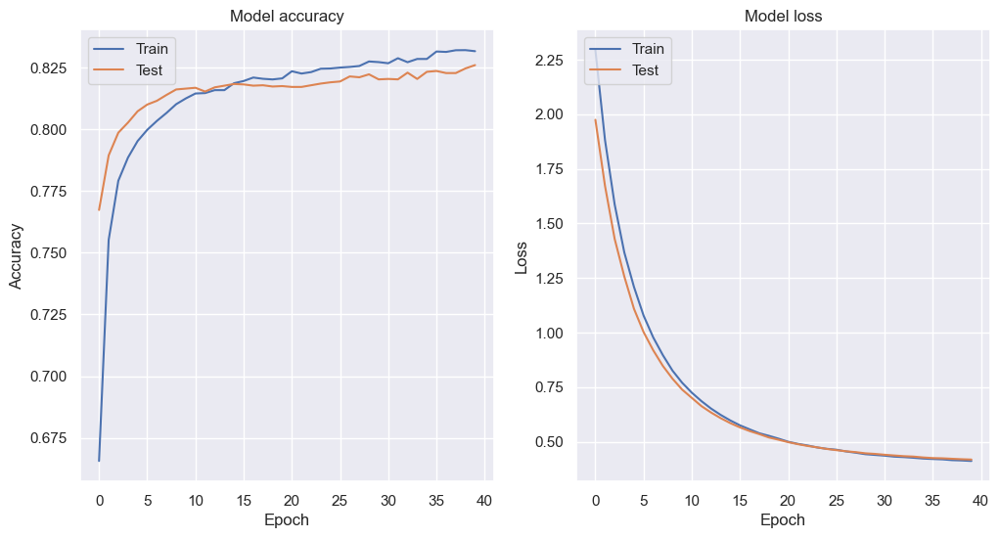

In [243]:
# plotting the training history to visualize the training process
plt.figure(figsize=(12, 6))

# plot training & validation accuracy values
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

# plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

#save_fig("training_process_NN_plot_MCF_DropS")
plt.show()

##### Visualising the Confusion Matrix

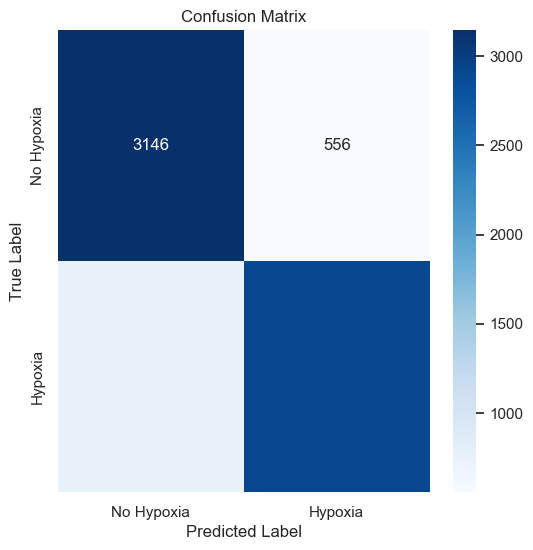

In [244]:
# confusion matrix
cm_HCC_DropS = confusion_matrix(y_general_test, y_general_pred)

plt.figure(figsize=(6,6))
sns.heatmap(cm_HCC_DropS, annot=True, fmt='d', cmap='Blues', xticklabels=['No Hypoxia', 'Hypoxia'], yticklabels=['No Hypoxia', 'Hypoxia'])
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix')
plt.show()

### 6.5.3. General Model on Sampled Data - EXTRA

#### Data Integration 

In [71]:
# create function to balance classes within each dataset

def stratified_sample(df, target, sample_size):
    return df.groupby(target, group_keys=False).apply(lambda x: x.sample(int(np.rint(sample_size * len(x) / len(df))))).reset_index(drop=False)
    #return df.groupby(target, group_keys=False).apply(lambda x: x.sample(min(len(x), sample_size), random_state=42))

df_MCF_SmartS_sampled = stratified_sample(df_MCF_SmartS_filtered_normalised, 'Hypoxia', 100).set_index('index', drop=True)
df_HCC_SmartS_sampled = stratified_sample(df_HCC_SmartS_filtered_normalised, 'Hypoxia', 90).set_index('index', drop=True)
df_MCF_DropS_sampled = stratified_sample(df_MCF_DropS, 'Hypoxia', 5000).set_index('index', drop=True)
df_HCC_DropS_sampled = stratified_sample(df_HCC_DropS, 'Hypoxia', 5000).set_index('index', drop=True)

## target = 'Hypoxia'
## sample_size:
# MCF SmartS: 100-200
# HCC SmartS: 90-150
# MCF DropS: 5000-10000
# HCC DropS: 5000-8000

# The choice of sample_size depends on multiple factors, including the size of your datasets and the requirements of your analysis.
# If you have a very large dataset and computational resources or time are concerns, you might choose a smaller sample size.
# If maintaining a high degree of statistical power is critical, you might opt for a larger sample size.
# The sample size should not exceed the size of your smallest class multiplied by the number of classes if you aim to keep the data balanced without replacement.

In [72]:
def stratified_sample(df, target, sample_size):
    return df.groupby(target, group_keys=False).apply(lambda x: x.sample(int(np.rint(sample_size * len(x) / len(df))))).reset_index(drop=False)
    #return df.groupby(target, group_keys=False).apply(lambda x: x.sample(min(len(x), sample_size), random_state=42))

df_MCF_SmartS_sampled = stratified_sample(df_MCF_SmartS_filtered_normalised, 'Hypoxia', 150).set_index('index', drop=True)
df_HCC_SmartS_sampled = stratified_sample(df_HCC_SmartS_filtered_normalised, 'Hypoxia', 150).set_index('index', drop=True)
df_MCF_DropS_sampled = stratified_sample(df_MCF_DropS, 'Hypoxia', 150).set_index('index', drop=True)
df_HCC_DropS_sampled = stratified_sample(df_HCC_DropS, 'Hypoxia', 150).set_index('index', drop=True)

In [73]:
print(df_MCF_SmartS_sampled.shape)
print(df_MCF_SmartS_sampled.index)

(150, 3001)
Index(['"output.STAR.4_D5_Norm_S167_Aligned.sortedByCoord.out.bam"',
       '"output.STAR.3_C1_Norm_S109_Aligned.sortedByCoord.out.bam"',
       '"output.STAR.2_F6_Norm_S252_Aligned.sortedByCoord.out.bam"',
       '"output.STAR.4_F5_Norm_S263_Aligned.sortedByCoord.out.bam"',
       '"output.STAR.2_B4_Norm_S58_Aligned.sortedByCoord.out.bam"',
       '"output.STAR.2_E5_Norm_S203_Aligned.sortedByCoord.out.bam"',
       '"output.STAR.3_D1_Norm_S157_Aligned.sortedByCoord.out.bam"',
       '"output.STAR.4_F2_Norm_S260_Aligned.sortedByCoord.out.bam"',
       '"output.STAR.4_H4_Norm_S358_Aligned.sortedByCoord.out.bam"',
       '"output.STAR.3_C4_Norm_S112_Aligned.sortedByCoord.out.bam"',
       ...
       '"output.STAR.2_E11_Hypo_S227_Aligned.sortedByCoord.out.bam"',
       '"output.STAR.4_E10_Hypo_S238_Aligned.sortedByCoord.out.bam"',
       '"output.STAR.4_H9_Hypo_S381_Aligned.sortedByCoord.out.bam"',
       '"output.STAR.4_D12_Hypo_S192_Aligned.sortedByCoord.out.bam"',
       '"

In [74]:
df_MCF_SmartS_sampled

,Hypoxia,"""CYP1B1""","""CYP1B1-AS1""","""CYP1A1""","""NDRG1""","""DDIT4""","""PFKFB3""","""HK2""","""AREG""","""MYBL2""",...,"""CD27-AS1""","""DNAI7""","""MAFG""","""LZTR1""","""BCO2""","""GRIK5""","""SLC25A27""","""DENND5A""","""CDK5R1""","""FAM13A-AS1"""
index,,,,,,,,,,,,,,,,,,,,,
"""output.STAR.4_D5_Norm_S167_Aligned.sortedByCoord.out.bam""",0,101,40,0,0,7,189,13,206,742,...,5,0,11,2,0,0,0,18,0,0
"""output.STAR.3_C1_Norm_S109_Aligned.sortedByCoord.out.bam""",0,275,122,0,3,15,0,17,0,1182,...,10,0,54,26,0,0,0,53,0,0
"""output.STAR.2_F6_Norm_S252_Aligned.sortedByCoord.out.bam""",0,94,33,0,0,430,193,3,0,0,...,20,0,19,0,0,0,0,22,0,0
"""output.STAR.4_F5_Norm_S263_Aligned.sortedByCoord.out.bam""",0,307,119,0,0,15,105,99,0,285,...,30,0,0,79,0,0,0,27,0,14
"""output.STAR.2_B4_Norm_S58_Aligned.sortedByCoord.out.bam""",0,131,59,0,1,289,42,0,856,1586,...,0,0,1,25,0,0,0,34,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"""output.STAR.4_A11_Hypo_S47_Aligned.sortedByCoord.out.bam""",1,8685,3363,0,3071,2071,6081,11703,11,0,...,0,0,72,0,0,0,0,165,0,0
"""output.STAR.2_E12_Hypo_S228_Aligned.sortedByCoord.out.bam""",1,44406,17673,8782,1710,5445,7976,985,84,0,...,0,0,59,0,0,0,0,73,0,4
"""output.STAR.3_B7_Hypo_S85_Aligned.sortedByCoord.out.bam""",1,12647,5175,61,608,4343,1175,1410,39,1,...,24,0,17,0,0,0,0,101,0,22


In [75]:
# ensure each dataset contributes equally to the training regarding original size
min_size = min(len(df_MCF_SmartS_sampled), len(df_HCC_SmartS_sampled), len(df_MCF_DropS_sampled), len(df_HCC_DropS_sampled)) 

df_MCF_SmartS_balanced = df_MCF_SmartS_sampled.sample(n=min_size, random_state=42)
df_HCC_SmartS_balanced = df_HCC_SmartS_sampled.sample(n=min_size, random_state=42)
df_MCF_DropS_balanced = df_MCF_DropS_sampled.sample(n=min_size, random_state=42)
df_HCC_DropS_balanced = df_HCC_DropS_sampled.sample(n=min_size, random_state=42)

In [76]:
df_MCF_DropS_balanced

,Hypoxia,"""MALAT1""","""MT-RNR2""","""NEAT1""","""H1-5""","""TFF1""","""MT-RNR1""","""H4C3""","""GDF15""","""KRT81""",...,"""MROH1""","""SKIDA1""","""MICALL1""","""RARG""","""MYO1F""","""BRWD1-AS2""","""RPS19BP1""","""AUNIP""","""TNK2""","""SUDS3"""
index,,,,,,,,,,,,,,,,,,,,,
"""TTCCCCCATCAA_Normoxia""",0,2,0,0,0,0,0,4,0,0,...,0,0,0,0,0,0,0,0,0,0
"""GCCGCCGACTAA_Normoxia""",0,24,0,0,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
"""TAGAGCGATGTC_Hypoxia""",1,2,0,0,0,19,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""CCGCTTGCACCC_Normoxia""",0,0,2,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""GACTCATTCTTT_Normoxia""",0,1,2,0,2,1,3,0,0,0,...,0,0,0,0,0,0,0,0,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"""GGTCGATTGCCA_Normoxia""",0,2,3,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""GGTTAGCCATAA_Hypoxia""",1,1,0,0,0,5,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""CATAATTATTGC_Normoxia""",0,1,9,0,0,0,0,2,0,0,...,0,0,0,0,0,0,0,0,0,0


In [77]:
df_MCF_SmartS_common = df_MCF_SmartS_balanced[['Hypoxia'] + list(genes_common)]
df_HCC_SmartS_common = df_HCC_SmartS_balanced[['Hypoxia'] + list(genes_common)]
df_MCF_DropS_common = df_MCF_DropS_balanced[['Hypoxia'] + list(genes_common)]
df_HCC_DropS_common = df_HCC_DropS_balanced[['Hypoxia'] + list(genes_common)]

# create common df for SmartS and DropS
# df_SmartS_common = pd.concat([df_MCF_SmartS_common, df_HCC_SmartS_common], ignore_index=True)
# df_DropS_common = pd.concat([df_MCF_DropS_common, df_HCC_DropS_common], ignore_index=True)

In [78]:
df_HCC_SmartS_common

,Hypoxia,"""TPX2""","""DKK1""","""PADI2""","""TOP2A""","""MT-CYB""","""S100P""","""MKI67""","""KRT17""","""E2F1""",...,"""FBXO32""","""SESN2""","""MT-ND4""","""SYNM""","""TCHH""","""MT-RNR1""","""MICAL2""","""S100A2""","""RTL6""","""FZD1"""
index,,,,,,,,,,,,,,,,,,,,,
"""output.STAR.PCRPlate3E4_Hypoxia_S175_Aligned.sortedByCoord.out.bam""",1,1864,0,0,885,2590,0,1300,1,0,...,0,0,5294,0,0,802,10,1236,0,40
"""output.STAR.PCRPlate3B9_Normoxia_S84_Aligned.sortedByCoord.out.bam""",0,483,237,77,144,2538,0,463,71,211,...,0,0,5959,0,0,1169,46,2930,0,0
"""output.STAR.PCRPlate1H2_Hypoxia_S3_Aligned.sortedByCoord.out.bam""",1,2308,363,0,180,1230,0,291,60,0,...,0,0,1919,0,0,48,30,1799,0,0
"""output.STAR.PCRPlate2B3_Hypoxia_S37_Aligned.sortedByCoord.out.bam""",1,105,203,0,409,1245,0,112,152,219,...,0,45,4448,0,0,188,56,1492,0,0
"""output.STAR.PCRPlate4G2_Hypoxia_S198_Aligned.sortedByCoord.out.bam""",1,203,132,0,0,1371,44,1,1449,0,...,0,71,4404,0,26,330,136,3839,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"""output.STAR.PCRPlate3B3_Hypoxia_S70_Aligned.sortedByCoord.out.bam""",1,9,0,54,0,1390,43,0,88157,0,...,349,0,2319,0,0,745,37,21,0,39
"""output.STAR.PCRPlate3A2_Hypoxia_S166_Aligned.sortedByCoord.out.bam""",1,898,45,0,1150,3424,0,711,24,1,...,0,23,7540,0,0,1524,81,1658,0,0
"""output.STAR.PCRPlate3D12_Normoxia_S96_Aligned.sortedByCoord.out.bam""",0,1067,2313,0,62,2942,0,649,0,63,...,0,0,4711,0,0,1305,272,2126,3,0


In [79]:
from sklearn.preprocessing import StandardScaler
# since DropS and SmartS have very different outputs (they represent 2 different technologies, SmartS>100, DropS<100)
# use same scale
scaler_SmartS = StandardScaler()
scaler_DropS = StandardScaler()

# scale each df with it's scaler => fit the one with larger data
X_MCF_SmartS_scaled = scaler_SmartS.fit_transform(df_MCF_SmartS_common.drop('Hypoxia', axis=1))
X_HCC_SmartS_scaled = scaler_SmartS.transform(df_HCC_SmartS_common.drop('Hypoxia', axis=1))
X_MCF_DropS_scaled = scaler_DropS.fit_transform(df_MCF_DropS_common.drop('Hypoxia', axis=1))
X_HCC_DropS_scaled = scaler_DropS.transform(df_HCC_DropS_common.drop('Hypoxia', axis=1))

In [80]:
X_MCF_DropS_scaled

array([[-0.27720257,  0.        ,  0.        , ...,  0.        ,
        -0.08192319,  0.        ],
       [-0.27720257,  0.        ,  0.        , ...,  0.        ,
        -0.08192319,  0.        ],
       [-0.27720257,  0.        ,  0.        , ...,  0.        ,
        -0.08192319,  0.        ],
       ...,
       [-0.27720257,  0.        ,  0.        , ...,  0.        ,
        -0.08192319,  0.        ],
       [-0.27720257,  0.        ,  0.        , ...,  0.        ,
        -0.08192319,  0.        ],
       [-0.27720257,  0.        ,  0.        , ...,  0.        ,
        -0.08192319,  0.        ]])

In [81]:
# columns = df_MCF_SmartS_common.columns.drop('Hypoxia')  # features only
column = genes_common

# Create DataFrames with the index and exclude the 'Hypoxia' column for now
df_X_MCF_SmartS = pd.DataFrame(X_MCF_SmartS_scaled, columns=df_MCF_SmartS_common.columns.drop('Hypoxia'), index=df_MCF_SmartS_common.index)
df_X_HCC_SmartS = pd.DataFrame(X_HCC_SmartS_scaled, columns=df_HCC_SmartS_common.columns.drop('Hypoxia'), index=df_HCC_SmartS_common.index)
df_X_MCF_DropS = pd.DataFrame(X_MCF_DropS_scaled, columns=df_MCF_DropS_common.columns.drop('Hypoxia'), index=df_MCF_DropS_common.index)
df_X_HCC_DropS = pd.DataFrame(X_HCC_DropS_scaled, columns=df_HCC_DropS_common.columns.drop('Hypoxia'), index=df_HCC_DropS_common.index)

# insert the 'Hypoxia' column at the beginning of each DataFrame
df_X_MCF_SmartS.insert(0, 'Hypoxia', df_MCF_SmartS_sampled['Hypoxia'])
df_X_HCC_SmartS.insert(0, 'Hypoxia', df_HCC_SmartS_sampled['Hypoxia'])
df_X_MCF_DropS.insert(0, 'Hypoxia', df_MCF_DropS_sampled['Hypoxia'])
df_X_HCC_DropS.insert(0, 'Hypoxia', df_HCC_DropS_sampled['Hypoxia'])
# merge all datasets
df_general_sampled = pd.concat([df_X_MCF_SmartS,df_X_HCC_SmartS,df_X_MCF_DropS,df_X_HCC_DropS], ignore_index=False)


In [82]:
df_general_sampled

,Hypoxia,"""TPX2""","""DKK1""","""PADI2""","""TOP2A""","""MT-CYB""","""S100P""","""MKI67""","""KRT17""","""E2F1""",...,"""FBXO32""","""SESN2""","""MT-ND4""","""SYNM""","""TCHH""","""MT-RNR1""","""MICAL2""","""S100A2""","""RTL6""","""FZD1"""
index,,,,,,,,,,,,,,,,,,,,,
"""output.STAR.4_E4_Norm_S214_Aligned.sortedByCoord.out.bam""",0,1.547284,-0.349120,-0.233125,0.777280,1.080197,-0.403934,5.392432,-0.141811,-0.546258,...,-0.562782,0.178863,-0.043341,-0.266247,-0.424105,0.960756,-0.464863,-0.113863,0.162518,-0.203482
"""output.STAR.4_A4_Norm_S22_Aligned.sortedByCoord.out.bam""",0,0.156681,-0.732063,-0.169034,0.277391,0.293081,-0.403934,1.258864,-0.141811,2.756586,...,-0.562782,-0.075204,-0.763383,-0.266247,-0.424105,1.843401,-0.464863,-0.113863,1.313085,-0.103817
"""output.STAR.2_F10_Hypo_S274_Aligned.sortedByCoord.out.bam""",1,2.164307,0.310981,-0.138382,2.394846,-0.663163,0.991361,1.083589,-0.141811,-0.546258,...,-0.255969,-0.684965,1.153557,-0.266247,0.450339,-0.843590,1.250801,-0.113863,1.001473,1.715059
"""output.STAR.3_D8_Hypo_S182_Aligned.sortedByCoord.out.bam""",1,-0.352900,1.356140,-0.233125,-0.373408,-1.061968,1.657185,-0.216367,-0.141811,-0.546258,...,3.951747,-0.367381,-0.697384,-0.266247,-0.351235,-1.038866,-0.464863,-0.113863,-0.724378,0.419421
"""output.STAR.3_G11_Hypo_S329_Aligned.sortedByCoord.out.bam""",1,-0.500249,0.063443,0.017667,-0.429999,-0.754388,-0.007376,-0.566917,-0.141811,-0.546258,...,-0.562782,2.516280,1.043559,-0.266247,-0.424105,-0.164031,-0.464863,-0.113863,-0.029244,0.269925
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"""TGTTGATCCCGG_Hypoxia""",1,-0.277203,0.000000,0.000000,-0.466861,-0.229889,-0.267261,1.352550,-0.081923,-0.081923,...,0.000000,0.000000,1.234328,-0.081923,0.000000,-0.464991,0.000000,1.000000,-0.081923,0.000000
"""GTCCTCGTTTGC_Hypoxia""",1,-0.277203,0.000000,0.000000,-0.466861,-0.229889,-0.267261,-0.427121,-0.081923,-0.081923,...,0.000000,0.000000,-0.404160,-0.081923,0.000000,-0.464991,0.000000,2.000000,-0.081923,0.000000
"""CCCGCCTCACGA_Normoxia""",0,-0.277203,0.000000,0.000000,1.425818,-0.229889,-0.267261,-0.427121,-0.081923,-0.081923,...,0.000000,0.000000,-0.404160,-0.081923,0.000000,-0.464991,0.000000,2.000000,-0.081923,0.000000


#### Significant Common Genes - A Kind of Feature Selection

##### Genes in Common in all Datasets

/var/folders/sc/040g6l752pg38ngvcz_ths0c0000gn/T/ipykernel_6011/3173759894.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Dataset'] = label
/var/folders/sc/040g6l752pg38ngvcz_ths0c0000gn/T/ipykernel_6011/3173759894.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Dataset'] = label
/var/folders/sc/040g6l752pg38ngvcz_ths0c0000gn/T/ipykernel_6011/3173759894.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer

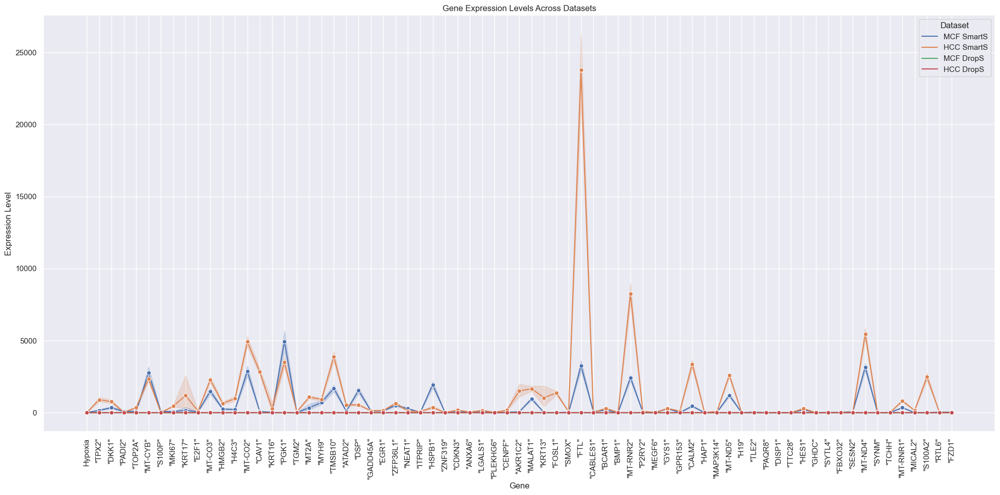

In [83]:
# combine all datasets into one df with a label for each
datasets = {
    'MCF SmartS': df_MCF_SmartS_common,
    'HCC SmartS': df_HCC_SmartS_common,
    'MCF DropS': df_MCF_DropS_common,
    'HCC DropS': df_HCC_DropS_common
}
combined_data = pd.DataFrame()

for label, df in datasets.items():
    df['Dataset'] = label
    combined_data = pd.concat([combined_data, df])

# melt the df so that each row corresponds to a single observation of gene expression
melted_data = combined_data.melt(id_vars='Dataset', var_name='Gene', value_name='Expression')

plt.figure(figsize=(20, 10))
sns.lineplot(data=melted_data, x='Gene', y='Expression', hue='Dataset', marker='o')
plt.xticks(rotation=90)  # rotate the gene names for better readability
plt.title('Gene Expression Levels Across Datasets')
plt.ylabel('Expression Level')
plt.xlabel('Gene')
plt.legend(title='Dataset')
plt.grid(True)
plt.tight_layout()  # adjust layout to prevent clipping of tick-labels
plt.show()


/var/folders/sc/040g6l752pg38ngvcz_ths0c0000gn/T/ipykernel_12426/2766023618.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(df_general_sampled['"FTL"'], shade=True)
/Users/emmamora/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


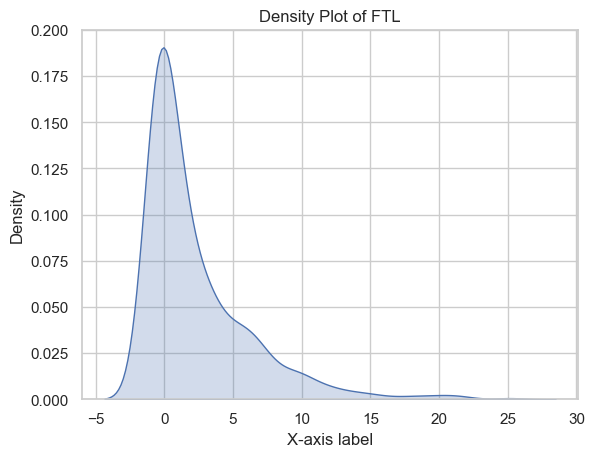

In [258]:
# density plot

## setting the style
sns.set_style("whitegrid")  

## plotting
sns.kdeplot(df_general_sampled['"FTL"'], shade=True)
plt.title("Density Plot of FTL")
plt.xlabel("X-axis label")
plt.ylabel("Density")
plt.show()


##### Genes with Hypoxia in Common in all Datasets

/var/folders/sc/040g6l752pg38ngvcz_ths0c0000gn/T/ipykernel_12426/3598665754.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df['Dataset'] = label
/Users/emmamora/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/emmamora/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


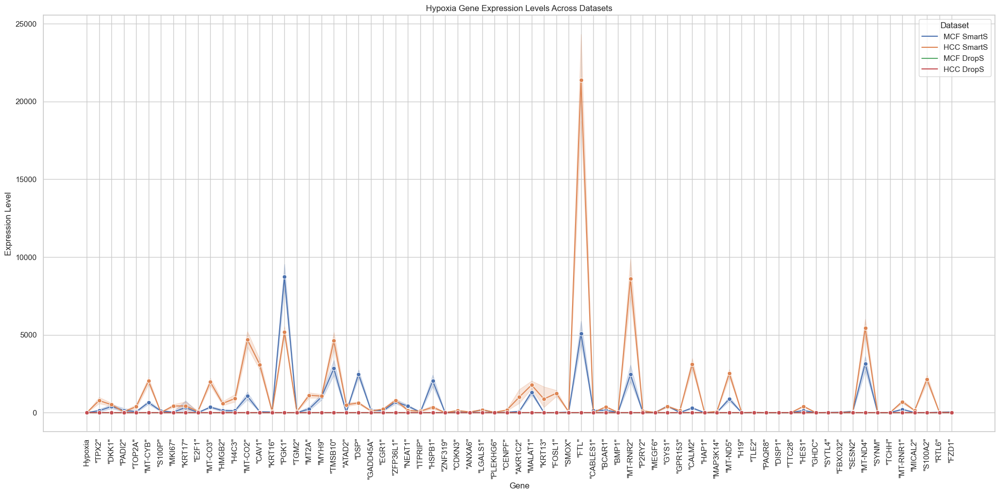

In [260]:
datasets = {
    'MCF SmartS': df_MCF_SmartS_common,
    'HCC SmartS': df_HCC_SmartS_common,
    'MCF DropS': df_MCF_DropS_common,
    'HCC DropS': df_HCC_DropS_common
}
combined_data = pd.DataFrame()

for label, df in datasets.items():
    filtered_df = df[df['Hypoxia'] == 1]
    filtered_df['Dataset'] = label
    combined_data = pd.concat([combined_data, filtered_df], ignore_index=True)

melted_data = combined_data.melt(id_vars='Dataset', var_name='Gene', value_name='Expression')

plt.figure(figsize=(20, 10))
sns.lineplot(data=melted_data, x='Gene', y='Expression', hue='Dataset', marker='o')
plt.xticks(rotation=90)  
plt.title('Hypoxia Gene Expression Levels Across Datasets')
plt.ylabel('Expression Level')
plt.xlabel('Gene')
plt.legend(title='Dataset')
plt.grid(True)
plt.tight_layout()  
plt.show()


##### Genes in Common in all Scaled Datasets

/Users/emmamora/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/emmamora/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


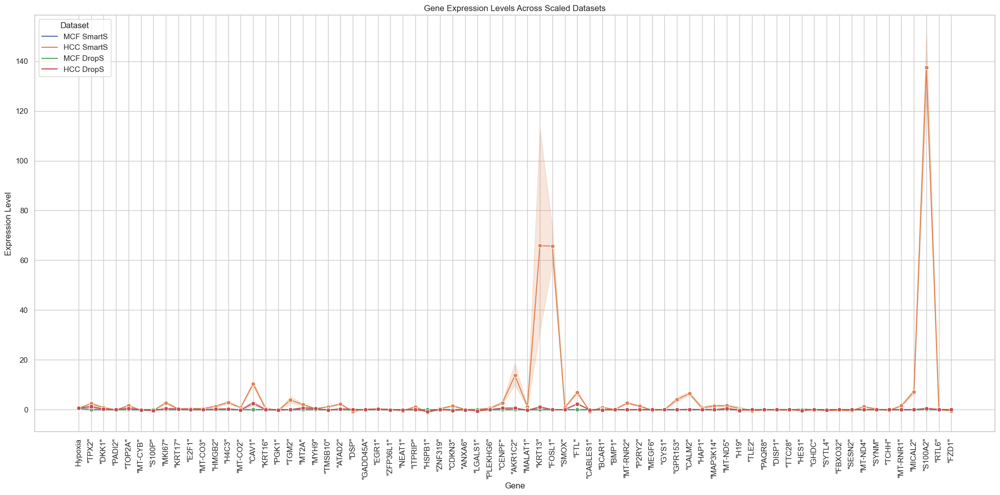

In [261]:
# since SmartS has higher values than DropS we will use the scaler to try to get them in the same range (kind of, not the best apprach but worth trying)
datasets = {
    'MCF SmartS': df_X_MCF_SmartS,
    'HCC SmartS': df_X_HCC_SmartS,
    'MCF DropS': df_X_MCF_DropS,
    'HCC DropS': df_X_HCC_DropS
}
combined_data = pd.DataFrame()

for label, df in datasets.items():
    df['Dataset'] = label
    combined_data = pd.concat([combined_data, df])

melted_data = combined_data.melt(id_vars='Dataset', var_name='Gene', value_name='Expression')

plt.figure(figsize=(20, 10))
sns.lineplot(data=melted_data, x='Gene', y='Expression', hue='Dataset', marker='o')
plt.xticks(rotation=90)  
plt.title('Gene Expression Levels Across Scaled Datasets')
plt.ylabel('Expression Level')
plt.xlabel('Gene')
plt.legend(title='Dataset')
plt.grid(True)
plt.tight_layout()  
plt.show()


##### Genes with Hypoxia in Common in all Scaled Datasets

/var/folders/sc/040g6l752pg38ngvcz_ths0c0000gn/T/ipykernel_12426/1426685721.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df['Dataset'] = label
/Users/emmamora/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/emmamora/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


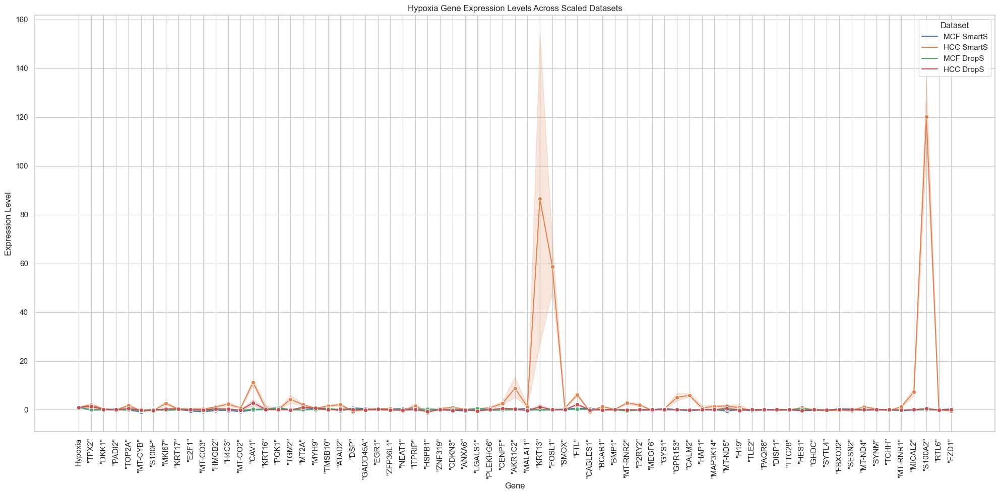

In [262]:
datasets = {
    'MCF SmartS': df_X_MCF_SmartS,
    'HCC SmartS': df_X_HCC_SmartS,
    'MCF DropS': df_X_MCF_DropS,
    'HCC DropS': df_X_HCC_DropS
}
combined_data = pd.DataFrame()

for label, df in datasets.items():
    filtered_df = df[df['Hypoxia'] == 1]
    filtered_df['Dataset'] = label
    combined_data = pd.concat([combined_data, filtered_df], ignore_index=True)

melted_data = combined_data.melt(id_vars='Dataset', var_name='Gene', value_name='Expression')

plt.figure(figsize=(20, 10))
sns.lineplot(data=melted_data, x='Gene', y='Expression', hue='Dataset', marker='o')
plt.xticks(rotation=90)  
plt.title('Hypoxia Gene Expression Levels Across Scaled Datasets')
plt.ylabel('Expression Level')
plt.xlabel('Gene')
plt.legend(title='Dataset')
plt.grid(True)
plt.tight_layout()  
plt.show()

/Users/emmamora/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/emmamora/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


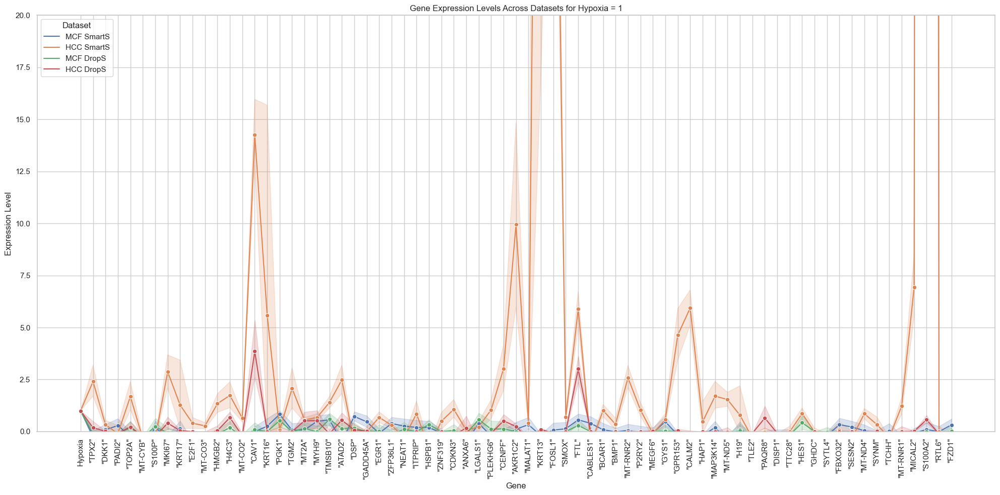

In [ ]:

plt.figure(figsize=(20, 10))

# Assuming 'melted_data' is already prepared and contains the appropriate structure
sns.lineplot(data=melted_data, x='Gene', y='Expression', hue='Dataset', marker='o')

plt.title('Gene Expression Levels Across Datasets for Hypoxia = 1')
plt.xlabel('Gene')
plt.ylabel('Expression Level')
plt.legend(title='Dataset')
plt.grid(True)

# Set y-axis limits
plt.ylim(0, 20)

plt.xticks(rotation=90)  # Rotate the gene names for better readability
plt.tight_layout()  # Adjust layout to prevent clipping of tick-labels
plt.show()


We can firstly observe a significant difference in the peaks from the density plots of the raw (unscaled) data and the scaled one. For instance, in the Hypoxia Genes Across all Datasets, the "FTL" gene has a high expression in the HCC SmartS datasetn overall. In the Hypoxia Genes Across all Scaled Datasets, however, we find this peak reduced (flattened out), while other genes such as "KRT13", "FOSL1" and "S100A2", have a significant increase in their expression level in the HCC SmartS dataset. This increase can be attributed to either an error in the scaling process or as an indicator of significance with respect to Hypoxia. We will further check this by conducting statistical tests on the genes that show high peaks. 

Our goal is to focus on the genes that consistently correspond to Hypoxia across all datasets, in order to improve the accuracy of our general models. In this respect, we "zoomed in" into the gene expression levels (see kde above), in order to visually see which ones are actually significant across all 4 datasets.

#### Advanced Feature Selection - RFE (Recursive Feature Elimination)

**Recursive Feature Elimination (RFE)**
- feature selection method -> works by recursively removing the least important features 
- least important with respect to: model's coefficients or feature importance scores
- initially -> train the model on the entire set of features (importance is based on coefficients - regression or feature importance - decision trees)
- take out the least important features
- repeat until certain number of features is achieved

**Cross Validation (CV)**
- techinque to see how well a model generalises 
- partition the data into k folds
- use folds for training and the rest for validating and/or testing-> shuffle the training-validating/testing folds until you went through all combinations
- detects overfitting

**RFECV**
- the number of features is not set a priori but chosen through cross-validation (evaluate performance for each number and find the optimal one)

**Warning**
- due to the change in the experiments each time we sample, we observe different results in the RFECV  Feature Selection
- for instance, when we first implemented it, both the LogReg and RandF RFECV gave 55 important genes; running it before submitting the report, we now have 4 and 3 significant features from the two methods
- having such a small number of features is not beneficial for the model development part, but we choose to include it, as it was significant for the sampled data we initially worked on
- thus, we conclude that even though RFECV is a valid approach, in our sampled dataframe case, it is useful only in certain situations
- this is an area we could potentially improve on in the future

##### REFCV using LogReg

**Finding the Optimal Number of Features**

Optimal number of features : 6


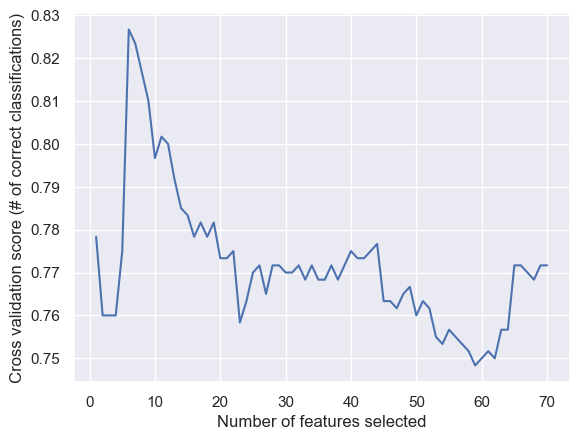

In [84]:
# splitting the data
X_RFECV = df_general_sampled.drop(['Hypoxia'], axis=1)
y_RFECV = df_general_sampled['Hypoxia']

# create the RFE object and compute a cross-validated score.
model_LogReg_general_sampled = LogisticRegression(max_iter=10000)
RFECV_general_sampled = RFECV(estimator=model_LogReg_general_sampled, step=1, cv=StratifiedKFold(5), scoring='accuracy')
RFECV_general_sampled.fit(X_RFECV, y_RFECV)

cv_scores_RFECV = RFECV_general_sampled.cv_results_['mean_test_score']
print("Optimal number of features : %d" % RFECV_general_sampled.n_features_)

# plot number of features VS. cross-validation scores
plt.figure()
plt.xlabel("Number of features selected")
plt.ylabel("Cross validation score (# of correct classifications)")
plt.plot(range(1, len(cv_scores_RFECV) + 1),cv_scores_RFECV)
plt.show()


**Feature Selection based on RFECV Results**

In [85]:
# we now create a new data frame with the most imoportant genes selected by RFECV
selected_RFECV_LogReg_features = X_RFECV.columns[RFECV_general_sampled.support_]
print("Selected features:", selected_RFECV_LogReg_features)


Selected features: Index(['"PADI2"', '"MT-CYB"', '"PGK1"', '"TMSB10"', '"GYS1"', '"FZD1"'], dtype='object')


**Computing Hypoxia Correlations**

While it is not necessary, we compute the Hypoxia-Gene correlation for each of the "selected_RFECV_LogReg_features" to get a sense of how the RFECV works in a visual way.

In [86]:
selected_RFECV_LogReg_features

Index(['"PADI2"', '"MT-CYB"', '"PGK1"', '"TMSB10"', '"GYS1"', '"FZD1"'], dtype='object')

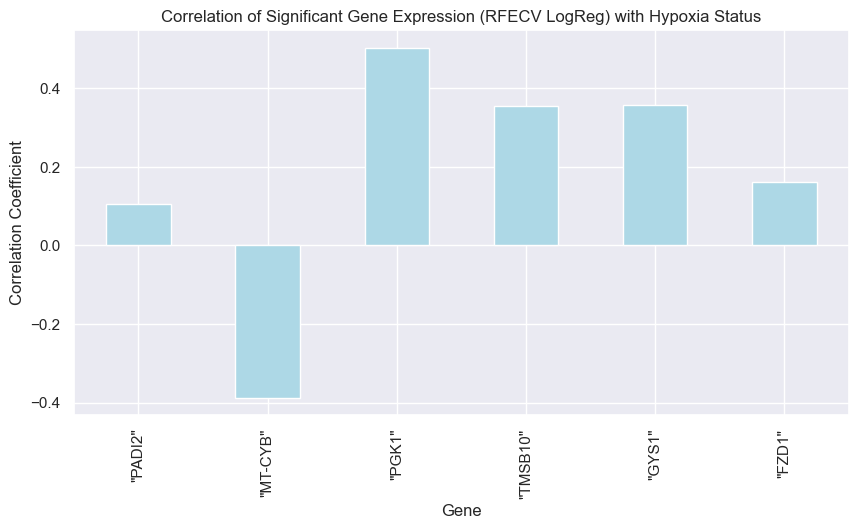

In [87]:
significant_RFECV_LogReg_genes = selected_RFECV_LogReg_features.tolist()

# calculate the correlation matrix
correlation_matrix_RFECV_LogReg = df_general_sampled[['Hypoxia'] + significant_RFECV_LogReg_genes].corr()

# focus on the correlations with the 'Hypoxia' column
hypoxia_correlations_RFECV_LogReg = correlation_matrix_RFECV_LogReg.loc['Hypoxia']

# plotting the correlations
plt.figure(figsize=(10, 5))
hypoxia_correlations_RFECV_LogReg.drop('Hypoxia').plot(kind='bar', color='lightblue')
plt.title('Correlation of Significant Gene Expression (RFECV LogReg) with Hypoxia Status')
plt.xlabel('Gene')
plt.ylabel('Correlation Coefficient')
plt.grid(True)
plt.show()

We observe higher correlations than the ones we found using ANOVA, but still most of them do not pass the 0.2 threshold. We decide to keep going with creating a new data frame for these selected features and start the model development part.

**Creating the Data Frame**

In [88]:

df_general_sampled_reduced = df_general_sampled[['Hypoxia']+ significant_RFECV_LogReg_genes]
df_general_sampled_reduced

,Hypoxia,"""PADI2""","""MT-CYB""","""PGK1""","""TMSB10""","""GYS1""","""FZD1"""
index,,,,,,,
"""output.STAR.4_E4_Norm_S214_Aligned.sortedByCoord.out.bam""",0,-0.233125,1.080197,-0.993420,-0.788471,-1.180555,-0.203482
"""output.STAR.4_A4_Norm_S22_Aligned.sortedByCoord.out.bam""",0,-0.169034,0.293081,-0.942337,-0.645358,-0.547799,-0.103817
"""output.STAR.2_F10_Hypo_S274_Aligned.sortedByCoord.out.bam""",1,-0.138382,-0.663163,1.088269,-0.002323,1.881987,1.715059
"""output.STAR.3_D8_Hypo_S182_Aligned.sortedByCoord.out.bam""",1,-0.233125,-1.061968,-0.058260,0.487239,-0.320006,0.419421
"""output.STAR.3_G11_Hypo_S329_Aligned.sortedByCoord.out.bam""",1,0.017667,-0.754388,1.505788,1.464420,0.721933,0.269925
...,...,...,...,...,...,...,...
"""TGTTGATCCCGG_Hypoxia""",1,0.000000,-0.229889,-0.493046,-0.620174,0.000000,0.000000
"""GTCCTCGTTTGC_Hypoxia""",1,0.000000,-0.229889,-0.493046,-0.620174,0.000000,0.000000
"""CCCGCCTCACGA_Normoxia""",0,0.000000,-0.229889,-0.493046,0.310087,0.000000,0.000000


##### RFECV using RandF

**Finding the Optimal Number of Features**

Optimal number of features : 21


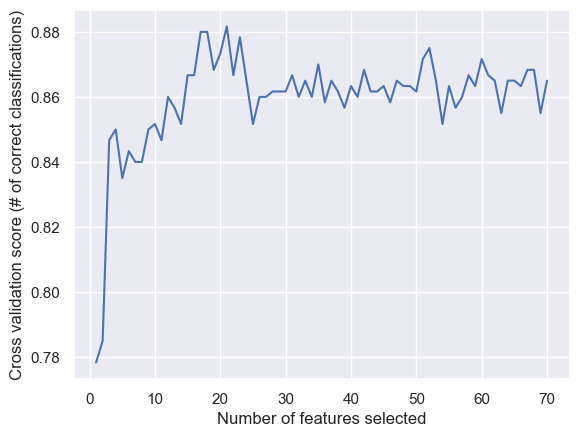

In [89]:
# splitting the data
X_RFECV = df_general_sampled.drop(['Hypoxia'], axis=1)
y_RFECV = df_general_sampled['Hypoxia']

# create the RFE object and compute a cross-validated score.
model_RandF_general_sampled = RandomForestClassifier(n_estimators=200, random_state=42, min_samples_leaf=1, min_samples_split=10, max_depth=None)
RFECV_general_sampled = RFECV(estimator=model_RandF_general_sampled, step=1, cv=StratifiedKFold(5), scoring='accuracy')
RFECV_general_sampled.fit(X_RFECV, y_RFECV)

cv_scores_RFECV = RFECV_general_sampled.cv_results_['mean_test_score']
print("Optimal number of features : %d" % RFECV_general_sampled.n_features_)

# plot number of features VS. cross-validation scores
plt.figure()
plt.xlabel("Number of features selected")
plt.ylabel("Cross validation score (# of correct classifications)")
plt.plot(range(1, len(cv_scores_RFECV) + 1),cv_scores_RFECV)
plt.show()


**Feature Selection based on RFECV Results**

In [90]:
# we now create a new data frame with the most imoportant genes selected by RFECV
selected_RFECV_RandF_features = X_RFECV.columns[RFECV_general_sampled.support_]
print("Selected features:", selected_RFECV_RandF_features)


Selected features: Index(['"TOP2A"', '"MT-CYB"', '"MT-CO3"', '"H4C3"', '"MT-CO2"', '"CAV1"',
       '"PGK1"', '"MT2A"', '"MYH9"', '"TMSB10"', '"DSP"', '"LGALS1"',
       '"AKR1C2"', '"MALAT1"', '"FTL"', '"MT-RNR2"', '"GYS1"', '"CALM2"',
       '"HES1"', '"MT-RNR1"', '"S100A2"'],
      dtype='object')


**Computing Hypoxia Correlations**

In [91]:
selected_RFECV_RandF_features

Index(['"TOP2A"', '"MT-CYB"', '"MT-CO3"', '"H4C3"', '"MT-CO2"', '"CAV1"',
       '"PGK1"', '"MT2A"', '"MYH9"', '"TMSB10"', '"DSP"', '"LGALS1"',
       '"AKR1C2"', '"MALAT1"', '"FTL"', '"MT-RNR2"', '"GYS1"', '"CALM2"',
       '"HES1"', '"MT-RNR1"', '"S100A2"'],
      dtype='object')

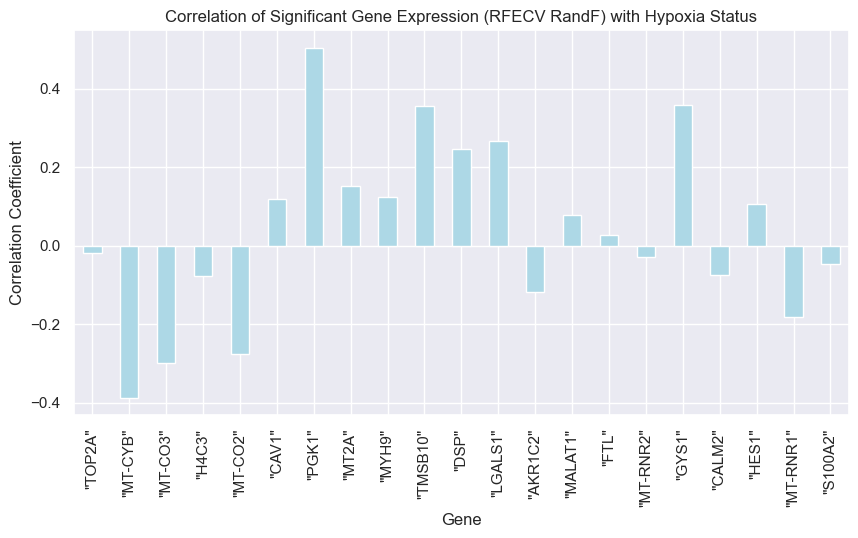

In [92]:
significant_RFECV_RandF_genes = selected_RFECV_RandF_features.tolist() 

# calculate the correlation matrix
correlation_matrix_RFECV_RandF = df_general_sampled[['Hypoxia'] + significant_RFECV_RandF_genes].corr()

# focus on the correlations with the 'Hypoxia' column
hypoxia_correlations_RFECV_RandF = correlation_matrix_RFECV_RandF.loc['Hypoxia']

# plotting the correlations
plt.figure(figsize=(10, 5))
hypoxia_correlations_RFECV_RandF.drop('Hypoxia').plot(kind='bar', color='lightblue')
plt.title('Correlation of Significant Gene Expression (RFECV RandF) with Hypoxia Status')
plt.xlabel('Gene')
plt.ylabel('Correlation Coefficient')
plt.grid(True)
plt.show()

**Creating the Data Frame**

In [93]:
df_general_sampled_reduced_RandF = df_general_sampled[['Hypoxia']+ significant_RFECV_RandF_genes]
df_general_sampled_reduced_RandF

,Hypoxia,"""TOP2A""","""MT-CYB""","""MT-CO3""","""H4C3""","""MT-CO2""","""CAV1""","""PGK1""","""MT2A""","""MYH9""",...,"""LGALS1""","""AKR1C2""","""MALAT1""","""FTL""","""MT-RNR2""","""GYS1""","""CALM2""","""HES1""","""MT-RNR1""","""S100A2"""
index,,,,,,,,,,,,,,,,,,,,,
"""output.STAR.4_E4_Norm_S214_Aligned.sortedByCoord.out.bam""",0,0.777280,1.080197,1.083065,-0.448542,1.169527,-0.393506,-0.993420,-0.074128,-0.449482,...,-0.406220,-0.570481,-0.883915,-0.800440,0.473550,-1.180555,0.171706,-0.569306,0.960756,-0.113863
"""output.STAR.4_A4_Norm_S22_Aligned.sortedByCoord.out.bam""",0,0.277391,0.293081,0.676119,1.590043,0.812872,-0.393506,-0.942337,-0.138539,-0.283047,...,-0.687922,-0.570481,-0.667106,-0.627186,-0.114578,-0.547799,0.480670,2.970114,1.843401,-0.113863
"""output.STAR.2_F10_Hypo_S274_Aligned.sortedByCoord.out.bam""",1,2.394846,-0.663163,-0.761208,1.260548,-0.536161,-0.378348,1.088269,-0.132331,-0.263594,...,1.408470,0.625921,0.410369,-0.280243,-0.120986,1.881987,1.432188,-0.501404,-0.843590,-0.113863
"""output.STAR.3_D8_Hypo_S182_Aligned.sortedByCoord.out.bam""",1,-0.373408,-1.061968,-1.038705,-0.188696,-1.055712,-0.348032,-0.058260,0.124539,0.888482,...,0.268557,-0.452802,-0.651338,-0.576382,-0.900648,-0.320006,-0.609658,-0.679648,-1.038866,-0.113863
"""output.STAR.3_G11_Hypo_S329_Aligned.sortedByCoord.out.bam""",1,-0.429999,-0.754388,-0.617624,-0.386929,-0.734636,-0.282346,1.505788,-0.214591,2.211315,...,0.904025,-0.413576,0.608782,0.780124,-0.113154,0.721933,0.077674,-0.628721,-0.164031,-0.113863
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"""TGTTGATCCCGG_Hypoxia""",1,-0.466861,-0.229889,-0.257209,0.407603,-0.349563,-0.116248,-0.493046,2.156835,-0.292770,...,-0.501933,12.206556,-0.227678,5.000000,-0.529223,0.000000,-0.510711,-0.362143,-0.464991,1.000000
"""GTCCTCGTTTGC_Hypoxia""",1,-0.466861,-0.229889,-0.257209,0.069810,-0.349563,17.320898,-0.493046,12.035470,-0.292770,...,0.558489,24.495034,-0.443827,1.666667,-0.529223,0.000000,-0.510711,-0.362143,-0.464991,2.000000
"""CCCGCCTCACGA_Normoxia""",0,1.425818,-0.229889,-0.257209,-0.267982,-0.349563,-0.116248,-0.493046,-0.312823,-0.292770,...,-0.501933,-0.081923,-0.335752,2.777778,0.155117,0.000000,4.277201,-0.362143,-0.464991,2.000000


#### Model Development - Sampled Data

##### Model Training 

In [94]:
# separate features and target
X_general_sampled = df_general_sampled.drop(['Hypoxia'], axis=1)  
y_general_sampled = df_general_sampled['Hypoxia']  

# split the data - 80% for training and 20% for testing
X_general_sampled_train, X_general_sampled_test, y_general_sampled_train, y_general_sampled_test = train_test_split(X_general_sampled, y_general_sampled, test_size=0.2, random_state=42)

##### Linear Support Vector Machine

In [95]:
# model training
model_LinSVM_general_sampled = LinearSVC(random_state=42, max_iter=25000)
model_LinSVM_general_sampled.fit(X_general_sampled_train, y_general_sampled_train)

# model evaluation
y_general_sampled_pred = model_LinSVM_general_sampled.predict(X_general_sampled_test)
print('Confusion matrix LinSVM on sampled data:')
print(confusion_matrix(y_general_sampled_test, y_general_sampled_pred))
print('Classification report LinSVM on sampled data:')
print(classification_report(y_general_sampled_test, y_general_sampled_pred))

Confusion matrix LinSVM on sampled data:
[[45 12]
 [11 52]]
Classification report LinSVM on sampled data:
              precision    recall  f1-score   support

           0       0.80      0.79      0.80        57
           1       0.81      0.83      0.82        63

    accuracy                           0.81       120
   macro avg       0.81      0.81      0.81       120
weighted avg       0.81      0.81      0.81       120



/Users/emmamora/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


##### Support Vector Machine with RBF Kernel

In [96]:
# model training
model_RbfSVM_general_sampled = SVC(kernel='rbf', random_state=42)
model_RbfSVM_general_sampled.fit(X_general_sampled_train, y_general_sampled_train)

# model evaluation
y_general_sampled_pred = model_RbfSVM_general_sampled.predict(X_general_sampled_test)
print('Confusion matrix RbfSVM on sampled data:')
print(confusion_matrix(y_general_sampled_test, y_general_sampled_pred))
print('Classification report RbfSVM on sampled data:')
print(classification_report(y_general_sampled_test, y_general_sampled_pred))

Confusion matrix RbfSVM on sampled data:
[[ 9 48]
 [ 5 58]]
Classification report RbfSVM on sampled data:
              precision    recall  f1-score   support

           0       0.64      0.16      0.25        57
           1       0.55      0.92      0.69        63

    accuracy                           0.56       120
   macro avg       0.60      0.54      0.47       120
weighted avg       0.59      0.56      0.48       120



##### XGBoost

In [97]:
# model training
model_XGB_general_sampled = xgb.XGBClassifier(objective='binary:logistic', eval_metric="logloss", use_label_encoder=False)
model_XGB_general_sampled.fit(X_general_sampled_train, y_general_sampled_train)

# model evaluation
y_general_sampled_pred = model_XGB_general_sampled.predict(X_general_sampled_test)
print('Confusion matrix XGB on sampled data:')
print(confusion_matrix(y_general_sampled_test, y_general_sampled_pred))
print('Classification report XGB on sampled data:')
print(classification_report(y_general_sampled_test, y_general_sampled_pred))

# feature importances
feature_importances_XGB_general_sampled = model_XGB_general_sampled.feature_importances_
## we'll create a df so it's easily stored
features_df_XGB_general_sampled = pd.DataFrame({
    'Feature': X_general_sampled_train.columns,
    'Importance': feature_importances_XGB_general_sampled
})
features_df_XGB_general_sampled = features_df_XGB_general_sampled.sort_values(by='Importance', ascending=False)
# print("Feature Importances:\n")
# print(features_df_XGB_general_sampled)
print("Feature Importances XGB Sampled (first 10):\n")
print(features_df_XGB_general_sampled.head(10))

Confusion matrix XGB on sampled data:
[[52  5]
 [ 7 56]]
Classification report XGB on sampled data:
              precision    recall  f1-score   support

           0       0.88      0.91      0.90        57
           1       0.92      0.89      0.90        63

    accuracy                           0.90       120
   macro avg       0.90      0.90      0.90       120
weighted avg       0.90      0.90      0.90       120

Feature Importances XGB Sampled (first 10):

      Feature  Importance
15     "PGK1"    0.270206
9    "MT-CO3"    0.135139
4    "MT-CYB"    0.039328
52      "H19"    0.036228
19   "TMSB10"    0.032033
22  "GADD45A"    0.028236
7     "KRT17"    0.026680
41    "BCAR1"    0.025881
25    "NEAT1"    0.023116
43  "MT-RNR2"    0.022605


##### Cross Validation and Model Comparison

In [98]:
# cross-validation for each model
cv_score_LinSVM_general_sampled = cross_val_score(model_LinSVM_general_sampled, X_general_sampled, y_general_sampled, cv=10)
cv_score_RbfSVM_general_sampled = cross_val_score(model_RbfSVM_general_sampled, X_general_sampled, y_general_sampled, cv=10)
cv_score_XGB_general_sampled = cross_val_score(model_XGB_general_sampled, X_general_sampled, y_general_sampled, cv=10)

print('Average CV Score Sampled LinSVM:', np.mean(cv_score_LinSVM_general_sampled))
print('Average CV Score Sampled RbfSVM:', np.mean(cv_score_RbfSVM_general_sampled))
print('Average CV Score Sampled XGB:', np.mean(cv_score_XGB_general_sampled))

/Users/emmamora/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/Users/emmamora/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/Users/emmamora/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/Users/emmamora/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/Users/emmamora/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/Users/emmamora/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:1244

Average CV Score Sampled LinSVM: 0.7666666666666667
Average CV Score Sampled RbfSVM: 0.5366666666666666
Average CV Score Sampled XGB: 0.8633333333333333


Given these cross validation scores, we can conclude that more complex and non-linear models are better suited for the general data. We deduce that the relationships within the data are not simply linear. We will try to further improve the accuracy using a Random Forest model. 

#### Model Development - Random Forest

In [99]:
# model training
#model_RandF_general_sampled = RandomForestClassifier(n_estimators=100, random_state=42)
model_RandF_general_sampled = RandomForestClassifier(n_estimators=200, random_state=42, min_samples_leaf=1, min_samples_split=10, max_depth=None)
#'max_depth': None, 'max_features': 'auto', 'min_samples_leaf': 1, 'min_samples_split': 10, 'n_estimators': 200
model_RandF_general_sampled.fit(X_general_sampled_train, y_general_sampled_train)

# model evaluation
y_general_sampled_pred = model_RandF_general_sampled.predict(X_general_sampled_test)
print('Confusion matrix RandF on sampled data:')
print(confusion_matrix(y_general_sampled_test, y_general_sampled_pred))
print('Classification report RandF on sampled data:')
print(classification_report(y_general_sampled_test, y_general_sampled_pred))

# feature importances
feature_importances_RandF_general_sampled = model_RandF_general_sampled.feature_importances_
## we'll create a df so it's easily stored
features_df_RandF_general_sampled = pd.DataFrame({
    'Feature': X_general_sampled_train.columns,
    'Importance': feature_importances_RandF_general_sampled
})
features_df_RandF_general_sampled = features_df_RandF_general_sampled.sort_values(by='Importance', ascending=False)
# print("Feature Importances:\n")
# print(features_df_RandF_general_sampled)
print("Feature Importances RandF Sampled (first 10):\n")
print(features_df_RandF_general_sampled.head(10))

Confusion matrix RandF on sampled data:
[[51  6]
 [ 7 56]]
Classification report RandF on sampled data:
              precision    recall  f1-score   support

           0       0.88      0.89      0.89        57
           1       0.90      0.89      0.90        63

    accuracy                           0.89       120
   macro avg       0.89      0.89      0.89       120
weighted avg       0.89      0.89      0.89       120

Feature Importances RandF Sampled (first 10):

      Feature  Importance
15     "PGK1"    0.175694
19   "TMSB10"    0.098300
21      "DSP"    0.046369
9    "MT-CO3"    0.045562
39      "FTL"    0.044086
35   "MALAT1"    0.043166
4    "MT-CYB"    0.042509
46     "GYS1"    0.034623
43  "MT-RNR2"    0.032521
31   "LGALS1"    0.026585


##### Fine-Tuning Random Forest using GridSearchCV

In [ ]:
# parameter grid for RandF
param_grid_RandF = {
    'n_estimators': [100, 200, 300],  # number of trees
    'max_features': ['auto', 'sqrt', 'log2'],  # number of features to consider at every split
    'max_depth': [None, 10, 20, 30],  # maximum number of levels in tree
    'min_samples_split': [2, 5, 10],  # minimum number of samples required to split a node
    'min_samples_leaf': [1, 2, 4]  # minimum number of samples required at each leaf node
}

# initialize RandF classifier
RandF_classifier = RandomForestClassifier(random_state=42)

# set up GridSearchCV
grid_search_RandF = GridSearchCV(estimator=RandF_classifier, param_grid=param_grid_RandF, cv=5, scoring='accuracy', verbose=2, n_jobs=-1)
grid_search_RandF.fit(X_general_sampled_train, y_general_sampled_train)

# best parameters and score for RBF SVM
print("Best parameters for RandF:", grid_search_RandF.best_params_)
print("Best cross-validated accuracy for RandF:", grid_search_RandF.best_score_)

# we choose to clear the results of this part out as it occupies too much space in the final html file

In [101]:
# best parameters and score for RandF
print("Best parameters for RandF:", grid_search_RandF.best_params_)
print("Best cross-validated accuracy for RandF:", grid_search_RandF.best_score_)

Best parameters for RandF: {'max_depth': None, 'max_features': 'auto', 'min_samples_leaf': 4, 'min_samples_split': 10, 'n_estimators': 200}
Best cross-validated accuracy for RandF: 0.8958333333333333


##### Setting up Nested Cross Validation for RandF Model

**Outer Loop**
 - splits the data into test/train to evaluate the model's performance on unseen data (our usual cross-validation)
 
**Inner Loop**
 - nested within each training fold of the outer loop
 - used for model selection & hyperparameter tuning

We will set up the whole model again just to avoid any overlaps in terms of notation.

In [104]:
# define the model
model_RandF_general_sampled = RandomForestClassifier(n_estimators=200, random_state=42, min_samples_leaf=4, min_samples_split=10, max_features='auto', max_depth=None)

# nested cross validation
inner_cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
outer_cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# we'll use the full features X_general_sampled and target y_general_sampled (no splitting into test and train)
cv_nested_score_RandF_general_sampled = cross_val_score(model_RandF_general_sampled, X_general_sampled, y_general_sampled, cv=outer_cv, scoring='accuracy')

print("Cross-validation scores:\n", cv_nested_score_RandF_general_sampled)
print("Mean CV accuracy: {:.2f}".format(np.mean(cv_nested_score_RandF_general_sampled)))
print("Standard deviation in CV scores: {:.2f}".format(np.std(cv_nested_score_RandF_general_sampled)))

# model training 
## we train the model on the COMPLETE DATA
model_RandF_general_sampled.fit(X_general_sampled, y_general_sampled)

# feature importances
feature_importances_RandF_general_sampled = model_RandF_general_sampled.feature_importances_
## we'll create a df so it's easily stored
features_df_RandF_general_sampled = pd.DataFrame({
    'Feature': X_general_sampled.columns,
    'Importance': feature_importances_RandF_general_sampled
})
features_df_RandF_general_sampled = features_df_RandF_general_sampled.sort_values(by='Importance', ascending=False)
# print("Feature Importances:\n")
# print(features_df_RandF_general_sampled)
print("Feature Importances RandF Sampled (first 10):\n")
print(features_df_RandF_general_sampled.head(10))

Cross-validation scores:
 [0.83333333 0.925      0.875      0.89166667 0.86666667]
Mean CV accuracy: 0.88
Standard deviation in CV scores: 0.03
Feature Importances RandF Sampled (first 10):

      Feature  Importance
15     "PGK1"    0.188603
19   "TMSB10"    0.115405
9    "MT-CO3"    0.055161
4    "MT-CYB"    0.047272
21      "DSP"    0.040223
39      "FTL"    0.040041
35   "MALAT1"    0.035373
46     "GYS1"    0.035144
43  "MT-RNR2"    0.028387
12   "MT-CO2"    0.027997


##### Model Development - Reduced RFECV RandF

**Model Training**

In [138]:
# separate features and target
X_general_sampled_reduced = df_general_sampled_reduced_RandF.drop(['Hypoxia'], axis=1)  
y_general_sampled_reduced = df_general_sampled_reduced_RandF['Hypoxia']  

# split the data - 80% for training and 20% for testing
X_general_sampled_reduced_train, X_general_sampled_reduced_test, y_general_sampled_reduced_train, y_general_sampled_reduced_test = train_test_split(X_general_sampled_reduced, y_general_sampled_reduced, test_size=0.2, random_state=42)

**Grid Search**

In [ ]:
# parameter grid for RandF
param_grid_RandF = {
    'n_estimators': [100, 200, 300],  # number of trees
    'max_features': ['auto', 'sqrt', 'log2'],  # number of features to consider at every split
    'max_depth': [None, 10, 20, 30],  # maximum number of levels in tree
    'min_samples_split': [2, 5, 10],  # minimum number of samples required to split a node
    'min_samples_leaf': [1, 2, 4]  # minimum number of samples required at each leaf node
}

# initialize RandF classifier
RandF_classifier = RandomForestClassifier(random_state=42)

# set up GridSearchCV
grid_search_RandF = GridSearchCV(estimator=RandF_classifier, param_grid=param_grid_RandF, cv=5, scoring='accuracy', verbose=2, n_jobs=-1)
grid_search_RandF.fit(X_general_sampled_reduced_train, y_general_sampled_reduced_train)

# best parameters and score for RBF SVM
print("Best parameters for RandF:", grid_search_RandF.best_params_)
print("Best cross-validated accuracy for RandF:", grid_search_RandF.best_score_)


In [107]:
# best parameters and score for RBF SVM
print("Best parameters for RandF:", grid_search_RandF.best_params_)
print("Best cross-validated accuracy for RandF:", grid_search_RandF.best_score_)

Best parameters for RandF: {'max_depth': None, 'max_features': 'auto', 'min_samples_leaf': 1, 'min_samples_split': 10, 'n_estimators': 200}
Best cross-validated accuracy for RandF: 0.8916666666666666


**Nested CV Model**

In [108]:
# define the model
model_RandF_general_sampled_reduced = RandomForestClassifier(n_estimators=200, random_state=42, min_samples_leaf=1, min_samples_split=10, max_features='auto', max_depth=None)

# nested cross validation
inner_cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
outer_cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# create feature set and target set
X_general_sampled_reduced = df_general_sampled_reduced_RandF.drop(['Hypoxia'], axis=1)
y_general_sampled_reduced = df_general_sampled_reduced_RandF['Hypoxia']

# we'll use the full features X_general_sampled and target y_general_sampled (no splitting into test and train)
cv_nested_score_RandF_general_sampled_reduced = cross_val_score(model_RandF_general_sampled_reduced, X_general_sampled_reduced, y_general_sampled_reduced, cv=outer_cv, scoring='accuracy')

print("Cross-validation scores:\n", cv_nested_score_RandF_general_sampled_reduced)
print("Mean CV accuracy: {:.2f}".format(np.mean(cv_nested_score_RandF_general_sampled_reduced)))
print("Standard deviation in CV scores: {:.2f}".format(np.std(cv_nested_score_RandF_general_sampled_reduced)))

# model training 
## we train the model on the COMPLETE DATA
model_RandF_general_sampled_reduced.fit(X_general_sampled_reduced, y_general_sampled_reduced)

# feature importances
feature_importances_RandF_general_sampled_reduced = model_RandF_general_sampled_reduced.feature_importances_
## we'll create a df so it's easily stored
features_df_RandF_general_sampled_reduced = pd.DataFrame({
    'Feature': X_general_sampled_reduced.columns,
    'Importance': feature_importances_RandF_general_sampled_reduced
})
features_df_RandF_general_sampled_reduced = features_df_RandF_general_sampled_reduced.sort_values(by='Importance', ascending=False)
# print("Feature Importances:\n")
# print(features_df_RandF_general_sampled)
print("Feature Importances RandF Sampled Reduced (first 10):\n")
print(features_df_RandF_general_sampled_reduced.head(10))

Cross-validation scores:
 [0.84166667 0.93333333 0.9        0.89166667 0.86666667]
Mean CV accuracy: 0.89
Standard deviation in CV scores: 0.03
Feature Importances RandF Sampled Reduced (first 10):

      Feature  Importance
6      "PGK1"    0.248958
9    "TMSB10"    0.104584
2    "MT-CO3"    0.061174
1    "MT-CYB"    0.060374
14      "FTL"    0.053940
10      "DSP"    0.048472
4    "MT-CO2"    0.041626
13   "MALAT1"    0.041372
15  "MT-RNR2"    0.037658
3      "H4C3"    0.033111


In [140]:
# model training
#model_RandF_general_sampled = RandomForestClassifier(n_estimators=100, random_state=42)
model_RandF_general_sampled_reduced = RandomForestClassifier(n_estimators=200, random_state=42, min_samples_leaf=1, min_samples_split=10, max_features='auto', max_depth=None)
#'max_depth': None, 'max_features': 'auto', 'min_samples_leaf': 1, 'min_samples_split': 10, 'n_estimators': 200
model_RandF_general_sampled_reduced.fit(X_general_sampled_reduced_train, y_general_sampled_reduced_train)

# model evaluation
y_general_sampled_reduced_pred = model_RandF_general_sampled_reduced.predict(X_general_sampled_reduced_test)
print('Confusion matrix RandF on sampled reduced data:')
print(confusion_matrix(y_general_sampled_reduced_test, y_general_sampled_reduced_pred))
print('Classification report RandF on sampled data:')
print(classification_report(y_general_sampled_reduced_test, y_general_sampled_reduced_pred))


Confusion matrix RandF on sampled reduced data:
[[49  8]
 [ 7 56]]
Classification report RandF on sampled data:
              precision    recall  f1-score   support

           0       0.88      0.86      0.87        57
           1       0.88      0.89      0.88        63

    accuracy                           0.88       120
   macro avg       0.88      0.87      0.87       120
weighted avg       0.88      0.88      0.87       120



## 6.6. Test Set Results

In this section we explore how our supervised learning models perform on the given test set. We will save the results in table as instructed. Given that we don't have access to the true labels, we will try to average the predictions from different models to get a more accurate result. The two test sets belong to the MCF DropS and HCC DropS combinations of cell lines and techniques, so we will use the RandF, NN models developed on each combination, as well as the general DropS models.

### 6.6.1. MCF SmartS Model (6.1)

In [110]:
# defining the test set
X_TD = df_MCF_SmartS_TD

#### Linear SVM

In [111]:
# get the prediction
y_TD_LinSVM = model_LinSVM_MCF_SmartS_full.predict(X_TD)

# store in a df
results_MCF_SmartS_LinSVM = pd.DataFrame({
    'Sample': X_TD.index,  
    'Prediction': y_TD_LinSVM
})

# export the results to a tab-delimited csv file (as requested)
results_MCF_SmartS_LinSVM.to_csv('pred_MCF_SmartS_LinSVM.csv', sep='\t', index=False)

### 6.6.2. HCC SmartS Model (6.2)

In [112]:
# defining the test set
X_TD = df_HCC_SmartS_TD

#### Linear SVM

In [113]:
# get the prediction
y_TD_LinSVM = model_LinSVM_HCC_SmartS_full.predict(X_TD)

# store in a df
results_HCC_SmartS_LinSVM = pd.DataFrame({
    'Sample': X_TD.index,  
    'Prediction': y_TD_LinSVM
})

# export the results to a tab-delimited csv file (as requested)
results_HCC_SmartS_LinSVM.to_csv('pred_HCC_SmartS_LinSVM.csv', sep='\t', index=False)

### 6.6.3. MCF DropS Models (6.3)

In [419]:
# defining the test set
X_TD = df_MCF_DropS_TD

#### Linear SVM

In [420]:
# get the prediction
y_TD_LinSVM = model_LinSVM_MCF_DropS_full.predict(X_TD)

# store in a df
results_MCF_DropS_LinSVM = pd.DataFrame({
    'Sample': X_TD.index,  
    'Prediction': y_TD_LinSVM
})

# export the results to a tab-delimited csv file (as requested)
results_MCF_DropS_LinSVM.to_csv('pred_MCF_DropS_LinSVM.csv', sep='\t', index=False)

#### Neural Network

In [421]:
# get the prediction (probabilities)
y_TD_NN_probs = model_NN_MCF_DropS.predict(X_TD)

# convert probabilities to predicted labels
y_TD_NN = np.squeeze((y_TD_NN_probs > 0.5).astype("int32"))

# store in a df
results_MCF_DropS_NN = pd.DataFrame({
    'Sample': X_TD.index,  
    'Prediction': y_TD_NN
})

# export the results to a tab-delimited csv file (as requested)
results_MCF_DropS_NN.to_csv('pred_MCF_DropS_NN.csv', sep='\t', index=False)

 79/169 ━━━━━━━━━━━━━━━━━━━━ 0s 647us/step

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 734us/step


### 6.6.2. HCC DropS Models (6.4)

In [422]:
# defining the test set
X_TD = df_HCC_DropS_TD

#### Linear SVM

In [423]:
# get the prediction
y_TD_LinSVM = model_LinSVM_HCC_DropS_full.predict(X_TD)

# store in a df
results_HCC_DropS_LinSVM = pd.DataFrame({
    'Sample': X_TD.index,  
    'Prediction': y_TD_LinSVM
})

# export the results to a tab-delimited csv file (as requested)
results_HCC_DropS_LinSVM.to_csv('pred_HCC_DropS_LinSVM.csv', sep='\t', index=False)

#### Neural Network

In [424]:
# get the prediction (probabilities)
y_TD_NN_probs = model_NN_HCC_DropS.predict(X_TD)

# convert probabilities to predicted labels
y_TD_NN = np.squeeze((y_TD_NN_probs > 0.5).astype("int32"))

# store in a df
results_HCC_DropS_NN = pd.DataFrame({
    'Sample': X_TD.index,  
    'Prediction': y_TD_NN
})

# export the results to a tab-delimited csv file (as requested)
results_HCC_DropS_NN.to_csv('pred_HCC_DropS_NN.csv', sep='\t', index=False)

115/115 ━━━━━━━━━━━━━━━━━━━━ 0s 678us/step


### 6.6.4. General DropS Models (6.5.1)

#### MCF Test Data

In [425]:
# defining the test set
X_TD = df_MCF_DropS_TD[genes_DropS_common]

##### Random Forest

In [426]:
# get the prediction
y_TD_RandF = model_RandF_general_DropS.predict(X_TD)

# store in a df
results_MCF_DropS_general_RandF = pd.DataFrame({
    'Sample': X_TD.index,  
    'Prediction': y_TD_RandF
})

# export the results to a tab-delimited csv file (as requested)
results_MCF_DropS_general_RandF.to_csv('pred_MCF_DropS_general_RandF.csv', sep='\t', index=False)

##### Neural Network

In [427]:
# get the prediction (probabilities)
y_TD_NN_probs = model_NN_DropS.predict(X_TD)

# convert probabilities to predicted labels
y_TD_NN = np.squeeze((y_TD_NN_probs > 0.5).astype("int32"))

# store in a df
results_MCF_DropS_general_NN = pd.DataFrame({
    'Sample': X_TD.index,  
    'Prediction': y_TD_NN
})

# export the results to a tab-delimited csv file (as requested)
results_MCF_DropS_general_NN.to_csv('pred_MCF_DropS_general_NN.csv', sep='\t', index=False)

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 836us/step


#### HCC Test Data

In [428]:
# defining the test set
X_TD = df_HCC_DropS_TD[genes_DropS_common]

##### Random Forest

In [429]:
# get the prediction
y_TD_RandF = model_RandF_general_DropS.predict(X_TD)

# store in a df
results_HCC_DropS_general_RandF = pd.DataFrame({
    'Sample': X_TD.index,  
    'Prediction': y_TD_RandF
})

# export the results to a tab-delimited csv file (as requested)
results_HCC_DropS_general_RandF.to_csv('pred_HCC_DropS_general_RandF.csv', sep='\t', index=False)

##### Neural Network

In [430]:
# get the prediction (probabilities)
y_TD_NN_probs = model_NN_DropS.predict(X_TD)

# convert probabilities to predicted labels
y_TD_NN = np.squeeze((y_TD_NN_probs > 0.5).astype("int32"))

# store in a df
results_HCC_DropS_general_NN = pd.DataFrame({
    'Sample': X_TD.index,  
    'Prediction': y_TD_NN
})

# export the results to a tab-delimited csv file (as requested)
results_HCC_DropS_general_NN.to_csv('pred_HCC_DropS_general_NN.csv', sep='\t', index=False)

115/115 ━━━━━━━━━━━━━━━━━━━━ 0s 464us/step


### 6.6.5. General Model Full (6.5.2)

#### SmartS

##### MCF Test Data

In [114]:
# defining the test set
X_TD = df_MCF_SmartS_TD[genes_common]

**Random Forest**

In [115]:
# get the prediction
y_TD_RandF = model_RandF_general.predict(X_TD)

# store in a df
results_MCF_SmartS_general_full_RandF = pd.DataFrame({
    'Sample': X_TD.index,  
    'Prediction': y_TD_RandF
})

# export the results to a tab-delimited csv file (as requested)
results_MCF_SmartS_general_full_RandF.to_csv('pred_MCF_SmartS_general_full_RandF.csv', sep='\t', index=False)

**Neural Network**

In [116]:
# get the prediction (probabilities)
y_TD_NN_probs = model_NN_general.predict(X_TD)

# convert probabilities to predicted labels
y_TD_NN = np.squeeze((y_TD_NN_probs > 0.5).astype("int32"))

# store in a df
results_MCF_SmartS_general_full_NN = pd.DataFrame({
    'Sample': X_TD.index,  
    'Prediction': y_TD_NN
})

# export the results to a tab-delimited csv file (as requested)
results_MCF_SmartS_general_full_NN.to_csv('pred_MCF_SmartS_general_full_NN.csv', sep='\t', index=False)

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step 


##### HCC Test Data

In [117]:
# defining the test set
X_TD = df_HCC_SmartS_TD[genes_common]

##### Random Forest

In [118]:
# get the prediction
y_TD_RandF = model_RandF_general.predict(X_TD)

# store in a df
results_HCC_SmartS_general_full_RandF = pd.DataFrame({
    'Sample': X_TD.index,  
    'Prediction': y_TD_RandF
})

# export the results to a tab-delimited csv file (as requested)
results_HCC_SmartS_general_full_RandF.to_csv('pred_HCC_SmartS_general_full_RandF.csv', sep='\t', index=False)

##### Neural Network

In [119]:
# get the prediction (probabilities)
y_TD_NN_probs = model_NN_general.predict(X_TD)

# convert probabilities to predicted labels
y_TD_NN = np.squeeze((y_TD_NN_probs > 0.5).astype("int32"))

# store in a df
results_HCC_SmartS_general_full_NN = pd.DataFrame({
    'Sample': X_TD.index,  
    'Prediction': y_TD_NN
})

# export the results to a tab-delimited csv file (as requested)
results_HCC_SmartS_general_full_NN.to_csv('pred_HCC_SmartS_general_full_NN.csv', sep='\t', index=False)

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


#### DropS

##### MCF Test Data

In [120]:
# defining the test set
X_TD = df_MCF_DropS_TD[genes_common]

**Random Forest**

In [121]:
# get the prediction
y_TD_RandF = model_RandF_general.predict(X_TD)

# store in a df
results_MCF_DropS_general_full_RandF = pd.DataFrame({
    'Sample': X_TD.index,  
    'Prediction': y_TD_RandF
})

# export the results to a tab-delimited csv file (as requested)
results_MCF_DropS_general_full_RandF.to_csv('pred_MCF_DropS_general_full_RandF.csv', sep='\t', index=False)

**Neural Network**

In [122]:
# get the prediction (probabilities)
y_TD_NN_probs = model_NN_general.predict(X_TD)

# convert probabilities to predicted labels
y_TD_NN = np.squeeze((y_TD_NN_probs > 0.5).astype("int32"))

# store in a df
results_MCF_DropS_general_full_NN = pd.DataFrame({
    'Sample': X_TD.index,  
    'Prediction': y_TD_NN
})

# export the results to a tab-delimited csv file (as requested)
results_MCF_DropS_general_full_NN.to_csv('pred_MCF_DropS_general_full_NN.csv', sep='\t', index=False)

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 396us/step


#### HCC Test Data

In [ ]:
# defining the test set
X_TD = df_HCC_DropS_TD[genes_common]

**Random Forest**

In [123]:
# get the prediction
y_TD_RandF = model_RandF_general.predict(X_TD)

# store in a df
results_HCC_DropS_general_full_RandF = pd.DataFrame({
    'Sample': X_TD.index,  
    'Prediction': y_TD_RandF
})

# export the results to a tab-delimited csv file (as requested)
results_HCC_DropS_general_full_RandF.to_csv('pred_HCC_DropS_general_full_RandF.csv', sep='\t', index=False)

**Neural Network**

In [124]:
# get the prediction (probabilities)
y_TD_NN_probs = model_NN_general.predict(X_TD)

# convert probabilities to predicted labels
y_TD_NN = np.squeeze((y_TD_NN_probs > 0.5).astype("int32"))

# store in a df
results_HCC_DropS_general_full_NN = pd.DataFrame({
    'Sample': X_TD.index,  
    'Prediction': y_TD_NN
})

# export the results to a tab-delimited csv file (as requested)
results_HCC_DropS_general_full_NN.to_csv('pred_HCC_DropS_general_full_NN.csv', sep='\t', index=False)

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 356us/step


### 6.6.6. General Model Sampled (6.5.3)

#### SmartS

##### MCF Test Data

In [125]:
# defining the test set
X_TD = df_MCF_SmartS_TD[genes_common]

**Random Forest**

In [126]:
# get the prediction
y_TD_RandF = model_RandF_general_sampled.predict(X_TD)

# store in a df
results_MCF_SmartS_general_sampled_RandF = pd.DataFrame({
    'Sample': X_TD.index,  
    'Prediction': y_TD_RandF
})

# export the results to a tab-delimited csv file (as requested)
results_MCF_SmartS_general_sampled_RandF.to_csv('pred_MCF_SmartS_general_sampled_RandF.csv', sep='\t', index=False)

##### HCC Test Data

In [127]:
# defining the test set
X_TD = df_HCC_SmartS_TD[genes_common]

##### Random Forest

In [128]:
# get the prediction
y_TD_RandF = model_RandF_general_sampled.predict(X_TD)

# store in a df
results_HCC_SmartS_general_sampled_RandF = pd.DataFrame({
    'Sample': X_TD.index,  
    'Prediction': y_TD_RandF
})

# export the results to a tab-delimited csv file (as requested)
results_HCC_SmartS_general_sampled_RandF.to_csv('pred_HCC_SmartS_general_sampled_RandF.csv', sep='\t', index=False)

#### DropS

##### MCF Test Data

In [129]:
# defining the test set
X_TD = df_MCF_DropS_TD[genes_common]

**Random Forest**

In [130]:
# get the prediction
y_TD_RandF = model_RandF_general_sampled.predict(X_TD)

# store in a df
results_MCF_DropS_general_sampled_RandF = pd.DataFrame({
    'Sample': X_TD.index,  
    'Prediction': y_TD_RandF
})

# export the results to a tab-delimited csv file (as requested)
results_MCF_DropS_general_sampled_RandF.to_csv('pred_MCF_DropS_general_sampled_RandF.csv', sep='\t', index=False)

#### HCC Test Data

In [131]:
# defining the test set
X_TD = df_HCC_DropS_TD[genes_common]

**Random Forest**

In [132]:
# get the prediction
y_TD_RandF = model_RandF_general_sampled.predict(X_TD)

# store in a df
results_HCC_DropS_general_sampled_RandF = pd.DataFrame({
    'Sample': X_TD.index,  
    'Prediction': y_TD_RandF
})

# export the results to a tab-delimited csv file (as requested)
results_HCC_DropS_general_sampled_RandF.to_csv('pred_HCC_DropS_general_sampled_RandF.csv', sep='\t', index=False)

### 6.6.7. General Model Sampled Reduced(6.5.3)

#### SmartS

##### MCF Test Data

In [143]:
# defining the test set
X_TD = df_MCF_SmartS_TD[significant_RFECV_RandF_genes]

**Random Forest**

In [144]:
# get the prediction
y_TD_RandF = model_RandF_general_sampled_reduced.predict(X_TD)

# store in a df
results_MCF_SmartS_general_sampled_reduced_RandF = pd.DataFrame({
    'Sample': X_TD.index,  
    'Prediction': y_TD_RandF
})

# export the results to a tab-delimited csv file (as requested)
results_MCF_SmartS_general_sampled_reduced_RandF.to_csv('pred_MCF_SmartS_general_sampled_reduced_RandF.csv', sep='\t', index=False)

##### HCC Test Data

In [145]:
# defining the test set
X_TD = df_HCC_SmartS_TD[significant_RFECV_RandF_genes]

##### Random Forest

In [146]:
# get the prediction
y_TD_RandF = model_RandF_general_sampled_reduced.predict(X_TD)

# store in a df
results_HCC_SmartS_general_sampled_reduced_RandF = pd.DataFrame({
    'Sample': X_TD.index,  
    'Prediction': y_TD_RandF
})

# export the results to a tab-delimited csv file (as requested)
results_HCC_SmartS_general_sampled_reduced_RandF.to_csv('pred_HCC_SmartS_general_sampled_reduced_RandF.csv', sep='\t', index=False)

#### DropS

##### MCF Test Data

In [147]:
# defining the test set
X_TD = df_MCF_DropS_TD[significant_RFECV_RandF_genes]

**Random Forest**

In [148]:
# get the prediction
y_TD_RandF = model_RandF_general_sampled_reduced.predict(X_TD)

# store in a df
results_MCF_DropS_general_sampled_reduced_RandF = pd.DataFrame({
    'Sample': X_TD.index,  
    'Prediction': y_TD_RandF
})

# export the results to a tab-delimited csv file (as requested)
results_MCF_DropS_general_sampled_reduced_RandF.to_csv('pred_MCF_DropS_general_sampled_reduced_RandF.csv', sep='\t', index=False)

#### HCC Test Data

In [149]:
# defining the test set
X_TD = df_HCC_DropS_TD[significant_RFECV_RandF_genes]

**Random Forest**

In [150]:
# get the prediction
y_TD_RandF = model_RandF_general_sampled_reduced.predict(X_TD)

# store in a df
results_HCC_DropS_general_sampled_reduced_RandF = pd.DataFrame({
    'Sample': X_TD.index,  
    'Prediction': y_TD_RandF
})

# export the results to a tab-delimited csv file (as requested)
results_HCC_DropS_general_sampled_reduced_RandF.to_csv('pred_HCC_DropS_general_sampled_reduced_RandF.csv', sep='\t', index=False)

### 6.6.4. Final Results

We report the predictions from the neural networks trained on the individual datasets (MCF DropS and HCC DropS). These perform sightly better than the other models on the X_test and y_test data (0.98 and 0.96 accuracy). Comparison of the CSV files leads to some differences in predictions, but we won't be exploring it further due to the already large size of the report. Some further directions of work would include: training RandF models on MCF DropS and HCC DropS, doing nested cross validation and computing feature importance scores. For the NN models, we could tune the parameters, using GridSearch or manually adjusting them as we did for the General DropS model. We could also get insights into the data and the model training by comparing predictions on X_TD between individual and general models (eg. MCF difference between NN and NN general is 116 predictions, while HCC is 118). There is also the possibility of ensamble voting for setting the predicted lable of a TD example.